In [4]:
!pip3 install matplotlib

  Using cached matplotlib-3.9.2-cp312-cp312-macosx_11_0_arm64.whl.metadata (11 kB)
  Using cached contourpy-1.3.0-cp312-cp312-macosx_11_0_arm64.whl.metadata (5.4 kB)
  Using cached cycler-0.12.1-py3-none-any.whl.metadata (3.8 kB)
  Using cached kiwisolver-1.4.7-cp312-cp312-macosx_11_0_arm64.whl.metadata (6.3 kB)
  Using cached pillow-10.4.0-cp312-cp312-macosx_11_0_arm64.whl.metadata (9.2 kB)
  Using cached pyparsing-3.1.4-py3-none-any.whl.metadata (5.1 kB)
Using cached matplotlib-3.9.2-cp312-cp312-macosx_11_0_arm64.whl (7.8 MB)
Using cached contourpy-1.3.0-cp312-cp312-macosx_11_0_arm64.whl (251 kB)
Using cached cycler-0.12.1-py3-none-any.whl (8.3 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 11.1 MB/s eta 0:00:00a 0:00:01
Using cached kiwisolver-1.4.7-cp312-cp312-macosx_11_0_arm64.whl (63 kB)
Using cached pillow-10.4.0-cp312-cp312-macosx_11_0_arm64.whl (3.4 MB)
Using cached pyparsing-3.1.4-py3-none-any.whl (104 kB)


In [6]:
!pip3 install seaborn

  Using cached seaborn-0.13.2-py3-none-any.whl.metadata (5.4 kB)
Using cached seaborn-0.13.2-py3-none-any.whl (294 kB)


In [543]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc, roc_auc_score



In [545]:
def conf_matrix(y_test, y_pred, class_names):
    confmat = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=confmat, display_labels=class_names)
    disp.plot(cmap='viridis')
    plt.grid(False)
    plt.title('Матрица ошибок')
    plt.show()

In [4]:
df = pd.read_csv('dataset_ok.csv')
df = df[df['Форма образования'] == 'Очная форма']
df

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Сезон,Год,visit
0,10119,2,9,Основы автоматизированного проектирования анте...,каф.ТОР,Экзамен,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,autumn,2023,56.712963
1,10119,2,10,Антенны сверхвысоких частот,каф.ТОР,Экзамен,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,spring,2024,29.166667
2,10119,3,9,Основы автоматизированного проектирования анте...,каф.ТОР,К/проект,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,autumn,2023,56.712963
3,10119,3,9,Радиоэлектронные системы и комплексы,каф.РС,Экзамен,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,autumn,2023,41.666667
4,10119,3,9,Устройства сверхвысоких частот,каф.ТОР,К/работа,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,autumn,2023,25.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134658,10280323,3,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857
134659,10280323,4,1,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,73.333333
134660,10280323,4,2,Информационные технологии,каф.САПР,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3.571429
134661,10280323,5,1,Физическая культура и спорт,каф.ФВиС,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,66.666667


In [5]:
gr = pd.read_csv('students_plus_groups.csv')
gr = gr[['Группа', 'ID ЛК']]

In [6]:
res = pd.merge(df, gr, on='ID ЛК', how='left')
res

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа
0,10119,2,9,Основы автоматизированного проектирования анте...,каф.ТОР,Экзамен,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,autumn,2023,56.712963,9112
1,10119,2,10,Антенны сверхвысоких частот,каф.ТОР,Экзамен,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,spring,2024,29.166667,9112
2,10119,3,9,Основы автоматизированного проектирования анте...,каф.ТОР,К/проект,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,autumn,2023,56.712963,9112
3,10119,3,9,Радиоэлектронные системы и комплексы,каф.РС,Экзамен,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,autumn,2023,41.666667,9112
4,10119,3,9,Устройства сверхвысоких частот,каф.ТОР,К/работа,375210.0,True,5.0,Бюджет,Учащийся,Специалитет,Очная форма,autumn,2023,25.000000,9112
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154879,10280323,3,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3354
154880,10280323,4,1,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,73.333333,3354
154881,10280323,4,2,Информационные технологии,каф.САПР,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3.571429,3354
154882,10280323,5,1,Физическая культура и спорт,каф.ФВиС,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,66.666667,3354


In [7]:
df = res.copy()

In [8]:
df = df[(df['Уровень образования'] == 'Бакалавриат') & (df['status'] == 'Учащийся') & (df['Курс'] == 1)]
df['Группа'] = df['Группа'].astype(str)

#df = df.fillna('').astype(str)
df = df[df['Группа'].str.startswith('3')]



In [9]:
df = df[(df['Дисциплина'] != 'Введение в эргономику') & (df['Дисциплина'] != 'Теория автоматов') & (df['Кафедра'] != 'каф.ТОР') & (df['Дисциплина'] != 'Программирование в среде LabView') & (df['Дисциплина'] != 'Программирование в среде Matlab')]

In [210]:
df.to_csv('classes_ok.csv')

In [187]:
### Метрика f1, если все оценки - не 2

In [10]:
df_sorted = df.sort_values(by=['Дисциплина', 'Группа'])

In [11]:
grouped = df_sorted.groupby(['Дисциплина', 'Группа'])
# Получим только группы, где хотя бы две строки
filtered_groups = grouped.filter(lambda x: len(x) > 1)


In [12]:
df1 = pd.DataFrame()
df2 = pd.DataFrame()
flg = True
# Цикл по дисциплинам
for index, row in df_sorted.iterrows():
    if flg:
        df1 = pd.concat([df1, row.to_frame().T])

        flg = False
    else:
        df2 = pd.concat([df2, row.to_frame().T])
        flg = True


In [12]:
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

In [13]:
visits_train = X_train['visit']
visits_test = X_test['visit']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns='visit'))
X_te = pd.get_dummies(X_test.drop(columns='visit'))

# Добавляем колонку visits обратно
X_tr['visit'] = visits_train
X_te['visit'] = visits_test


In [14]:
y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

In [15]:
tree = DecisionTreeClassifier(random_state=46)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

accuracy = accuracy_score(y_te, y_pred)
report = classification_report(y_te, y_pred)

print(f'Accuracy: {accuracy}')
print('Classification Report:')
print(report)
f1 = f1_score(y_te, y_pred, average='weighted')  # Используйте 'macro' или 'micro' в зависимости от задачи
print(f"F1 Score: {f1}")


Accuracy: 0.8460076045627376
Classification Report:
              precision    recall  f1-score   support

           2       0.42      0.39      0.40      2413
           3       0.91      0.92      0.91     15471

    accuracy                           0.85     17884
   macro avg       0.66      0.65      0.66     17884
weighted avg       0.84      0.85      0.84     17884

F1 Score: 0.8430836618011694


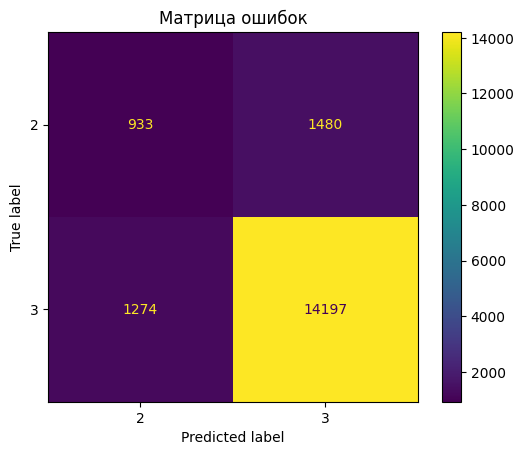

In [16]:
conf_matrix(y_te, y_pred, [2, + 3])

In [207]:
f1_macro = f1_score(y_te, y_pred, average='macro')

In [203]:
f1_micro = f1_score(y_te, y_pred, average='micro')

In [208]:
print(f1_micro)
print(f1_macro)

0.8460076045627376
0.657739756070307


In [196]:
y_te.shape

(17884,)

In [205]:
array_of_threes = np.full((17884,), 3)
print(f1_score(y_te, array_of_threes, average='weighted'))
print(f1_score(y_te, array_of_threes, average='macro'))

0.8024928316835614
0.4638285114675461


In [175]:
#df2[df2['Дисциплина'] == 'Введение в эргономику']

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа
112301,2990319,2,3,Введение в эргономику,каф.ИС,Дифференцированный зачет,372787.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,18.75,3354


0        5
1        5
2        2
3        2
4        2
        ..
77447    3
77448    4
77449    4
77450    5
77451    5
Name: ПерваяПопытка, Length: 77452, dtype: int64

In [18]:
y_train

0        5
1        3
2        5
3        5
4        5
        ..
77427    5
77428    4
77429    3
77430    4
77431    4
Name: ПерваяПопытка, Length: 77432, dtype: int64

In [ ]:
f1 = f1_score(y_train, y_pred)


In [13]:
teach = pd.read_csv('teachers.csv')
teach

,Дисциплина,Кафедра,КодПланыСтроки,Курс,Семестр,Группа,ВидЗанятий,Экзамен,Зачёт,ЗачётСОценкой,Часов,Фамилия,Имя,Отчество,Должность,Звание,Степень
0,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,NaN,3,6.0,1781.0,Пр,True,NaN,NaN,102.0,Тонкова,Марина,Михайловна,NaN,Доцент,Кандидат наук
1,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,NaN,3,6.0,1781.0,Пр,True,NaN,NaN,102.0,Соколенко,Ирина,Витальевна,NaN,Нет,Нет
2,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,NaN,3,5.0,1782.0,Пр,True,NaN,NaN,102.0,Соколова,Александра,Леонидовна,NaN,Нет,Нет
3,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,NaN,3,5.0,1782.0,Пр,True,NaN,NaN,102.0,Петренко,Георгий,Кириллович,NaN,Нет,Нет
4,"Практический курс английского языка, п/г 3",каф.ИНЯЗ,NaN,3,5.0,1782.0,Пр,True,NaN,NaN,102.0,Филиппова,Юлия,Валерьевна,NaN,Доцент,Кандидат наук
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29548,НИР практика/Подготовка публикаций и (или) зая...,каф.СП,2105216.0,1,2.0,3982.0,Прак,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29549,"НИР практика/Научная деятельность, направленна...",каф.СП,2105217.0,1,1.0,3982.0,Прак,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29550,"Иностранный язык (английский), п/г 6",каф.ИНЯЗ,2104500.0,1,2.0,3969.0,Пр,True,NaN,NaN,24.0,Генина,Юлия,Борисовна,NaN,Нет,Нет
29551,"Иностранный язык (английский), п/г 7",каф.ИНЯЗ,2104500.0,1,2.0,3969.0,Пр,True,NaN,NaN,24.0,Кузьмич,Ирина,Васильевна,NaN,Доцент,Кандидат наук


In [14]:
teach['фио'] = teach['Фамилия'] + teach['Имя'] + teach['Отчество']
teach = teach[['Дисциплина', 'Кафедра', 'Курс', 'Семестр', 'Группа', 'ВидЗанятий', 'фио']]
teach.dropna()

,Дисциплина,Кафедра,Курс,Семестр,Группа,ВидЗанятий,фио
0,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,3,6.0,1781.0,Пр,ТонковаМаринаМихайловна
1,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,3,6.0,1781.0,Пр,СоколенкоИринаВитальевна
2,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,3,5.0,1782.0,Пр,СоколоваАлександраЛеонидовна
3,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,3,5.0,1782.0,Пр,ПетренкоГеоргийКириллович
4,"Практический курс английского языка, п/г 3",каф.ИНЯЗ,3,5.0,1782.0,Пр,ФилипповаЮлияВалерьевна
...,...,...,...,...,...,...,...
29545,Педагогика высшего образования (Pedagogy of Hi...,каф.СП,1,2.0,3982.0,Лек,КазариноваНадеждаВасильевна
29546,История и философия науки (History and Philoso...,каф.ФЛ,1,1.0,3982.0,Лек,ПрокофьеваДианаВладимировна
29547,История и философия науки (History and Philoso...,каф.ФЛ,1,2.0,3982.0,Пр,ПрокофьеваДианаВладимировна
29550,"Иностранный язык (английский), п/г 6",каф.ИНЯЗ,1,2.0,3969.0,Пр,ГенинаЮлияБорисовна


In [15]:
teach['ВидЗанятий'].unique()

array(['Пр', 'Лаб', 'КР', 'Лек', 'Прак', 'ВКР', 'КП', 'РукНПМ', 'ДРМ',
       'ИЗ', 'Доб', 'ГАК', 'МЭк', 'Асп'], dtype=object)

In [16]:
teach.isna().sum()

Дисциплина        0
Кафедра           0
Курс              0
Семестр         671
Группа          171
ВидЗанятий        0
фио           10714
dtype: int64

In [17]:
df['Тип_Ведомости'].unique()

array(['Экзамен', 'Дифференцированный зачет', 'К/работа', 'К/проект'],
      dtype=object)

In [18]:
teach = teach[(teach['ВидЗанятий'] == 'Лек') | (teach['ВидЗанятий'] == 'Пр') | (teach['ВидЗанятий'] == 'Лаб')]
teach

,Дисциплина,Кафедра,Курс,Семестр,Группа,ВидЗанятий,фио
0,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,3,6.0,1781.0,Пр,ТонковаМаринаМихайловна
1,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,3,6.0,1781.0,Пр,СоколенкоИринаВитальевна
2,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,3,5.0,1782.0,Пр,СоколоваАлександраЛеонидовна
3,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,3,5.0,1782.0,Пр,ПетренкоГеоргийКириллович
4,"Практический курс английского языка, п/г 3",каф.ИНЯЗ,3,5.0,1782.0,Пр,ФилипповаЮлияВалерьевна
...,...,...,...,...,...,...,...
29545,Педагогика высшего образования (Pedagogy of Hi...,каф.СП,1,2.0,3982.0,Лек,КазариноваНадеждаВасильевна
29546,История и философия науки (History and Philoso...,каф.ФЛ,1,1.0,3982.0,Лек,ПрокофьеваДианаВладимировна
29547,История и философия науки (History and Philoso...,каф.ФЛ,1,2.0,3982.0,Пр,ПрокофьеваДианаВладимировна
29550,"Иностранный язык (английский), п/г 6",каф.ИНЯЗ,1,2.0,3969.0,Пр,ГенинаЮлияБорисовна


In [238]:
teach.to_csv('clean_teachers.csv')

In [19]:
df

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа
27,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,89.727093,3182
28,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,66.666667,3182
29,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,95.396825,3182
30,10123,4,1,Алгебра и геометрия,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,84.926471,3182
31,10123,4,1,Математический анализ,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,91.176471,3182
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154879,10280323,3,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3354
154880,10280323,4,1,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,73.333333,3354
154881,10280323,4,2,Информационные технологии,каф.САПР,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3.571429,3354
154882,10280323,5,1,Физическая культура и спорт,каф.ФВиС,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,66.666667,3354


In [20]:
teach = teach.dropna()

In [21]:
r_teach = teach.groupby(['Дисциплина', 'Кафедра', 'Семестр', 'Группа'], as_index=False).agg({
    'Курс': 'first',
    'фио': lambda x: ', '.join(x)
})


In [22]:
teach.isna().sum()

Дисциплина    0
Кафедра       0
Курс          0
Семестр       0
Группа        0
ВидЗанятий    0
фио           0
dtype: int64

In [23]:
teach

,Дисциплина,Кафедра,Курс,Семестр,Группа,ВидЗанятий,фио
0,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,3,6.0,1781.0,Пр,ТонковаМаринаМихайловна
1,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,3,6.0,1781.0,Пр,СоколенкоИринаВитальевна
2,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,3,5.0,1782.0,Пр,СоколоваАлександраЛеонидовна
3,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,3,5.0,1782.0,Пр,ПетренкоГеоргийКириллович
4,"Практический курс английского языка, п/г 3",каф.ИНЯЗ,3,5.0,1782.0,Пр,ФилипповаЮлияВалерьевна
...,...,...,...,...,...,...,...
29545,Педагогика высшего образования (Pedagogy of Hi...,каф.СП,1,2.0,3982.0,Лек,КазариноваНадеждаВасильевна
29546,История и философия науки (History and Philoso...,каф.ФЛ,1,1.0,3982.0,Лек,ПрокофьеваДианаВладимировна
29547,История и философия науки (History and Philoso...,каф.ФЛ,1,2.0,3982.0,Пр,ПрокофьеваДианаВладимировна
29550,"Иностранный язык (английский), п/г 6",каф.ИНЯЗ,1,2.0,3969.0,Пр,ГенинаЮлияБорисовна


In [24]:
'Практический курс английского языка, п/г 1'.split(',', maxsplit=1)[0]

'Практический курс английского языка'

In [25]:
teach['Дисциплина'] = teach['Дисциплина'].apply(lambda x: x.split(',', maxsplit=1)[0])

/var/folders/hc/c44zwc5n2330k0dlr4g1kyy80000gn/T/ipykernel_28345/4008983458.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  teach['Дисциплина'] = teach['Дисциплина'].apply(lambda x: x.split(',', maxsplit=1)[0])


In [26]:
#w_teach = pd.merge(df, teach, how='left', on=['Дисциплина', 'Кафедра', 'Семестр', 'Группа'])

In [27]:
r_teach

,Дисциплина,Кафедра,Семестр,Группа,Курс,фио
0,3D конструирование электронных средств,каф.МИТ,8.0,191.0,4,"ИвановАркадийАнатольевич, ИвановАркадийАнатоль..."
1,3D-проектирование моделей протезов (3D Designi...,каф.БТС,1.0,9590.0,1,ШевченкоДмитрийСергеевич
2,CALS (ИПИ) технологии,каф.АПУ,5.0,1370.0,3,"ФоминОлегБорисович, ФоминОлегБорисович"
3,CALS (ИПИ) технологии,каф.АПУ,5.0,1371.0,3,"ФоминОлегБорисович, ФоминОлегБорисович"
4,IT консалтинг,каф.АПУ,3.0,8371.0,2,"КотоваЕленаЕвгеньевна, ЛившицМаринаВладимировна"
...,...,...,...,...,...,...
10967,Явления тепломассообмена в окружающей среде,каф.ИЗОС,1.0,9597.0,1,"КурановГеоргийЛеонидович, КурановГеоргийЛеонид..."
10968,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9401.0,1,"ЧмиленкоФедорВикторович, ЧмиленкоФедорВикторович"
10969,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9402.0,1,"ЧмиленкоФедорВикторович, ЧмиленкоФедорВикторович"
10970,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403.0,1,"ЧмиленкоФедорВикторович, ЧмиленкоФедорВикторович"


In [28]:
r_teach['Группа'] = r_teach['Группа'].astype(int).astype(str)

In [33]:
r_teach.to_csv('teachers_grouped(str_group).csv', index=False)

In [29]:
w_teach = pd.merge(df, r_teach, how='left', on=['Дисциплина', 'Кафедра', 'Семестр', 'Группа'])

In [30]:
w_teach = w_teach.drop(['Курс_y'], axis=1)

In [31]:
w_teach

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
0,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,89.727093,3182,"МалышевМихаилНиколаевич, ШаталоваАлександраБор..."
1,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,66.666667,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
2,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,95.396825,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
3,10123,4,1,Алгебра и геометрия,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,84.926471,3182,"ЛычагинаЕленаБорисовна, РомановаЮлияСтаниславовна"
4,10123,4,1,Математический анализ,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,91.176471,3182,"РомановаЮлияСтаниславовна, РомановаЮлияСтанисл..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35763,10280323,3,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3354,NaN
35764,10280323,4,1,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,73.333333,3354,NaN
35765,10280323,4,2,Информационные технологии,каф.САПР,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3.571429,3354,"КопецЕкатеринаЕвгеньевна, КопецЕкатеринаЕвгень..."
35766,10280323,5,1,Физическая культура и спорт,каф.ФВиС,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,66.666667,3354,NaN


Accuracy: 0.8491948110042497
0.8491948110042497
0.6763716429481619


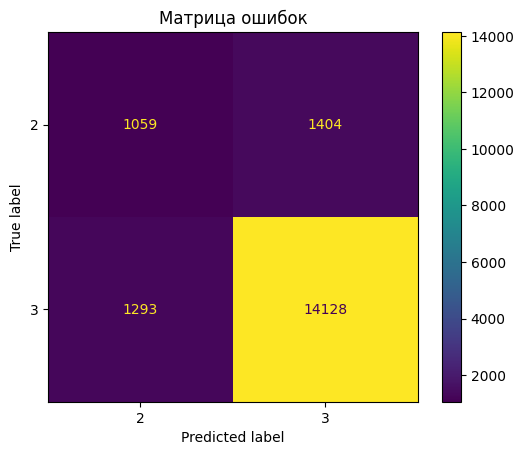

In [37]:
# модель с преподавателями
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)


df1 = pd.DataFrame()
df2 = pd.DataFrame()
flg = True
# Цикл по дисциплинам
for index, row in df_sorted.iterrows():
    if flg:
        df1 = pd.concat([df1, row.to_frame().T])

        flg = False
    else:
        df2 = pd.concat([df2, row.to_frame().T])
        flg = True

df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

visits_train = X_train['visit']
visits_test = X_test['visit']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns='visit'))
X_te = pd.get_dummies(X_test.drop(columns='visit'))

# Добавляем колонку visits обратно
X_tr['visit'] = visits_train
X_te['visit'] = visits_test

y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})


tree = DecisionTreeClassifier(random_state=46)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

accuracy = accuracy_score(y_te, y_pred)
report = classification_report(y_te, y_pred)

print(f'Accuracy: {accuracy}')

f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

print(f1_micro)
print(f1_macro)

conf_matrix(y_te, y_pred, [2, + 3])


Accuracy: 0.8511518675911429
0.8511518675911429
0.6828483833365737


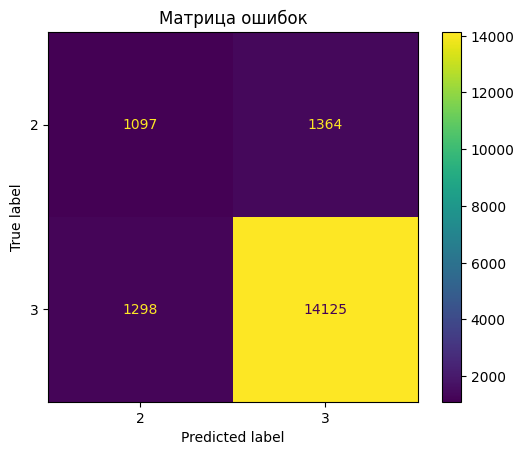

In [348]:
# с преподавателями и семом
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
#df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)


df1 = pd.DataFrame()
df2 = pd.DataFrame()
flg = True
# Цикл по дисциплинам
for index, row in df_sorted.iterrows():
    if flg:
        df1 = pd.concat([df1, row.to_frame().T])

        flg = False
    else:
        df2 = pd.concat([df2, row.to_frame().T])
        flg = True

df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)


# Применяем get_dummies ко всем остальным колонкам
#X_tr = pd.get_dummies(X_train.drop(columns='visit'))
#X_te = pd.get_dummies(X_test.drop(columns='visit'))
X_tr = pd.get_dummies(X_train.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))
X_te = pd.get_dummies(X_test.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))

# Добавляем колонку visits обратно
X_tr['visit'] = X_train['visit']
X_te['visit'] = X_test['visit']

# Добавляем колонку Группа обратно
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Добавляем колонку Семестр обратно
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']

# Добавляем колонку Курс_x обратно
X_tr['Курс'] = X_train['Курс_x']
X_te['Курс'] = X_test['Курс_x']


y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})


tree = DecisionTreeClassifier(random_state=46)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

accuracy = accuracy_score(y_te, y_pred)
report = classification_report(y_te, y_pred)

print(f'Accuracy: {accuracy}')

f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

print(f1_micro)
print(f1_macro)

conf_matrix(y_te, y_pred, [2, + 3])

In [278]:
df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 

Accuracy: 0.8807872959069559
0.8807872959069559
0.7340591241853406


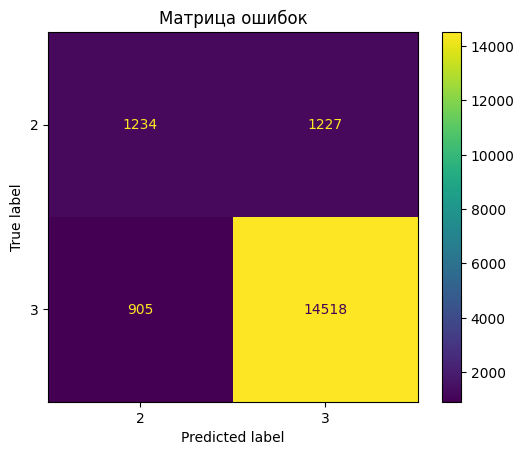

In [306]:
X_train = df1.drop(['НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

visits_train = X_train['visit']
visits_test = X_test['visit']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns='visit'))
X_te = pd.get_dummies(X_test.drop(columns='visit'))

# Добавляем колонку visits обратно
X_tr['visit'] = visits_train
X_te['visit'] = visits_test

y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})


tree = DecisionTreeClassifier(random_state=46)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

accuracy = accuracy_score(y_te, y_pred)
report = classification_report(y_te, y_pred)

print(f'Accuracy: {accuracy}')

f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

print(f1_micro)
print(f1_macro)

conf_matrix(y_te, y_pred, [2, + 3])

In [ ]:
plt.figure(figsize=(40, 20))
plot_tree(tree, 
          filled=True, 
          feature_names=X_tr.columns, 
          class_names=True, 
          rounded=True, 
          proportion=True, 
          max_depth=4,
          fontsize=12);  # Обрезаем дерево на уровне 5
#plt.tight_layout()

Accuracy: 0.8497122870359923
0.8497122870359923
0.6863901089240017


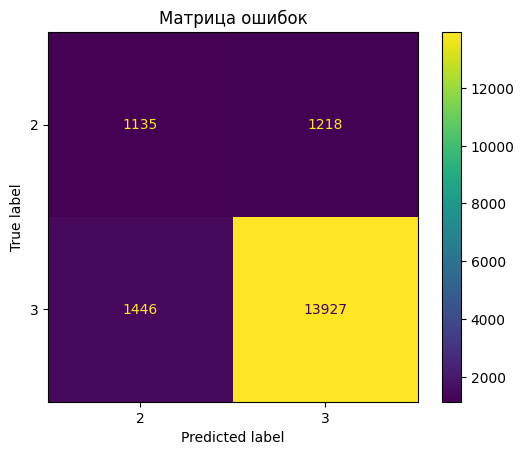

In [333]:
# попытка в рэндом форест + исключили людей 3 сема
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)


df1 = pd.DataFrame()
df2 = pd.DataFrame()
flg = True
# Цикл по дисциплинам
for index, row in df_sorted.iterrows():
    if flg:
        df1 = pd.concat([df1, row.to_frame().T])

        flg = False
    else:
        df2 = pd.concat([df2, row.to_frame().T])
        flg = True

df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

visits_train = X_train['visit']
visits_test = X_test['visit']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns='visit'))
X_te = pd.get_dummies(X_test.drop(columns='visit'))

# Добавляем колонку visits обратно
X_tr['visit'] = visits_train
X_te['visit'] = visits_test

y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# (n_estimators=100, *, criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='sqrt', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, class_weight=None, ccp_alpha=0.0, max_samples=None, monotonic_cst=None)
# RandomForestClassifier
# DecisionTreeClassifier
tree = DecisionTreeClassifier(random_state=55)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

accuracy = accuracy_score(y_te, y_pred)
report = classification_report(y_te, y_pred)

print(f'Accuracy: {accuracy}')

f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

print(f1_micro)
print(f1_macro)

conf_matrix(y_te, y_pred, [2, + 3])


In [320]:
df1['НомерЛД'].nunique()

1829

In [321]:
df2['НомерЛД'].nunique()

1829

In [324]:
df1[df1['НомерЛД'] == 120123]

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
1133,120123,3,1,Алгебра и геометрия,каф.ВМ,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,72.794118,3101,"КуляхтинаОльгаЕвгеньевна, АбжандадзеЗурабЛеван..."
1144,120123,4,2,Инженерная и компьютерная графика,каф.ПМИГ,Дифференцированный зачет,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,46.875,3101,"ТепляковаАлександраВикторовна, ХивричМарияАлек..."
1146,120123,4,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,100.0,3101,"БыковаМаринаАлексеевна, ЛьвоваАлександраВячесл..."
1149,120123,5,1,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,75.0,3101,"БыковаМаринаАлексеевна, ЛьвоваАлександраВячесл..."
1134,120123,3,1,Информатика,каф.РС,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,73.77451,3101,"АндрееваОльгаМарковна, АндрееваОльгаМарковна, ..."
1137,120123,3,2,Информационные технологии,каф.РС,К/работа,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,67.5,3101,"АндрееваОльгаМарковна, АндрееваОльгаМарковна, ..."
1142,120123,4,1,История России,каф.ИКГП,Дифференцированный зачет,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,65.508021,3101,"СтоговДмитрийИгоревич, РубцовАлексейАндреевич"
1139,120123,3,2,Математический анализ,каф.ВМ,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,71.428571,3101,"АбжандадзеЗурабЛеванович, АбжандадзеЗурабЛеван..."
1140,120123,3,2,Физика,каф.Физики,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,0.0,3101,"КозловДмитрийМихайлович, ЧургановаСерафимаСерг..."
1143,120123,4,1,Физика,каф.Физики,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,54.942025,3101,"КозловДмитрийМихайлович, ШаталоваАлександраБор..."


In [325]:
df2[df2['НомерЛД'] == 120123]

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
1136,120123,3,2,Алгебра и геометрия,каф.ВМ,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3101,"КуляхтинаОльгаЕвгеньевна, ЗивАлександрДавидович"
1145,120123,4,2,Инженерная и компьютерная графика,каф.ПМИГ,К/работа,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,46.875,3101,"ТепляковаАлександраВикторовна, ХивричМарияАлек..."
1147,120123,4,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,69.230769,3101,"БыковаМаринаАлексеевна, ЛьвоваАлександраВячесл..."
1138,120123,3,2,Информационные технологии,каф.РС,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,67.5,3101,"АндрееваОльгаМарковна, АндрееваОльгаМарковна, ..."
1135,120123,3,1,Математический анализ,каф.ВМ,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,84.375,3101,"АбжандадзеЗурабЛеванович, АбжандадзеЗурабЛеван..."
1141,120123,3,2,Физика,каф.Физики,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,61.309524,3101,"КозловДмитрийМихайлович, ЧургановаСерафимаСерг..."
1150,120123,5,1,Физическая культура и спорт,каф.ФВиС,Дифференцированный зачет,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,63.636364,3101,NaN
1148,120123,4,2,Философия,каф.ФЛ,Дифференцированный зачет,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,56.009615,3101,"ТузовВикторВасильевич, ИльинаАннаВалерьевна"


In [327]:
X_tr.columns

Index(['Семестр_1', 'Семестр_2', 'Семестр_3', 'Дисциплина_Алгебра и геометрия',
       'Дисциплина_Алгоритмы и вычислительные средства',
       'Дисциплина_Алгоритмы и структуры данных',
       'Дисциплина_Введение в коммуникационные специальности',
       'Дисциплина_Введение в предпринимательскую деятельность',
       'Дисциплина_Введение в специальность',
       'Дисциплина_Возобновляемая энергетика',
       ...
       'фио_ШияноваЕвгенияЮрьевна, ЖуравлеваЮлияВсеволодовна, АлексеенкоЕвгенияСергеевна, ВладимироваМаринаВикторовна, ИсаеваОльгаНиколаевна, ЛитвиноваЛарисаВикторовна, МалышеваВалерияНиколаевна, ПетренкоГеоргийКириллович',
       'фио_ШумковАндрейАрнольдович, ШумковАндрейАрнольдович',
       'фио_ЩегловаАлександраПавловна, НежинскаяИринаВладимировна',
       'фио_ЩегловаАлександраПавловна, ПастуховаЕленаВладимировна',
       'фио_ЩегловаАлександраПавловна, СарычевПавелАлександрович',
       'фио_ЩегловаАлександраПавловна, ЩегловаАлександраПавловна',
       'фио_ЯгьяТалиеСаи

In [349]:
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)


df1 = pd.DataFrame()
df2 = pd.DataFrame()
flg = True
# Цикл по дисциплинам
for index, row in df_sorted.iterrows():
    if flg and row['НомерЛД'] % 2 == 0:
        df1 = pd.concat([df1, row.to_frame().T])

        flg = False
    else:
        df2 = pd.concat([df2, row.to_frame().T])
        flg = True

df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

visits_train = X_train['visit']
visits_test = X_test['visit']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))
X_te = pd.get_dummies(X_test.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))

# Добавляем колонку visits обратно
X_tr['visit'] = X_train['visit']
X_te['visit'] = X_test['visit']

# Добавляем колонку Группа обратно
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Добавляем колонку Семестр обратно
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']

# Добавляем колонку Курс_x обратно
X_tr['Курс'] = X_train['Курс_x']
X_te['Курс'] = X_test['Курс_x']

y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# (n_estimators=100, *, criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='sqrt', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, class_weight=None, ccp_alpha=0.0, max_samples=None, monotonic_cst=None)
# RandomForestClassifier
# DecisionTreeClassifier
tree = DecisionTreeClassifier(random_state=55)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

accuracy = accuracy_score(y_te, y_pred)
report = classification_report(y_te, y_pred)

print(f'Accuracy: {accuracy}')

f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

print(f1_micro)
print(f1_macro)

conf_matrix(y_te, y_pred, [2, + 3])



ValueError: The feature names should match those that were passed during fit.
Feature names unseen at fit time:
- Дисциплина_Введение в коммуникационные специальности
- Дисциплина_Введение в предпринимательскую деятельность
- Дисциплина_Деловая и межличностная коммуникация
- Дисциплина_Информационные технологии и базы данных в прикладных коммуникациях
- Дисциплина_Искусство самопрезентации и деловой этикет
- ...


In [339]:
X_train

,Семестр,Дисциплина,Кафедра,Тип_Ведомости,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,visit,Группа,фио
0,1,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,24.448529,3101,"КуляхтинаОльгаЕвгеньевна, АбжандадзеЗурабЛеван..."
1,2,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,0.0,3101,"КуляхтинаОльгаЕвгеньевна, ЗивАлександрДавидович"
2,2,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,10.714286,3101,"КуляхтинаОльгаЕвгеньевна, ЗивАлександрДавидович"
3,2,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,82.619048,3104,"КуляхтинаОльгаЕвгеньевна, ПустоваяЮлияВалериевна"
4,2,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,42.857143,3104,"КуляхтинаОльгаЕвгеньевна, ПустоваяЮлияВалериевна"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,2,Экология,каф.ИЗОС,Дифференцированный зачет,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,6.25,3681,"ХрамовАлексейВладимирович, СоколовАлексей."
887,2,Экология,каф.ИЗОС,Дифференцированный зачет,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,0.0,3681,"ХрамовАлексейВладимирович, СоколовАлексей."
888,2,Экология,каф.ИЗОС,Дифференцированный зачет,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,0.0,3682,"ХрамовАлексейВладимирович, СоколовАлексей."
889,2,Экология,каф.ИЗОС,Дифференцированный зачет,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,0.0,3691,"ХрамовАлексейВладимирович, СоколовАлексей."


In [350]:
X_test

,Семестр,Дисциплина,Кафедра,Тип_Ведомости,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,visit,Группа,фио
0,1,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,72.794118,3101,"КуляхтинаОльгаЕвгеньевна, АбжандадзеЗурабЛеван..."
1,1,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,78.860294,3101,"КуляхтинаОльгаЕвгеньевна, АбжандадзеЗурабЛеван..."
2,1,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,63.970588,3101,"КуляхтинаОльгаЕвгеньевна, АбжандадзеЗурабЛеван..."
3,1,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,33.639706,3101,"КуляхтинаОльгаЕвгеньевна, АбжандадзеЗурабЛеван..."
4,1,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,87.683824,3101,"КуляхтинаОльгаЕвгеньевна, АбжандадзеЗурабЛеван..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34555,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,56.25,3691,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
34556,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,43.75,3691,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
34557,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,68.75,3691,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
34558,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,56.25,3692,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."


In [354]:
!pip3 install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.0/27.0 MB 11.3 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.7/13.7 MB 10.1 MB/s eta 0:00:00 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.1/19.1 MB 15.3 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: numpy
    Found existing installation: numpy 2.1.1
    Uninstalling numpy-2.1.1:
      Successfully uninstalled numpy-2.1.1


In [356]:
pip install --upgrade numpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 10.2 MB/s eta 0:00:00 0:00:01
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
catboost 1.2.7 requires numpy<2.0,>=1.16.0, but you have numpy 2.1.2 which is incompatible.
Note: you may need to restart the kernel to use updated packages.


In [357]:
from catboost import CatBoostClassifier

df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)


df1 = pd.DataFrame()
df2 = pd.DataFrame()
flg = True
# Цикл по дисциплинам
for index, row in df_sorted.iterrows():
    if flg and row['НомерЛД'] % 2 == 0:
        df1 = pd.concat([df1, row.to_frame().T])

        flg = False
    else:
        df2 = pd.concat([df2, row.to_frame().T])
        flg = True

df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)



y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# (n_estimators=100, *, criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='sqrt', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, class_weight=None, ccp_alpha=0.0, max_samples=None, monotonic_cst=None)
# RandomForestClassifier
# DecisionTreeClassifier

model = CatBoostClassifier(cat_features=[1, 2, 3, 4, 6, 7, 8, 9, 10, 13])
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f'Accuracy: {accuracy}')

f1_macro = f1_score(y_test, y_pred, average='macro')
f1_micro = f1_score(y_test, y_pred, average='micro')

print(f1_micro)
print(f1_macro)

conf_matrix(y_test, y_pred, [2, + 3])

#model = CatBoostClassifier(cat_features=[0, 2, 5])  # Индексы категориальных признаков
#model.fit(X_train, y_train)


ValueError: numpy.dtype size changed, may indicate binary incompatibility. Expected 96 from C header, got 88 from PyObject

In [351]:
X_train

,Семестр,Дисциплина,Кафедра,Тип_Ведомости,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,visit,Группа,фио
0,1,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,24.448529,3101,"КуляхтинаОльгаЕвгеньевна, АбжандадзеЗурабЛеван..."
1,2,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,0.0,3101,"КуляхтинаОльгаЕвгеньевна, ЗивАлександрДавидович"
2,2,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,10.714286,3101,"КуляхтинаОльгаЕвгеньевна, ЗивАлександрДавидович"
3,2,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,82.619048,3104,"КуляхтинаОльгаЕвгеньевна, ПустоваяЮлияВалериевна"
4,2,Алгебра и геометрия,каф.ВМ,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,42.857143,3104,"КуляхтинаОльгаЕвгеньевна, ПустоваяЮлияВалериевна"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,2,Экология,каф.ИЗОС,Дифференцированный зачет,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,6.25,3681,"ХрамовАлексейВладимирович, СоколовАлексей."
887,2,Экология,каф.ИЗОС,Дифференцированный зачет,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,0.0,3681,"ХрамовАлексейВладимирович, СоколовАлексей."
888,2,Экология,каф.ИЗОС,Дифференцированный зачет,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,0.0,3682,"ХрамовАлексейВладимирович, СоколовАлексей."
889,2,Экология,каф.ИЗОС,Дифференцированный зачет,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,0.0,3691,"ХрамовАлексейВладимирович, СоколовАлексей."


,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
0,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,89.727093,3182,"МалышевМихаилНиколаевич, ШаталоваАлександраБор..."
1,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,66.666667,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
2,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,95.396825,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
3,10123,4,1,Алгебра и геометрия,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,84.926471,3182,"ЛычагинаЕленаБорисовна, РомановаЮлияСтаниславовна"
4,10123,4,1,Математический анализ,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,91.176471,3182,"РомановаЮлияСтаниславовна, РомановаЮлияСтанисл..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35763,10280323,3,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3354,NaN
35764,10280323,4,1,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,73.333333,3354,NaN
35765,10280323,4,2,Информационные технологии,каф.САПР,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3.571429,3354,"КопецЕкатеринаЕвгеньевна, КопецЕкатеринаЕвгень..."
35766,10280323,5,1,Физическая культура и спорт,каф.ФВиС,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,66.666667,3354,NaN


Accuracy: 0.8317026573264633
0.8317026573264633
0.6573099190106633


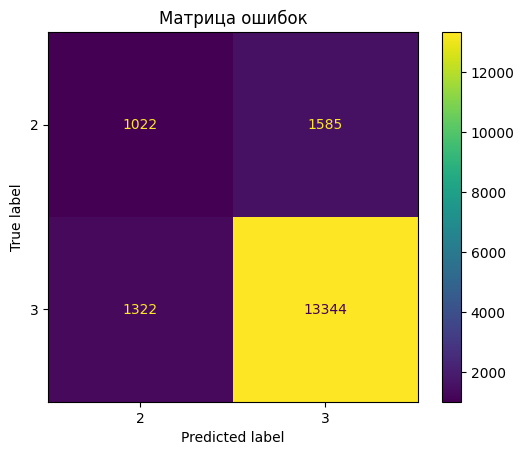

In [371]:
# Студенты разделены по четности ID ЛК
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект') & (df_sorted['Кафедра'] != 'каф.ИБ')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)


df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]


df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

visits_train = X_train['visit']
visits_test = X_test['visit']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))
X_te = pd.get_dummies(X_test.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))

# Добавляем колонку visits обратно
X_tr['visit'] = X_train['visit']
X_te['visit'] = X_test['visit']

# Добавляем колонку Группа обратно
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Добавляем колонку Семестр обратно
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']

# Добавляем колонку Курс_x обратно
X_tr['Курс'] = X_train['Курс_x']
X_te['Курс'] = X_test['Курс_x']

y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# (n_estimators=100, *, criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='sqrt', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, class_weight=None, ccp_alpha=0.0, max_samples=None, monotonic_cst=None)
# RandomForestClassifier
# DecisionTreeClassifier
tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

accuracy = accuracy_score(y_te, y_pred)
report = classification_report(y_te, y_pred)

print(f'Accuracy: {accuracy}')

f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

print(f1_micro)
print(f1_macro)

conf_matrix(y_te, y_pred, [2, + 3])

In [365]:
df2['НомерЛД'].nunique()

893

In [366]:
df1['НомерЛД'].nunique()

936

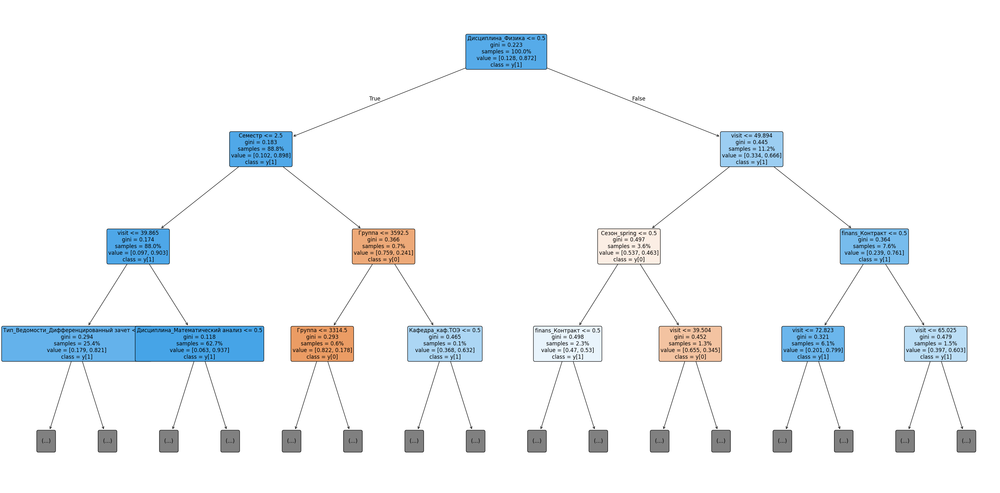

In [368]:
plt.figure(figsize=(40, 20))
plot_tree(tree, 
          filled=True, 
          feature_names=X_tr.columns, 
          class_names=True, 
          rounded=True, 
          proportion=True, 
          max_depth=3,
          fontsize=12);  # Обрезаем дерево на уровне 5
#plt.tight_layout()


Accuracy: 0.8314710820355468
0.8314710820355468
0.6543928599268367


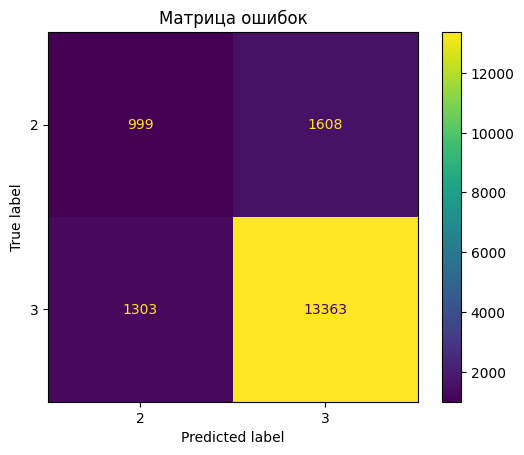

In [372]:
# Студенты разделены по четности ID ЛК
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект') & (df_sorted['Кафедра'] != 'каф.ИБ')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)


df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]


df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

visits_train = X_train['visit']
visits_test = X_test['visit']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))
X_te = pd.get_dummies(X_test.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))

# Добавляем колонку visits обратно
X_tr['visit'] = X_train['visit']
X_te['visit'] = X_test['visit']

# Добавляем колонку Группа обратно
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Добавляем колонку Семестр обратно
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']


y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# (n_estimators=100, *, criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='sqrt', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, class_weight=None, ccp_alpha=0.0, max_samples=None, monotonic_cst=None)
# RandomForestClassifier
# DecisionTreeClassifier
tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

accuracy = accuracy_score(y_te, y_pred)
report = classification_report(y_te, y_pred)

print(f'Accuracy: {accuracy}')

f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

print(f1_micro)
print(f1_macro)

conf_matrix(y_te, y_pred, [2, + 3])

In [375]:
check = X_te
check['res'] = y_te
check['pred'] = y_pred
check['id'] = df2['ID ЛК']

In [376]:
check

,Иностранец,Дисциплина_Алгебра и геометрия,Дисциплина_Алгоритмы и вычислительные средства,Дисциплина_Введение в коммуникационные специальности,Дисциплина_Введение в предпринимательскую деятельность,Дисциплина_Введение в специальность,Дисциплина_Деловая и межличностная коммуникация,Дисциплина_Древние языки и культуры,Дисциплина_Инженерная графика,Дисциплина_Инженерная и компьютерная графика,...,"фио_ЩегловаАлександраПавловна, ЩегловаАлександраПавловна","фио_ЯгьяТалиеСаидовна, БарановаЛюбовьЮрьевна","фио_ЯгьяТалиеСаидовна, МошновАлександрНиколаевич","фио_ЯгьяТалиеСаидовна, ЯковлевАлександрИванович",visit,Группа,Семестр,res,pred,id
0,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,72.794118,3101,1,3,3,418323.0
1,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,78.860294,3101,1,3,3,418323.0
2,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,24.448529,3101,1,3,3,418323.0
3,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,63.970588,3101,1,3,3,418323.0
4,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,87.683824,3101,1,3,3,418323.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17268,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,56.250000,3691,2,3,3,NaN
17269,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,37.500000,3691,2,3,3,NaN
17270,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,50.000000,3691,2,3,3,NaN
17271,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,56.250000,3691,2,3,3,NaN


In [380]:
ch = check.groupby('id').agg({'res' : 'mean', 'pred' : 'mean'})
 

In [384]:
ch['res'] = ch['res'].apply(np.floor)
ch['pred'] = ch['pred'].apply(np.floor)

In [385]:
ch

,res,pred
id,,
380905.0,2.0,2.0
382801.0,2.0,2.0
383979.0,2.0,2.0
385773.0,3.0,3.0
385847.0,3.0,2.0
...,...,...
418545.0,3.0,2.0
418563.0,3.0,3.0
418569.0,2.0,2.0


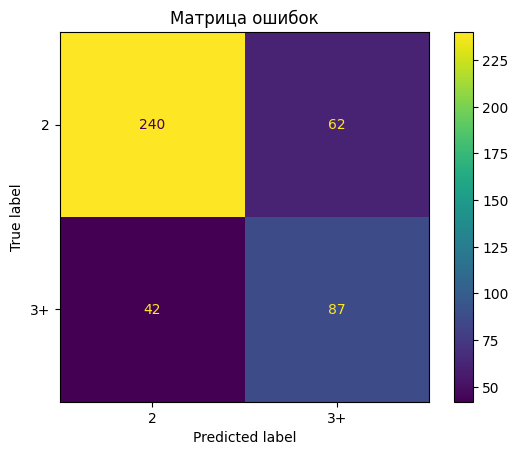

In [387]:
conf_matrix(ch['res'], ch['pred'], ['2', '3+'])

In [48]:
# Студенты разделены по четности ID ЛК - разделим по дисциплинам
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект') & (df_sorted['Кафедра'] != 'каф.ИБ')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)

df_subjects = get_subj(df)

for value in df_subjects:
    df_sorted = df_subjects[df_subjects['Дисциплина'] == value]
    df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
    df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]
    
    
    df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
    X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
    y_train = df1['ПерваяПопытка'].reset_index(drop=True)
    
    X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
    y_test = df2['ПерваяПопытка'].reset_index(drop=True)
    
    visits_train = X_train['visit']
    visits_test = X_test['visit']
    
    # Применяем get_dummies ко всем остальным колонкам
    X_tr = pd.get_dummies(X_train.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))
    X_te = pd.get_dummies(X_test.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))
    
    # Добавляем колонку visits обратно
    X_tr['visit'] = X_train['visit']
    X_te['visit'] = X_test['visit']
    
    # Добавляем колонку Группа обратно
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    
    # Добавляем колонку Семестр обратно
    X_tr['Семестр'] = X_train['Семестр']
    X_te['Семестр'] = X_test['Семестр']
    
    # Добавляем колонку Курс_x обратно
    X_tr['Курс'] = X_train['Курс_x']
    X_te['Курс'] = X_test['Курс_x']
    
    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})
    
    # (n_estimators=100, *, criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='sqrt', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, class_weight=None, ccp_alpha=0.0, max_samples=None, monotonic_cst=None)
    # RandomForestClassifier
    # DecisionTreeClassifier
    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    
    y_pred = tree.predict(X_te)
    
    accuracy = accuracy_score(y_te, y_pred)
    report = classification_report(y_te, y_pred)

    print(df_sorted['Дисциплина'])
    print(f'Accuracy: {accuracy}')
    
    f1_macro = f1_score(y_te, y_pred, average='macro')
    f1_micro = f1_score(y_te, y_pred, average='micro')
    
    print(f1_micro)
    print(f1_macro)
    
    #conf_matrix(y_te, y_pred, [2, + 3])

KeyError: 'Дисциплина'

In [2]:
def get_subj(df):
    df_subj_dict = {}
    
    for subj in df['Дисциплина'].unique():
        subj_df = df[df['Дисциплина'] == subj]

        df_subj_dict[subj] = subj_df

    return df_subj_dict

#df_subj_dataframes = get_subj(df)

In [32]:
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект') & (df_sorted['Кафедра'] != 'каф.ИБ') & (df_sorted['Кафедра'] != 'каф.ТВ')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)

df_subjects = get_subj(df_sorted)
f1_array = []

for value in df_subjects:
    df_sorted = df_subjects[value]  # Теперь мы просто берем соответствующий DataFrame по ключу `value`, т.е. имени дисциплины.

    # Разделение на чётные и нечётные по 'ID ЛК'
    df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
    df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]
    
    # Исключаем определённое значение в колонке 'фио'
    df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
    
    # Подготовка тренировочных и тестовых данных
    X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
    y_train = df1['ПерваяПопытка'].reset_index(drop=True)
    
    X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
    y_test = df2['ПерваяПопытка'].reset_index(drop=True)
    
    visits_train = X_train['visit']
    visits_test = X_test['visit']
    
    # Применяем get_dummies ко всем остальным колонкам
    X_tr = pd.get_dummies(X_train.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x', 'finans']))
    X_te = pd.get_dummies(X_test.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x', 'finans']))
    
    # Добавляем колонку 'visit' обратно
    X_tr['visit'] = X_train['visit']
    X_te['visit'] = X_test['visit']
    
    # Добавляем остальные колонки обратно
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    
    X_tr['Семестр'] = X_train['Семестр']
    X_te['Семестр'] = X_test['Семестр']
    
    X_tr['Курс'] = X_train['Курс_x']
    X_te['Курс'] = X_test['Курс_x']
    
    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})
    
    # Создаём и обучаем дерева решений
    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    
    # Предсказания на тестовых данных
    y_pred = tree.predict(X_te)
    
    # Оценка качества модели
    #accuracy = accuracy_score(y_te, y_pred)
    #report = classification_report(y_te, y_pred)

    print(f'Дисциплина: {value}')
    #print(f'Accuracy: {accuracy}')
    
    f1_macro = f1_score(y_te, y_pred, average='macro')
    f1_micro = f1_score(y_te, y_pred, average='micro')
    
    #print(f'F1-score (micro): {f1_micro}')
    print(f'F1-score (macro): {f1_macro}')
    f1_array.append(f1_micro)

Дисциплина: Алгебра и геометрия
F1-score (macro): 0.6175820970794736
Дисциплина: Алгоритмы и вычислительные средства
F1-score (macro): 0.7049793085035376
Дисциплина: Введение в коммуникационные специальности
F1-score (macro): 1.0
Дисциплина: Введение в предпринимательскую деятельность
F1-score (macro): 1.0
Дисциплина: Введение в специальность
F1-score (macro): 0.7314814814814814
Дисциплина: Деловая и межличностная коммуникация
F1-score (macro): 0.6282051282051282
Дисциплина: Древние языки и культуры
F1-score (macro): 0.4639175257731959
Дисциплина: Инженерная графика
F1-score (macro): 0.7454344216934146
Дисциплина: Инженерная и компьютерная графика
F1-score (macro): 0.6633292383292383
Дисциплина: Иностранный язык
F1-score (macro): 0.5591888053840927
Дисциплина: Информатика
F1-score (macro): 0.5700457544892281
Дисциплина: Информационные технологии
F1-score (macro): 0.62734110540968
Дисциплина: Информационные технологии в управлении предприятием
F1-score (macro): 0.43243243243243246
Дисци

In [64]:
print('среднее', np.mean(f1_array))
print('медиана', np.median(f1_array))

среднее 0.901144592436916
медиана 0.9342891278375149


In [39]:
def get_subj(df):
    df_subj_dict = {}
    
    for subj in df['Дисциплина'].unique():
        subj_df = df[df['Дисциплина'] == subj]

        df_subj_dict[subj] = subj_df

    return df_subj_dict

df_subj_dataframes = get_subj(df)
df_subj_dataframes

{'Физика':          НомерЛД  ПерваяПопытка  Семестр Дисциплина     Кафедра  \
 27         10123              3        1     Физика  каф.Физики   
 28         10123              3        2     Физика  каф.Физики   
 29         10123              3        2     Физика  каф.Физики   
 81         10223              3        1     Физика  каф.Физики   
 87         10223              3        2     Физика  каф.Физики   
 ...          ...            ...      ...        ...         ...   
 154800  10090323              3        1     Физика  каф.Физики   
 154849  10240323              3        2     Физика  каф.Физики   
 154851  10240323              4        1     Физика  каф.Физики   
 154869  10280323              2        1     Физика  каф.Физики   
 154875  10280323              2        2     Физика  каф.Физики   
 
                    Тип_Ведомости     ID ЛК  Иностранец  Курс    finans  \
 27                       Экзамен  418323.0       False   1.0    Бюджет   
 28                   

In [55]:
w_teach[w_teach['Дисциплина'] == 'Введение в предпринимательскую деятельность']

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
244,30623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417368.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,67.857143,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
520,60623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417308.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,60.714286,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
1216,120623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,416746.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,46.428571,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
1338,130623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417550.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,67.857143,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
1602,150623,5,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417568.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,71.428571,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
3692,340623,5,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,418002.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,75.000000,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
4291,400623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,416549.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,67.857143,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
6094,580623,5,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417574.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
6370,600623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,418460.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,64.285714,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
8633,810623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417847.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,75.000000,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."


In [56]:
df_subjects['Введение в предпринимательскую деятельность']

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
244,30623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417368.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,67.857143,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
520,60623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417308.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,60.714286,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
1216,120623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,416746.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,46.428571,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
1338,130623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417550.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,67.857143,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
1602,150623,5,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417568.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,71.428571,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
3692,340623,5,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,418002.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,75.000000,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
4291,400623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,416549.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,67.857143,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
6094,580623,5,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417574.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
6370,600623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,418460.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,64.285714,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."
8633,810623,4,2,Введение в предпринимательскую деятельность,каф.ПЭ,Дифференцированный зачет,417847.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,75.000000,3603,"КулибановаВалерияВадимовна, КулибановаВалерияВ..."


Дисциплина: Алгебра и геометрия
F1-score (macro): 0.6175820970794736


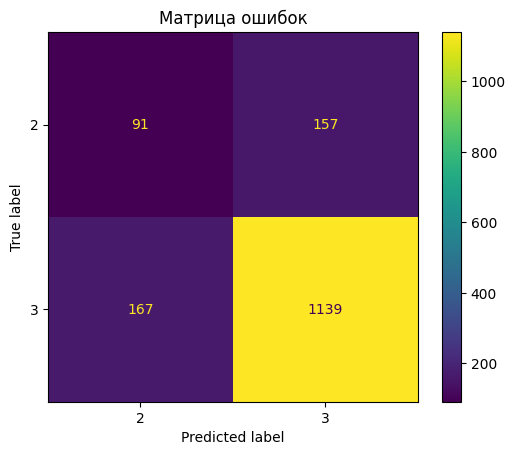

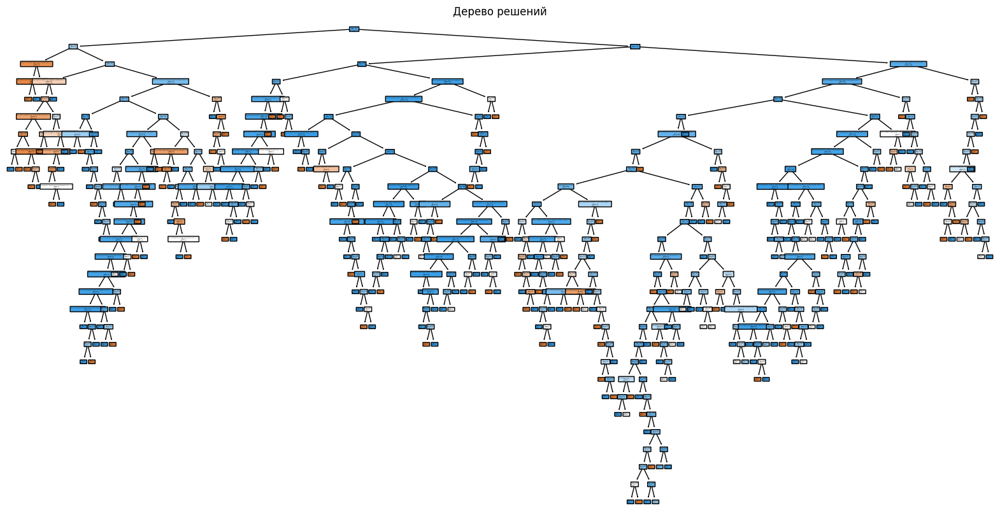

Дисциплина: Алгоритмы и вычислительные средства
F1-score (macro): 0.7049793085035376


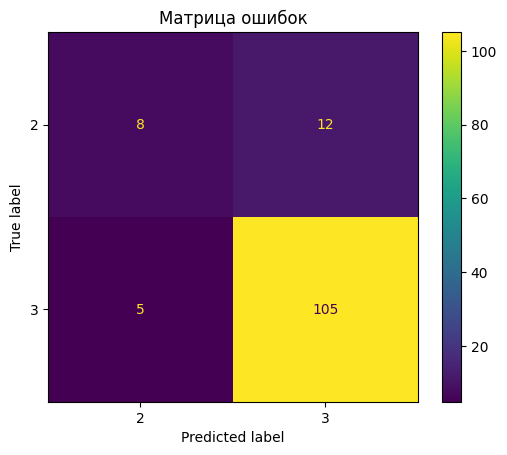

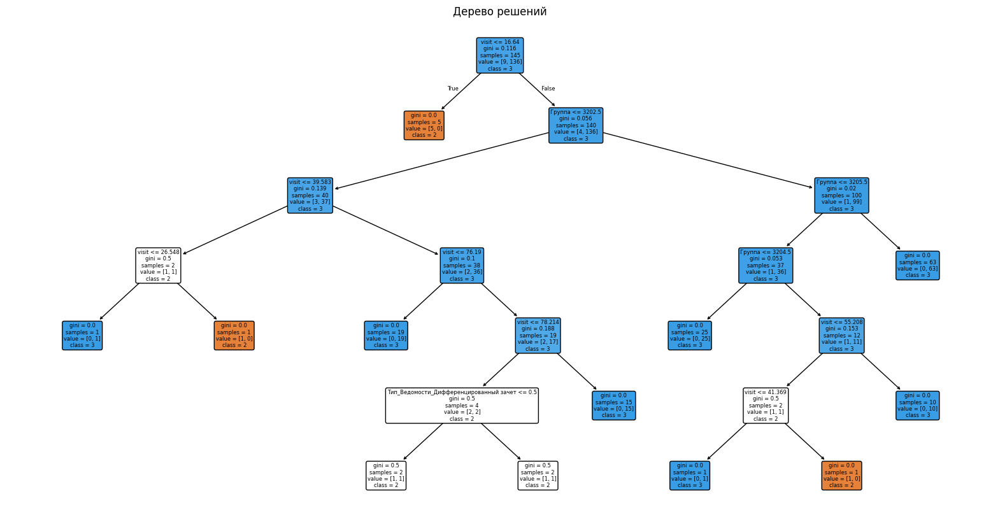

Дисциплина: Введение в коммуникационные специальности
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


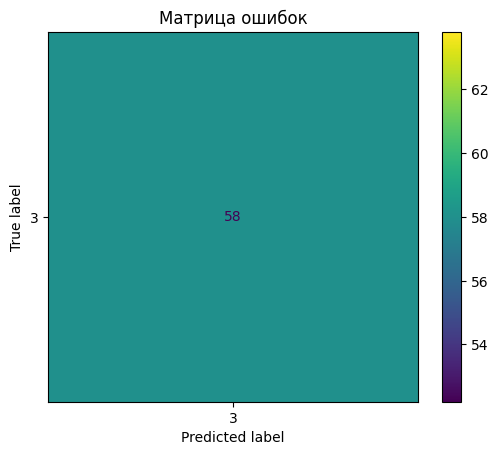

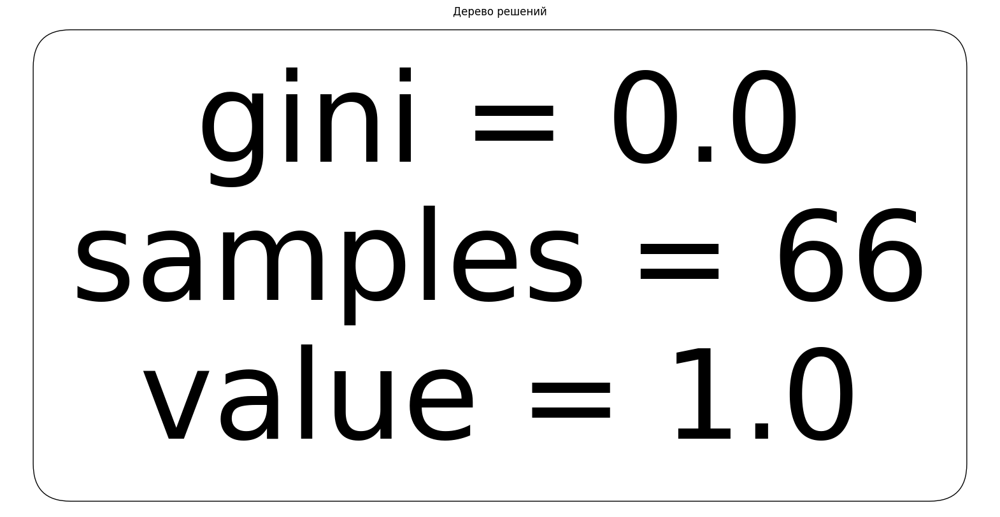

Дисциплина: Введение в предпринимательскую деятельность
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


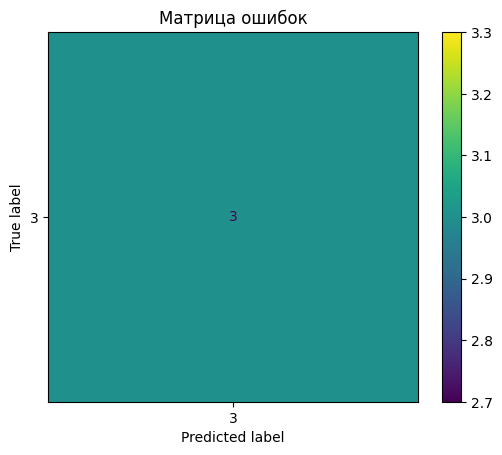

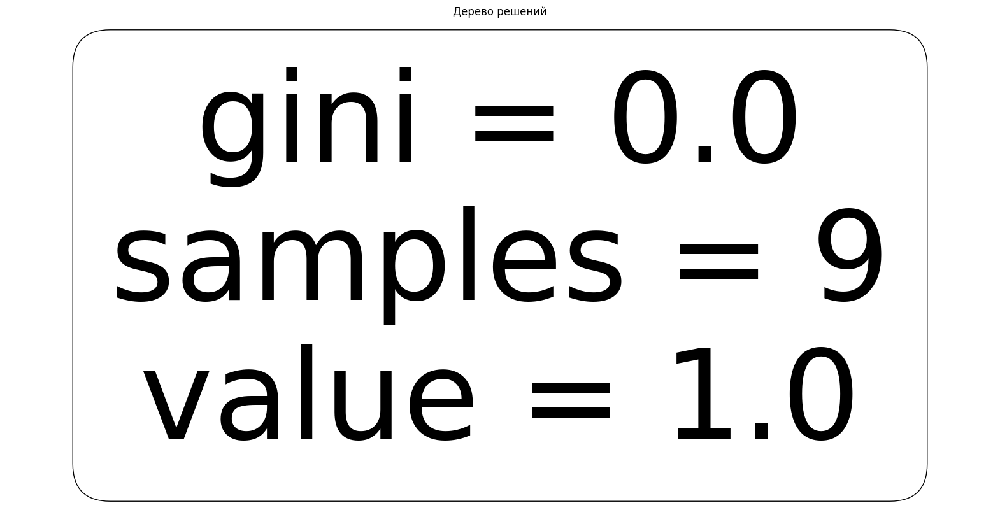

Дисциплина: Введение в специальность
F1-score (macro): 0.7314814814814814


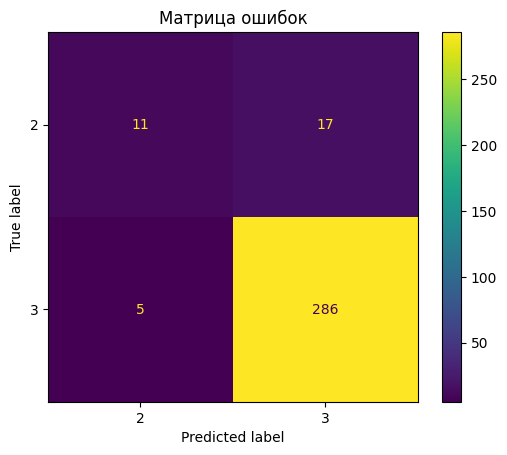

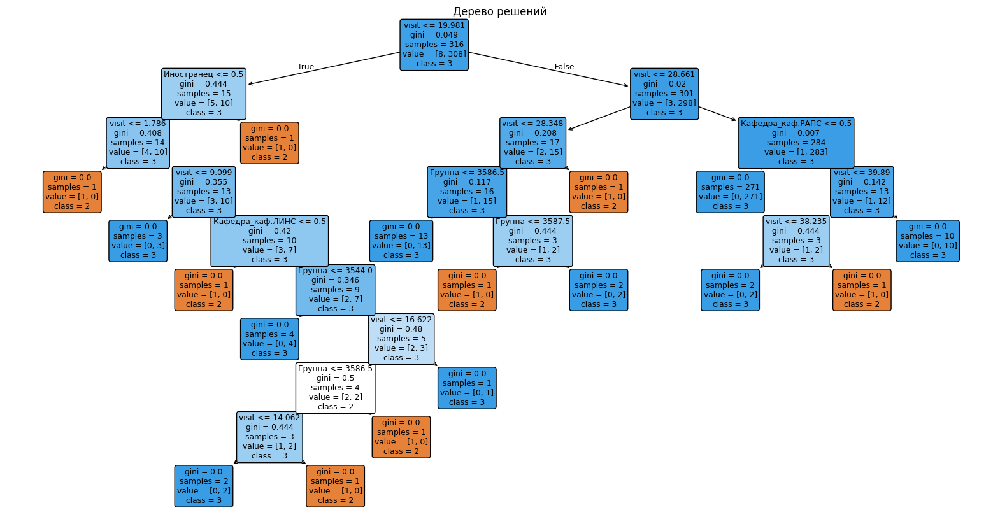

Дисциплина: Деловая и межличностная коммуникация
F1-score (macro): 0.6282051282051282


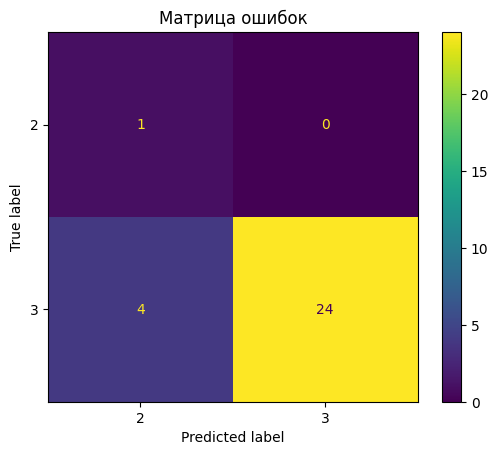

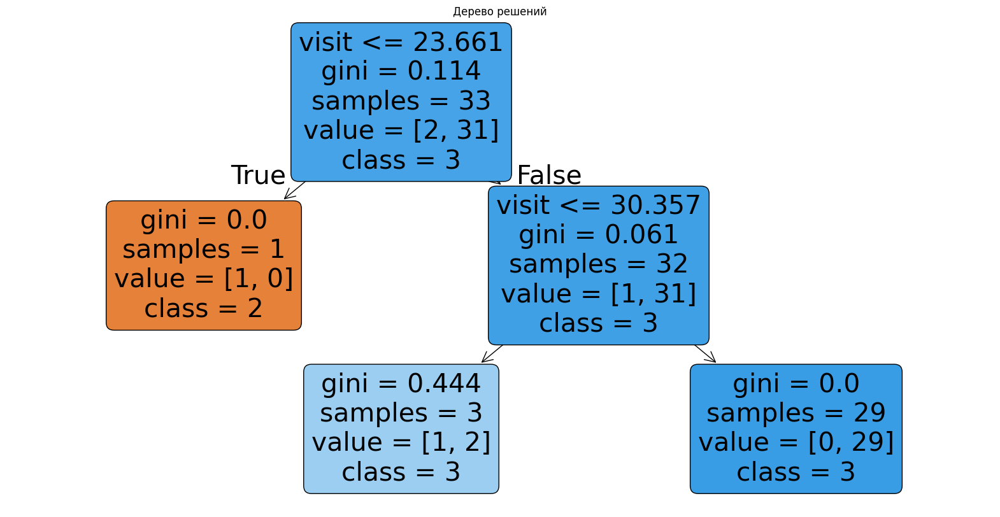

Дисциплина: Древние языки и культуры
F1-score (macro): 0.4639175257731959


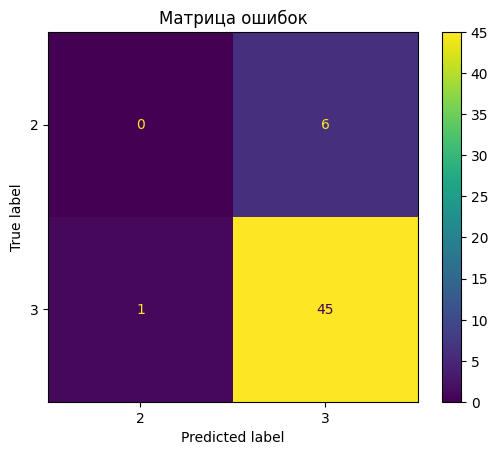

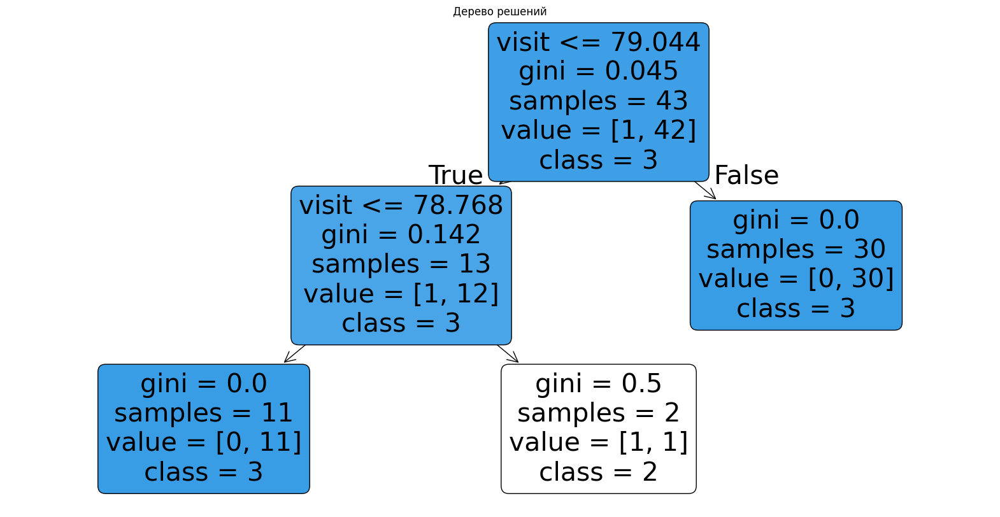

Дисциплина: Инженерная графика
F1-score (macro): 0.7454344216934146


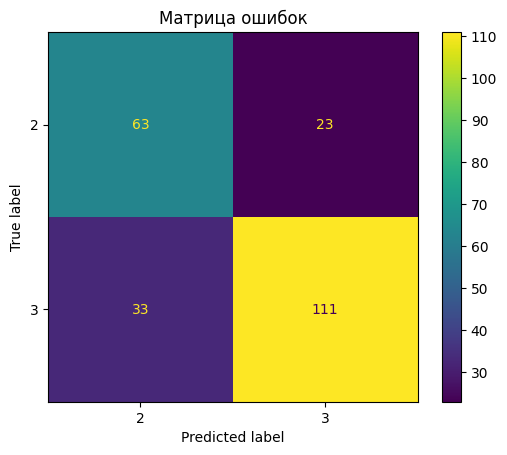

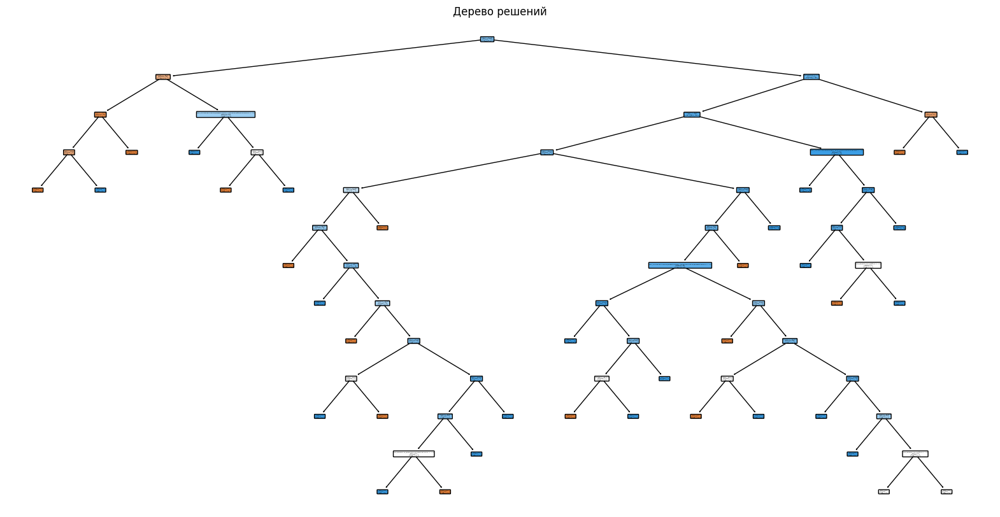

Дисциплина: Инженерная и компьютерная графика
F1-score (macro): 0.6633292383292383


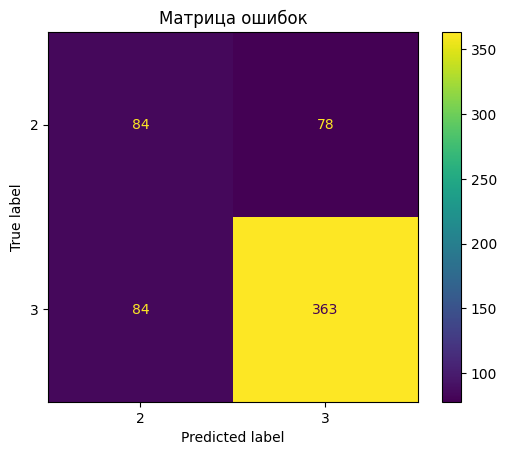

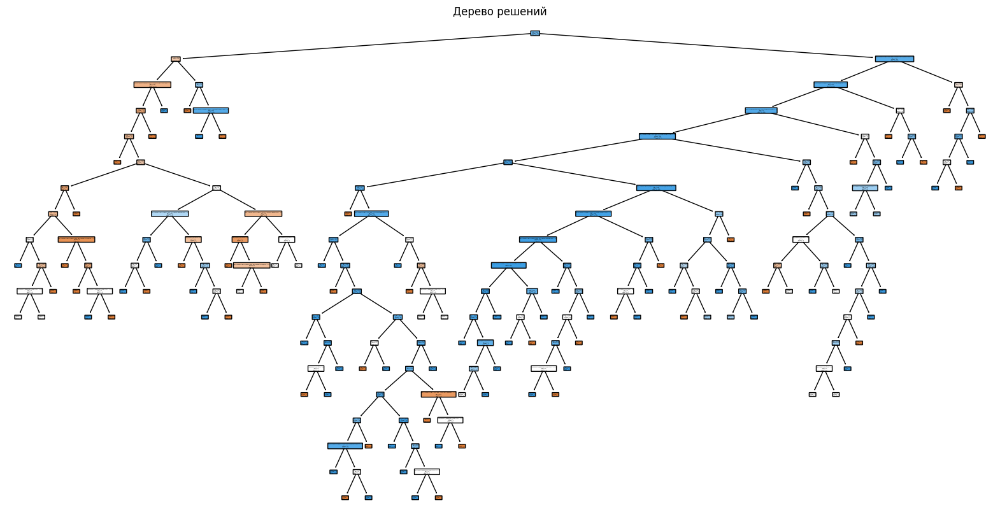

Дисциплина: Иностранный язык
F1-score (macro): 0.5591888053840927


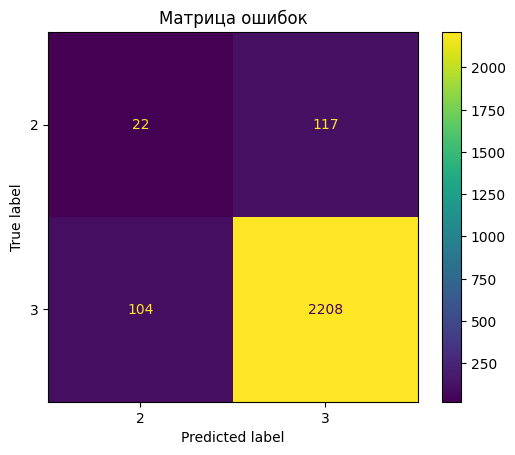

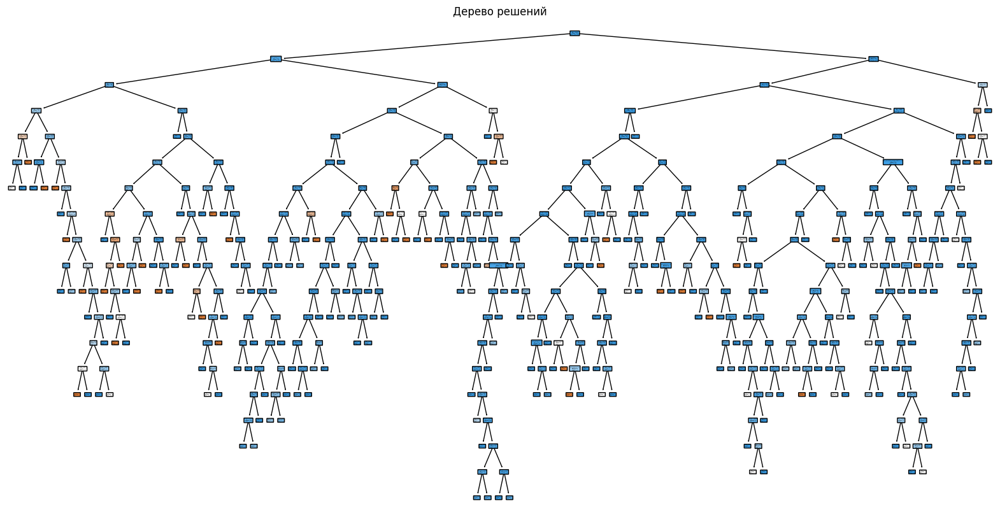

Дисциплина: Информатика
F1-score (macro): 0.5700457544892281


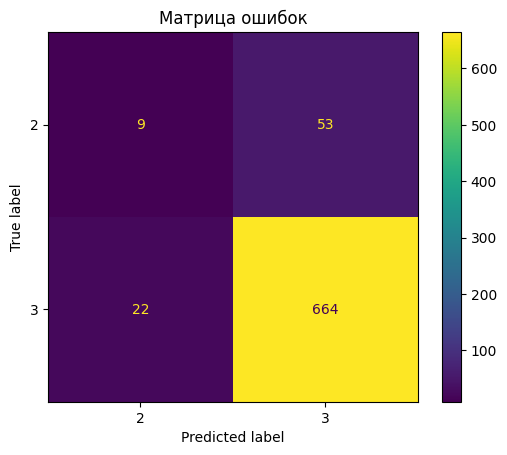

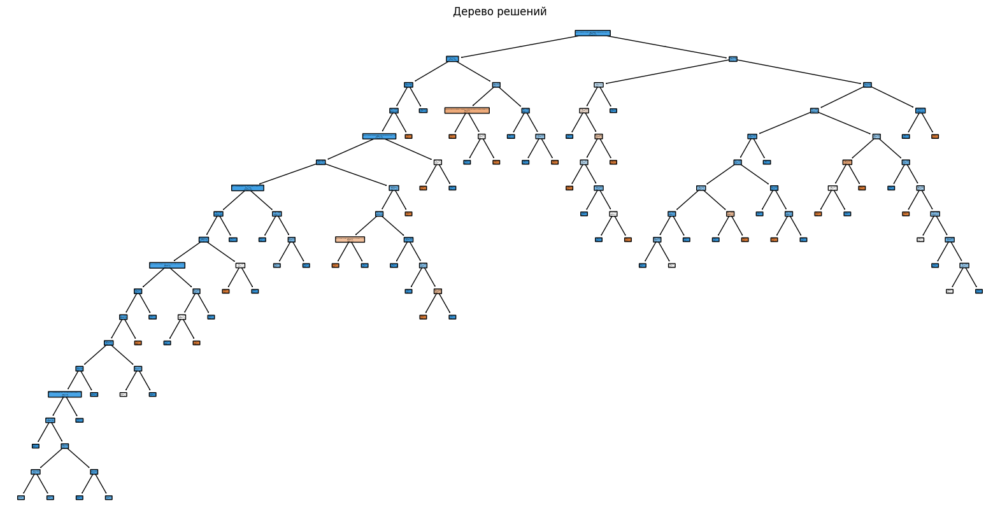

Дисциплина: Информационные технологии
F1-score (macro): 0.62734110540968


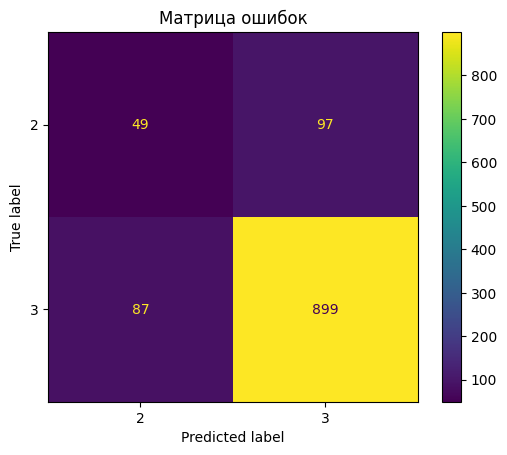

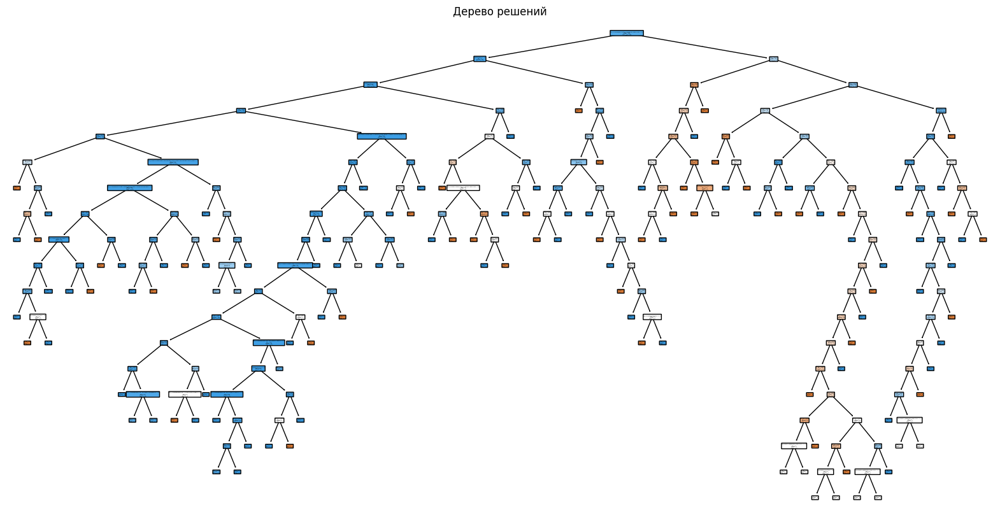

Дисциплина: Информационные технологии в управлении предприятием
F1-score (macro): 0.43243243243243246


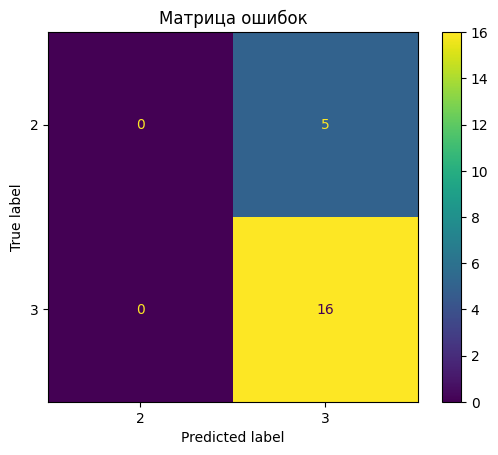

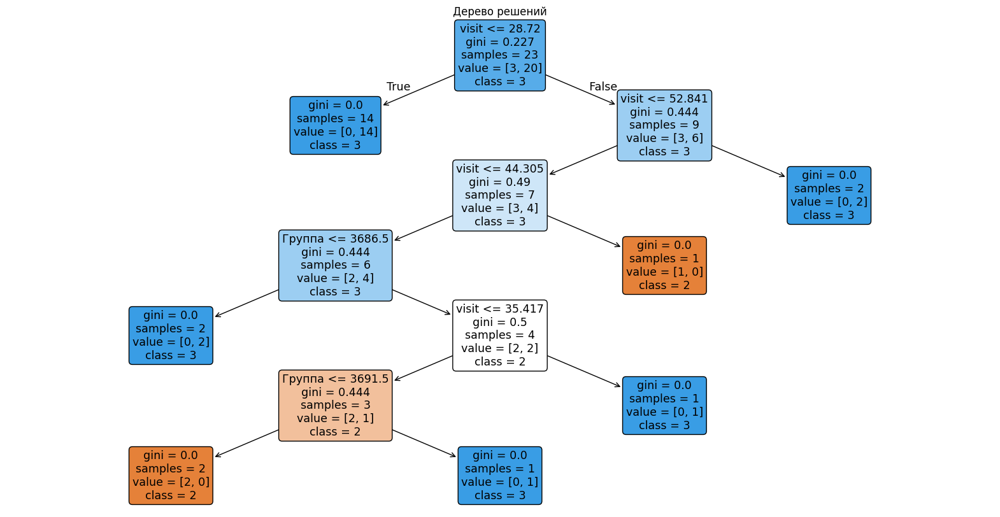

Дисциплина: Информационные технологии и базы данных в прикладных коммуникациях
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


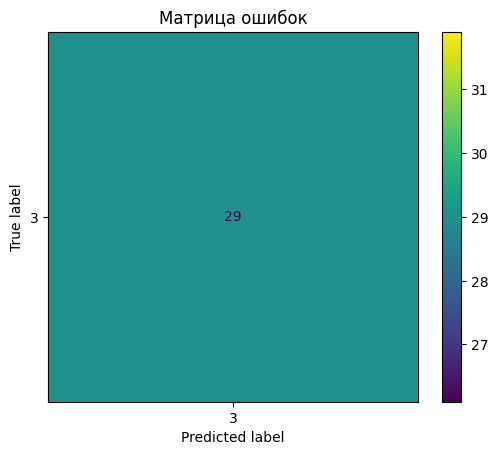

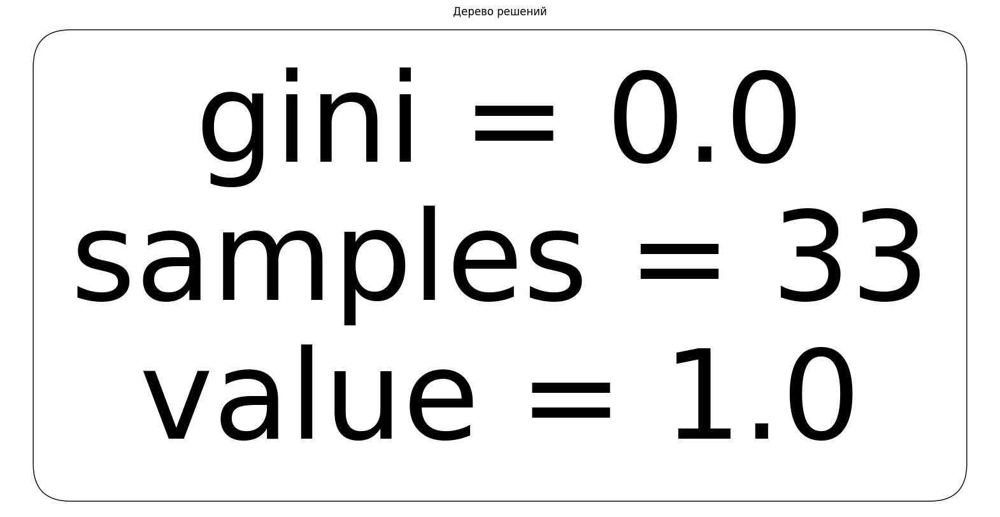

Дисциплина: Искусство самопрезентации и деловой этикет
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


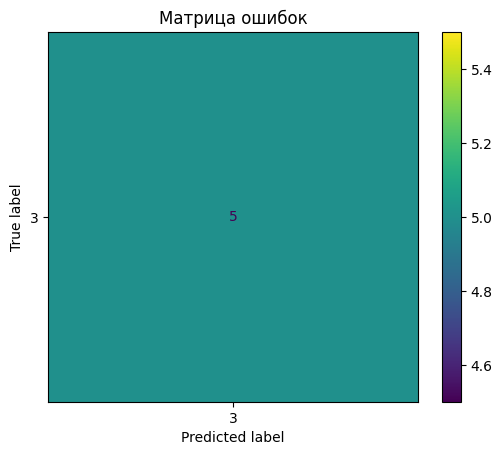

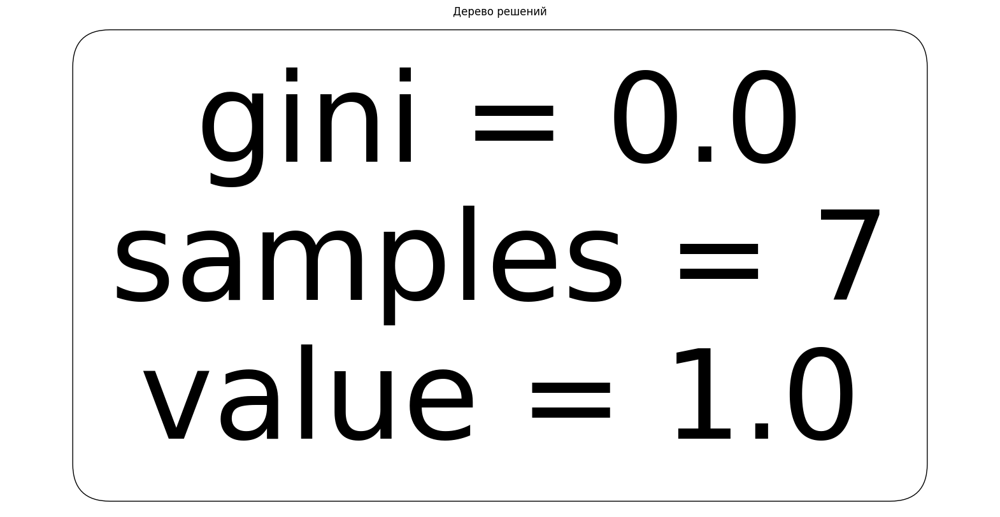

Дисциплина: История России
F1-score (macro): 0.5983269961977187


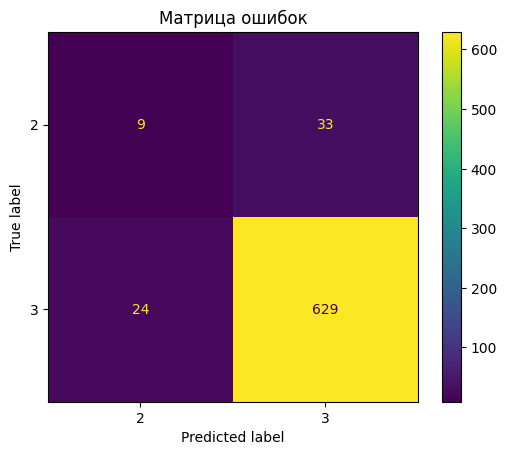

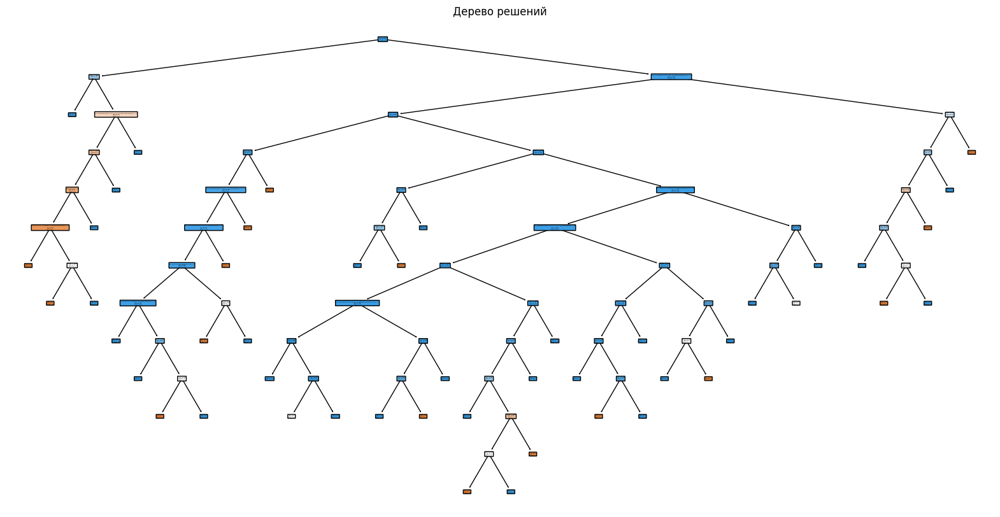

Дисциплина: История литературы
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


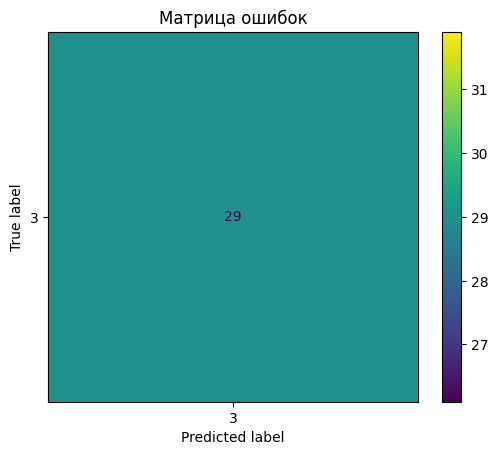

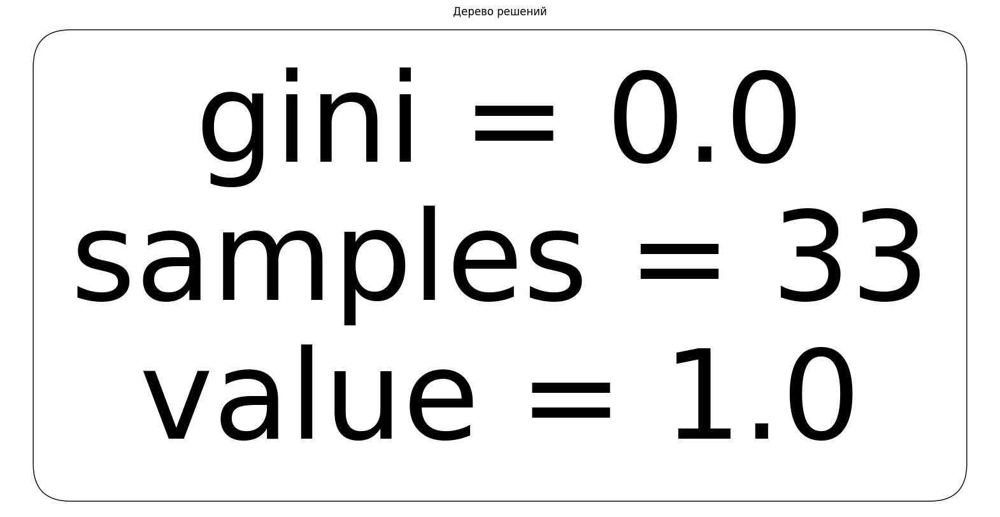

Дисциплина: Культурология
F1-score (macro): 0.4774193548387097


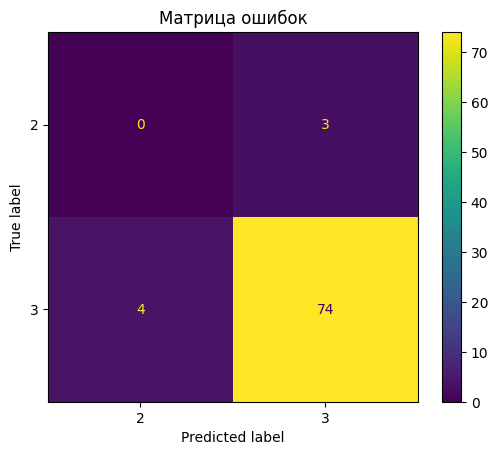

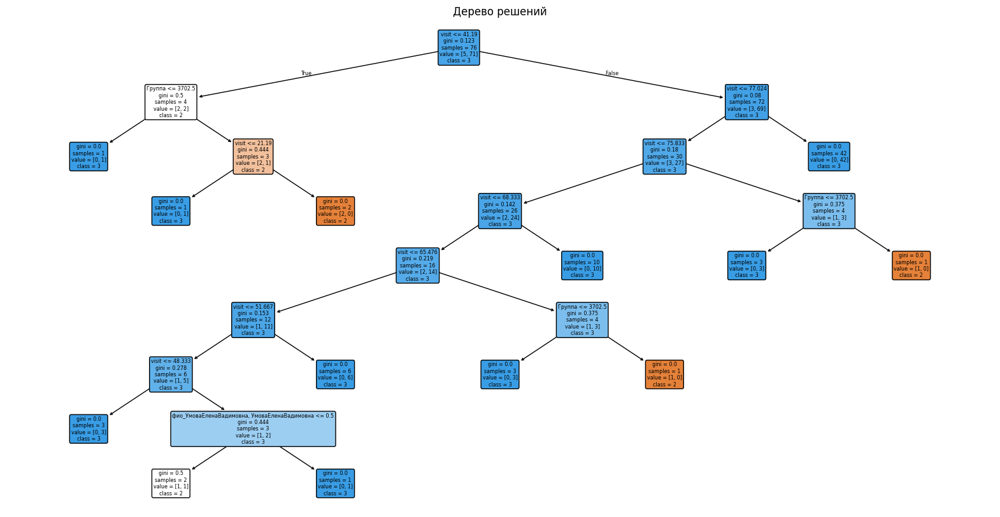

Дисциплина: Лингвистические направления
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


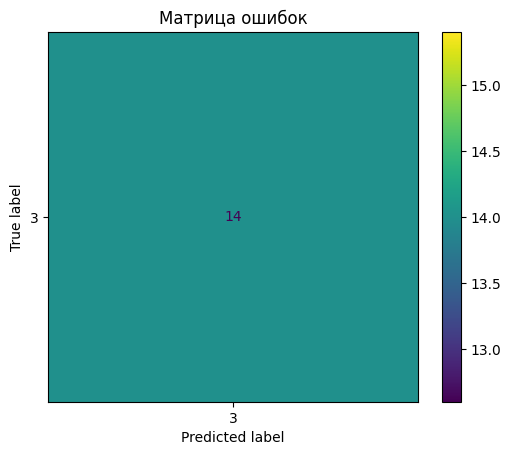

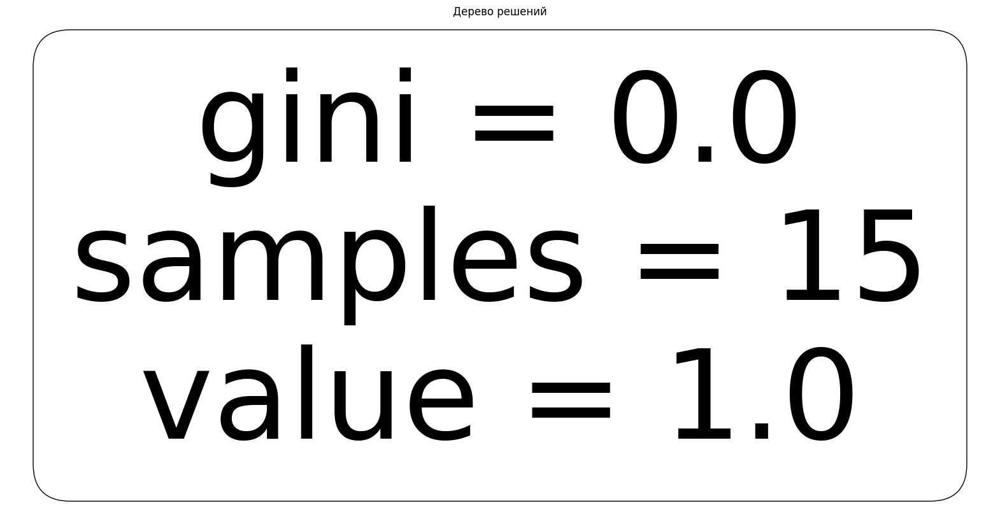

Дисциплина: Лингвистические школы
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


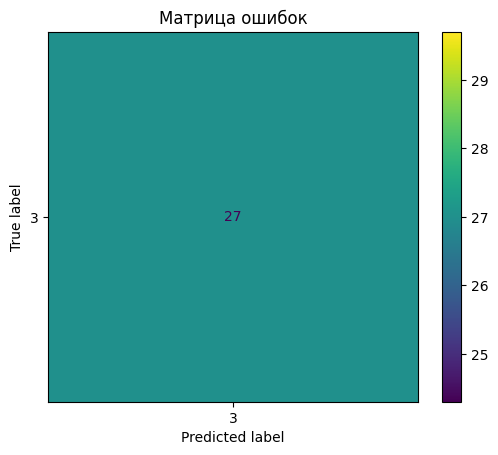

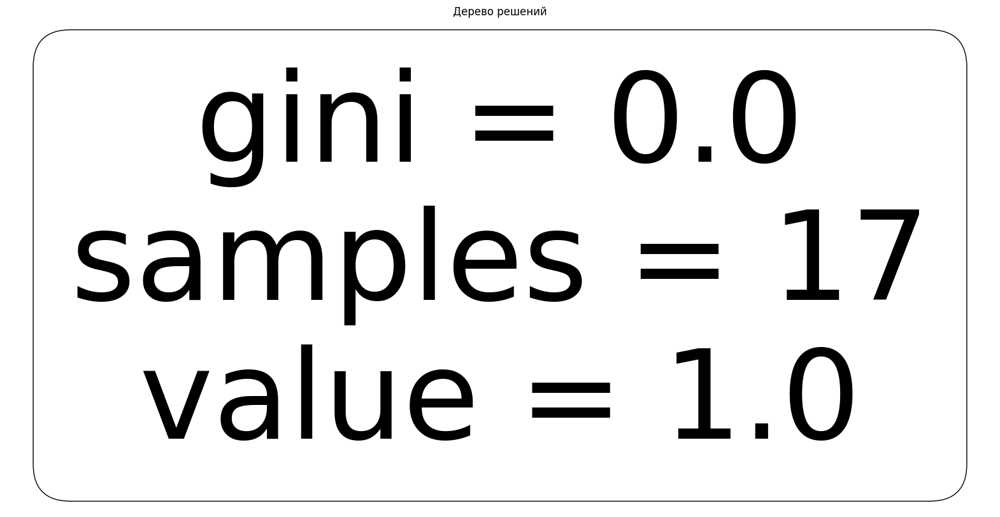

Дисциплина: Макроэкономика
F1-score (macro): 0.48717948717948717


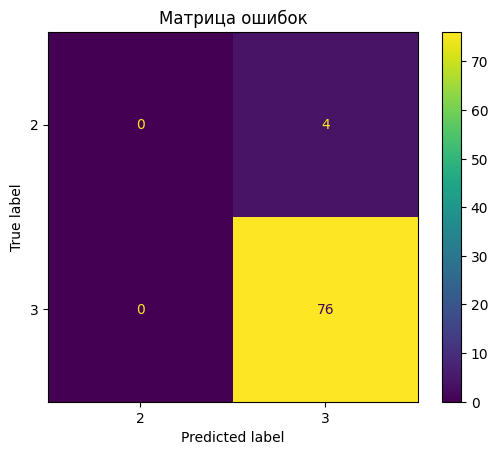

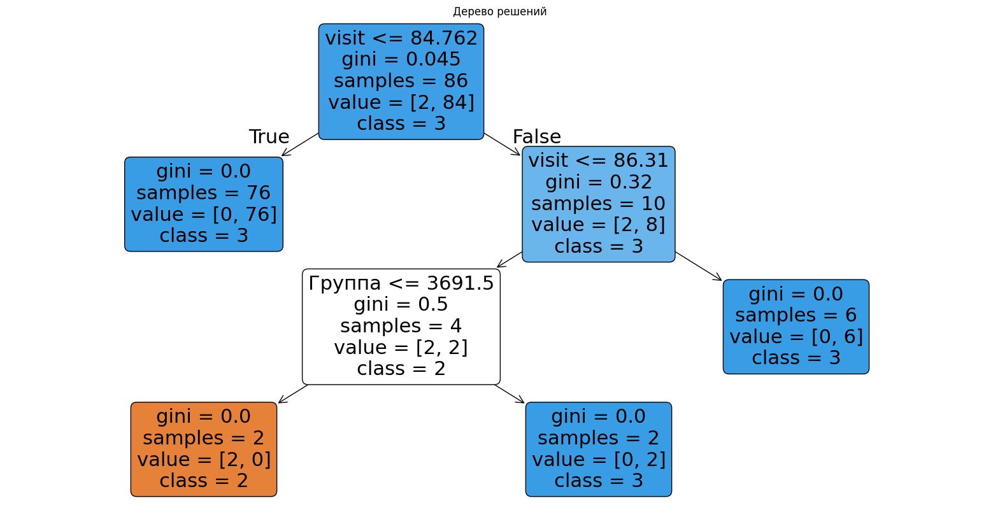

Дисциплина: Математический анализ
F1-score (macro): 0.6292727220252512


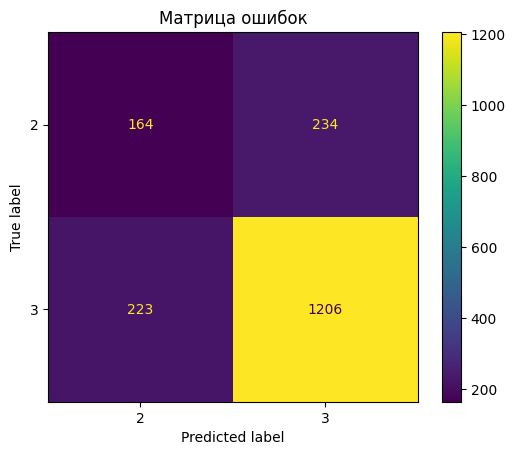

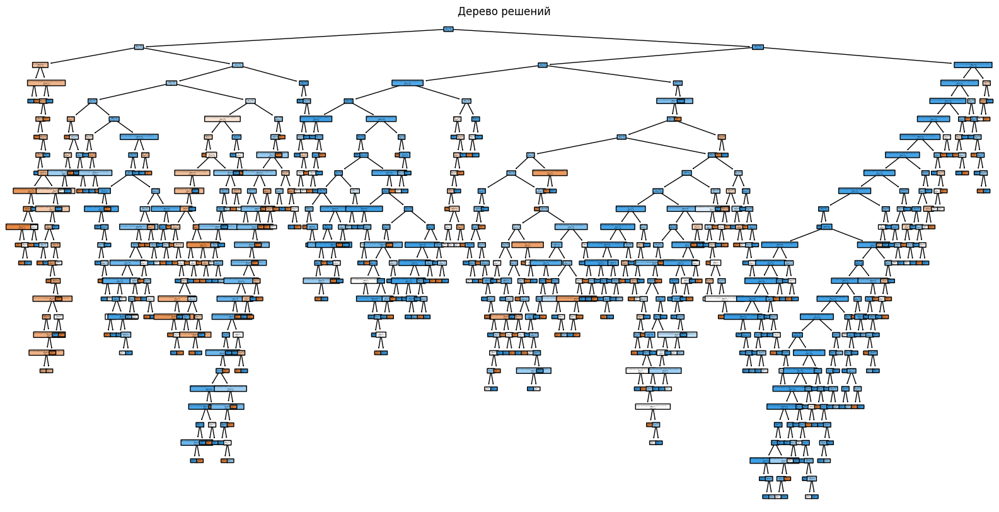

Дисциплина: Межличностная коммуникация
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


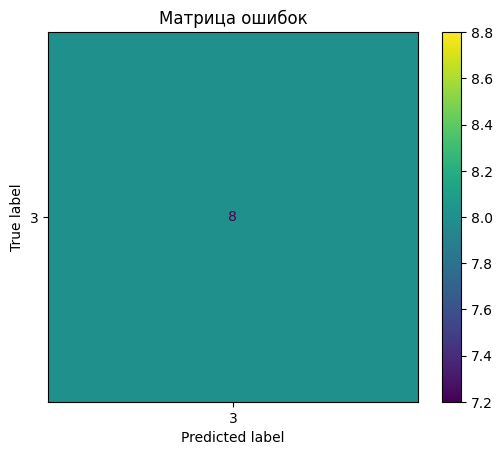

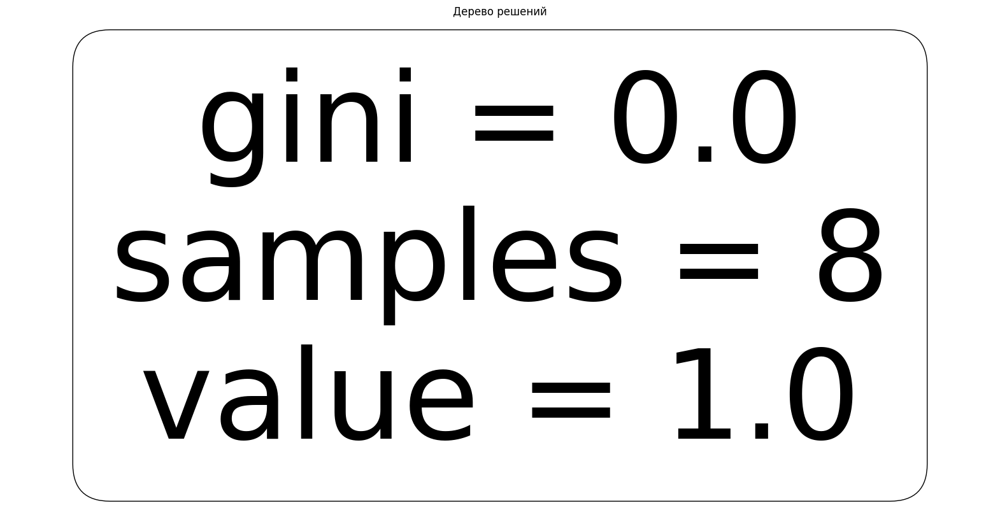

Дисциплина: Микроэкономика
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


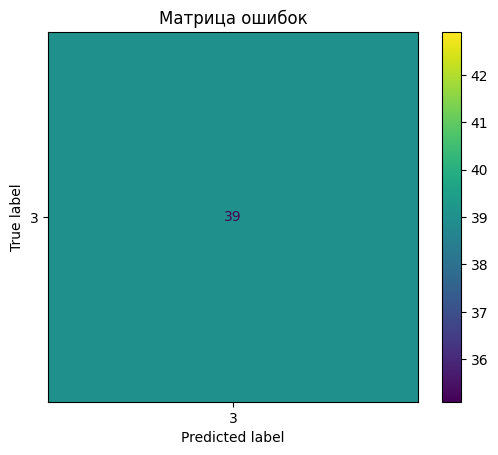

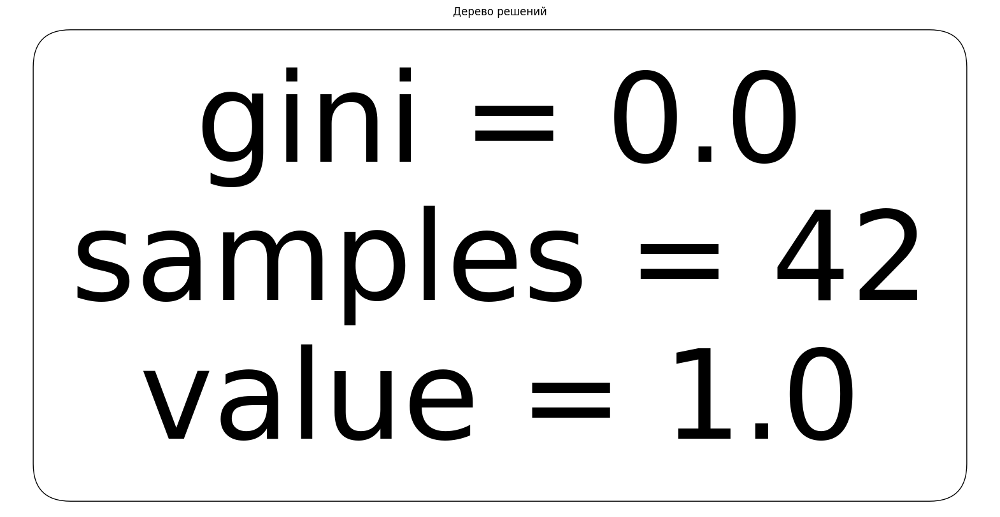

Дисциплина: Основы информационной безопасности
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


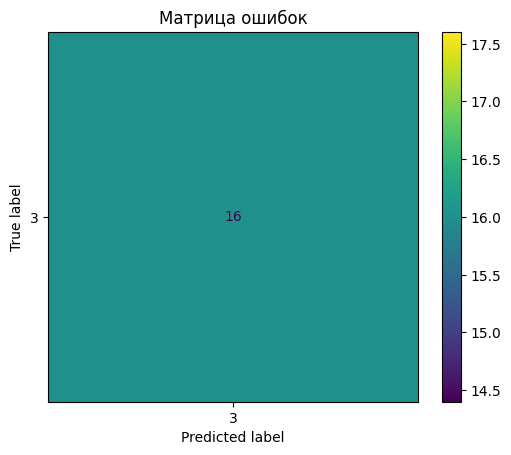

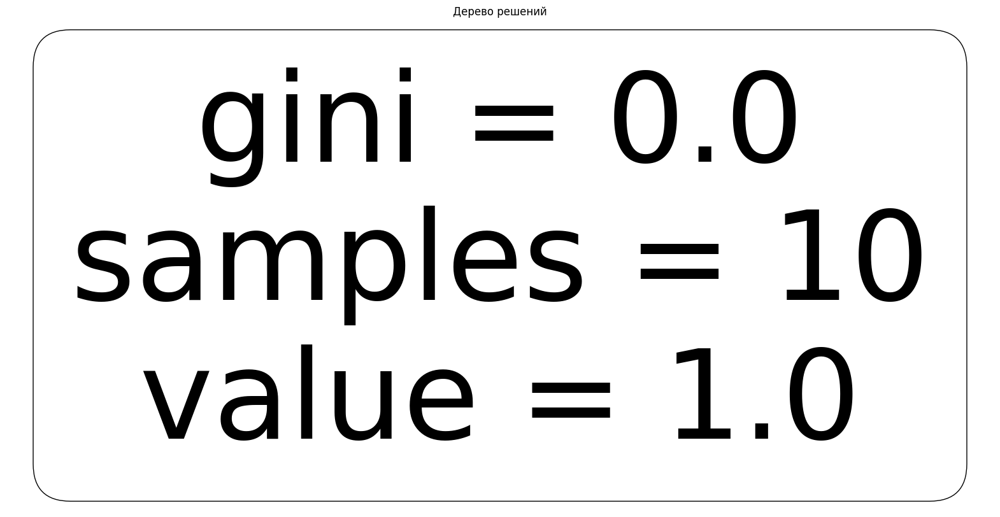

Дисциплина: Основы конструирования
F1-score (macro): 0.4666666666666667


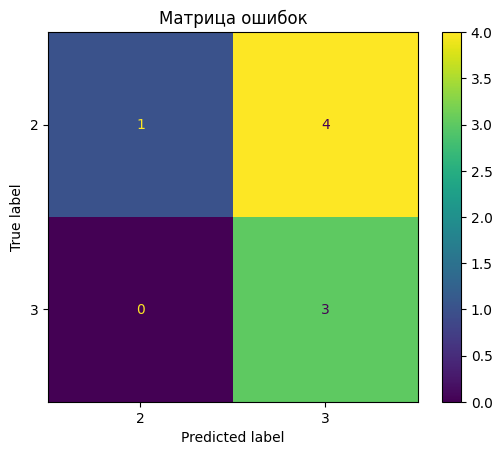

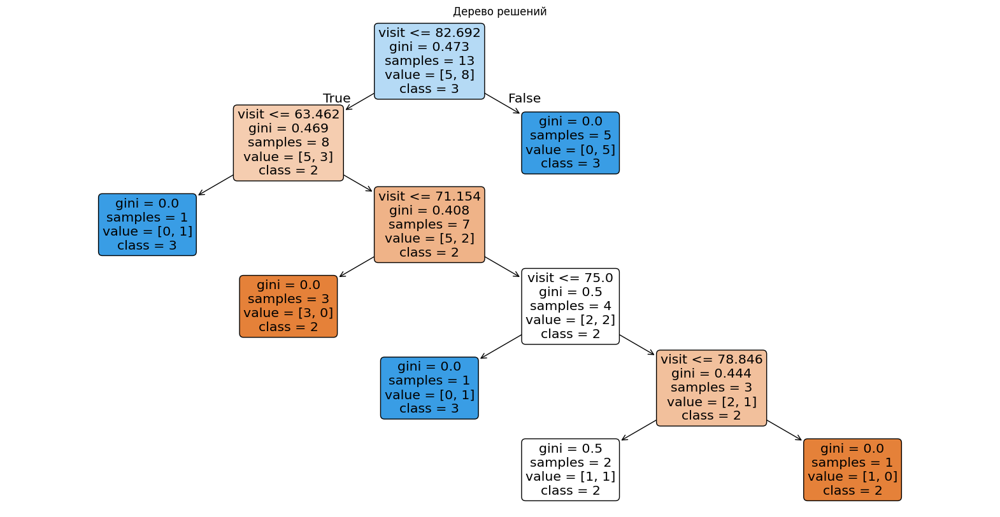

Дисциплина: Основы языкознания
F1-score (macro): 0.48514851485148514


ValueError: The number of FixedLocator locations (2), usually from a call to set_ticks, does not match the number of labels (1).

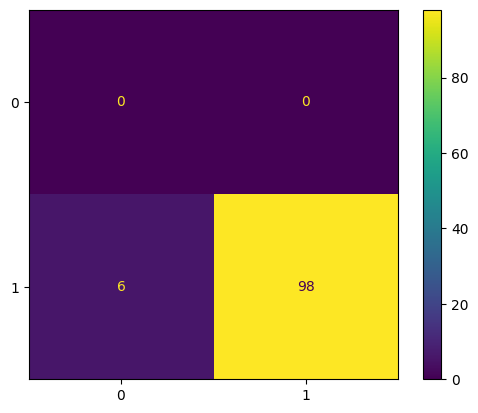

In [54]:
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект') & (df_sorted['Кафедра'] != 'каф.ИБ') & (df_sorted['Кафедра'] != 'каф.ТВ')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)

df_sorted = df_sorted[df_sorted['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
df_sorted = df_sorted[df_sorted['Дисциплина'] != 'История искусства'] #неправильно считается дерево
df_sorted = df_sorted[df_sorted['Дисциплина'] != 'Основы теории коммуникации'] 

df_subjects = get_subj(df_sorted)
f1_array = []


for value in df_subjects:
    df_sorted = df_subjects[value]  # Теперь мы просто берем соответствующий DataFrame по ключу `value`, т.е. имени дисциплины.
    
    # Разделение на чётные и нечётные по 'ID ЛК'
    df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
    df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]
    
    
    # Подготовка тренировочных и тестовых данных
    X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
    y_train = df1['ПерваяПопытка'].reset_index(drop=True)
    
    X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
    y_test = df2['ПерваяПопытка'].reset_index(drop=True)
    
    visits_train = X_train['visit']
    visits_test = X_test['visit']
    
    
    # Применяем get_dummies ко всем остальным колонкам
    X_tr = pd.get_dummies(X_train.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x', 'finans']))
    X_te = pd.get_dummies(X_test.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x', 'finans']))
    
    # Добавляем колонку 'visit' обратно
    X_tr['visit'] = X_train['visit']
    X_te['visit'] = X_test['visit']
    
    # Добавляем остальные колонки обратно
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    
    X_tr['Семестр'] = X_train['Семестр']
    X_te['Семестр'] = X_test['Семестр']
    
    X_tr['Курс'] = X_train['Курс_x']
    X_te['Курс'] = X_test['Курс_x']
    
    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})
    
    # Создаём и обучаем дерева решений
    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    
    # Предсказания на тестовых данных
    y_pred = tree.predict(X_te)

    print(f'Дисциплина: {value}')
    #print(f'Accuracy: {accuracy}')
    
    f1_macro = f1_score(y_te, y_pred, average='macro')
    f1_micro = f1_score(y_te, y_pred, average='micro')
    
    #print(f'F1-score (micro): {f1_micro}')
    print(f'F1-score (macro): {f1_macro}')
    f1_array.append(f1_micro)

    class_names =[str(cls) for cls in np.unique(y_te)]
    conf_matrix(y_te, y_pred, class_names)


    plt.figure(figsize=(20, 10))
    plot_tree(tree, feature_names=X_te.columns, class_names=[str(cls) for cls in np.unique(y_te)], filled=True, rounded=True)
    plt.title('Дерево решений')
    plt.show()

Дисциплина: Алгебра и геометрия
F1-score (macro): 0.6175820970794736


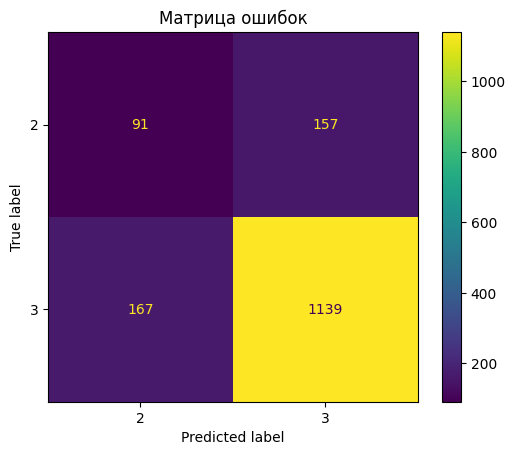

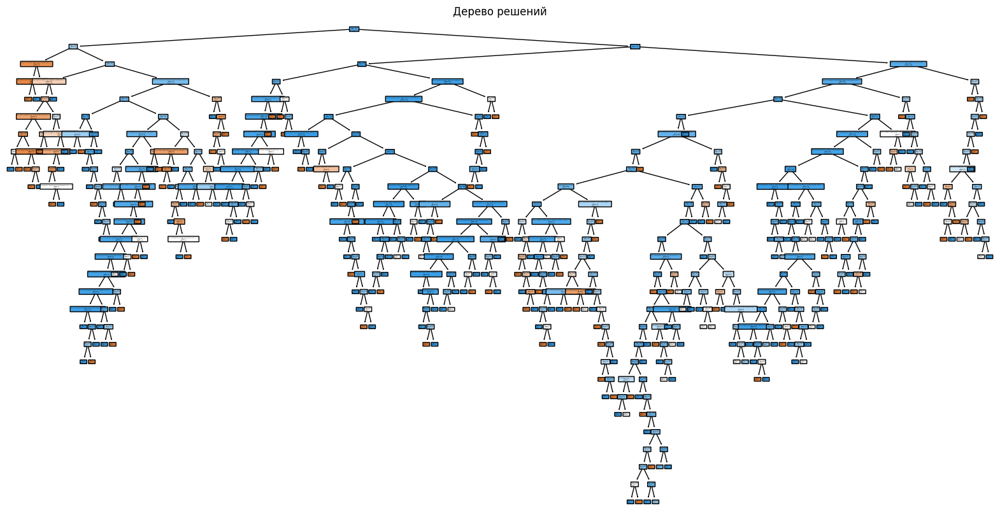

Дисциплина: Алгоритмы и вычислительные средства
F1-score (macro): 0.7049793085035376


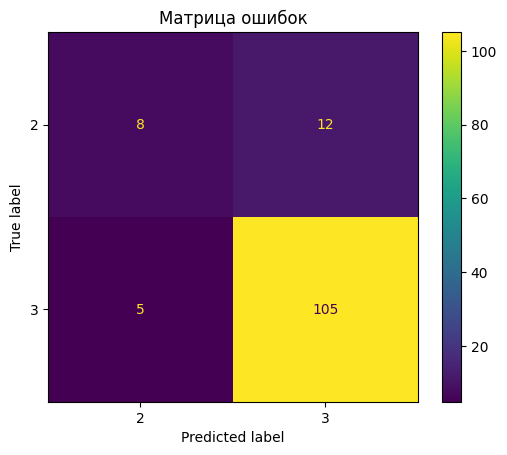

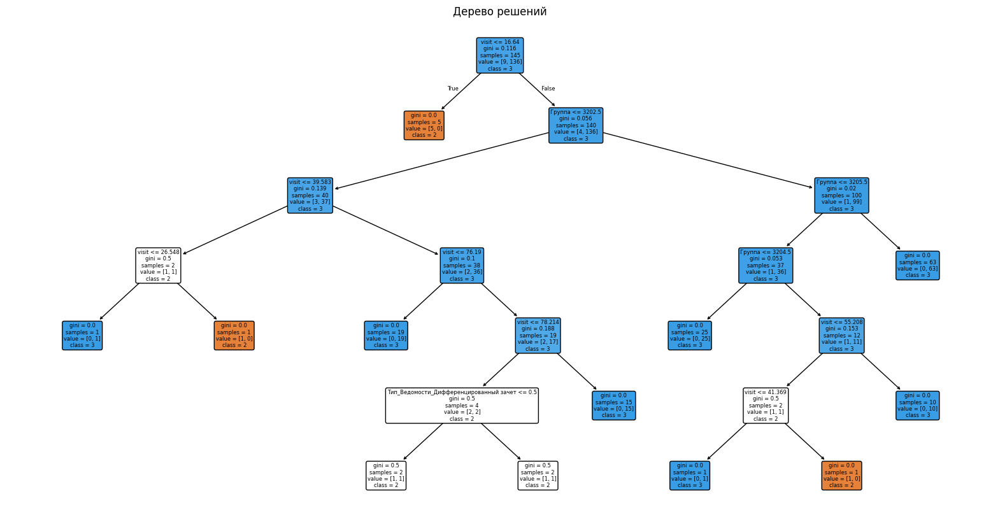

Дисциплина: Введение в коммуникационные специальности
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


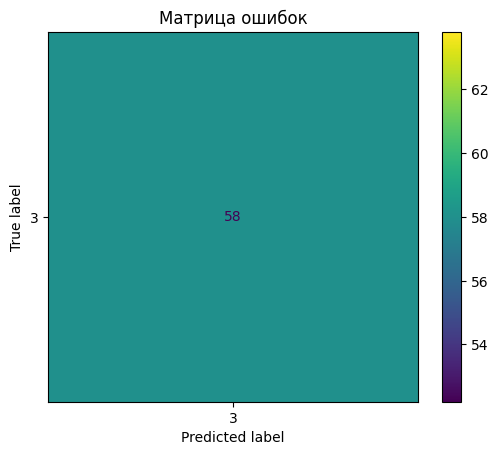

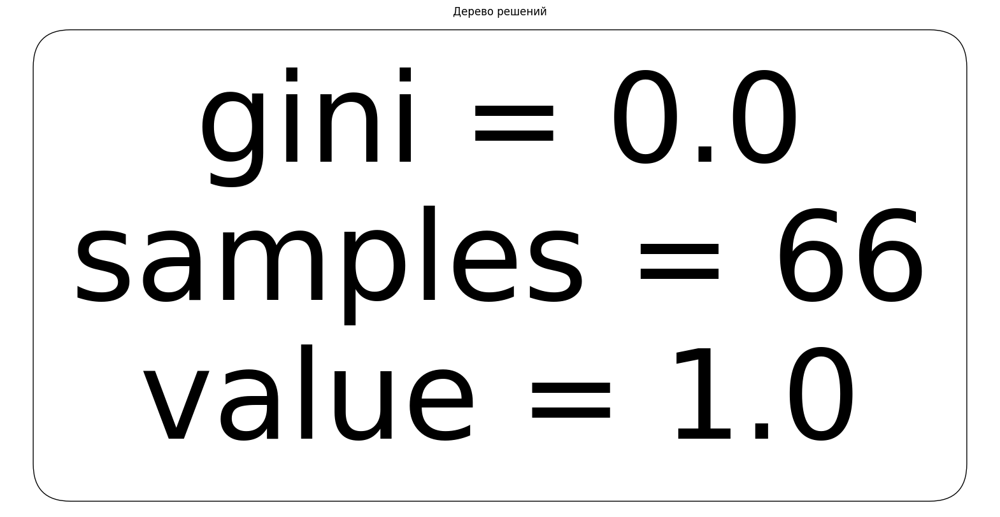

Дисциплина: Введение в предпринимательскую деятельность
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


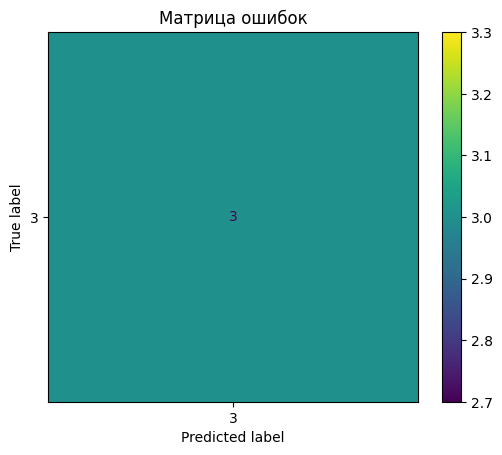

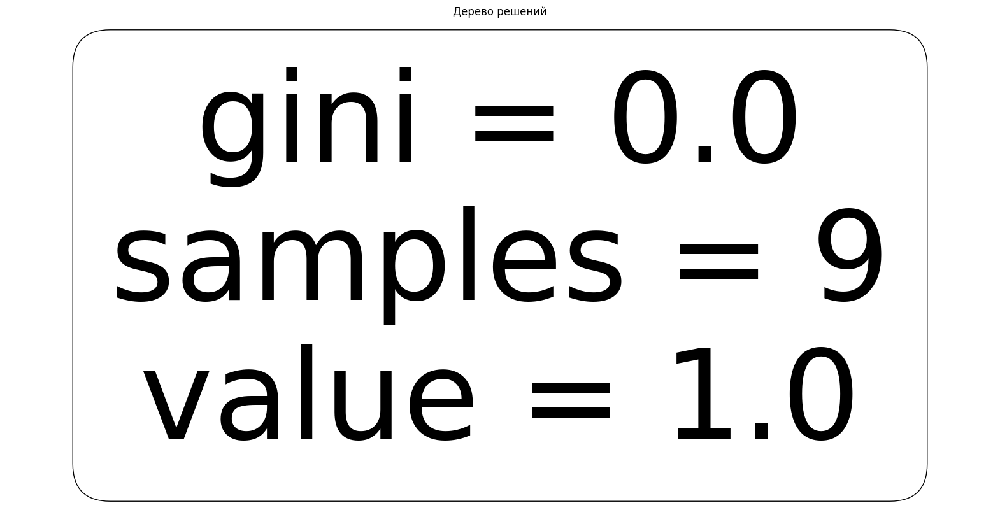

Дисциплина: Введение в специальность
F1-score (macro): 0.7314814814814814


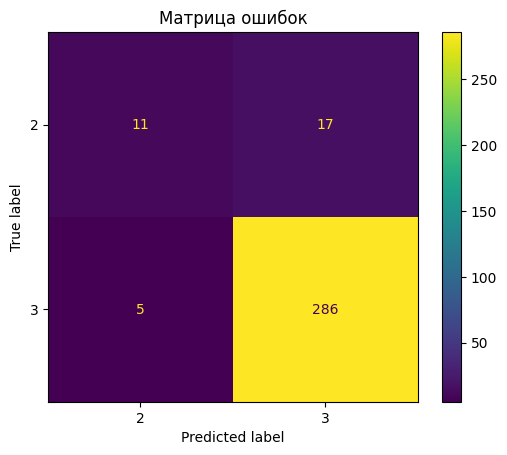

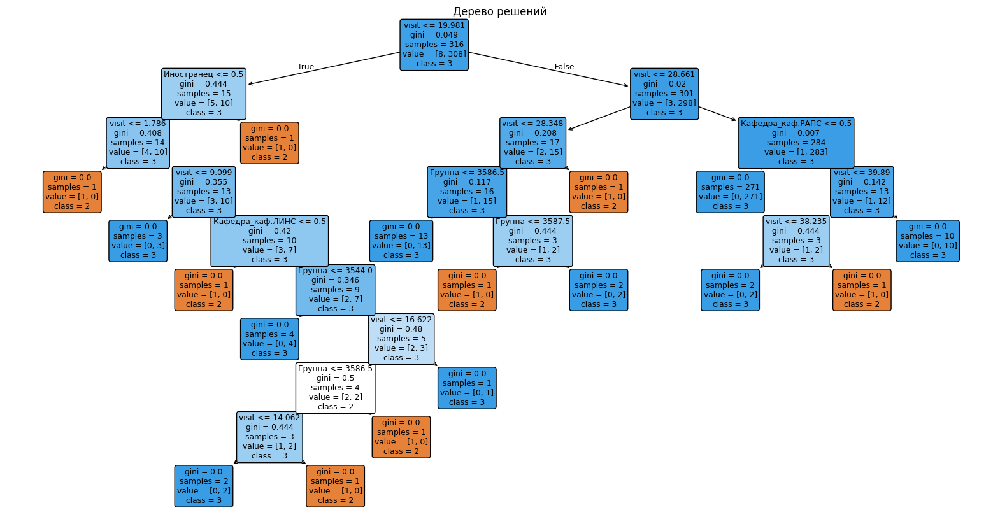

Дисциплина: Деловая и межличностная коммуникация
F1-score (macro): 0.6282051282051282


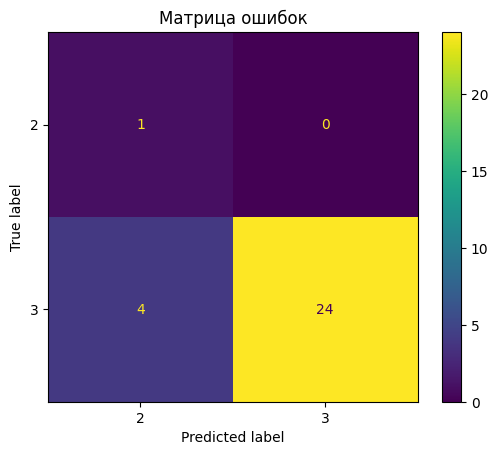

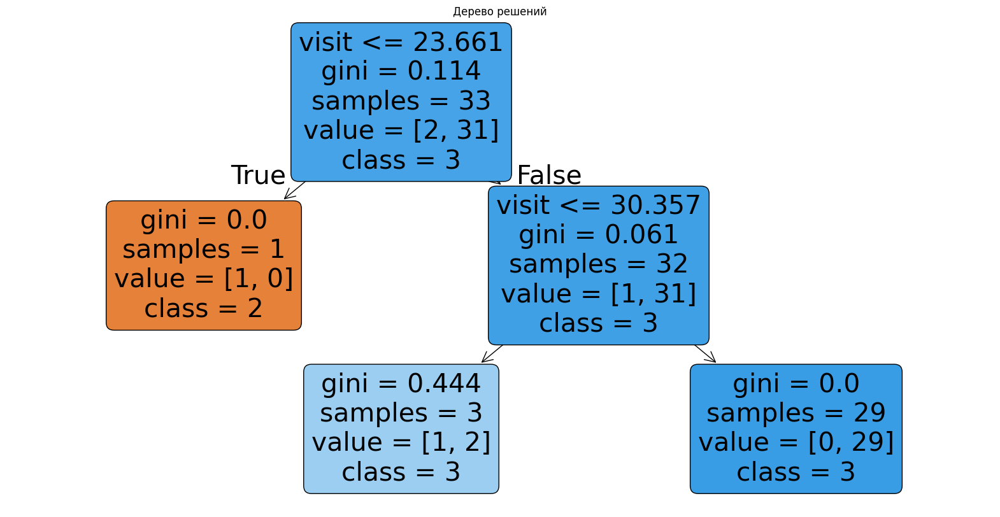

Дисциплина: Древние языки и культуры
F1-score (macro): 0.4639175257731959


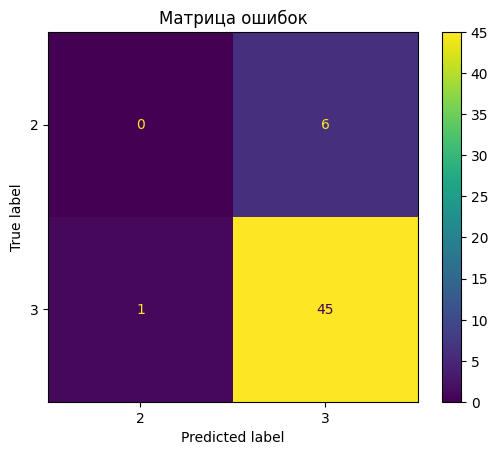

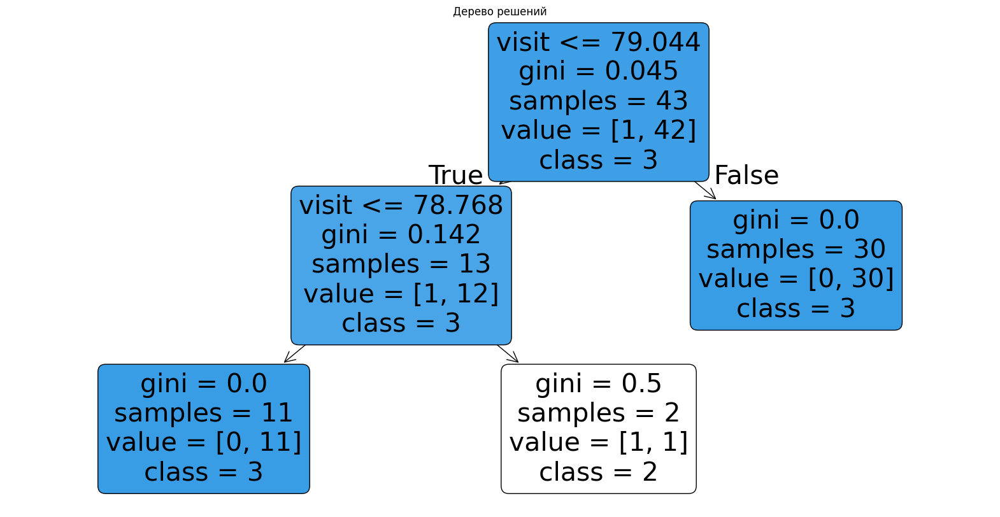

Дисциплина: Инженерная графика
F1-score (macro): 0.7454344216934146


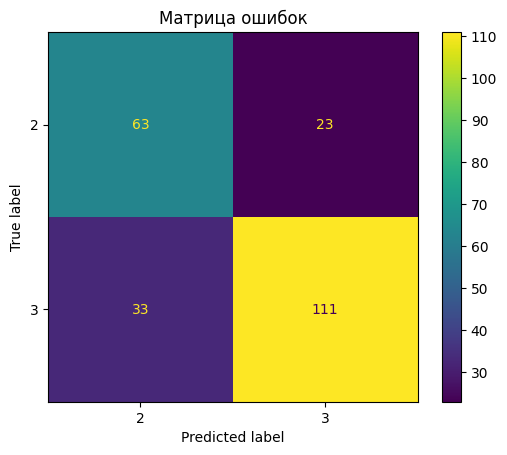

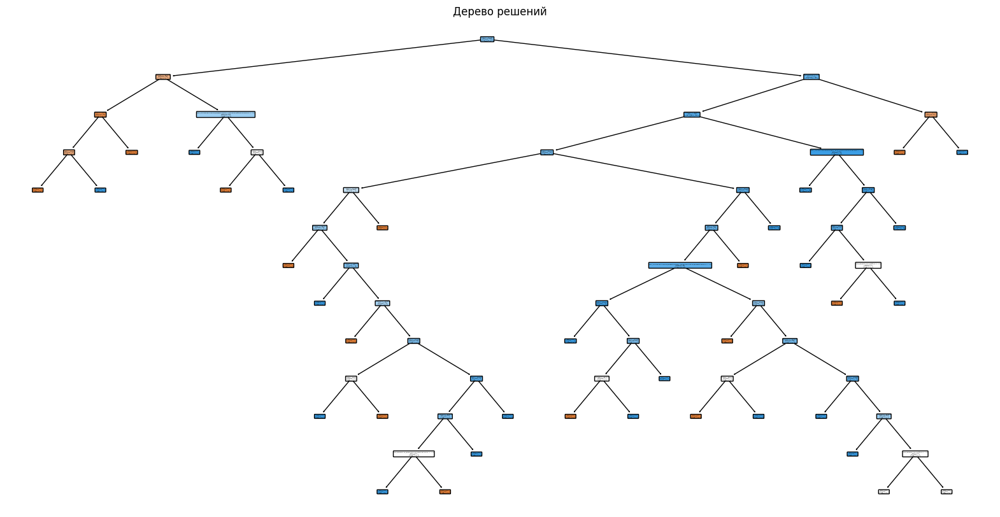

Дисциплина: Инженерная и компьютерная графика
F1-score (macro): 0.6633292383292383


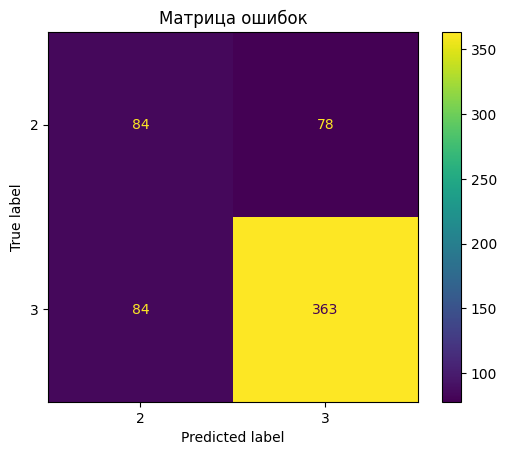

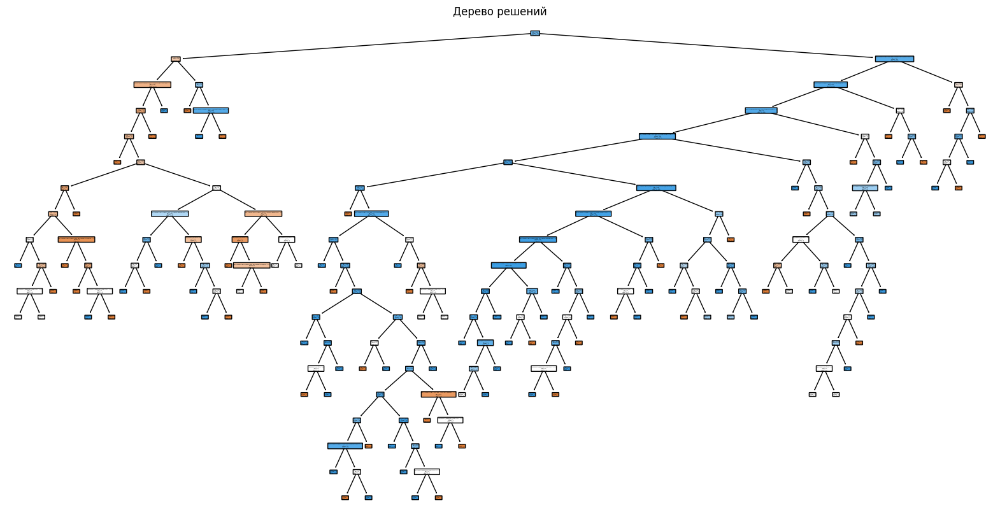

Дисциплина: Иностранный язык
F1-score (macro): 0.5591888053840927


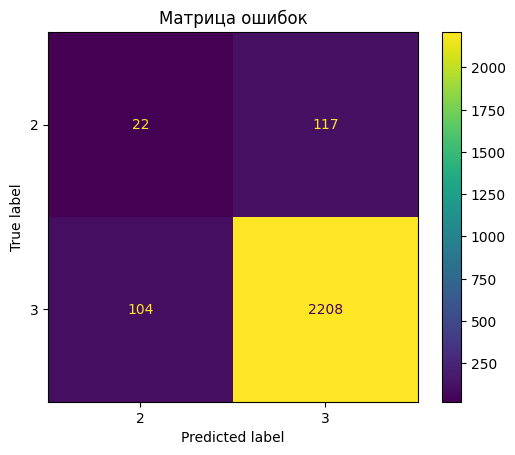

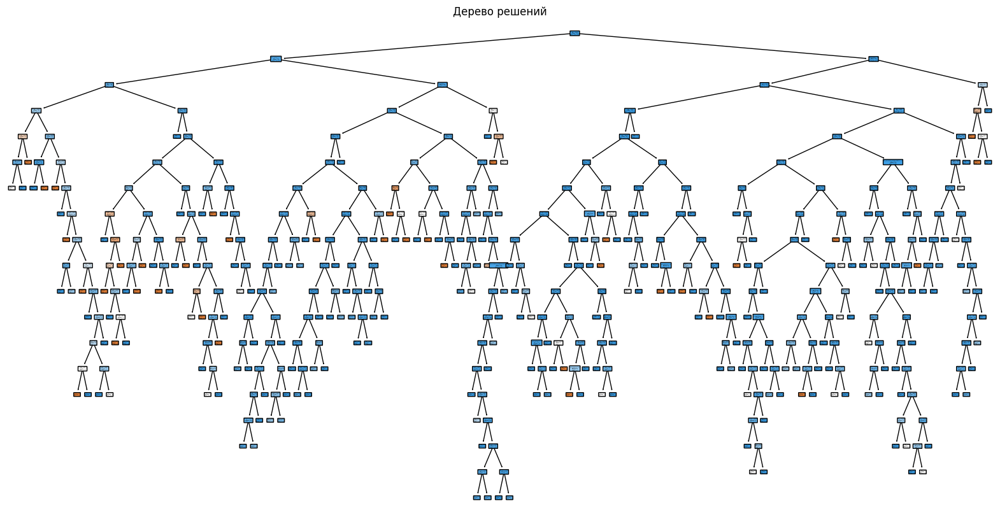

Дисциплина: Информатика
F1-score (macro): 0.5700457544892281


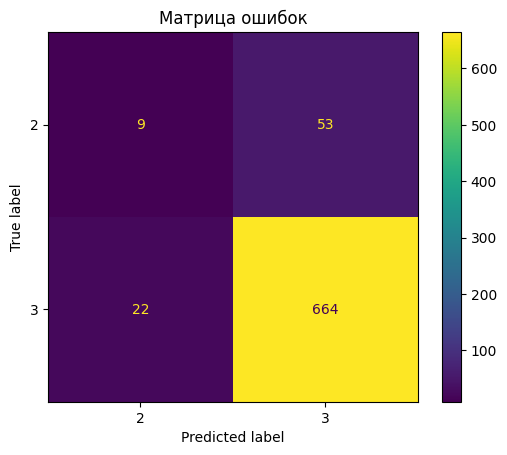

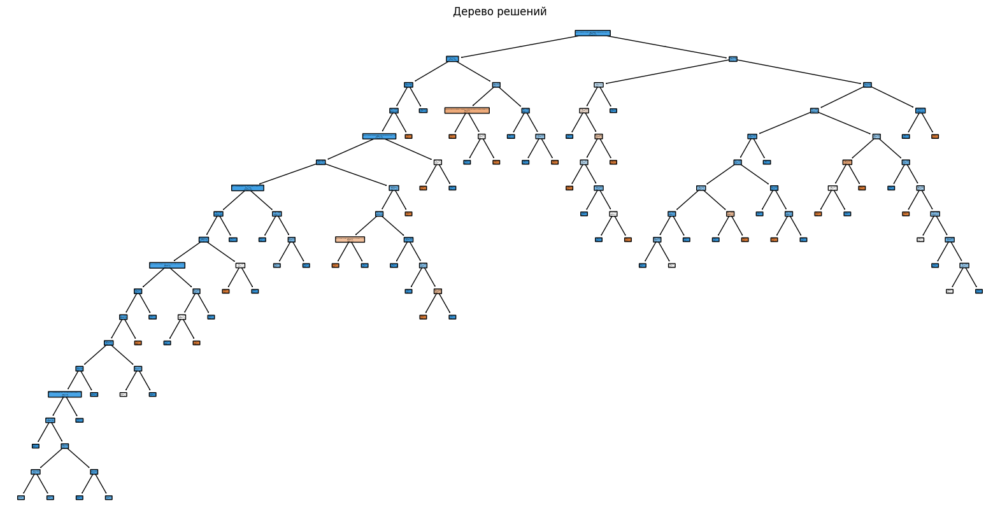

Дисциплина: Информационные технологии
F1-score (macro): 0.62734110540968


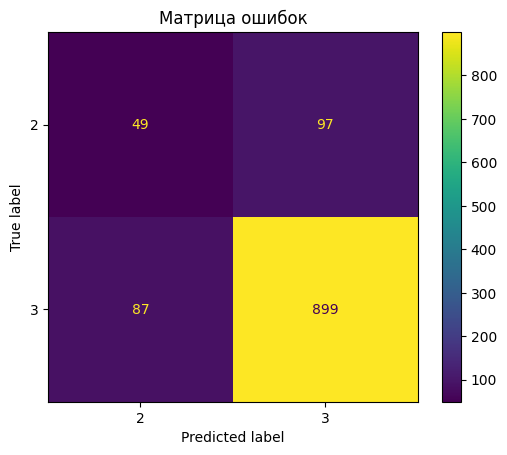

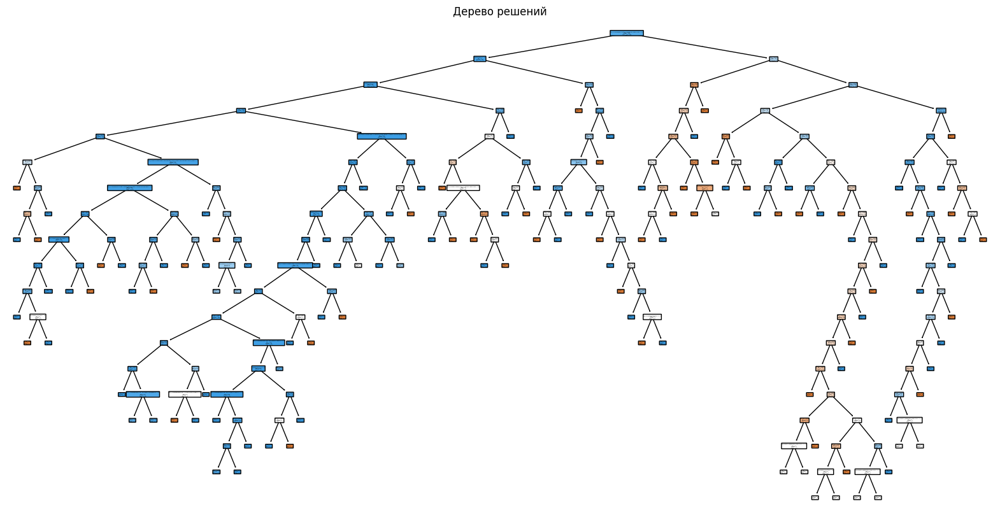

Дисциплина: Информационные технологии в управлении предприятием
F1-score (macro): 0.43243243243243246


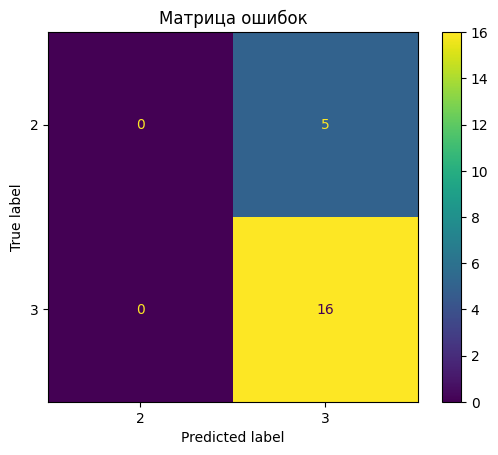

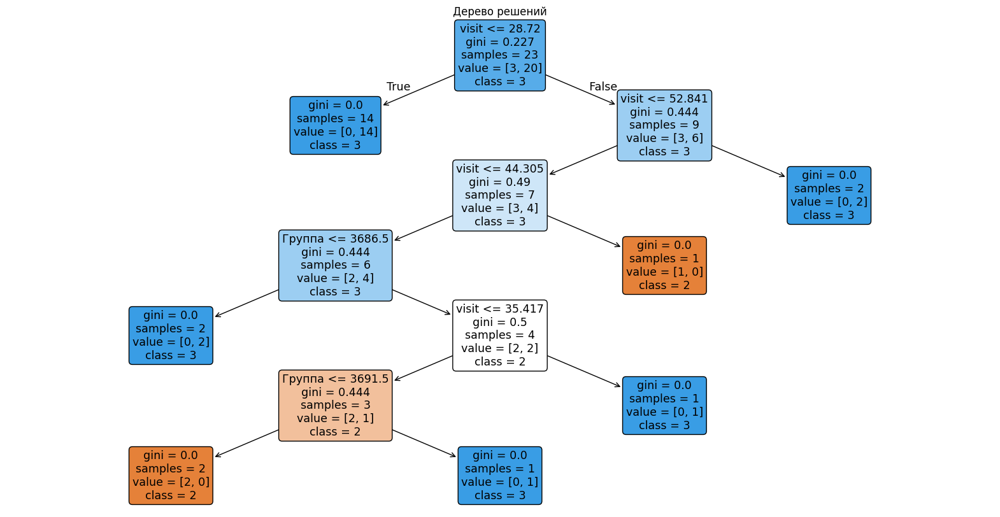

Дисциплина: Информационные технологии и базы данных в прикладных коммуникациях
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


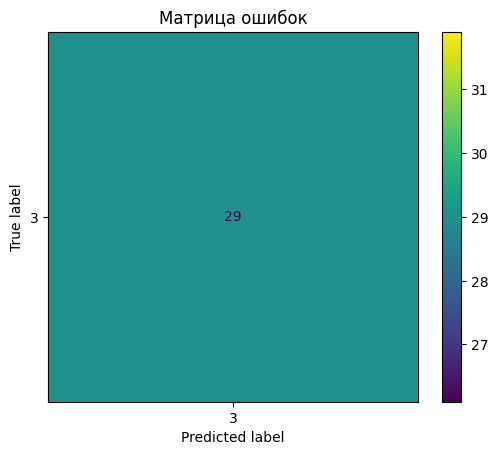

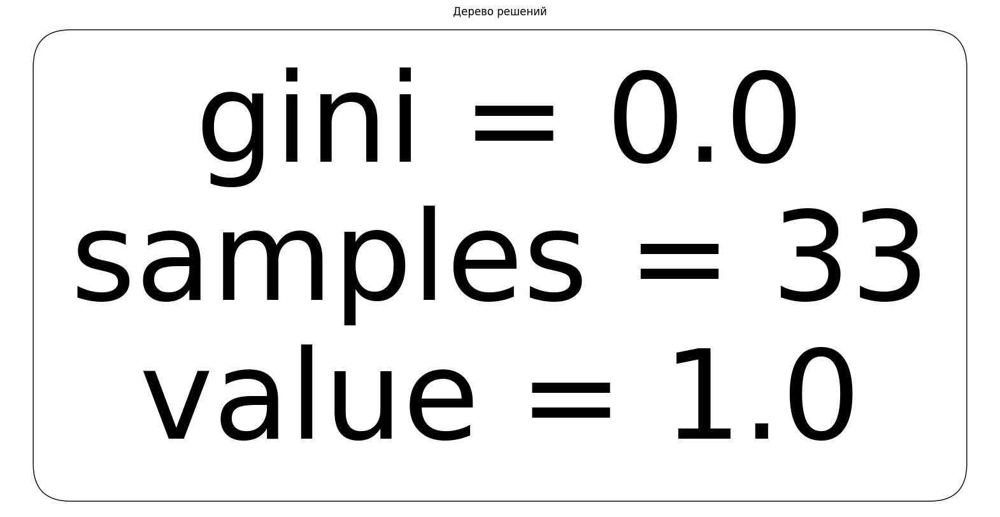

Дисциплина: Искусство самопрезентации и деловой этикет
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


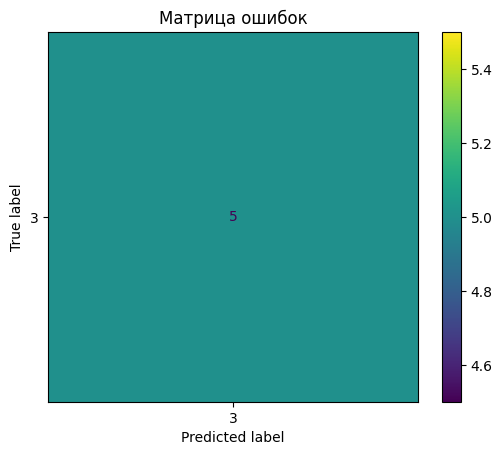

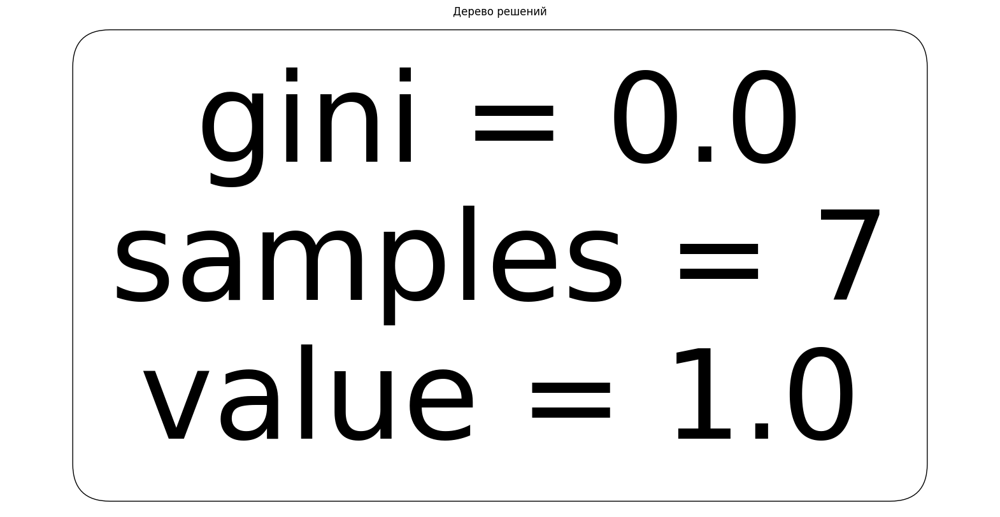

Дисциплина: История России
F1-score (macro): 0.5983269961977187


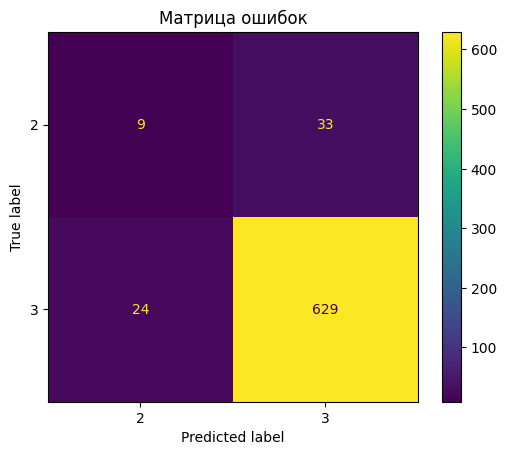

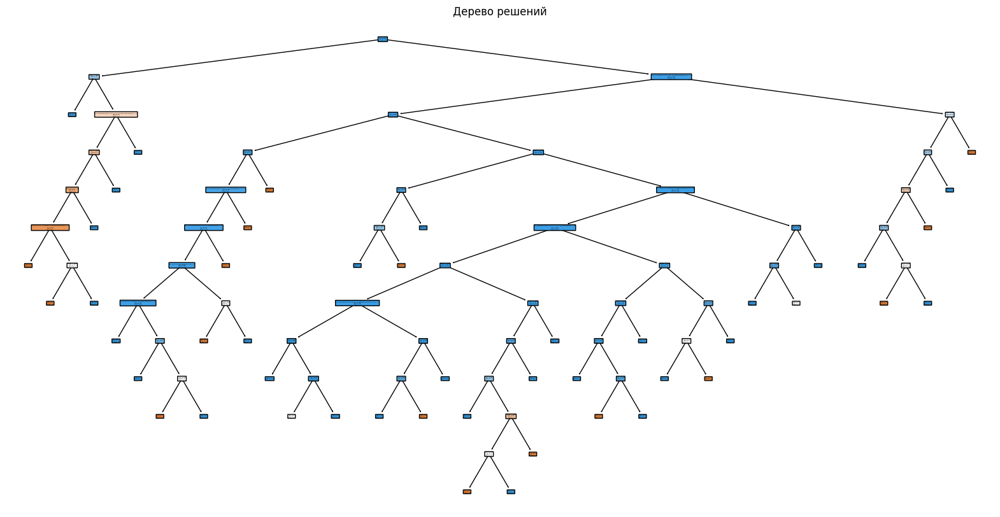

Дисциплина: История искусства
F1-score (macro): 0.49122807017543857


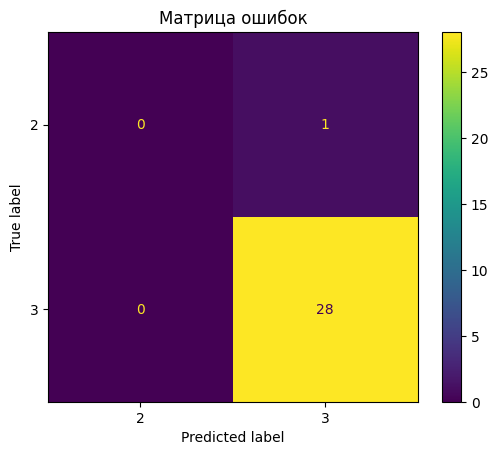

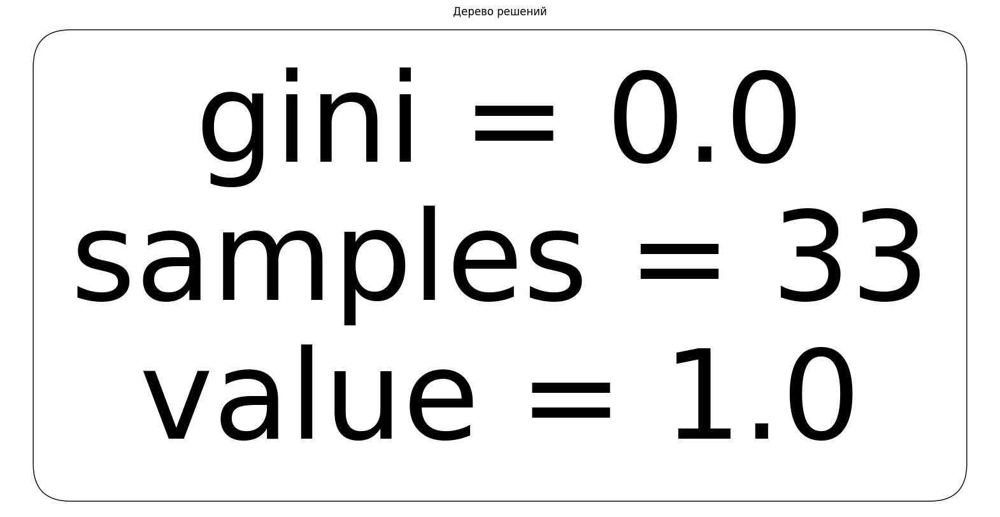

Дисциплина: История литературы
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


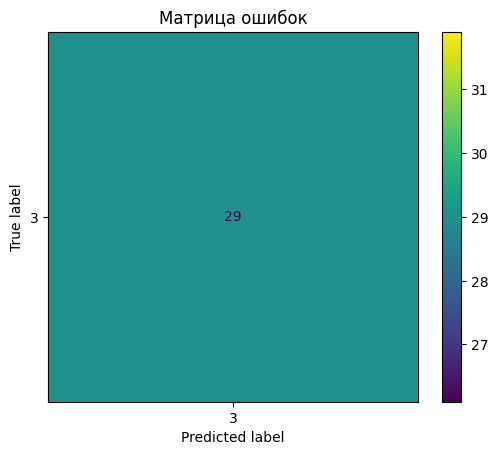

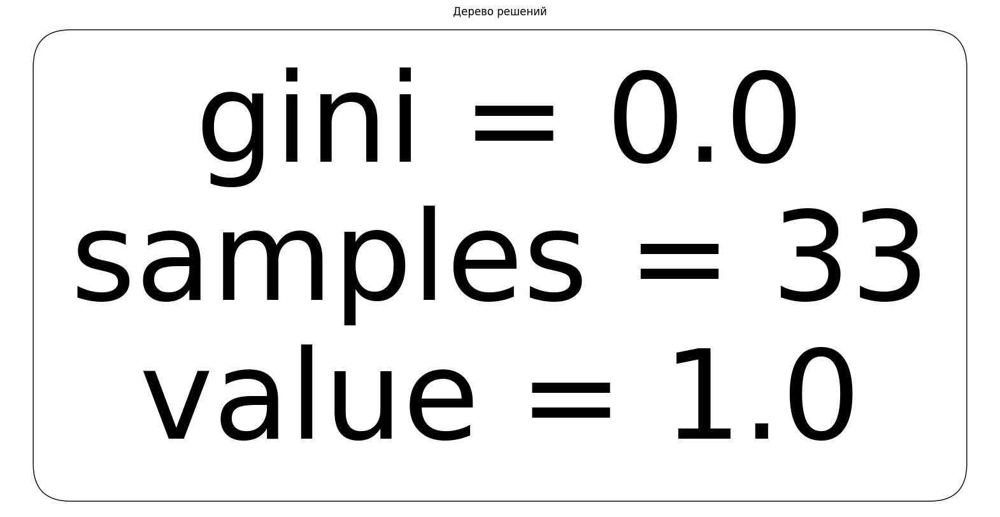

Дисциплина: Культурология
F1-score (macro): 0.4774193548387097


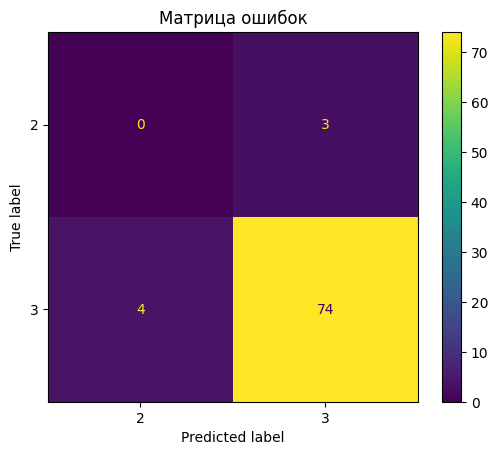

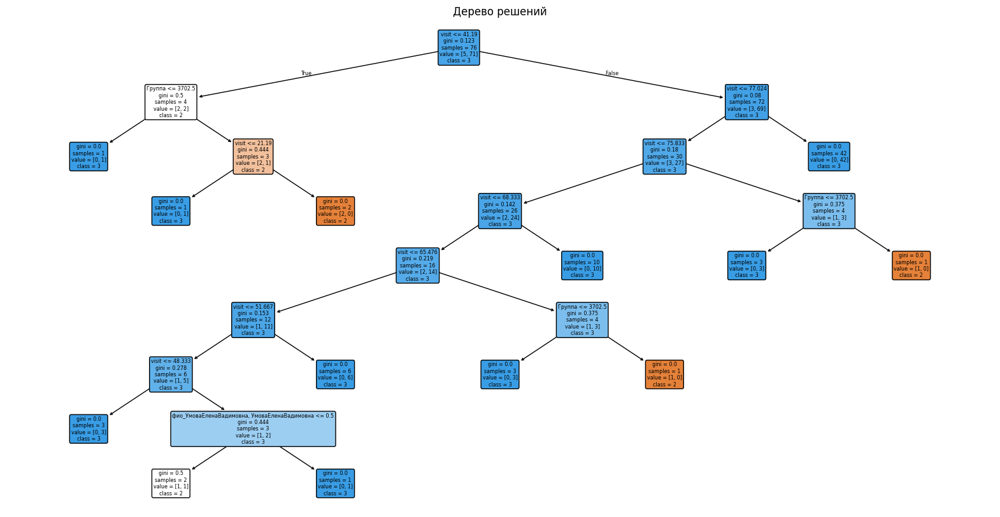

Дисциплина: Лингвистические направления
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


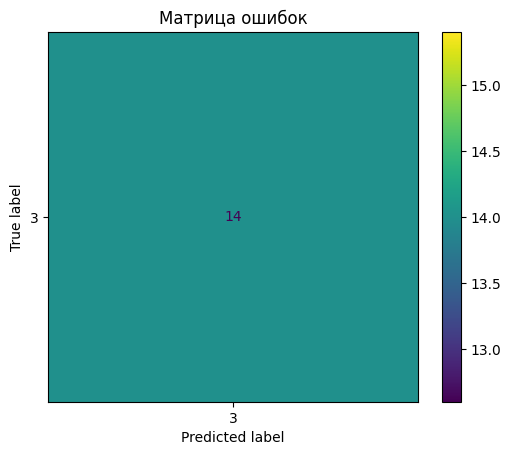

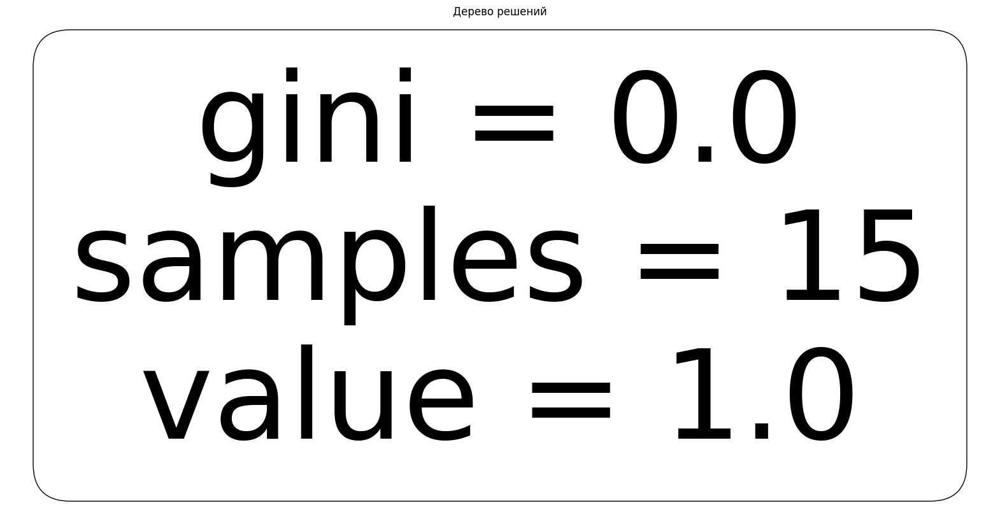

Дисциплина: Лингвистические школы
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


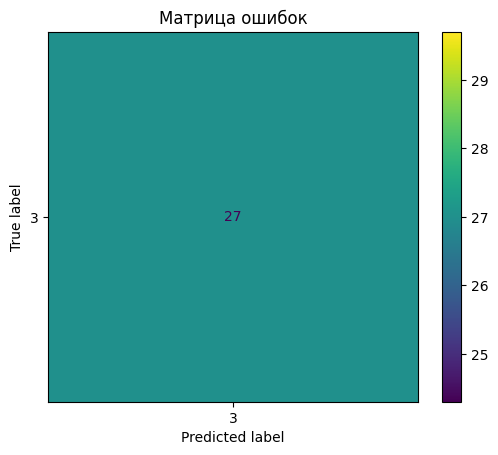

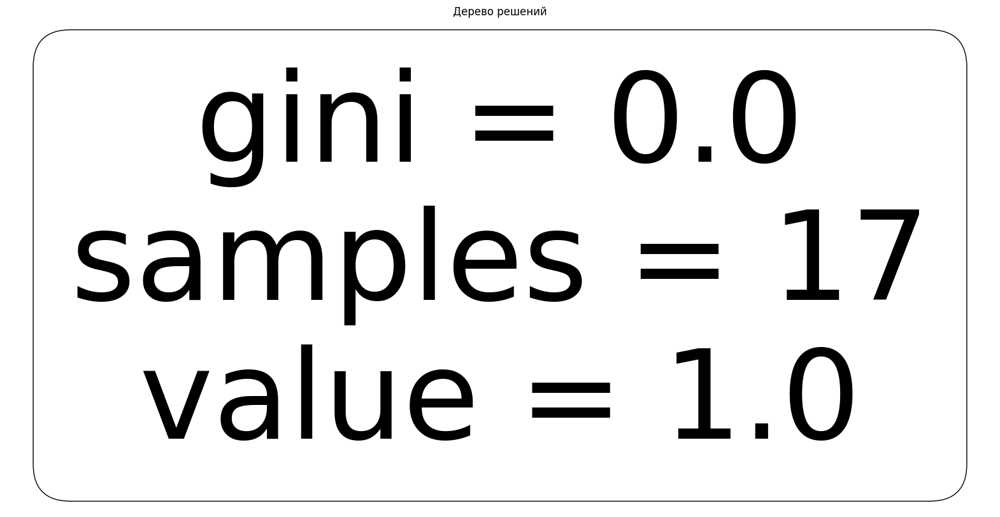

Дисциплина: Макроэкономика
F1-score (macro): 0.48717948717948717


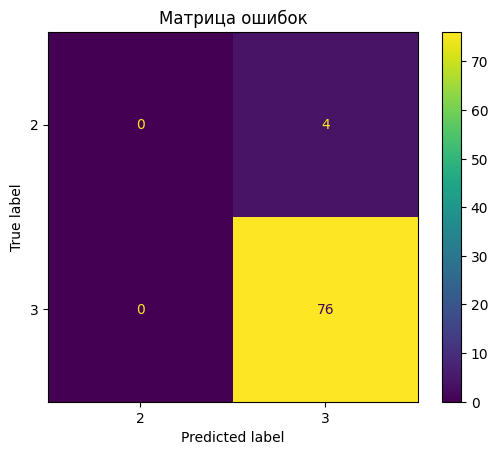

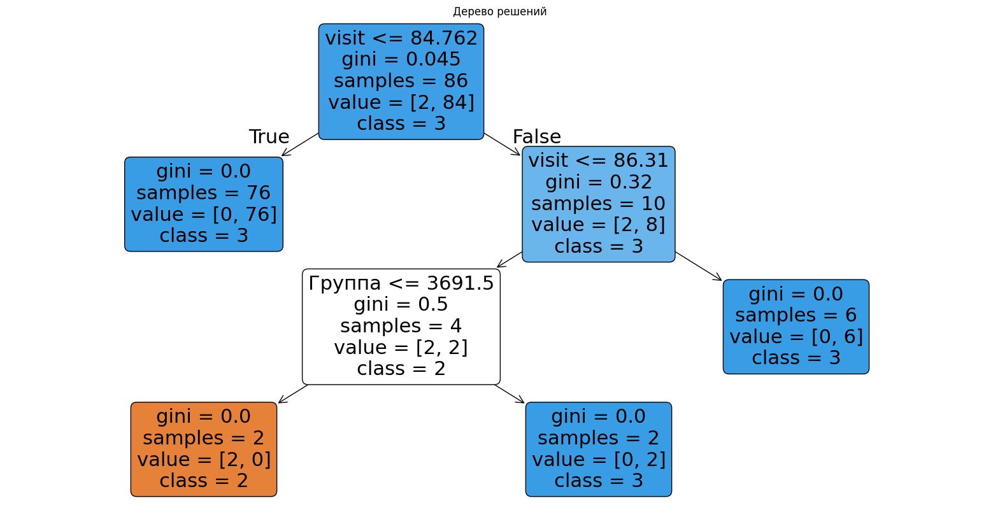

Дисциплина: Математический анализ
F1-score (macro): 0.6292727220252512


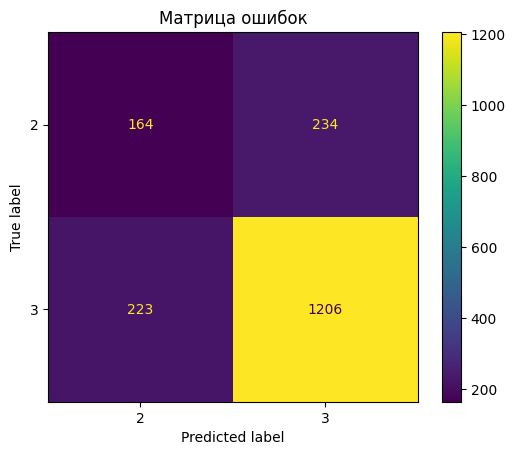

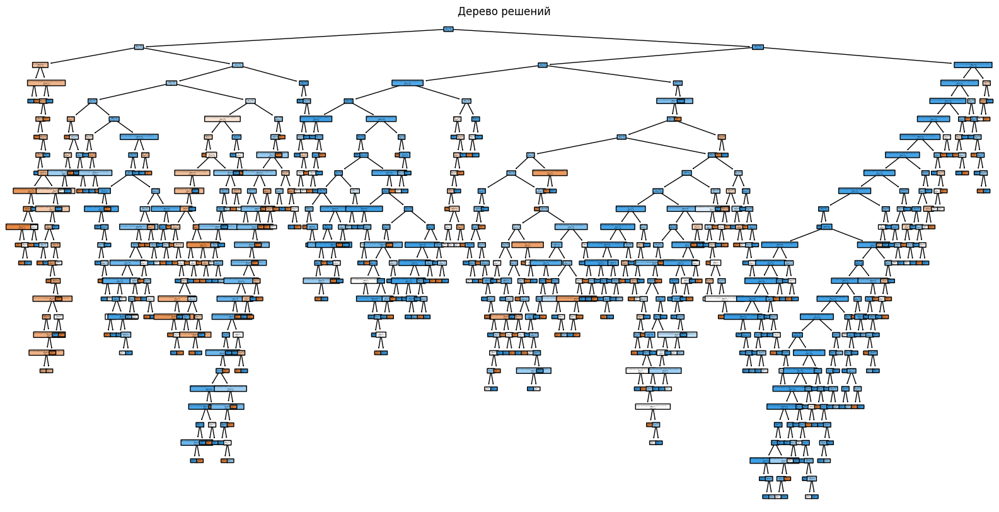

Дисциплина: Межличностная коммуникация
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


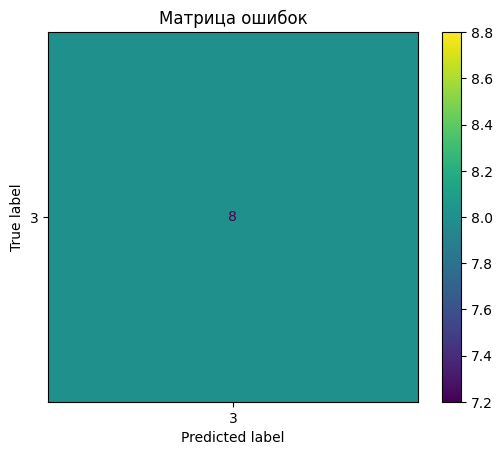

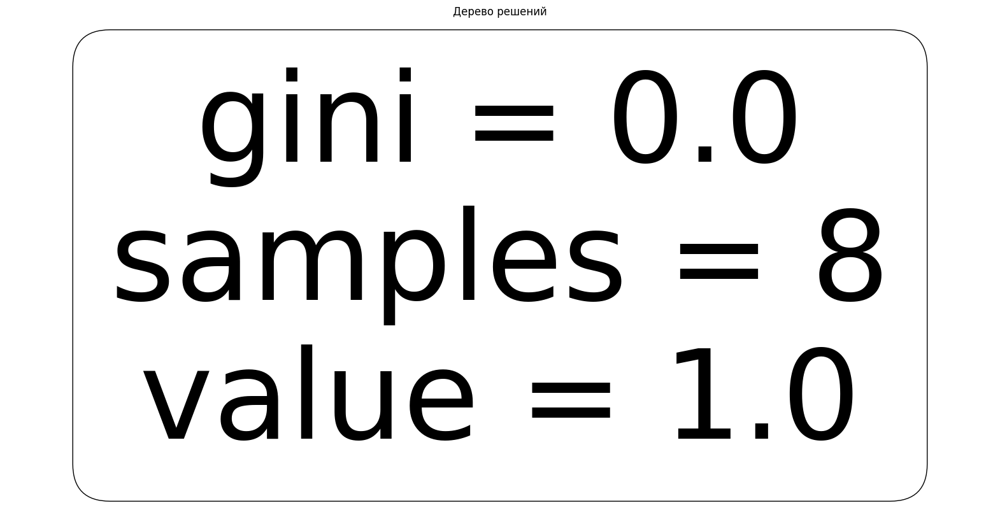

Дисциплина: Микроэкономика
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


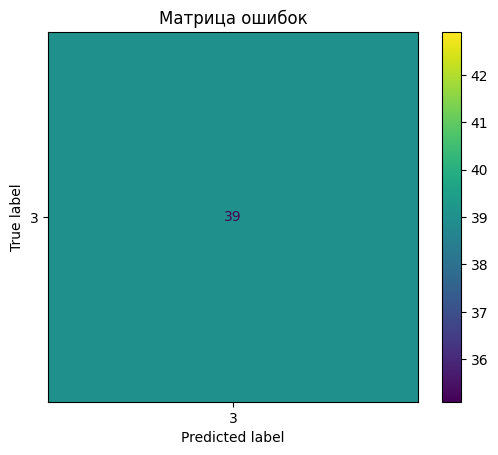

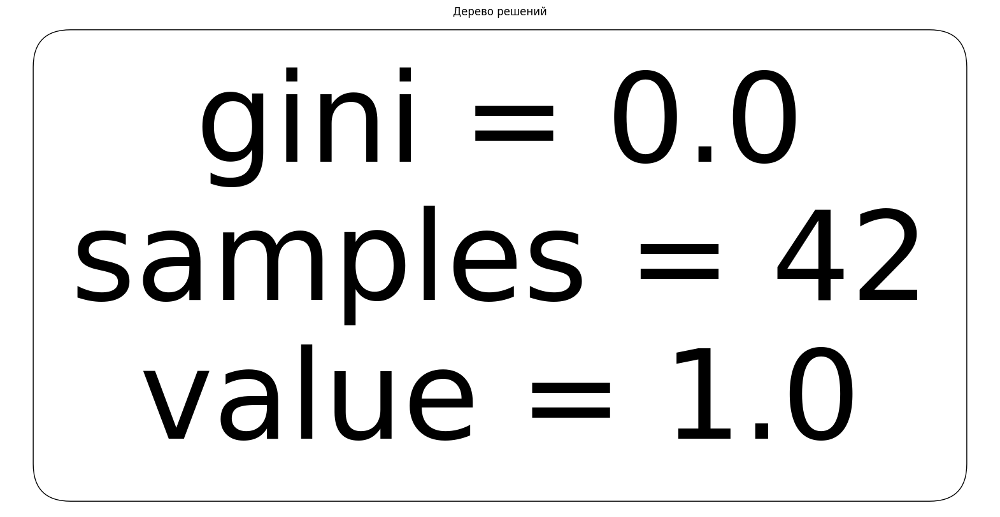

Дисциплина: Основы информационной безопасности
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


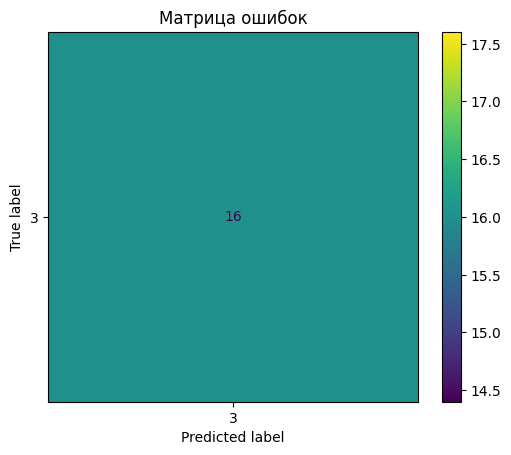

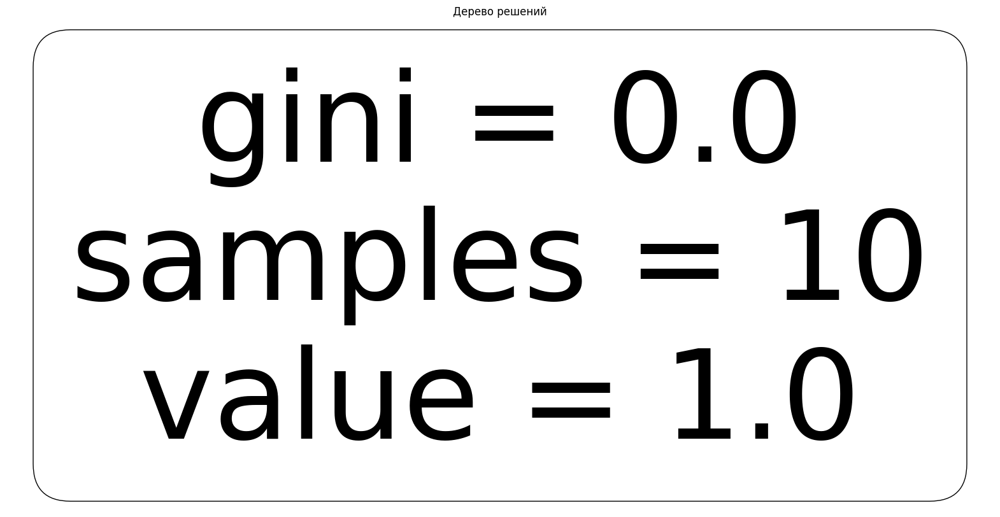

Дисциплина: Основы конструирования
F1-score (macro): 0.4666666666666667


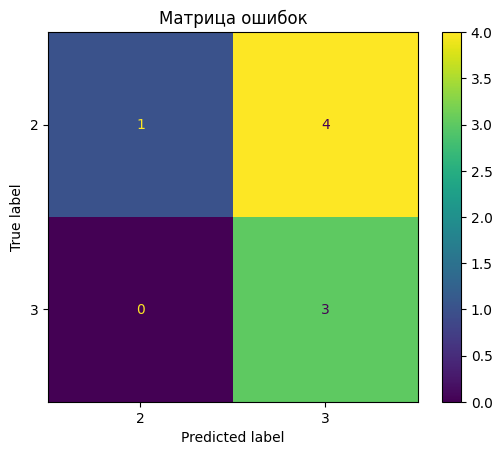

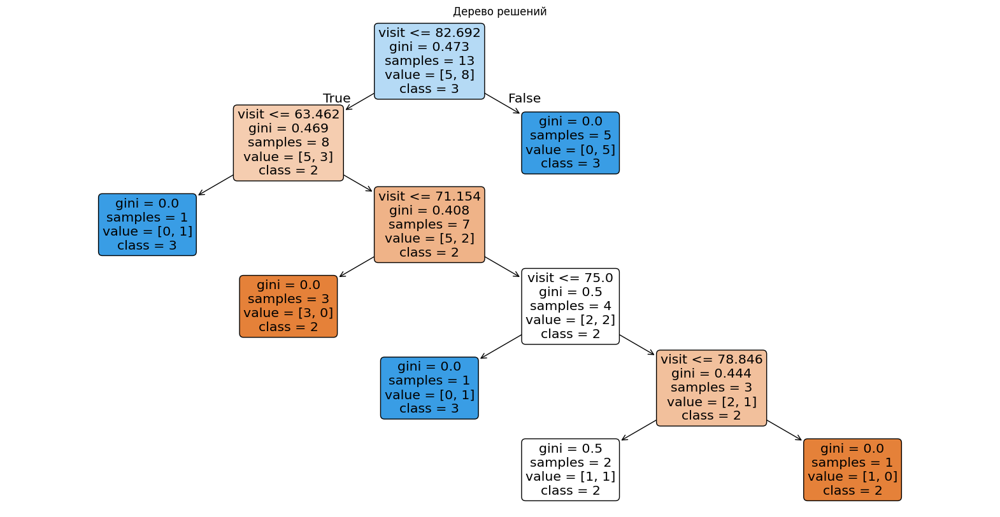

Дисциплина: Основы языкознания
F1-score (macro): 0.48514851485148514


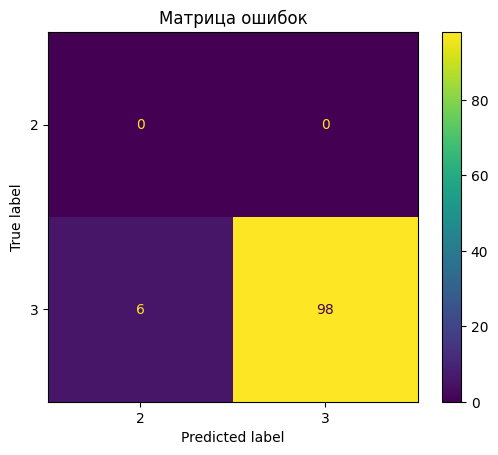

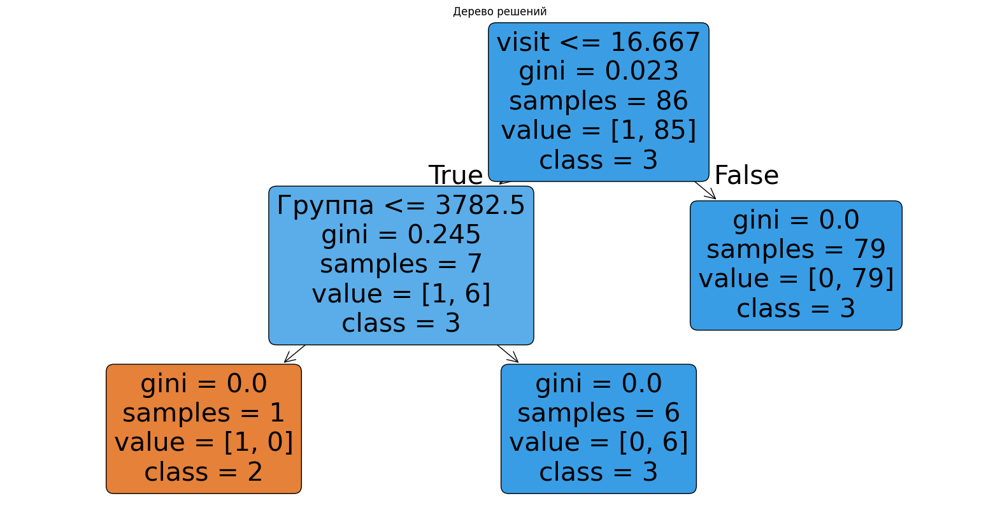

Дисциплина: Правоведение
F1-score (macro): 0.540500736377025


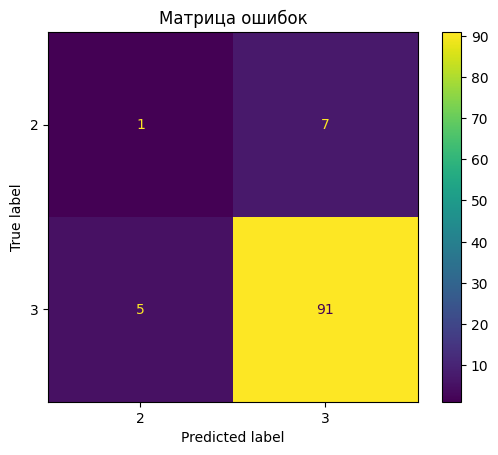

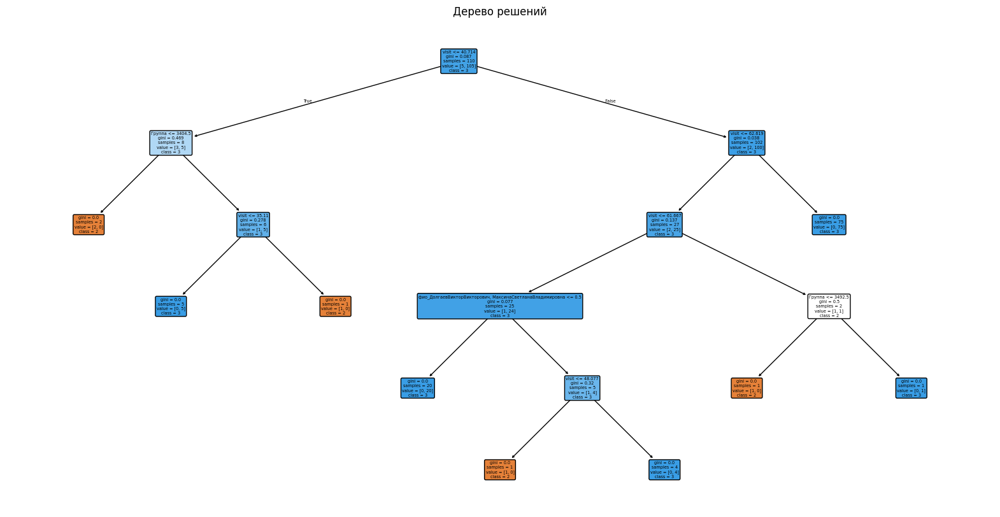

Дисциплина: Практическая грамматика английского языка
F1-score (macro): 0.62607861936721


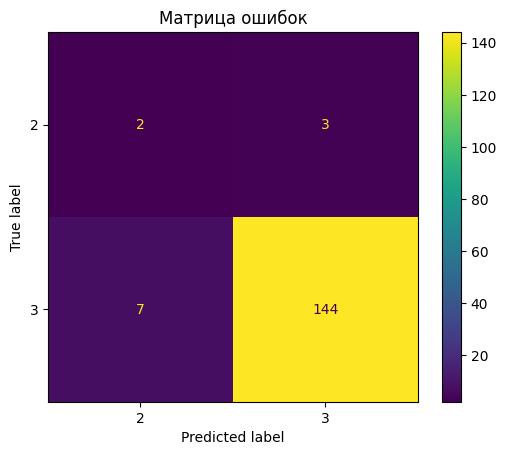

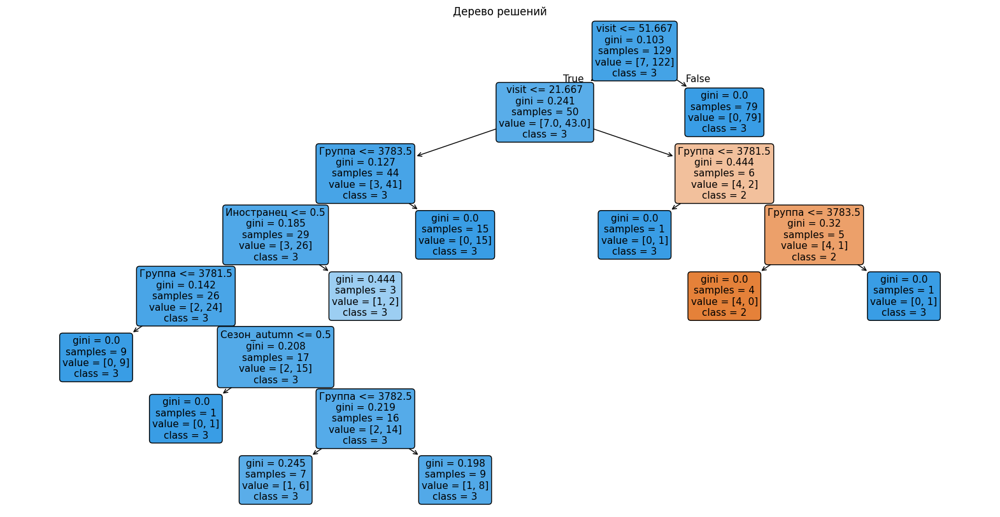

Дисциплина: Практический курс английского языка
F1-score (macro): 0.48


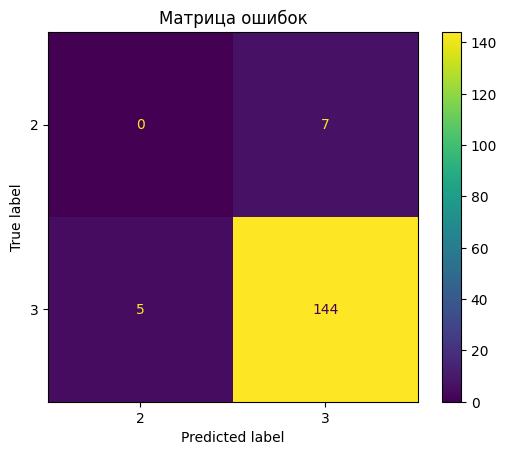

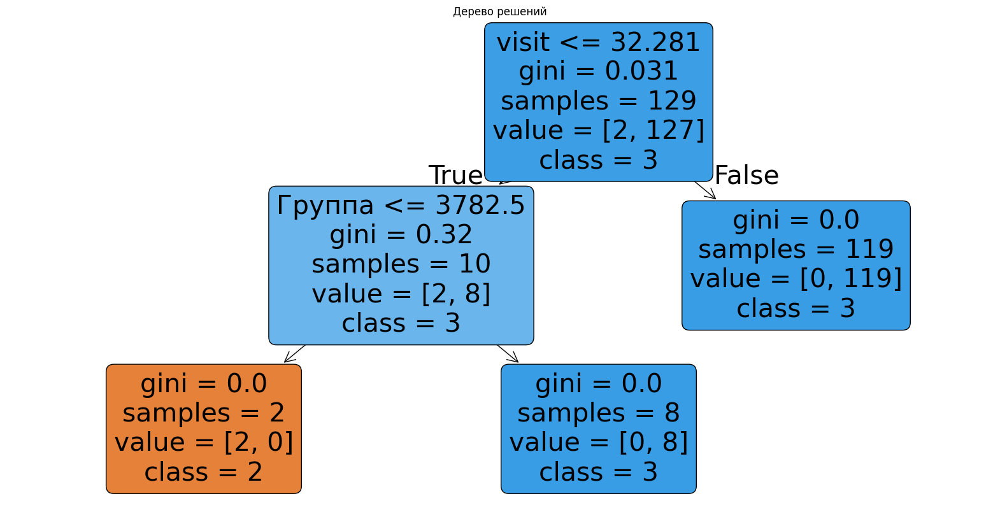

Дисциплина: Программирование
F1-score (macro): 0.57472881733947


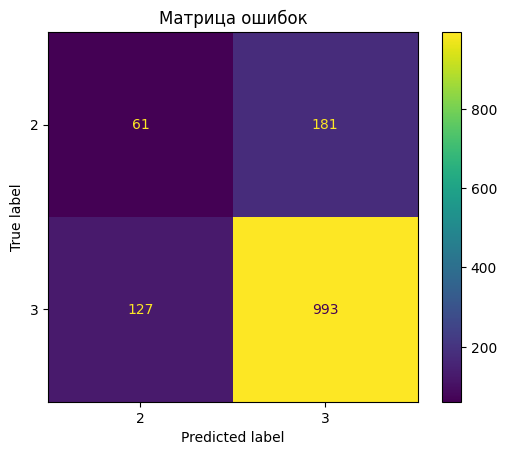

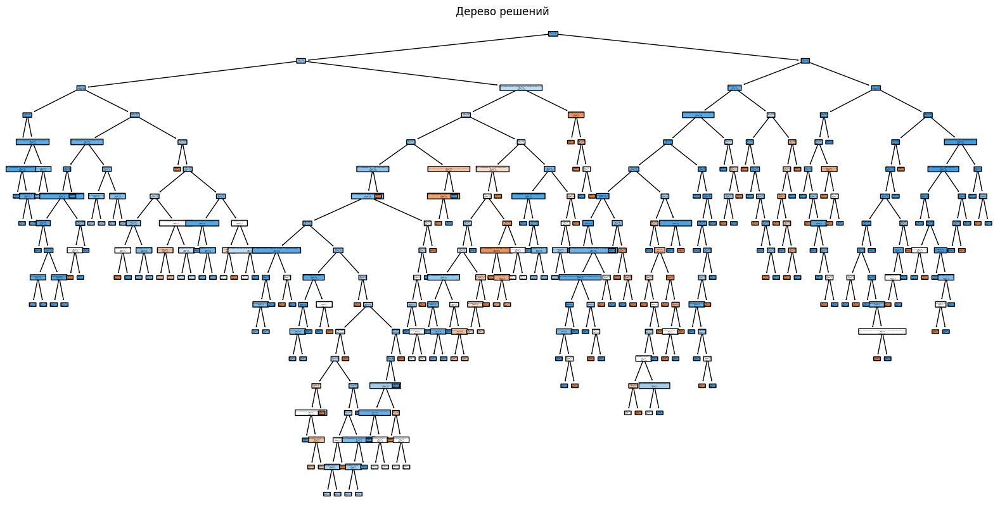

Дисциплина: Психология
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


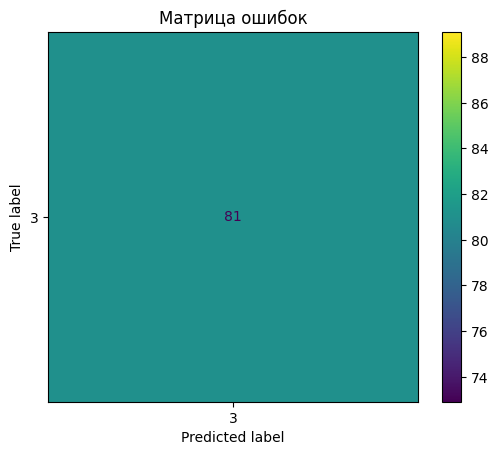

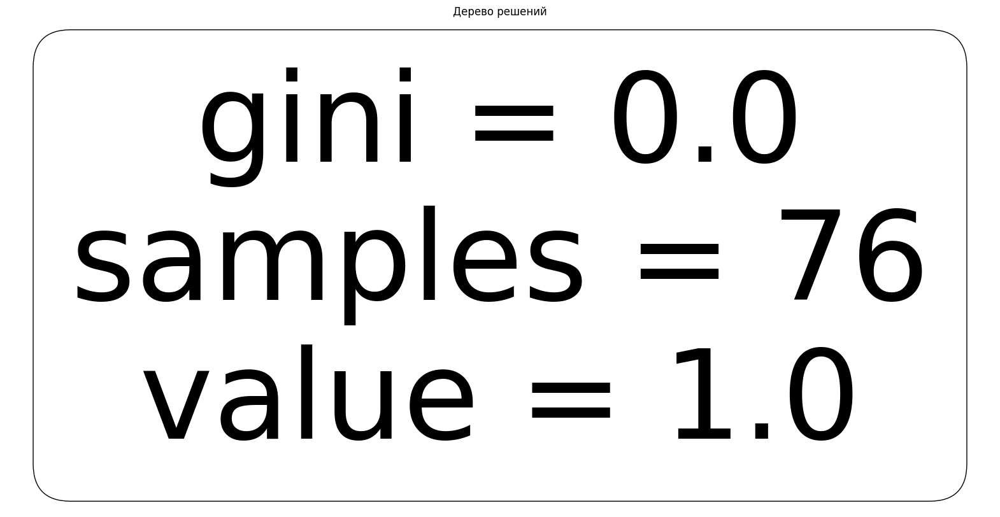

Дисциплина: Редактирование текстов массовой коммуникации
F1-score (macro): 0.49122807017543857


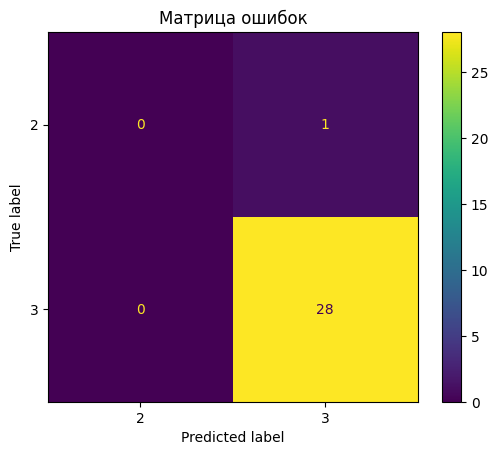

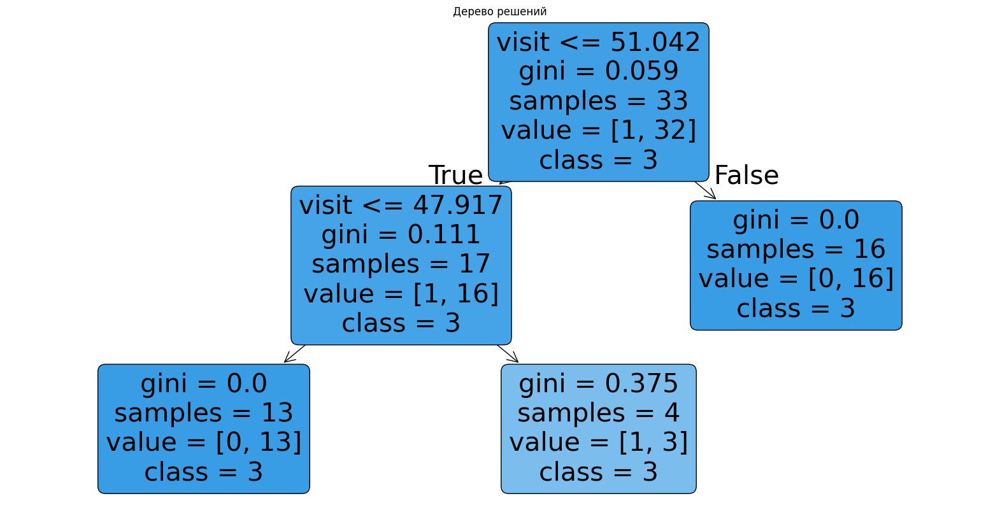

Дисциплина: Риторика
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


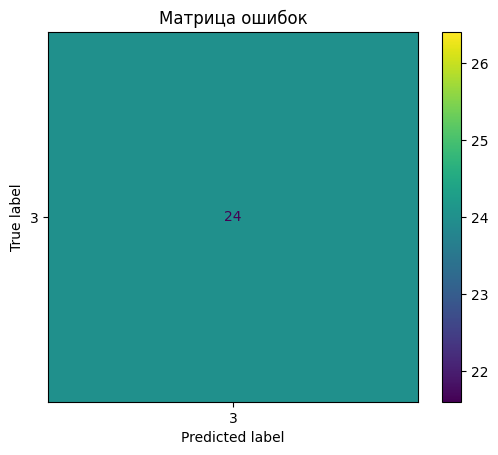

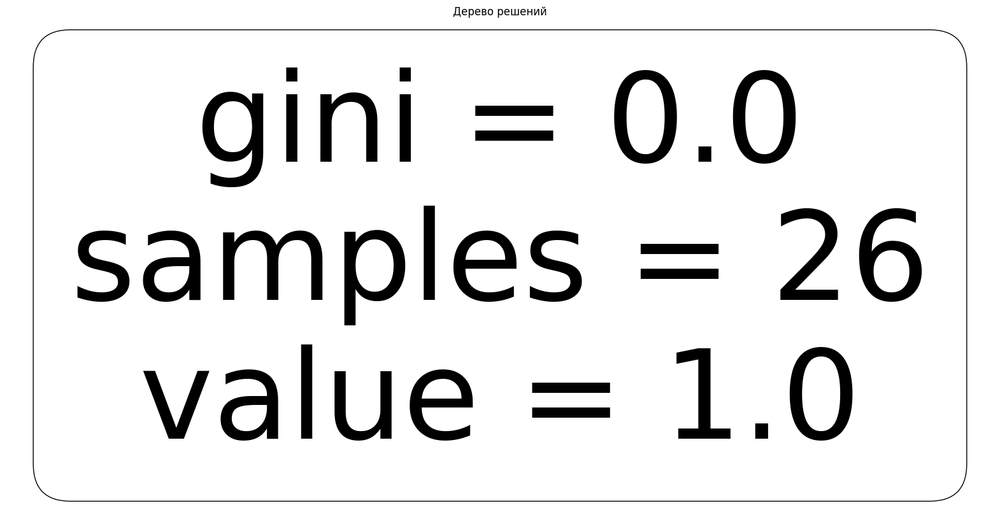

Дисциплина: Русский язык и культура речи
F1-score (macro): 0.4915254237288136


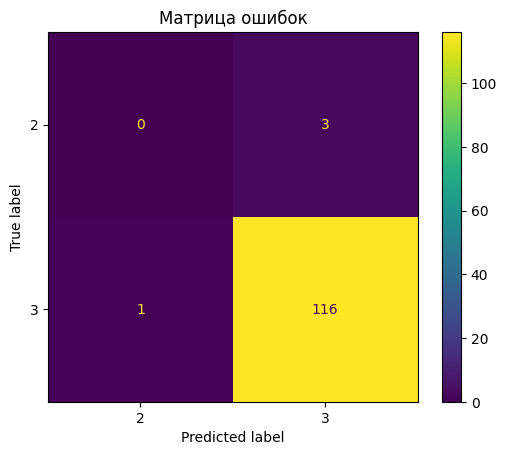

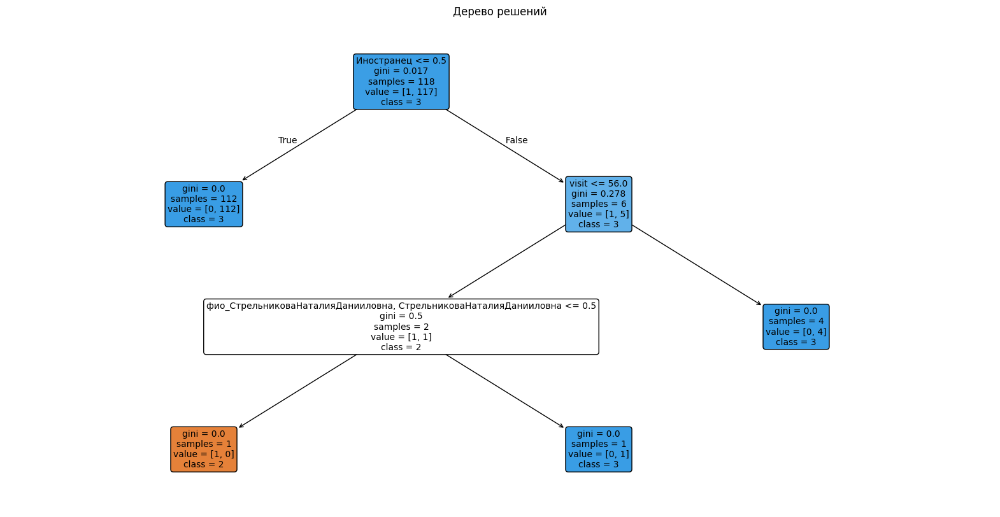

Дисциплина: Социолингвистика
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


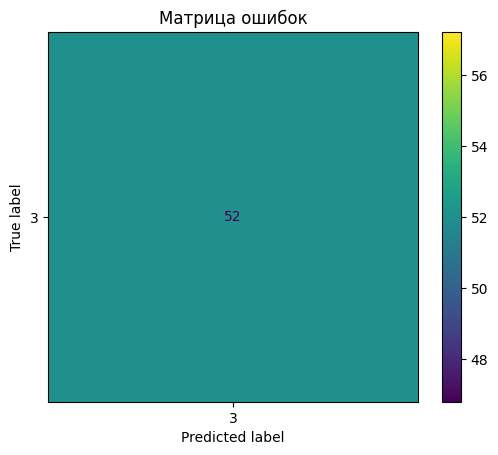

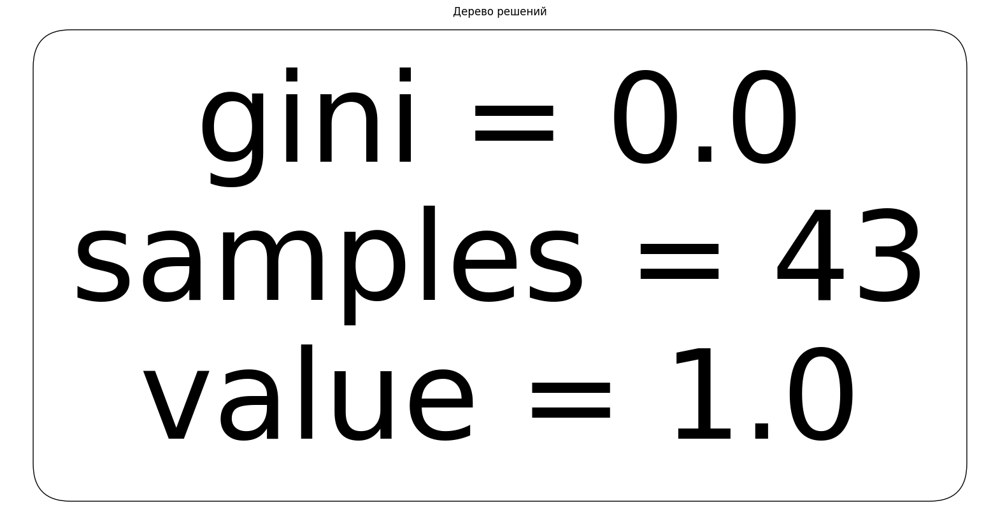

Дисциплина: Социология
F1-score (macro): 0.49162011173184356


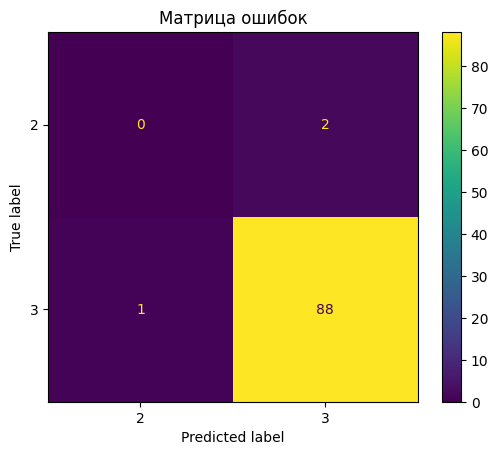

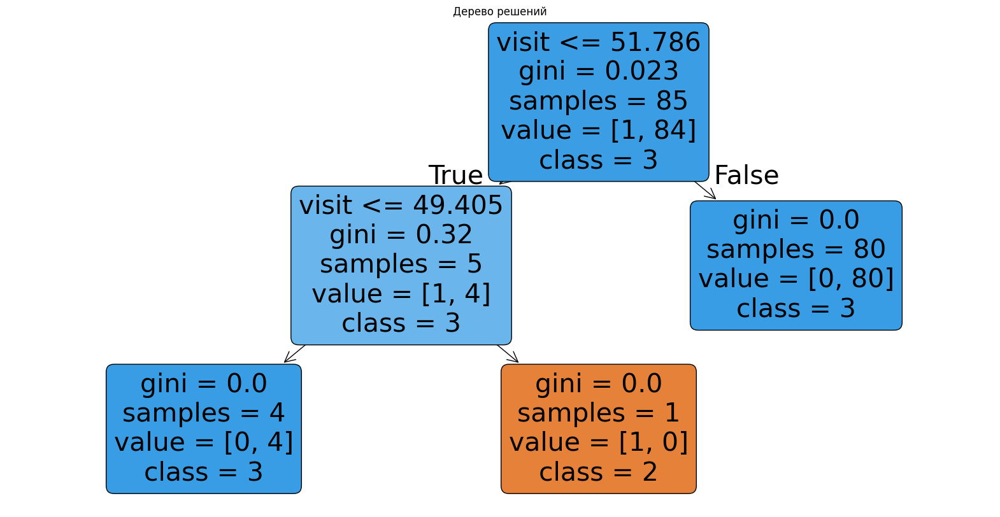

Дисциплина: Тайм-менеджмент
F1-score (macro): 0.4375


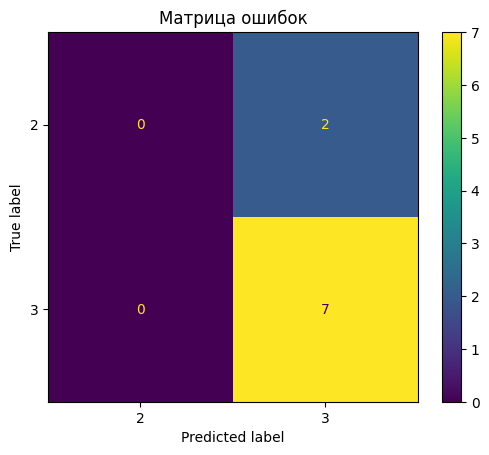

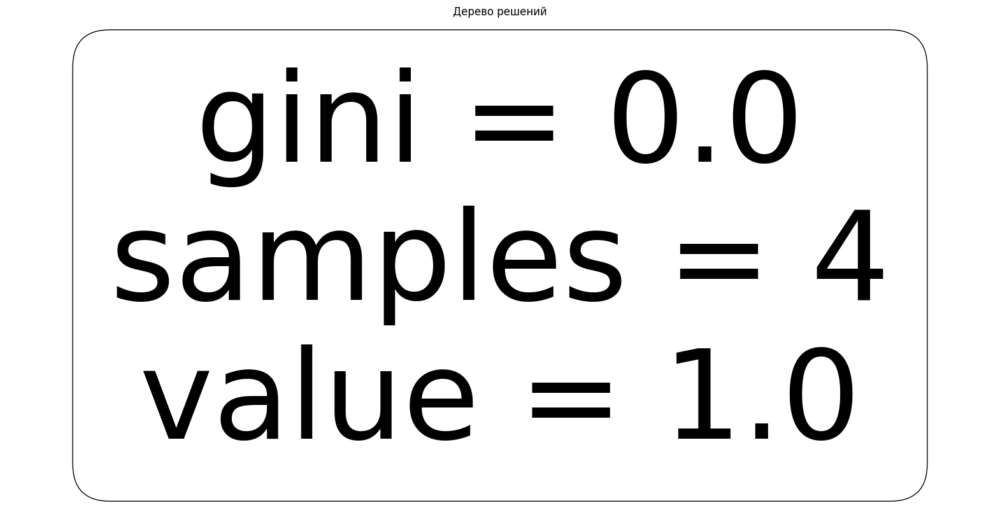

Дисциплина: Теоретическая механика
F1-score (macro): 0.5604635310156783


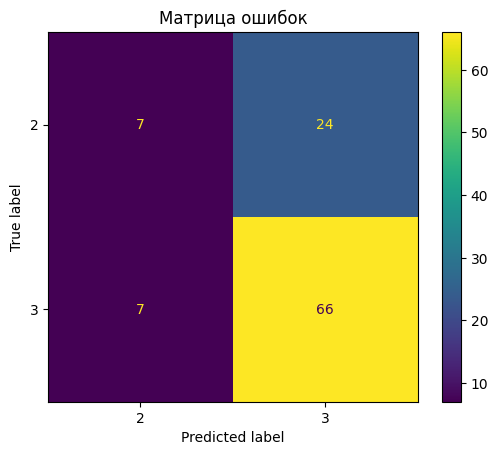

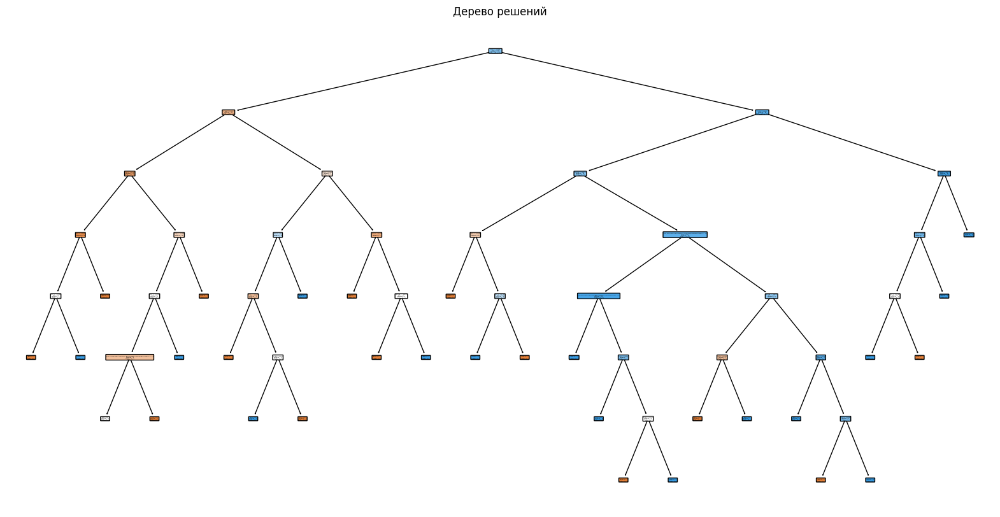

Дисциплина: Теоретическая фонетика
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


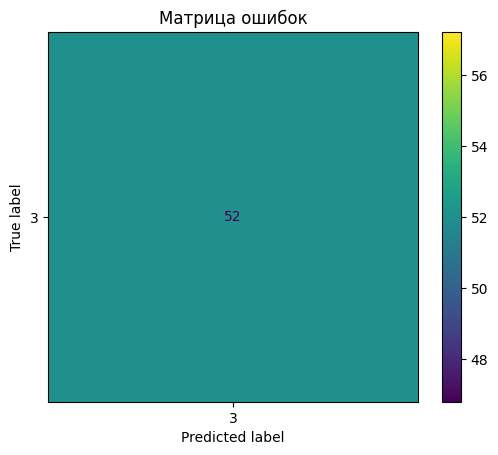

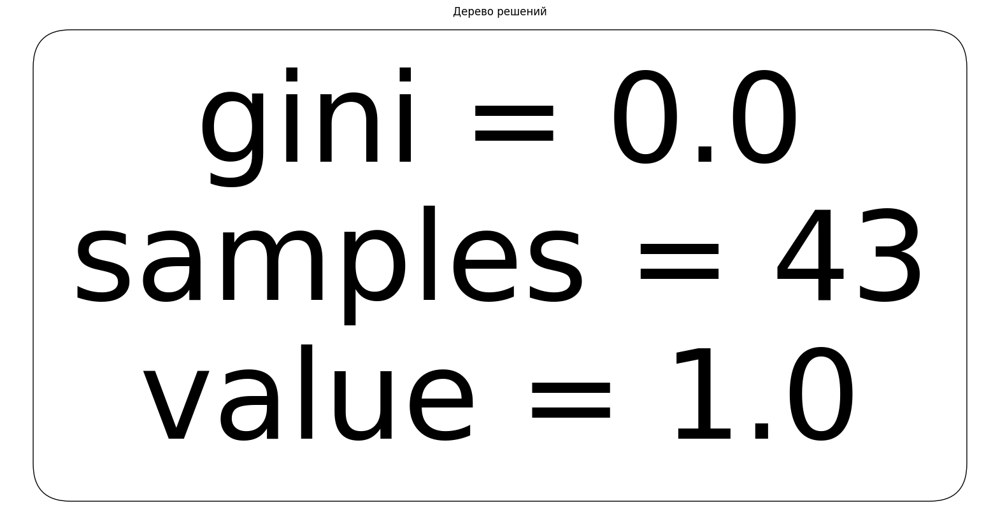

Дисциплина: Теория вероятностей и математическая статистика
F1-score (macro): 0.6307692307692307


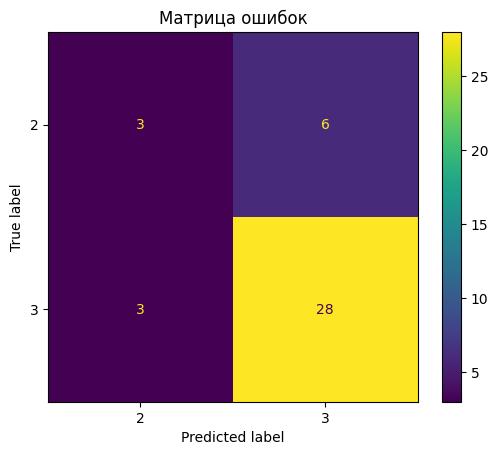

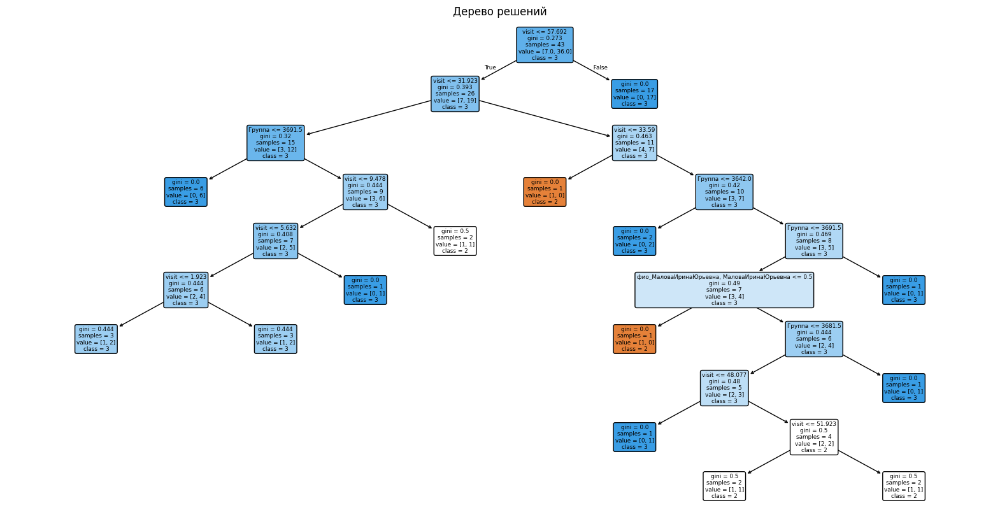

Дисциплина: Теория и практика рекламы
F1-score (macro): 0.4889867841409692


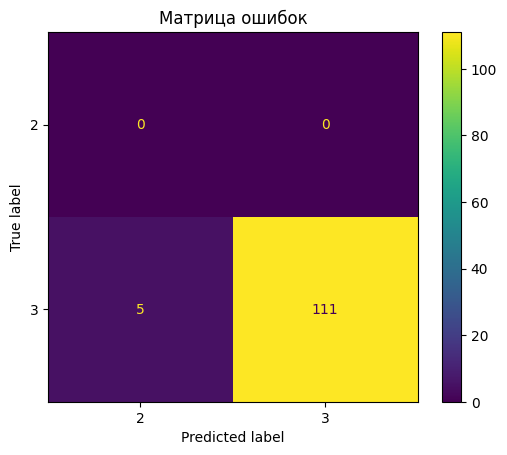

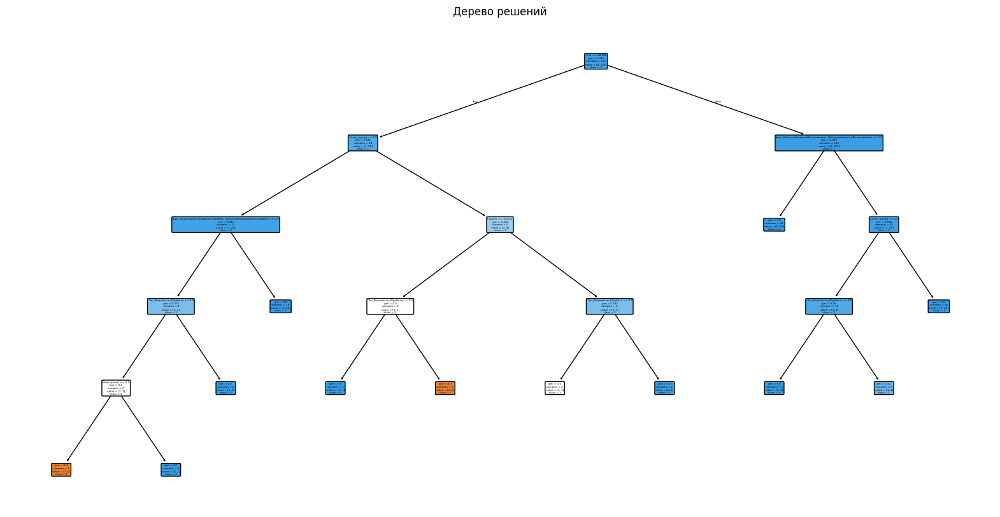

Дисциплина: Теория и практика связей с общественностью
F1-score (macro): 0.4956521739130435


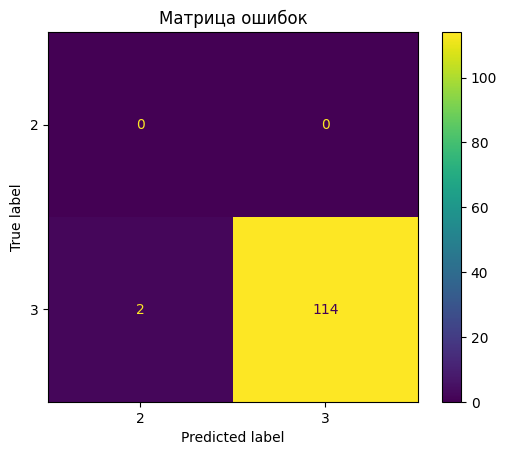

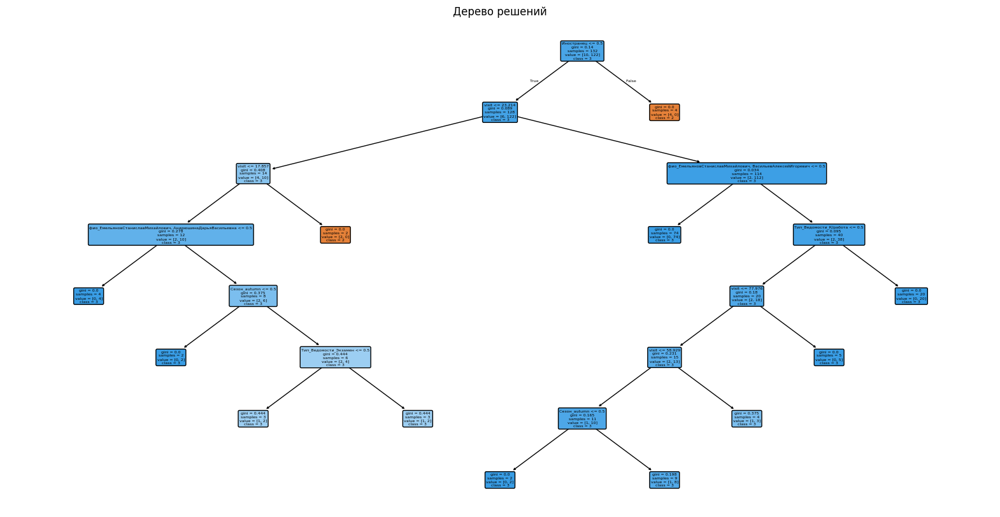

Дисциплина: Теория менеджмента
F1-score (macro): 0.7103357472021066


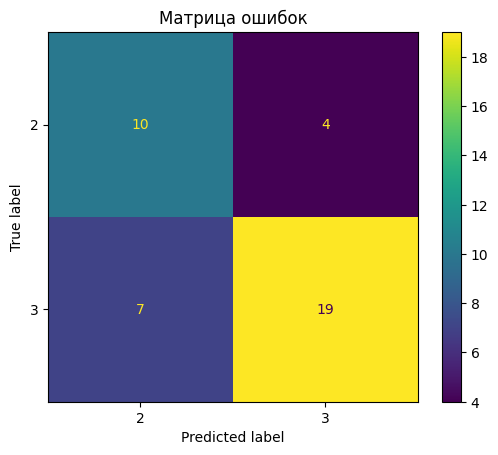

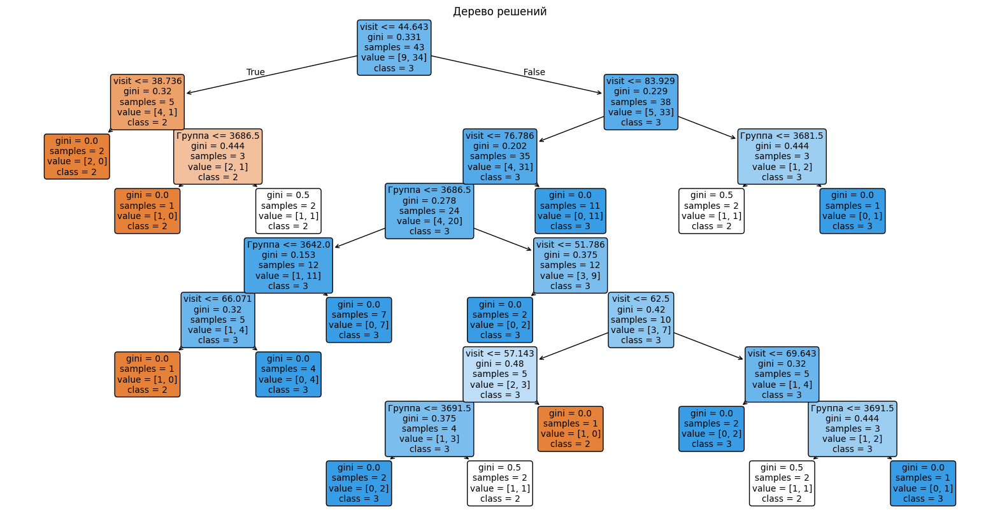

Дисциплина: Технологии карьерного роста
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


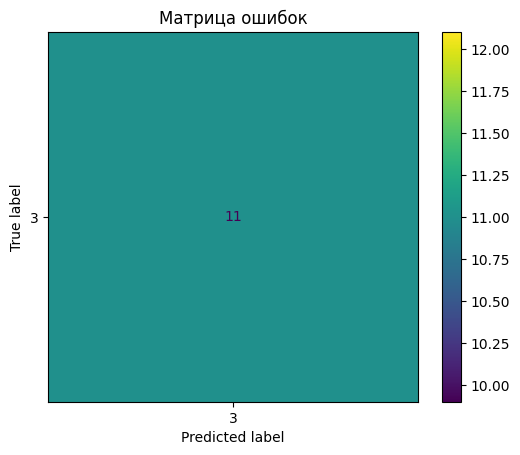

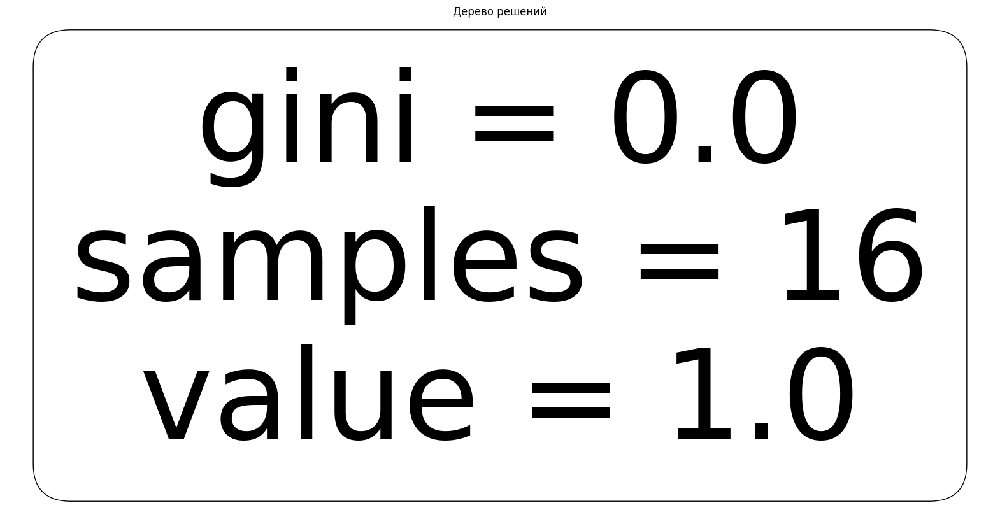

Дисциплина: Традиции и новые тенденции в языкознании
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


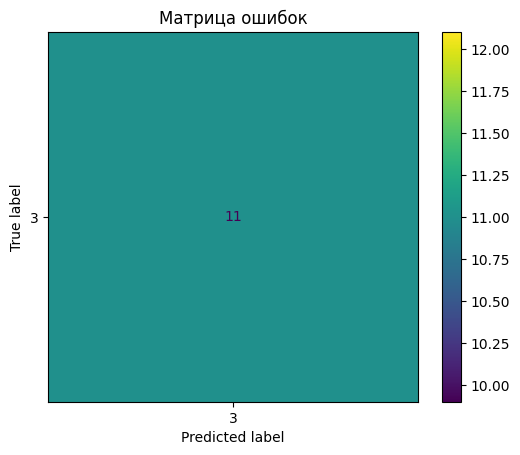

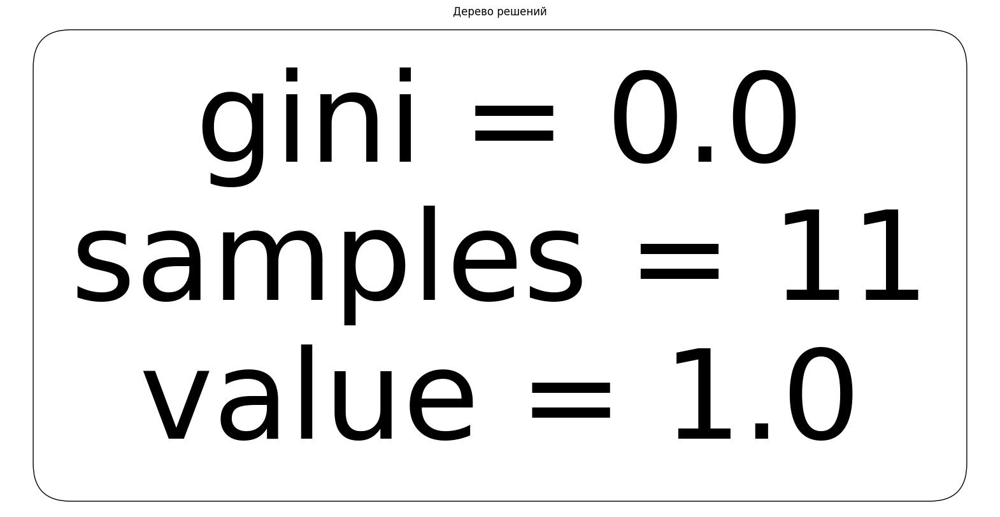

Дисциплина: Физика
F1-score (macro): 0.6247614305866733


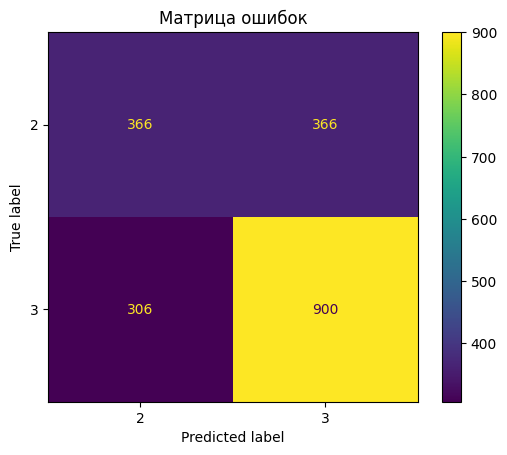

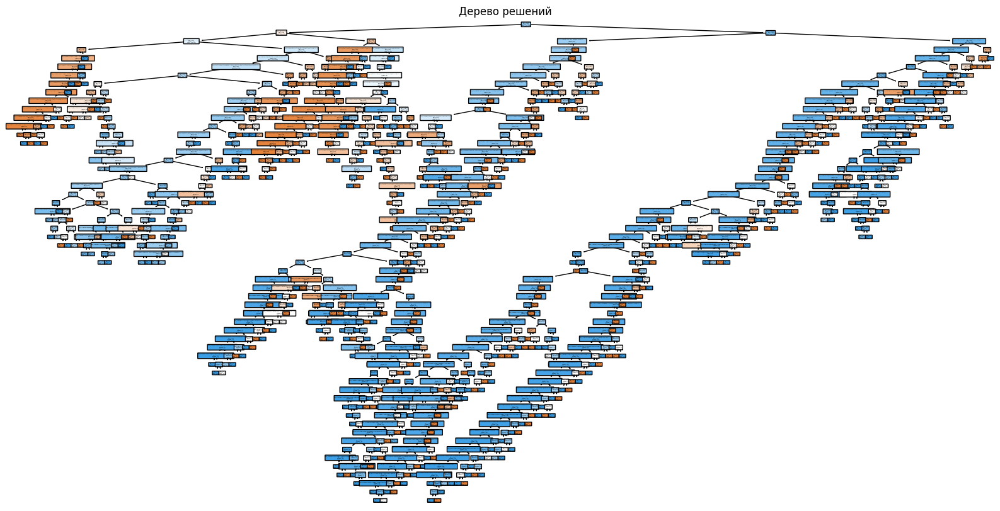

Дисциплина: Физическая культура и спорт
F1-score (macro): 0.5275


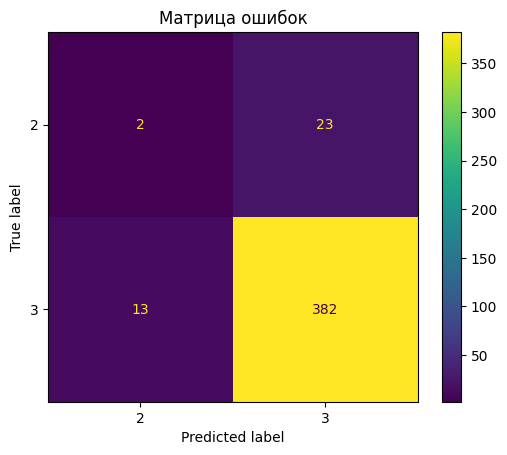

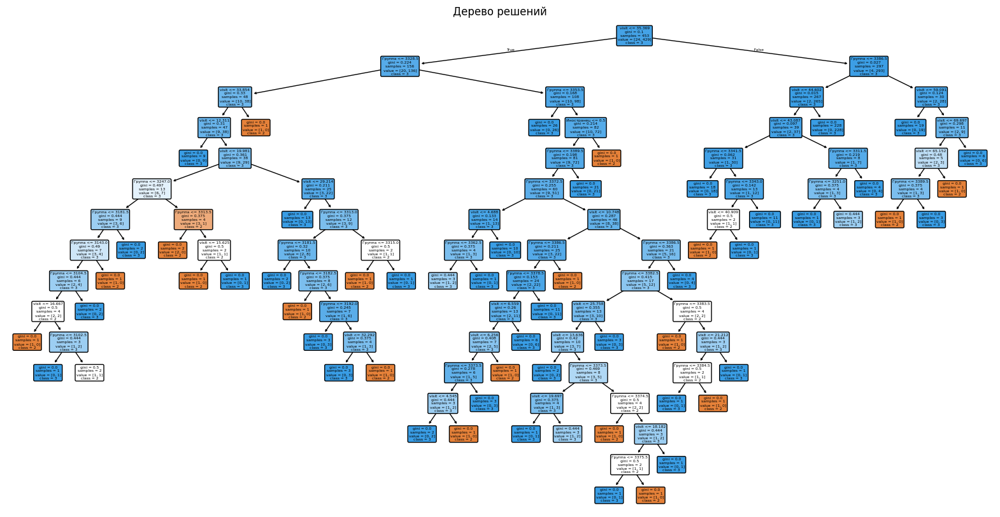

Дисциплина: Философия
F1-score (macro): 0.6256373557563288


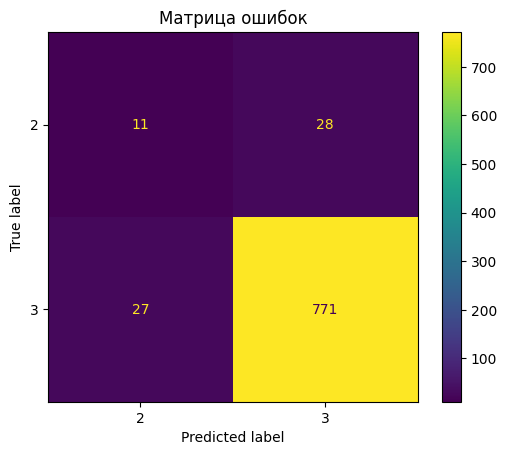

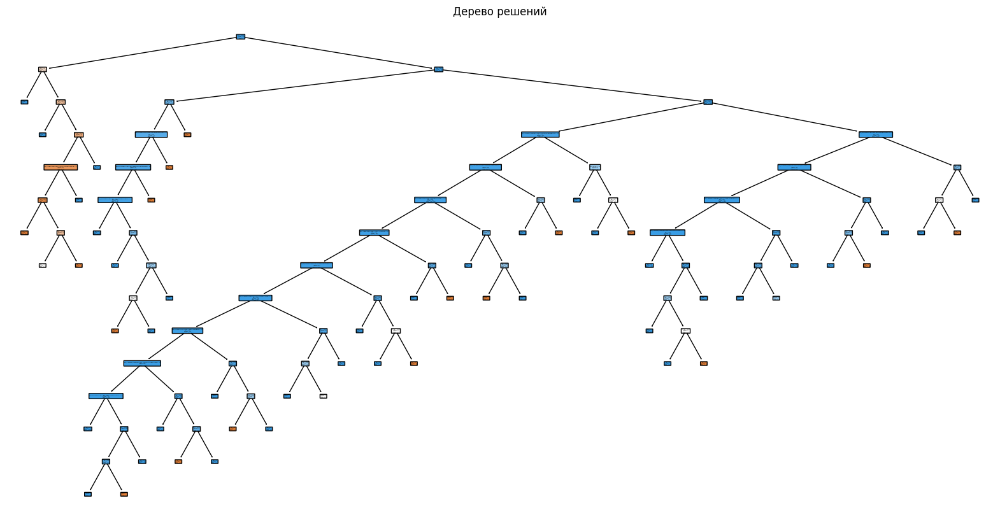

Дисциплина: Химия
F1-score (macro): 0.5994449009970074


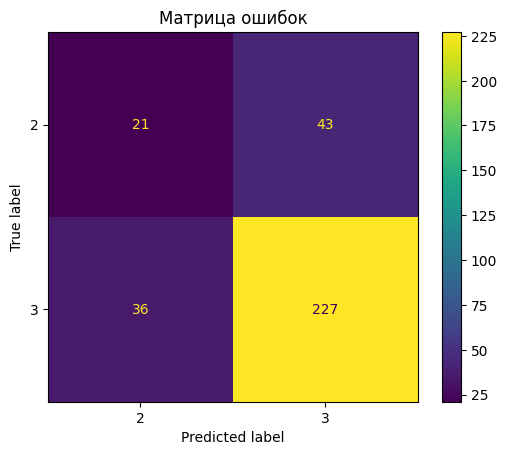

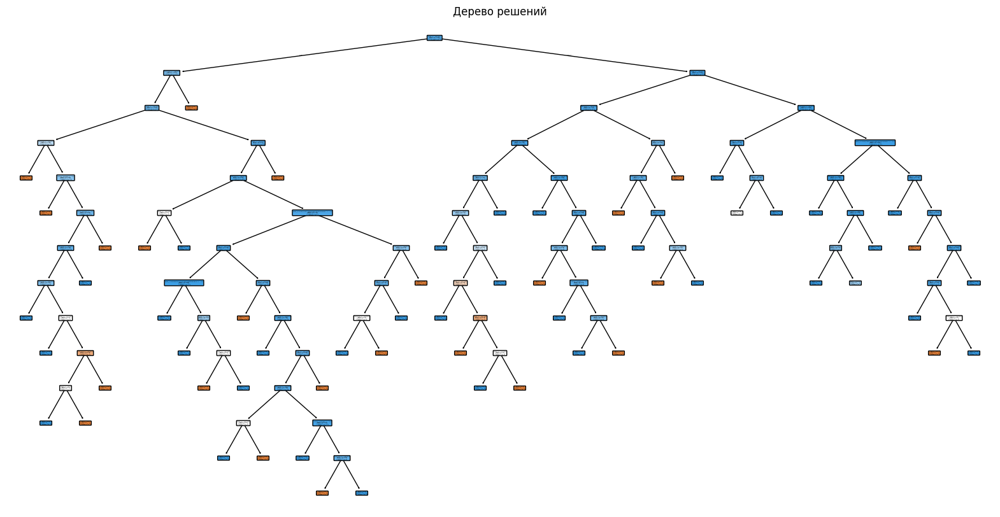

Дисциплина: Экология
F1-score (macro): 0.49956098675743615


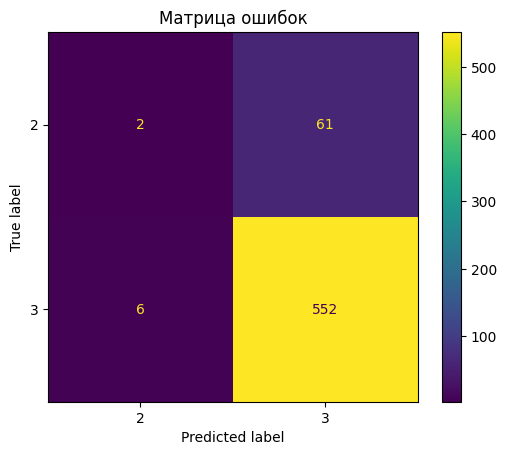

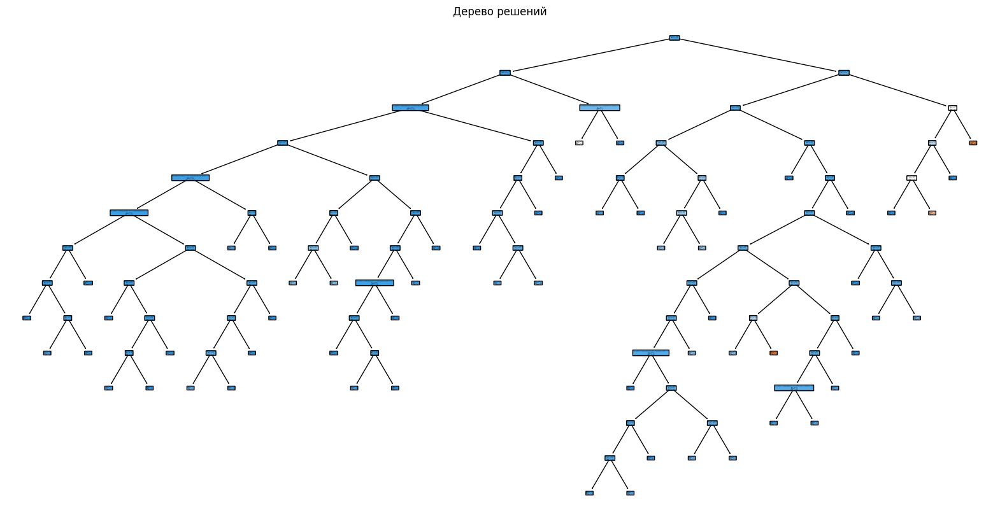

Дисциплина: Экономика
F1-score (macro): 1.0


/Users/derkacheva-dy/python_projects/leti/venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


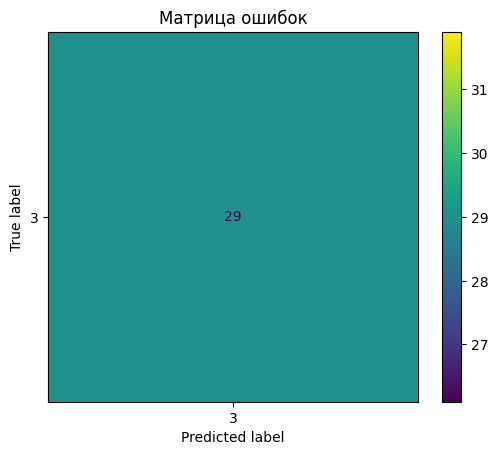

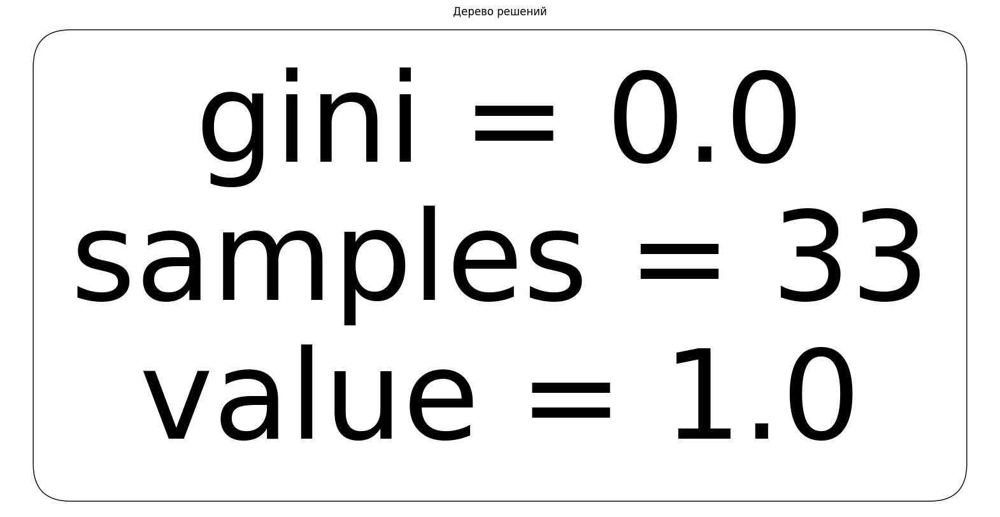

Дисциплина: Эффективное лидерство
F1-score (macro): 0.4782608695652174


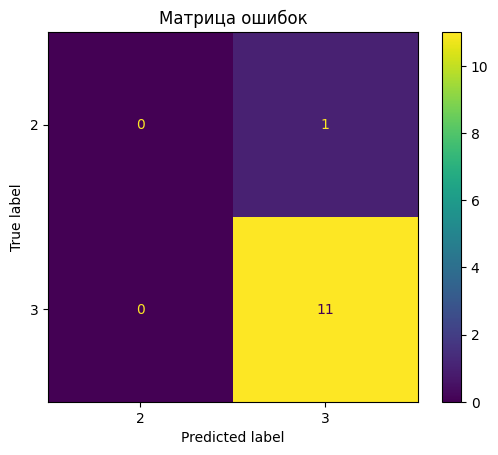

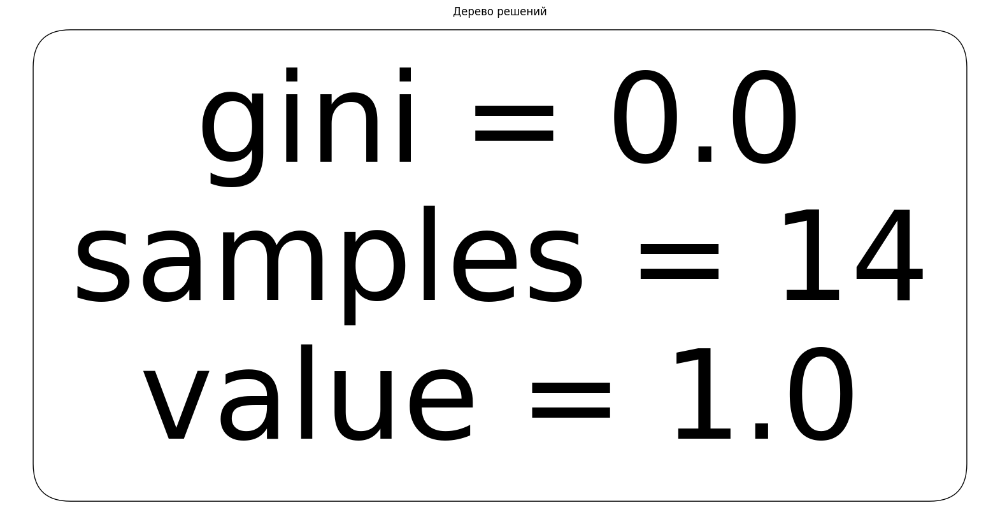

In [137]:
# troubles with labels

import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.tree import plot_tree


df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект') & (df_sorted['Кафедра'] != 'каф.ИБ') & (df_sorted['Кафедра'] != 'каф.ТВ')]

grouped = df_sorted.groupby(['Дисциплина', 'Группа', 'фио'])
filtered_groups = grouped.filter(lambda x: len(x) > 1)

df_sorted = df_sorted[df_sorted['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
#df_sorted = df_sorted[df_sorted['Дисциплина'] != 'История искусства'] #неправильно считается дерево
df_sorted = df_sorted[df_sorted['Дисциплина'] != 'Основы теории коммуникации'] 

df_subjects = get_subj(df_sorted)
f1_array = []


def conf_matrix(y_test, y_pred, class_names):
    # Создаем confusion matrix с явными метками классов
    confmat = confusion_matrix(y_test, y_pred, labels=class_names)
    disp = ConfusionMatrixDisplay(confusion_matrix=confmat, display_labels=class_names)
    disp.plot(cmap='viridis')
    plt.grid(False)
    plt.title('Матрица ошибок')
    plt.show()

# Основной цикл
for value in df_subjects:
    # (другие части кода)
    df_sorted = df_subjects[value]  # Теперь мы просто берем соответствующий DataFrame по ключу `value`, т.е. имени дисциплины.
    
    # Разделение на чётные и нечётные по 'ID ЛК'
    df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
    df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]
    
    
    # Подготовка тренировочных и тестовых данных
    X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
    y_train = df1['ПерваяПопытка'].reset_index(drop=True)
    
    X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
    y_test = df2['ПерваяПопытка'].reset_index(drop=True)
    
    visits_train = X_train['visit']
    visits_test = X_test['visit']
    
    
    # Применяем get_dummies ко всем остальным колонкам
    X_tr = pd.get_dummies(X_train.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x', 'finans']))
    X_te = pd.get_dummies(X_test.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x', 'finans']))
    
    # Добавляем колонку 'visit' обратно
    X_tr['visit'] = X_train['visit']
    X_te['visit'] = X_test['visit']
    
    # Добавляем остальные колонки обратно
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    
    X_tr['Семестр'] = X_train['Семестр']
    X_te['Семестр'] = X_test['Семестр']
    
    X_tr['Курс'] = X_train['Курс_x']
    X_te['Курс'] = X_test['Курс_x']
    
    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})
    
    # Создаём и обучаем дерева решений
    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    
    # Предсказания на тестовых данных
    y_pred = tree.predict(X_te)

    # Динамическая проверка уникальных классов
    unique_classes_te = np.unique(y_te)
    unique_classes_pred = np.unique(y_pred)
    unique_classes = np.unique(np.concatenate((unique_classes_te, unique_classes_pred)))

    print(f'Дисциплина: {value}')

    f1_macro = f1_score(y_te, y_pred, average='macro')
    f1_micro = f1_score(y_te, y_pred, average='micro')
    
    #print(f'F1-score (micro): {f1_micro}')
    print(f'F1-score (macro): {f1_macro}')
    f1_array.append(f1_micro)
    
    # Преобразуйте классы в строки для передачи в визуализацию
    class_names = [str(cls) for cls in unique_classes]

    # Визуализация матрицы ошибок 
    conf_matrix(y_te, y_pred, unique_classes)

    # Визуализация дерева решений с теми же динамическими метками
    plt.figure(figsize=(20, 10))
    plot_tree(tree, feature_names=X_te.columns, class_names=class_names, filled=True, rounded=True)
    plt.title('Дерево решений')
    plt.savefig( value +'decision_tree_high_res.png', format='png', dpi=600, bbox_inches='tight')
    plt.show()



In [45]:
w_teach

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
0,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,89.727093,3182,"МалышевМихаилНиколаевич, ШаталоваАлександраБор..."
1,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,66.666667,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
2,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,95.396825,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
3,10123,4,1,Алгебра и геометрия,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,84.926471,3182,"ЛычагинаЕленаБорисовна, РомановаЮлияСтаниславовна"
4,10123,4,1,Математический анализ,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,91.176471,3182,"РомановаЮлияСтаниславовна, РомановаЮлияСтанисл..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35763,10280323,3,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3354,NaN
35764,10280323,4,1,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,73.333333,3354,NaN
35765,10280323,4,2,Информационные технологии,каф.САПР,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3.571429,3354,"КопецЕкатеринаЕвгеньевна, КопецЕкатеринаЕвгень..."
35766,10280323,5,1,Физическая культура и спорт,каф.ФВиС,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,66.666667,3354,NaN


In [57]:
df_sorted

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
253,30623,5,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,417368.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,37.50,3603,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
1610,150623,5,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,417568.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,62.50,3603,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
9656,910623,2,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,416189.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,18.75,3603,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
1980,180623,4,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,418419.0,True,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,25.00,3681,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
8524,800623,5,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,417090.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,31.25,3681,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
10003,940623,5,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,415020.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,43.75,3681,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
990,100623,5,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,418386.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,56.25,3682,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
2637,240623,5,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,416737.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,50.00,3682,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
4556,430623,4,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,416709.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,25.00,3682,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."
4737,450623,5,2,Эффективное лидерство,каф.МСК,Дифференцированный зачет,416770.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,56.25,3682,"ЕрочкинаОльгаАлександровна, ЕрочкинаОльгаАлекс..."


In [ ]:
class_names = ['2', '3']  
conf_matrix(y_te, y_pred, class_names)

In [40]:
df2[df2['Дисциплина'] == 'Введение в коммуникационные специальности']['ПерваяПопытка'].unique()


array([5, 4])

In [41]:
print("y_test уникальные классы:", y_te.unique())
print("y_pred уникальные классы:", np.unique(y_pred))

y_test уникальные классы: [3]
y_pred уникальные классы: [3]


### Как растет оценка при росте посещаемости

#### Возьму одинакого студента и посмотрю, что будет меняться при изменении его параметров

- ПерваяПопытка	- целевая переменная
- Семестр    - 2
- Дисциплина	- Физика
- Кафедра	- каф.Физики	
- Тип_Ведомости	- Экзамен
- Иностранец	- False
- Курс_x	- 1
- finans	- Бюджет
- status	- Учащийся
- Уровень образования	- Бакалавриат
- Год	- 2023
- visit	- 89.727093
- Группа	- 3182
- фио - МалышевМихаилНиколаевич, ШаталоваАлександраБорисовна

In [78]:
w_teach[w_teach['Дисциплина'] == 'Физика']['finans'].unique()

array(['Бюджет', 'Целевой прием', 'Контракт'], dtype=object)

Значения, которые может принимать каждый из признаков
- ПерваяПопытка	- целевая переменная
- Семестр    - 1, 2, 3
- Дисциплина	- Физика [ее закрепим для нашего эксперимента]
- Кафедра	- каф.Физики	[ее закрепим для нашего эксперимента]
- Тип_Ведомости	- Экзамен, Дифференцированный зачет
- Иностранец	- False, True
- finans - Бюджет, Целевой прием, Контракт
- status - Учащийся [ее закрепим для нашего эксперимента]
- Уровень образования - Бакалавриат [ее закрепим для нашего эксперимента]
- Год	- 2023
- visit	- любые float-значения от 1 до 100
- Группа	- 3182, 3193, 3104
- фио - МалышевМихаилНиколаевич, ШаталоваАлександраБорисовна

In [101]:
# Студенты разделены по четности ID ЛК
df_sorted = w_teach.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект') & (df_sorted['Дисциплина'] == 'Физика')]


df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]


df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

visits_train = X_train['visit']
visits_test = X_test['visit']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))
X_te = pd.get_dummies(X_test.drop(columns=['visit', 'Группа', 'Семестр', 'Курс_x']))

# Добавляем колонку visits обратно
X_tr['visit'] = X_train['visit']
X_te['visit'] = X_test['visit']

# Добавляем колонку Группа обратно
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Добавляем колонку Семестр обратно
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']


y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)


In [105]:
df_sorted.head()

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
1140,120123,3,2,Физика,каф.Физики,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,0.000000,3101,"КозловДмитрийМихайлович, ЧургановаСерафимаСерг..."
1141,120123,3,2,Физика,каф.Физики,Экзамен,417061.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,61.309524,3101,"КозловДмитрийМихайлович, ЧургановаСерафимаСерг..."
2291,220123,5,2,Физика,каф.Физики,Экзамен,416841.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,0.000000,3101,"КозловДмитрийМихайлович, ЧургановаСерафимаСерг..."
2292,220123,5,2,Физика,каф.Физики,Экзамен,416841.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,77.380952,3101,"КозловДмитрийМихайлович, ЧургановаСерафимаСерг..."
2298,220320,2,2,Физика,каф.Физики,Экзамен,383979.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,0.000000,3101,"КозловДмитрийМихайлович, ЧургановаСерафимаСерг..."


In [140]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

# Пример создания DataFrame с вашими данными (замените на ваши реальные данные)
# Убедитесь, что вы имеете доступ к данным w_teach и они обработаны должным образом
# Например:

your_dataframe = w_teach

# фильтруем
df_sorted = your_dataframe.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3)]
                      # & (df_sorted['Тип_Ведомости'] != 'К/проект')
                      # & (df_sorted['Дисциплина'] == 'Физика')]

# Разделяем на обучающую и тестовую выборку по четности ID ЛК
df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0].copy()
df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1].copy()

# Исключаем определенные записи
df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']

X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год', 'Уровень образования', 'Форма образования', 'Сезон', 'Курс_x'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год', 'Уровень образования', 'Форма образования', 'Сезон', 'Курс_x'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

# Определим категориальные признаки
categorical_features = ['Кафедра', 'Тип_Ведомости', 'finans', 'фио', 'Дисциплина', 'status']

# Создаем трансформатор с OneHotEncoder
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_features)
    ],
    remainder='passthrough'
)

# Создаем конвейер для обучения
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', DecisionTreeClassifier(random_state=43))
])

# Преобразуем метки
y_train = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})

# Обучаем модель
model.fit(X_train, y_train)

# Данные студента
student_data = {
    'Семестр': 2,
    'Дисциплина': 'Физика',
    'Кафедра': 'каф.Физики',
    'Тип_Ведомости': 'Экзамен',
    'Иностранец': False,
    'finans': 'Бюджет',
    'status': 'Учащийся',
    'visit': 89.727093,
    'Группа': 3182,
    'фио': 'МалышевМихаилНиколаевич, ШаталоваАлександраБорисовна'
}

# Подготавливаем данные студента для предсказания
student_df = pd.DataFrame([student_data])

# Выполняем предсказание
base_prediction = model.predict(student_df)
print(f"Base prediction: {base_prediction[0]}")

# Определяем возможные изменения для каждого признака
combinations = {
    'Семестр': [1, 2, 3],
    'Тип_Ведомости': ['Экзамен', 'Дифференцированный зачет'],
    'Иностранец': [False, True],
    'finans': ['Бюджет', 'Целевой прием', 'Контракт'],
    'visit': [0.0, 10.0, 25.0, 40.0, 51.0, 68.0, 70.0, 90.0, 100.0],
    'Группа': [3182, 3193, 3104]
}

# Изменяем каждый признак поочередно и выполняем предсказание
for feature, values in combinations.items():
    for value in values:
        modified_data = student_data.copy()
        modified_data[feature] = value

        modified_df = pd.DataFrame([modified_data])
        
        # Прогноз
        prediction = model.predict(modified_df)
        print(f"{feature} изменяем на {value} -> Ожидаемая оценка: {prediction[0]}")

Base prediction: 3
Семестр изменяем на 1 -> Ожидаемая оценка: 3
Семестр изменяем на 2 -> Ожидаемая оценка: 3
Семестр изменяем на 3 -> Ожидаемая оценка: 3
Тип_Ведомости изменяем на Экзамен -> Ожидаемая оценка: 3
Тип_Ведомости изменяем на Дифференцированный зачет -> Ожидаемая оценка: 3
Иностранец изменяем на False -> Ожидаемая оценка: 3
Иностранец изменяем на True -> Ожидаемая оценка: 3
finans изменяем на Бюджет -> Ожидаемая оценка: 3
finans изменяем на Целевой прием -> Ожидаемая оценка: 3
finans изменяем на Контракт -> Ожидаемая оценка: 3
visit изменяем на 0.0 -> Ожидаемая оценка: 2
visit изменяем на 10.0 -> Ожидаемая оценка: 2
visit изменяем на 25.0 -> Ожидаемая оценка: 2
visit изменяем на 40.0 -> Ожидаемая оценка: 2
visit изменяем на 51.0 -> Ожидаемая оценка: 3
visit изменяем на 68.0 -> Ожидаемая оценка: 3
visit изменяем на 70.0 -> Ожидаемая оценка: 2
visit изменяем на 90.0 -> Ожидаемая оценка: 3
visit изменяем на 100.0 -> Ожидаемая оценка: 3
Группа изменяем на 3182 -> Ожидаемая оценк

In [138]:
import pandas as pd
import ipywidgets as widgets
from IPython.display import display

# Функция для обновления данных и предсказания
def update_prediction(sem, ved, foreign, fin, vis, group):
    modified_data = student_data.copy()
    modified_data['Семестр'] = sem
    modified_data['Тип_Ведомости'] = ved
    modified_data['Иностранец'] = foreign
    modified_data['finans'] = fin
    modified_data['visit'] = vis
    modified_data['Группа'] = group
    
    modified_df = pd.DataFrame([modified_data])
    
    prediction = model.predict(modified_df)
    print(f"Ожидаемая оценка: {prediction[0]}")

# Виджеты
sem_widget = widgets.Dropdown(
    options=[1, 2],
    description='Семестр:'
)

ved_widget = widgets.Dropdown(
    options=['Экзамен', 'Дифференцированный зачет'],
    description='Тип Ведомости:'
)

foreign_widget = widgets.Select(
    options=[False, True],
    description='Иностранец:'
)

fin_widget = widgets.Dropdown(
    options=['Бюджет', 'Целевой прием', 'Контракт'],
    description='Финансирование:'
)

vis_widget = widgets.SelectionSlider(
    options=[0.0, 5.0, 10.0, 25.0, 40.0, 51.0, 60.0, 68.0, 70.0, 80.0, 90.0, 100.0],
    description='Посещаемость:'
)

group_widget = widgets.Dropdown(
    options=[3182, 3193, 3104],
    description='Группа:'
)

# Отображение виджетов
ui = widgets.VBox([sem_widget, ved_widget, foreign_widget, fin_widget, vis_widget, group_widget])

out = widgets.interactive_output(update_prediction, {
    'sem': sem_widget,
    'ved': ved_widget,
    'foreign': foreign_widget,
    'fin': fin_widget,
    'vis': vis_widget,
    'group': group_widget
})

display(ui, out)

Output()

In [141]:
## Для различных уникальных значени из таблиы

# Функция для обновления данных и предсказания
def update_prediction(sem, subj, kaf, ved, foreign, fin, vis, group):
    modified_data = student_data.copy()
    modified_data['Семестр'] = sem
    modified_data['Дисциплина'] = subj
    modified_data['Кафедра'] = kaf
    modified_data['Тип_Ведомости'] = ved
    modified_data['Иностранец'] = foreign
    modified_data['finans'] = fin
    modified_data['visit'] = vis
    modified_data['Группа'] = group
    
    modified_df = pd.DataFrame([modified_data])
    
    prediction = model.predict(modified_df)
    print(f"Ожидаемая оценка: {prediction[0]}")

# Виджеты
sem_widget = widgets.Dropdown(
    options=df_sorted['Семестр'].unique(),  
    description='Семестр:'
)

subj_widget = widgets.Dropdown(
    options=df_sorted['Дисциплина'].unique(),  
    description='Дисциплина:'
)

kaf_widget = widgets.Dropdown(
    options=df_sorted['Кафедра'].unique(),  
    description='Кафедра:'
)

ved_widget = widgets.Dropdown(
    options=df_sorted['Тип_Ведомости'].unique(), 
    description='Тип Ведомости:'
)

foreign_widget = widgets.Select(
    options=df_sorted['Иностранец'].unique(), 
    description='Иностранец:'
)

fin_widget = widgets.Dropdown(
    options=df_sorted['finans'].unique(), 
    description='Финансирование:'
)

vis_widget = widgets.SelectionSlider(
    options=sorted(df_sorted['visit'].unique()),
    description='Посещаемость:'
)

group_widget = widgets.Dropdown(
    options=df_sorted['Группа'].unique(), 
    description='Группа:'
)

# Отображение виджетов
ui = widgets.VBox([sem_widget, subj_widget, kaf_widget, ved_widget, foreign_widget, fin_widget, vis_widget, group_widget])

out = widgets.interactive_output(update_prediction, {
    'sem': sem_widget,
    'subj': subj_widget,
    'kaf': kaf_widget,
    'ved': ved_widget,
    'foreign': foreign_widget,
    'fin': fin_widget,
    'vis': vis_widget,
    'group': group_widget
})

display(ui, out)

Output()

In [143]:
w_teach

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
0,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,89.727093,3182,"МалышевМихаилНиколаевич, ШаталоваАлександраБор..."
1,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,66.666667,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
2,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,95.396825,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
3,10123,4,1,Алгебра и геометрия,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,84.926471,3182,"ЛычагинаЕленаБорисовна, РомановаЮлияСтаниславовна"
4,10123,4,1,Математический анализ,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,91.176471,3182,"РомановаЮлияСтаниславовна, РомановаЮлияСтанисл..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35763,10280323,3,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3354,NaN
35764,10280323,4,1,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,73.333333,3354,NaN
35765,10280323,4,2,Информационные технологии,каф.САПР,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3.571429,3354,"КопецЕкатеринаЕвгеньевна, КопецЕкатеринаЕвгень..."
35766,10280323,5,1,Физическая культура и спорт,каф.ФВиС,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,66.666667,3354,NaN


-------------

# Добавление уточнения типа пары

Добавим в посещаемость разделение по практикам, лекциям и лабораторным и будем считать как отдблную посещаемость

In [144]:
r_teach

,Дисциплина,Кафедра,Семестр,Группа,Курс,фио
0,3D конструирование электронных средств,каф.МИТ,8.0,191,4,"ИвановАркадийАнатольевич, ИвановАркадийАнатоль..."
1,3D-проектирование моделей протезов (3D Designi...,каф.БТС,1.0,9590,1,ШевченкоДмитрийСергеевич
2,CALS (ИПИ) технологии,каф.АПУ,5.0,1370,3,"ФоминОлегБорисович, ФоминОлегБорисович"
3,CALS (ИПИ) технологии,каф.АПУ,5.0,1371,3,"ФоминОлегБорисович, ФоминОлегБорисович"
4,IT консалтинг,каф.АПУ,3.0,8371,2,"КотоваЕленаЕвгеньевна, ЛившицМаринаВладимировна"
...,...,...,...,...,...,...
10967,Явления тепломассообмена в окружающей среде,каф.ИЗОС,1.0,9597,1,"КурановГеоргийЛеонидович, КурановГеоргийЛеонид..."
10968,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9401,1,"ЧмиленкоФедорВикторович, ЧмиленкоФедорВикторович"
10969,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9402,1,"ЧмиленкоФедорВикторович, ЧмиленкоФедорВикторович"
10970,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403,1,"ЧмиленкоФедорВикторович, ЧмиленкоФедорВикторович"


In [145]:
types = pd.read_csv('предметы_в_посещаемости.csv')
types

,ID,Title,ShortTitle,SubjectType,ControlType,IsDistant,Departments - DepartmentId → ID,Departments - DepartmentId → Title,Faculties - FacultyId → ID,Faculties - FacultyId → Title,SemesterSeasons - SemesterSeasonId → Year,SemesterSeasons - SemesterSeasonId → Season
0,1,Математическое моделирование объектов и систем...,ММОиСУ,Лаб,NaN,False,12,каф.КСУ,4,ФЭА,2023,autumn
1,2,Современные методы теории управления,СоврМТУ,Лек,Экз,False,25,каф.САУ,4,ФЭА,2023,autumn
2,3,Математическое моделирование объектов и систем...,ММОиСУ,Пр,NaN,False,12,каф.КСУ,4,ФЭА,2023,autumn
3,4,Основы промышленной цифровизации,ОснПрЦифр,Лек,ЗчО,False,25,каф.САУ,4,ФЭА,2023,autumn
4,5,Теория принятия решений,ТеорПрР,Пр,NaN,False,23,каф.РАПС,4,ФЭА,2023,autumn
...,...,...,...,...,...,...,...,...,...,...,...,...
6337,6400,RnD проект,RnD пр,Пр,ЗчО,True,6,каф.ВТ,3,ФКТИ,2024,autumn
6338,6401,Информационные технологии и компьютерная безоп...,ИТиКБ,Лек,ЗчО,False,23,каф.РАПС,4,ФЭА,2024,autumn
6339,6402,Цифровые технологии для обработки и анализа да...,ЦТДОиАД,Пр,Зч,True,9,каф.ИНЯЗ,7,ГФ,2024,autumn
6340,6403,Модели объектов и процессов информационных сис...,МОиПИС,Лек,Экз,True,2,каф.ИС,3,ФКТИ,2024,autumn


In [158]:
n_sub.head()

,Дисциплина,Кафедра,КодПланыСтроки,Курс,Семестр,Группа,ВидЗанятий,Экзамен,Зачёт,ЗачётСОценкой,Часов,Фамилия,Имя,Отчество,Должность,Звание,Степень
0,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,NaN,3,6.0,1781.0,Пр,True,NaN,NaN,102.0,Тонкова,Марина,Михайловна,NaN,Доцент,Кандидат наук
1,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,NaN,3,6.0,1781.0,Пр,True,NaN,NaN,102.0,Соколенко,Ирина,Витальевна,NaN,Нет,Нет
2,"Практический курс английского языка, п/г 1",каф.ИНЯЗ,NaN,3,5.0,1782.0,Пр,True,NaN,NaN,102.0,Соколова,Александра,Леонидовна,NaN,Нет,Нет
3,"Практический курс английского языка, п/г 2",каф.ИНЯЗ,NaN,3,5.0,1782.0,Пр,True,NaN,NaN,102.0,Петренко,Георгий,Кириллович,NaN,Нет,Нет
4,"Практический курс английского языка, п/г 3",каф.ИНЯЗ,NaN,3,5.0,1782.0,Пр,True,NaN,NaN,102.0,Филиппова,Юлия,Валерьевна,NaN,Доцент,Кандидат наук


ВидЗанятий : ['Пр' 'Лаб' 'КР' 'Лек' 'Прак' 'ВКР' 'КП' 'РукНПМ' 'ДРМ' 'ИЗ' 'Доб' 'ГАК'
 'МЭк' 'Асп']

In [167]:
n_sub = pd.read_csv('teachers.csv')
#n_sub.isna().sum()

In [168]:
n_sub['фио'] = n_sub['Фамилия'] + ' ' + n_sub['Имя'] + ' ' + n_sub['Отчество']
n_sub = n_sub[['Дисциплина', 'Кафедра', 'Курс', 'Семестр', 'Группа', 'ВидЗанятий', 'фио']]

n_sub = n_sub[(n_sub['ВидЗанятий'] == 'Лек') | (n_sub['ВидЗанятий'] == 'Пр') | (n_sub['ВидЗанятий'] == 'Лаб')]

n_sub = n_sub.dropna()

n_sub['Дисциплина'] = n_sub['Дисциплина'].apply(lambda x: x.split(',', maxsplit=1)[0])

n_sub['Группа'] = n_sub['Группа'].astype(int).astype(str)

n_sub = n_sub.groupby(['Дисциплина', 'Кафедра', 'Семестр', 'Группа', 'ВидЗанятий'], as_index=False).agg({
    'Курс': 'first',
    'фио': lambda x: ', '.join(x)
})

n_sub.to_csv('normal_fio.csv', index=False)

In [169]:
n_sub

,Дисциплина,Кафедра,Семестр,Группа,ВидЗанятий,Курс,фио
0,3D конструирование электронных средств,каф.МИТ,8.0,191,Лек,4,Иванов Аркадий Анатольевич
1,3D конструирование электронных средств,каф.МИТ,8.0,191,Пр,4,Иванов Аркадий Анатольевич
2,3D-проектирование моделей протезов (3D Designi...,каф.БТС,1.0,9590,Пр,1,Шевченко Дмитрий Сергеевич
3,CALS (ИПИ) технологии,каф.АПУ,5.0,1370,Лек,3,Фомин Олег Борисович
4,CALS (ИПИ) технологии,каф.АПУ,5.0,1370,Пр,3,Фомин Олег Борисович
...,...,...,...,...,...,...,...
16364,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9402,Лек,1,Чмиленко Федор Викторович
16365,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9402,Пр,1,Чмиленко Федор Викторович
16366,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403,Лек,1,Чмиленко Федор Викторович
16367,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403,Пр,1,Чмиленко Федор Викторович


In [172]:
types = types[['ID', 'Title', 'SubjectType', 'Departments - DepartmentId → Title']]
types

,ID,Title,SubjectType,Departments - DepartmentId → Title
0,1,Математическое моделирование объектов и систем...,Лаб,каф.КСУ
1,2,Современные методы теории управления,Лек,каф.САУ
2,3,Математическое моделирование объектов и систем...,Пр,каф.КСУ
3,4,Основы промышленной цифровизации,Лек,каф.САУ
4,5,Теория принятия решений,Пр,каф.РАПС
...,...,...,...,...
6337,6400,RnD проект,Пр,каф.ВТ
6338,6401,Информационные технологии и компьютерная безоп...,Лек,каф.РАПС
6339,6402,Цифровые технологии для обработки и анализа да...,Пр,каф.ИНЯЗ
6340,6403,Модели объектов и процессов информационных сис...,Лек,каф.ИС


In [173]:
result = n_sub.merge(
    types,
    how='left',
    left_on=['Дисциплина', 'ВидЗанятий', 'Кафедра'],
    right_on=['Title', 'SubjectType', 'Departments - DepartmentId → Title']
)

# Удаляем лишние столбцы из результата
result.drop(columns=['Title', 'SubjectType', 'Departments - DepartmentId → Title'], inplace=True)

result

,Дисциплина,Кафедра,Семестр,Группа,ВидЗанятий,Курс,фио,ID
0,3D конструирование электронных средств,каф.МИТ,8.0,191,Лек,4,Иванов Аркадий Анатольевич,2972.0
1,3D конструирование электронных средств,каф.МИТ,8.0,191,Пр,4,Иванов Аркадий Анатольевич,2980.0
2,3D-проектирование моделей протезов (3D Designi...,каф.БТС,1.0,9590,Пр,1,Шевченко Дмитрий Сергеевич,521.0
3,3D-проектирование моделей протезов (3D Designi...,каф.БТС,1.0,9590,Пр,1,Шевченко Дмитрий Сергеевич,5481.0
4,CALS (ИПИ) технологии,каф.АПУ,5.0,1370,Лек,3,Фомин Олег Борисович,1350.0
...,...,...,...,...,...,...,...,...
37575,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403,Лек,1,Чмиленко Федор Викторович,5240.0
37576,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403,Пр,1,Чмиленко Федор Викторович,1024.0
37577,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403,Пр,1,Чмиленко Федор Викторович,5239.0
37578,Языки проектирования и верификации аппаратуры ...,каф.ВТ,3.0,8300,Пр,2,Буренева Ольга Игоревна,2116.0


## Теперь можем соединить с таблицей по посещаемости - с учетом id-предмета, так как у практики, албы и лекции они разные для одной дисциплины

In [177]:
visits = pd.read_csv('visits.csv')
visits

,ID ЛК,ID Предмета,title,Сезон,Год,Всего занятий,Посещений (студ.),Посещений (стар.),Отметок (стар.),Посещений (преп.),Отметок (преп.),Посещений (СКУД),Отметок (СКУД)
0,213,51,Компьютерные технологии и моделирование в элек...,autumn,2023,16,10,10,10,10,10,12,16
1,213,59,Современные проблемы электроники (Problems of ...,autumn,2023,18,2,2,10,0,4,2,16
2,213,60,Современные проблемы электроники (Problems of ...,autumn,2023,16,2,2,12,0,0,2,16
3,213,78,Русский язык как иностранный (Russian as a For...,autumn,2023,2,2,0,0,0,0,2,2
4,213,210,Основы научных исследований (Foundations of Sc...,autumn,2023,18,2,2,12,2,10,2,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...
453913,424749,4937,Экономика организации,autumn,2024,1,0,1,1,0,0,0,0
453914,424749,5074,Физкультура,autumn,2024,1,0,1,1,0,0,0,0
453915,424749,6327,Теоретические основы электротехники,autumn,2024,1,0,0,1,0,1,0,0
453916,424758,5863,Коммерциализация результатов научных исследова...,autumn,2024,1,0,0,0,0,0,0,0


In [186]:
def calculate_visits(row):
    if row['Посещений (СКУД)'] == 0 and row['Отметок (СКУД)'] == 0:
        return 1
    elif row['Отметок (СКУД)'] == 0:
        return 1
    elif row['Посещений (СКУД)'] == 0:
        return 0
    else:
        return (row['Посещений (СКУД)'] * 1.0 / row['Отметок (СКУД)']) * 100


In [187]:
visits['propuski'] = visits['Отметок (СКУД)'] - visits['Посещений (СКУД)']
visits['visits'] = visits.apply(calculate_visits, axis=1)

In [188]:
visits

,ID ЛК,ID Предмета,title,Сезон,Год,Всего занятий,Посещений (студ.),Посещений (стар.),Отметок (стар.),Посещений (преп.),Отметок (преп.),Посещений (СКУД),Отметок (СКУД),propuski,visits
0,213,51,Компьютерные технологии и моделирование в элек...,autumn,2023,16,10,10,10,10,10,12,16,4,75.0
1,213,59,Современные проблемы электроники (Problems of ...,autumn,2023,18,2,2,10,0,4,2,16,14,12.5
2,213,60,Современные проблемы электроники (Problems of ...,autumn,2023,16,2,2,12,0,0,2,16,14,12.5
3,213,78,Русский язык как иностранный (Russian as a For...,autumn,2023,2,2,0,0,0,0,2,2,0,100.0
4,213,210,Основы научных исследований (Foundations of Sc...,autumn,2023,18,2,2,12,2,10,2,16,14,12.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
453913,424749,4937,Экономика организации,autumn,2024,1,0,1,1,0,0,0,0,0,1.0
453914,424749,5074,Физкультура,autumn,2024,1,0,1,1,0,0,0,0,0,1.0
453915,424749,6327,Теоретические основы электротехники,autumn,2024,1,0,0,1,0,1,0,0,0,1.0
453916,424758,5863,Коммерциализация результатов научных исследова...,autumn,2024,1,0,0,0,0,0,0,0,0,1.0


In [189]:
visits_propusk = visits[['ID ЛК', 'ID Предмета', 'title', 'Сезон', 'Год', 'propuski']]
visits_coef = visits[['ID ЛК', 'ID Предмета', 'title', 'Сезон', 'Год', 'visits']]

visits_propusk.to_csv('new_visits_propuski.csv', index=False)
visits_coef.to_csv('new_visits_coef.csv', index=False)

In [190]:
visits_coef

,ID ЛК,ID Предмета,title,Сезон,Год,visits
0,213,51,Компьютерные технологии и моделирование в элек...,autumn,2023,75.0
1,213,59,Современные проблемы электроники (Problems of ...,autumn,2023,12.5
2,213,60,Современные проблемы электроники (Problems of ...,autumn,2023,12.5
3,213,78,Русский язык как иностранный (Russian as a For...,autumn,2023,100.0
4,213,210,Основы научных исследований (Foundations of Sc...,autumn,2023,12.5
...,...,...,...,...,...,...
453913,424749,4937,Экономика организации,autumn,2024,1.0
453914,424749,5074,Физкультура,autumn,2024,1.0
453915,424749,6327,Теоретические основы электротехники,autumn,2024,1.0
453916,424758,5863,Коммерциализация результатов научных исследова...,autumn,2024,1.0


In [191]:
result

,Дисциплина,Кафедра,Семестр,Группа,ВидЗанятий,Курс,фио,ID
0,3D конструирование электронных средств,каф.МИТ,8.0,191,Лек,4,Иванов Аркадий Анатольевич,2972.0
1,3D конструирование электронных средств,каф.МИТ,8.0,191,Пр,4,Иванов Аркадий Анатольевич,2980.0
2,3D-проектирование моделей протезов (3D Designi...,каф.БТС,1.0,9590,Пр,1,Шевченко Дмитрий Сергеевич,521.0
3,3D-проектирование моделей протезов (3D Designi...,каф.БТС,1.0,9590,Пр,1,Шевченко Дмитрий Сергеевич,5481.0
4,CALS (ИПИ) технологии,каф.АПУ,5.0,1370,Лек,3,Фомин Олег Борисович,1350.0
...,...,...,...,...,...,...,...,...
37575,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403,Лек,1,Чмиленко Федор Викторович,5240.0
37576,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403,Пр,1,Чмиленко Федор Викторович,1024.0
37577,Язык Python как среда для математической обраб...,каф.ЭТПТ,1.0,9403,Пр,1,Чмиленко Федор Викторович,5239.0
37578,Языки проектирования и верификации аппаратуры ...,каф.ВТ,3.0,8300,Пр,2,Буренева Ольга Игоревна,2116.0


## Соединим таблицу со студентами и оценками - после добавим визиты

In [179]:
w_teach

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс_x,finans,status,Уровень образования,Форма образования,Сезон,Год,visit,Группа,фио
0,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,89.727093,3182,"МалышевМихаилНиколаевич, ШаталоваАлександраБор..."
1,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,66.666667,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
2,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,95.396825,3182,"МалышевМихаилНиколаевич, МыльниковИванЛеонидович"
3,10123,4,1,Алгебра и геометрия,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,84.926471,3182,"ЛычагинаЕленаБорисовна, РомановаЮлияСтаниславовна"
4,10123,4,1,Математический анализ,каф.ВМ,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,91.176471,3182,"РомановаЮлияСтаниславовна, РомановаЮлияСтанисл..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35763,10280323,3,2,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,57.142857,3354,NaN
35764,10280323,4,1,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,73.333333,3354,NaN
35765,10280323,4,2,Информационные технологии,каф.САПР,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3.571429,3354,"КопецЕкатеринаЕвгеньевна, КопецЕкатеринаЕвгень..."
35766,10280323,5,1,Физическая культура и спорт,каф.ФВиС,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,66.666667,3354,NaN


In [192]:
new_df = w_teach[['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра', 'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс_x', 'finans', 'status', 'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа']].drop_duplicates(keep='last')

In [193]:
st_subj = new_df.merge(
    result,
    how='left',
    left_on=['Дисциплина', 'Кафедра', 'Семестр', 'Курс_x', 'Группа'],
    right_on=['Дисциплина', 'Кафедра', 'Семестр', 'Курс', 'Группа']
)

# Удаляем лишние столбцы из результата
st_subj.columns = st_subj.columns.str.replace('_x$', '', regex=True)

st_subj

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Сезон,Год,Группа,ВидЗанятий,Курс,фио,ID
0,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3182,Лаб,1.0,"Овезов Максат Кемалович, Шаталова Александра Б...",1773.0
1,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3182,Лаб,1.0,"Овезов Максат Кемалович, Шаталова Александра Б...",2559.0
2,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3182,Лаб,1.0,"Овезов Максат Кемалович, Шаталова Александра Б...",6332.0
3,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3182,Лек,1.0,Малышев Михаил Николаевич,1745.0
4,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3182,Лек,1.0,Малышев Михаил Николаевич,1915.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
209760,10280323,5,1,Философия,каф.ФЛ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,3354,Лек,1.0,Прокофьева Диана Владимировна,3733.0
209761,10280323,5,1,Философия,каф.ФЛ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,3354,Лек,1.0,Прокофьева Диана Владимировна,4964.0
209762,10280323,5,1,Философия,каф.ФЛ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,3354,Пр,1.0,Баженов Сергей Сергеевич,1783.0
209763,10280323,5,1,Философия,каф.ФЛ,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,3354,Пр,1.0,Баженов Сергей Сергеевич,3735.0


result
Дисциплина	Кафедра	Семестр	Группа	ВидЗанятий	Курс	фио	ID

visits_coef
ID ЛК	ID Предмета	title	Сезон	Год	visits / propuski

w_teach
НомерЛД	ПерваяПопытка	Семестр	Дисциплина	Кафедра	Тип_Ведомости	ID ЛК	Иностранец	Курс_x	finans	status	Уровень образования	Форма образования	Сезон	Год	visit	Группа	фио

new_df
'НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра', 'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс_x', 'finans', 'status', 'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа'

st_subj
'НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра', 'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс_x', 'finans', 'status', 'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа', 'фио', 'ID'

In [196]:
st_subj = st_subj.dropna()

In [198]:
t_coef = st_subj.merge(
    visits_coef,
    how='left',
    left_on=['ID ЛК', 'ID', 'Сезон', 'Год'],
    right_on=['ID ЛК', 'ID Предмета', 'Сезон', 'Год']
)

# Удаляем лишние столбцы из результата
t_coef = t_coef.loc[:, ~t_coef.columns.str.endswith('_y')]

# Изменение имен столбцов, чтобы удалить суффикс '_x'
t_coef.columns = t_coef.columns.str.replace('_x$', '', regex=True)


In [201]:
t_coef = t_coef.loc[:, ~t_coef.columns.duplicated()]

# Удаляем столбец 'ID'
t_coef = t_coef.drop(columns='ID')

# Удаление всех строк с NaN значениями
t_coef = t_coef.dropna()


In [205]:
t_pr = st_subj.merge(
    visits_propusk,
    how='left',
    left_on=['ID ЛК', 'ID', 'Сезон', 'Год'],
    right_on=['ID ЛК', 'ID Предмета', 'Сезон', 'Год']
)

# Удаляем лишние столбцы из результата
t_pr = t_pr.loc[:, ~t_pr.columns.str.endswith('_y')]

# Изменение имен столбцов, чтобы удалить суффикс '_x'
t_pr.columns = t_pr.columns.str.replace('_x$', '', regex=True)

t_pr = t_pr.loc[:, ~t_pr.columns.duplicated()]

# Удаляем столбец 'ID'
t_pr = t_pr.drop(columns='ID')

# Удаление всех строк с NaN значениями
t_pr = t_pr.dropna()


In [202]:
t_coef.columns

Index(['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра',
       'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс', 'finans', 'status',
       'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа',
       'ВидЗанятий', 'фио', 'ID Предмета', 'title', 'visits'],
      dtype='object')

In [215]:
t_coef.columns

Index(['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра',
       'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс', 'finans', 'status',
       'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа',
       'ВидЗанятий', 'фио', 'ID Предмета', 'title', 'visits'],
      dtype='object')

In [206]:
# t_coef, t_pr

In [211]:
df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект') & (df_sorted['Дисциплина'] == 'Физика')]


df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]


df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

visits_train = X_train['visits']
visits_test = X_test['visits']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'Семестр', 'Курс']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'Семестр', 'Курс']))

# Добавляем колонку visits обратно
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

# Добавляем колонку Группа обратно
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Добавляем колонку Семестр обратно
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']


y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

#print(f'F1-score (micro): {f1_micro}')
print(f'F1-score (macro): {f1_macro}')
f1_array.append(f1_micro)

F1-score (macro): 0.6182201816811128


In [214]:
df_sorted = t_pr.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & (df_sorted['Тип_Ведомости'] != 'К/проект') & (df_sorted['Дисциплина'] == 'Физика')]


df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]


df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович'] 
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)

X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

visits_train = X_train['propuski']
visits_test = X_test['propuski']

# Применяем get_dummies ко всем остальным колонкам
X_tr = pd.get_dummies(X_train.drop(columns=['propuski', 'Группа', 'Семестр', 'Курс']))
X_te = pd.get_dummies(X_test.drop(columns=['propuski', 'Группа', 'Семестр', 'Курс']))

# Добавляем колонку visits обратно
X_tr['propuski'] = X_train['propuski']
X_te['propuski'] = X_test['propuski']

# Добавляем колонку Группа обратно
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Добавляем колонку Семестр обратно
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']


y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

y_pred = tree.predict(X_te)

f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

#print(f'F1-score (micro): {f1_micro}')
print(f'F1-score (macro): {f1_macro}')
f1_array.append(f1_micro)

F1-score (macro): 0.6206589958577633


F1-score (macro): 0.6118645456391699
F1-score (micro): 0.6406546080964686


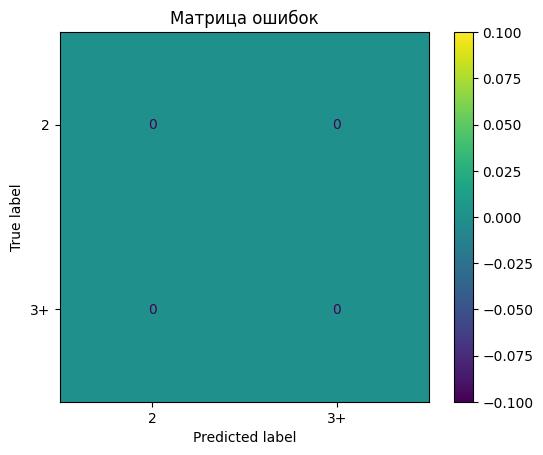

In [240]:

df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & 
                      (df_sorted['Тип_Ведомости'] != 'К/проект') & 
                      (df_sorted['Дисциплина'] == 'Физика')]

# Разделение на два подмножества
df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]

df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']

# Для группировки по 'НомерЛД', 'Семестр', 'Дисциплина' получаем среднее значение столбца 'visits'
grouped = df_sorted.groupby(['НомерЛД', 'Семестр', 'Дисциплина'], as_index=False).agg({'visits': 'mean'})

# Присоединяем среднее значение обратно к каждому из подвыборок
df1 = df1.merge(grouped, on=['НомерЛД', 'Семестр', 'Дисциплина'], suffixes=('', '_mean'))
df2 = df2.merge(grouped, on=['НомерЛД', 'Семестр', 'Дисциплина'], suffixes=('', '_mean'))

# Подготовка данных для модели
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)
X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

# Обработка категориальных переменных
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'Семестр', 'Курс']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'Семестр', 'Курс']))

# Добавление числовых переменных обратно
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

# Добавление группировочных переменных обратно
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']

# Маппинг y-тренировочных и тестовых данных
y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# Обучение модели
tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

# Предсказание и оценка
y_pred = tree.predict(X_te)
f1_macro = f1_score(y_te, y_pred, average='macro')
f1_micro = f1_score(y_te, y_pred, average='micro')

# Печать результата
print(f'F1-score (macro): {f1_macro}')
print(f'F1-score (micro): {f1_micro}')
# f1_array.append(f1_micro)  # Предполагается, что f1_array определен ранее
conf_matrix(y_te.values, y_pred, ['2', '3+'])

In [242]:
y_te.values

array([3, 3, 3, ..., 3, 3, 3])

In [238]:
y_pred

array([2, 2, 3, ..., 3, 3, 3])

In [218]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score
import numpy as np

# Ваши исходные данные предположительно уже загружены в t_coef

# Фильтрация и сортировка
df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & 
                      (df_sorted['Тип_Ведомости'] != 'К/проект') & 
                      (df_sorted['Дисциплина'] == 'Физика')]

# Разделение на два подмножества
df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]

df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']

# Подготовка данных для модели
X_train = df1.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)
X_test = df2.drop(['ID ЛК', 'НомерЛД', 'ПерваяПопытка', 'Год'], axis=1).reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

# Обработка категориальных переменных
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'Семестр', 'Курс']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'Семестр', 'Курс']))

# Добавление числовых переменных обратно
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

# Добавление переменных обратно
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']

# Маппинг y-тренировочных и тестовых данных
y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# Обучение модели
tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

# Предсказание
y_pred = tree.predict(X_te)

# Создание DataFrame для анализа предсказаний
results_df = X_test.copy()
results_df['пересчитанная оценка'] = y_pred

# Группировка по необходимым столбцам и вычисление средней оценки
grouped_results = results_df.groupby(['ID ЛК', 'Семестр', 'Дисциплина']).agg({'пересчитанная оценка': 'mean'}).reset_index()

# Округление в меньшую сторону
grouped_results['пересчитанная оценка'] = np.floor(grouped_results['пересчитанная оценка'])

# Отображение результатов
print(grouped_results)

KeyError: 'ID ЛК'

In [219]:
results_df

,Семестр,Дисциплина,Кафедра,Тип_Ведомости,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Сезон,Группа,ВидЗанятий,фио,ID Предмета,title,visits,пересчитанная оценка
0,2,Физика,каф.Физики,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,3101,Лаб,"Астафьев Александр Михайлович, Лоскутников Вик...",6332.0,Физика,0.000000,2
1,2,Физика,каф.Физики,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,3101,Лаб,"Астафьев Александр Михайлович, Лоскутников Вик...",2559.0,Физика,64.285714,2
2,2,Физика,каф.Физики,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,3101,Лаб,"Астафьев Александр Михайлович, Лоскутников Вик...",6332.0,Физика,0.000000,2
3,2,Физика,каф.Физики,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,3101,Лаб,"Астафьев Александр Михайлович, Лоскутников Вик...",2559.0,Физика,78.571429,3
4,2,Физика,каф.Физики,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,3101,Лаб,"Астафьев Александр Михайлович, Лоскутников Вик...",6332.0,Физика,0.000000,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5800,2,Физика,каф.Физики,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,3598,Пр,Шейнман Илья Львович,2558.0,Физика,64.285714,3
5801,2,Физика,каф.Физики,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,3598,Пр,Шейнман Илья Львович,6331.0,Физика,0.000000,2
5802,2,Физика,каф.Физики,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,3598,Пр,Шейнман Илья Львович,2558.0,Физика,78.571429,2
5803,2,Физика,каф.Физики,Экзамен,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,3598,Пр,Шейнман Илья Львович,6331.0,Физика,0.000000,2


In [224]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score
import numpy as np

# Поскольку ваш датасет t_coef уже загружен

# Фильтрация и сортировка данных
df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_sorted = df_sorted[(df_sorted['Семестр'] != 3) & 
                      (df_sorted['Тип_Ведомости'] != 'К/проект') & 
                      (df_sorted['Дисциплина'] == 'Физика')]

# Разделение на обучающую и тестовую выборки по условию
df1 = df_sorted[df_sorted['ID ЛК'] % 2 == 0]
df2 = df_sorted[df_sorted['ID ЛК'] % 2 == 1]

# Удаление неуместной записи
df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']

# Подготовка данных для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 'Курс', 
            'finans', 'status', 'Уровень образования', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'ID Предмета', 'title', 
            'visits']
X_train = df1[features].reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)
X_test = df2[features].reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

# Обработка категориальных переменных
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'Сезон', 'Курс', 'НомерЛД']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'Сезон', 'Курс', 'НомерЛД']))

# Добавление числовых переменных обратно
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

# Добавление переменных обратно после обработки
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']
X_tr['Сезон'] = X_train['Сезон']
X_te['Сезон'] = X_test['Сезон']
X_tr['Курс'] = X_train['Курс']
X_te['Курс'] = X_test['Курс']

# Маппинг y-тренировочных и тестовых данных
y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# Обучение модели
tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

# Предсказание
y_pred = tree.predict(X_te)

# Создание DataFrame для анализа предсказаний и добавление 'НомерЛД'
results_df = X_test.copy()
results_df['пересчитанная оценка'] = y_pred

# Группировка по 'НомерЛД', 'Семестр', 'Дисциплина' и вычисление средней оценки
grouped_results = results_df.groupby(['НомерЛД', 'Курс', 'Сезон', 'Дисциплина']).agg({'пересчитанная оценка': 'mean'}).reset_index()

# Округление в меньшую сторону
grouped_results['пересчитанная оценка'] = np.floor(grouped_results['пересчитанная оценка'])

# Отображение результатов
print(grouped_results)

ValueError: could not convert string to float: 'autumn'

In [230]:
f1_macro = f1_score(actual_ordered['ПерваяПопытка'], result_ordered['пересчитанная оценка'], average='macro')
print(f"F1 Score (macro-averaged) on recalculated grades: {f1_macro:.4f}")

NameError: name 'actual_ordered' is not defined

In [233]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score
import numpy as np

# Предполагается, что ваши данные t_coef уже загружены
# пример t_coef = pd.read_csv('ваш_файл.csv')

# Фильтрация и сортировка данных
df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])
df_filtered = df_sorted[(df_sorted['Семестр'] != 3) & 
                        (df_sorted['Тип_Ведомости'] != 'К/проект') & 
                        (df_sorted['Дисциплина'] == 'Физика')]

# Разделение на обучающую и тестовую выборки
df1 = df_filtered[df_filtered['ID ЛК'] % 2 == 0]
df2 = df_filtered[df_filtered['ID ЛК'] % 2 == 1]

# Исключение определённых записей
df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 'Курс', 
            'finans', 'status', 'Уровень образования', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'ID Предмета', 'title', 
            'visits', 'Семестр', 'Дисциплина']

X_train = df1[features].reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)
X_test = df2[features].reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

# Преобразование категориальных переменных
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'Курс', 'НомерЛД']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'Курс', 'НомерЛД']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

# Сохранение групп и семестров
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']

# Выравнивание столбцов тестового набора 
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Маппинг y-меток
y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# Обучение модели
tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

# Предсказание на тестовом наборе
y_pred = tree.predict(X_te)

# Создание DataFrame для анализа предсказаний
results_df = X_test.copy()
results_df['пересчитанная оценка'] = y_pred

# Группировка и агрегация по НомерЛД, Семестр, Дисциплина
grouped_results = results_df.groupby(['НомерЛД', 'Семестр', 'Дисциплина']).agg({'пересчитанная оценка': 'mean'}).reset_index()
grouped_results['пересчитанная оценка'] = np.floor(grouped_results['пересчитанная оценка'])

# Подготовка для расчета F1-меры
# Соответственно можно использовать сгруппированный и пересчитанный по половинной выборке y_te
actual = df2.groupby(['НомерЛД', 'Семестр', 'Дисциплина'])['ПерваяПопытка'].mean().reset_index()
actual['ПерваяПопытка'] = actual['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3})
actual['ПерваяПопытка'] = np.floor(actual['ПерваяПопытка'])

# Убедимся, что порядки совпадают для последующего расчета
result_ordered = grouped_results.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
actual_ordered = actual.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)

# Вычисление F1-меры (macro)
f1_macro = f1_score(actual_ordered['ПерваяПопытка'], result_ordered['пересчитанная оценка'], average='macro')
print(f"F1 Score (macro-averaged) on recalculated grades: {f1_macro:.4f}")

F1 Score (macro-averaged) on recalculated grades: 0.5865


Уникальные значения в y_test: [2 3]
Уникальные значения в y_pred: [2 3]


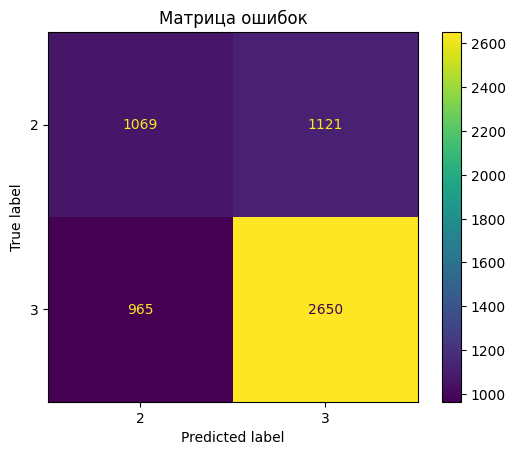

In [243]:
def conf_matrix(y_test, y_pred, class_names):
    # Проверим уникальные значения в y_test и y_pred
    print("Уникальные значения в y_test:", np.unique(y_test))
    print("Уникальные значения в y_pred:", np.unique(y_pred))

    # Создаем confusion matrix с явными метками классов
    confmat = confusion_matrix(y_test, y_pred, labels=class_names)
    disp = ConfusionMatrixDisplay(confusion_matrix=confmat, display_labels=class_names)
    disp.plot(cmap='viridis')
    plt.grid(False)
    plt.title('Матрица ошибок')
    plt.show()

# Обеспечиваем передачу корректных меток классов.
conf_matrix(y_te.values, y_pred, [2, 3])


In [229]:
#X_test

In [244]:
## найти таблицу с кол-во пропусков (вместо процента) - точно делала!!!
## Возможно посмотреть посещаемость по месяцам - кол-во пропусков/посещений в каждый из месяцов это visits и 'propuski'
## нужно запихнуть признаки в одну строку (это = 'ВидЗанятий', 'фио')
## Также проверить, если запихнуть в одно 'ВидЗанятий', 'фио', 'Дисциплина'

In [246]:
df_sorted.columns

Index(['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра',
       'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс', 'finans', 'status',
       'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа',
       'ВидЗанятий', 'фио', 'ID Предмета', 'title', 'visits'],
      dtype='object')

In [252]:
my_df.columns

Index(['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра',
       'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс', 'finans', 'status',
       'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа',
       'ВидЗанятий', 'фио', 'ID Предмета', 'title', 'visits'],
      dtype='object')

In [276]:
my_df = df_sorted.copy()
groupby_columnss = ['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра',
                   'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс', 'finans', 'status',
                   'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа', 'title']

my_df.columns = my_df.columns.str.strip()
groupby_columns = [col.strip() for col in groupby_columnss]

df_combined = my_df.groupby(groupby_columns).agg({
    'ВидЗанятий': ', '.join,
    'фио': ', '.join,
    'visits': 'median'
}).reset_index()

print(df_combined)

        НомерЛД  ПерваяПопытка  Семестр                 Дисциплина  \
0         10123              3        1                     Физика   
1         10123              3        2                     Физика   
2         10123              3        2                     Физика   
3         10123              4        1        Алгебра и геометрия   
4         10123              4        1      Математический анализ   
...         ...            ...      ...                        ...   
33385  10280323              2        2                     Физика   
33386  10280323              2        2                   Экология   
33387  10280323              3        1                Информатика   
33388  10280323              4        2  Информационные технологии   
33389  10280323              5        1                  Философия   

          Кафедра             Тип_Ведомости     ID ЛК  Иностранец  Курс  \
0      каф.Физики                   Экзамен  418323.0       False   1.0   
1      ка

In [259]:
df_combined

,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Сезон,Год,Группа,title,ВидЗанятий,фио,visits
0,10123,3,1,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3182,Физика,"Лек, Лаб, Пр","Малышев Михаил Николаевич, Овезов Максат Кемал...",93.750000
1,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,3182,Физика,"Лаб, Лек, Пр","Алексеева Ольга Сергеевна, Дедык Антонина Иван...",100.000000
2,10123,3,2,Физика,каф.Физики,Экзамен,418323.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,3182,Физика,"Лаб, Лек, Пр","Алексеева Ольга Сергеевна, Дедык Антонина Иван...",93.333333
3,10223,3,1,Физика,каф.Физики,Экзамен,418318.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3203,Физика,"Лаб, Пр, Лек","Лоскутников Виктор Серафимович, Ходьков Дмитри...",76.470588
4,10223,3,2,Физика,каф.Физики,Экзамен,418318.0,False,1.0,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2024,3203,Физика,"Пр, Лаб, Лек","Лесив Никита Андреевич, Павлова Юлия Валерьевн...",50.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3977,10090323,3,1,Физика,каф.Физики,Дифференцированный зачет,416141.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,3393,Физика,"Лаб, Лек, Пр","Агабабаев Валентин Александрович, Сизова Елена...",100.000000
3978,10240323,3,2,Физика,каф.Физики,Экзамен,416123.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3353,Физика,"Лек, Пр, Лаб","Дедык Антонина Ивановна, Титов Леонид Алексеев...",71.428571
3979,10240323,4,1,Физика,каф.Физики,Дифференцированный зачет,416123.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,3353,Физика,"Пр, Лек, Лаб","Варнашев Константин Борисович, Дедык Антонина ...",87.500000
3980,10280323,2,1,Физика,каф.Физики,Дифференцированный зачет,404501.0,False,1.0,Контракт,Учащийся,Бакалавриат,Очная форма,autumn,2023,3354,Физика,"Пр, Лек, Лаб","Астафьев Александр Михайлович, Дедык Антонина ...",100.000000


In [262]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score
import numpy as np

# Предполагается, что ваши данные t_coef уже загружены
# пример t_coef = pd.read_csv('ваш_файл.csv')

# Фильтрация и сортировка данных
df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])

df_combined
df_filtered = df_combined[(df_combined['Семестр'] != 3) & 
                        (df_combined['Тип_Ведомости'] != 'К/проект') & 
                        (df_combined['Дисциплина'] == 'Физика')]

# Разделение на обучающую и тестовую выборки
df1 = df_filtered[df_filtered['ID ЛК'] % 2 == 0]
df2 = df_filtered[df_filtered['ID ЛК'] % 2 == 1]

# Исключение определённых записей
df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 'Курс', 
            'finans', 'status', 'Уровень образования', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 
            'visits', 'Семестр', 'Дисциплина']

X_train = df1[features].reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)
X_test = df2[features].reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

# Преобразование категориальных переменных
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'Курс', 'НомерЛД']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'Курс', 'НомерЛД']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

# Сохранение групп и семестров
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']

# Выравнивание столбцов тестового набора 
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Маппинг y-меток
y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# Обучение модели
tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

# Предсказание на тестовом наборе
y_pred = tree.predict(X_te)

# Создание DataFrame для анализа предсказаний
results_df = X_test.copy()
results_df['пересчитанная оценка'] = y_pred

# Группировка и агрегация по НомерЛД, Семестр, Дисциплина
grouped_results = results_df.groupby(['НомерЛД', 'Семестр', 'Дисциплина']).agg({'пересчитанная оценка': 'mean'}).reset_index()
grouped_results['пересчитанная оценка'] = np.floor(grouped_results['пересчитанная оценка'])

# Подготовка для расчета F1-меры
# Соответственно можно использовать сгруппированный и пересчитанный по половинной выборке y_te
actual = df2.groupby(['НомерЛД', 'Семестр', 'Дисциплина'])['ПерваяПопытка'].mean().reset_index()
actual['ПерваяПопытка'] = actual['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3})
actual['ПерваяПопытка'] = np.floor(actual['ПерваяПопытка'])

# Убедимся, что порядки совпадают для последующего расчета
result_ordered = grouped_results.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
actual_ordered = actual.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)

# Вычисление F1-меры (macro)
f1_macro = f1_score(actual_ordered['ПерваяПопытка'], result_ordered['пересчитанная оценка'], average='macro')
print(f"F1 Score (macro-averaged) on recalculated grades: {f1_macro}")

F1 Score (macro-averaged) on recalculated grades: 0.6476153710604491


In [265]:
t_pr.columns


Index(['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра',
       'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс', 'finans', 'status',
       'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа',
       'ВидЗанятий', 'фио', 'ID Предмета', 'title', 'propuski'],
      dtype='object')

In [268]:
my_df_p = t_pr.copy()
groupby_columnss = ['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра',
                   'Тип_Ведомости', 'ID ЛК', 'Иностранец', 'Курс', 'finans', 'status',
                   'Уровень образования', 'Форма образования', 'Сезон', 'Год', 'Группа', 'title']

my_df_p.columns = my_df_p.columns.str.strip()
groupby_columns = [col.strip() for col in groupby_columnss]

# Группировка и объединение
df_combined_p = my_df_p.groupby(groupby_columns).agg({
    'ВидЗанятий': ', '.join,
    'фио': ', '.join,
    'propuski': 'median'
}).reset_index()


In [269]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score
import numpy as np

# Предполагается, что ваши данные t_coef уже загружены
# пример t_coef = pd.read_csv('ваш_файл.csv')

# Фильтрация и сортировка данных
df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])

df_filtered = df_combined_p[(df_combined_p['Семестр'] != 3) & 
                        (df_combined_p['Тип_Ведомости'] != 'К/проект') & 
                        (df_combined_p['Дисциплина'] == 'Физика')]

# Разделение на обучающую и тестовую выборки
df1 = df_filtered[df_filtered['ID ЛК'] % 2 == 0]
df2 = df_filtered[df_filtered['ID ЛК'] % 2 == 1]

# Исключение определённых записей
df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 'Курс', 
            'finans', 'status', 'Уровень образования', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 
            'propuski', 'Семестр', 'Дисциплина']

X_train = df1[features].reset_index(drop=True)
y_train = df1['ПерваяПопытка'].reset_index(drop=True)
X_test = df2[features].reset_index(drop=True)
y_test = df2['ПерваяПопытка'].reset_index(drop=True)

# Преобразование категориальных переменных
X_tr = pd.get_dummies(X_train.drop(columns=['propuski', 'Группа', 'Курс', 'НомерЛД']))
X_te = pd.get_dummies(X_test.drop(columns=['propuski', 'Группа', 'Курс', 'НомерЛД']))

# Добавление числовых переменных
X_tr['propuski'] = X_train['propuski']
X_te['propuski'] = X_test['propuski']

# Сохранение групп и семестров
X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']
X_tr['Семестр'] = X_train['Семестр']
X_te['Семестр'] = X_test['Семестр']

# Выравнивание столбцов тестового набора 
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Маппинг y-меток
y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})

# Обучение модели
tree = DecisionTreeClassifier(random_state=43)
tree.fit(X_tr, y_tr)

# Предсказание на тестовом наборе
y_pred = tree.predict(X_te)

# Создание DataFrame для анализа предсказаний
results_df = X_test.copy()
results_df['пересчитанная оценка'] = y_pred

# Группировка и агрегация по НомерЛД, Семестр, Дисциплина
grouped_results = results_df.groupby(['НомерЛД', 'Семестр', 'Дисциплина']).agg({'пересчитанная оценка': 'mean'}).reset_index()
grouped_results['пересчитанная оценка'] = np.floor(grouped_results['пересчитанная оценка'])

# Подготовка для расчета F1-меры
# Соответственно можно использовать сгруппированный и пересчитанный по половинной выборке y_te
actual = df2.groupby(['НомерЛД', 'Семестр', 'Дисциплина'])['ПерваяПопытка'].mean().reset_index()
actual['ПерваяПопытка'] = actual['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3})
actual['ПерваяПопытка'] = np.floor(actual['ПерваяПопытка'])

# Убедимся, что порядки совпадают для последующего расчета
result_ordered = grouped_results.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
actual_ordered = actual.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)

# Вычисление F1-меры (macro)
f1_macro = f1_score(actual_ordered['ПерваяПопытка'], result_ordered['пересчитанная оценка'], average='macro')
print(f"F1 Score (macro-averaged) on recalculated grades: {f1_macro}")

F1 Score (macro-averaged) on recalculated grades: 0.6378243305549782


In [275]:
import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score

df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])

df_filtered = df_combined_p[(df_combined_p['Семестр'] != 3) & 
                        (df_combined_p['Тип_Ведомости'] != 'К/проект')].dropna()

# Переменная для хранения результатов
results = []

# Уникальные дисциплины
disciplines = df_filtered['Дисциплина'].unique()

for discipline in disciplines:
    print(f"Обработка дисциплины: {discipline}")
    
    # Фильтрация данных по дисциплине
    df_discipline = df_filtered[df_filtered['Дисциплина'] == discipline]
    
    # Разделение на обучающую и тестовую выборки
    df1 = df_discipline[df_discipline['ID ЛК'] % 2 == 0]
    df2 = df_discipline[df_discipline['ID ЛК'] % 2 == 1]
    
    # Исключение определённых записей
    df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']
    
    # Определение признаков для модели
    features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 'Курс', 
               'finans', 'status', 'Уровень образования', 'Форма образования', 
               'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 
               'propuski', 'Семестр', 'Дисциплина']
    
    X_train = df1[features]
    y_train = df1['ПерваяПопытка']
    X_test = df2[features]
    y_test = df2['ПерваяПопытка']
    
    # Преобразование категориальных переменных
    X_tr = pd.get_dummies(X_train.drop(columns=['propuski', 'Группа', 'Курс', 'НомерЛД']))
    X_te = pd.get_dummies(X_test.drop(columns=['propuski', 'Группа', 'Курс', 'НомерЛД']))
    
    # Добавление числовых переменных
    X_tr['propuski'] = X_train['propuski']
    X_te['propuski'] = X_test['propuski']
    
    # Сохранение групп и семестров
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    X_tr['Семестр'] = X_train['Семестр']
    X_te['Семестр'] = X_test['Семестр']
    
    # Выравнивание столбцов тестового набора 
    X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)
    
    # Маппинг y-меток
    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})
    
    # Обучение модели
    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    
    # Предсказание на тестовом наборе
    y_pred = tree.predict(X_te)
    
    # Создание DataFrame для анализа предсказаний
    results_df = X_test.copy()
    results_df['пересчитанная оценка'] = y_pred
    
    # Группировка и агрегация по НомерЛД, Семестр, Дисциплина
    grouped_results = results_df.groupby(['НомерЛД', 'Семестр', 'Дисциплина']).agg({'пересчитанная оценка': 'mean'}).reset_index()
    grouped_results['пересчитанная оценка'] = np.floor(grouped_results['пересчитанная оценка'])
    
    # Подготовка для расчета F1-меры
    actual = df2.groupby(['НомерЛД', 'Семестр', 'Дисциплина'])['ПерваяПопытка'].mean().reset_index()
    actual['ПерваяПопытка'] = actual['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2)
    actual['ПерваяПопытка'] = np.floor(actual['ПерваяПопытка'])
    
    # Убедимся, что порядки совпадают для последующего расчета
    result_ordered = grouped_results.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
    actual_ordered = actual.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
    
    # Вычисление F1-меры (macro)
    f1_macro = f1_score(actual_ordered['ПерваяПопытка'], result_ordered['пересчитанная оценка'], average='macro')
    
    # Сохранение результата
    results.append({'Дисциплина': discipline, 'F1_macro': f1_macro})

# Создание DataFrame с результатами
results_df = pd.DataFrame(results)

# Вычисление медианного и среднего F1_macro
median_f1 = results_df['F1_macro'].median()
mean_f1 = results_df['F1_macro'].mean()

print(f"Медианное значение F1_macro: {median_f1}")
print(f"Среднее значение F1_macro: {mean_f1}")
print("\nРезультаты по дисциплинам:")
print(results_df)

Обработка дисциплины: Физика
Обработка дисциплины: Алгебра и геометрия
Обработка дисциплины: Математический анализ
Обработка дисциплины: Инженерная и компьютерная графика
Обработка дисциплины: Философия
Обработка дисциплины: Иностранный язык
Обработка дисциплины: Информатика
Обработка дисциплины: История России
Обработка дисциплины: Информационные технологии
Обработка дисциплины: Химия
Обработка дисциплины: Экология
Обработка дисциплины: Алгоритмы и вычислительные средства
Обработка дисциплины: Программирование
Обработка дисциплины: Инженерная графика
Обработка дисциплины: Введение в специальность
Обработка дисциплины: Древние языки и культуры
Обработка дисциплины: Основы языкознания
Обработка дисциплины: Практический курс английского языка
Обработка дисциплины: Психология
Обработка дисциплины: Русский язык и культура речи
Обработка дисциплины: Социолингвистика
Обработка дисциплины: Культурология
Обработка дисциплины: Лингвистические направления
Обработка дисциплины: Социология
Обработ

In [274]:
if actual_ordered['ПерваяПопытка'].isna().any():
    print(f"Обнаружены пропущенные значения в 'ПерваяПопытка' для дисциплины: {discipline}")
    # Заполним пропущенные значения средним значением
    actual_ordered['ПерваяПопытка'] = actual_ordered['ПерваяПопытка'].fillna(actual_ordered['ПерваяПопытка'].mean())

# Проверка на NaN в result_ordered['пересчитанная оценка']
if result_ordered['пересчитанная оценка'].isna().any():
    print(f"Обнаружены пропущенные значения в 'пересчитанная оценка' для дисциплины: {discipline}")
    # Заполним пропущенные значения средним значением
    result_ordered['пересчитанная оценка'] = result_ordered['пересчитанная оценка'].fillna(result_ordered['пересчитанная оценка'].mean())

# Вычисление F1-меры (macro)
f1_macro = f1_score(actual_ordered['ПерваяПопытка'], result_ordered['пересчитанная оценка'], average='macro')

Обнаружены пропущенные значения в 'ПерваяПопытка' для дисциплины: Инженерная и компьютерная графика


ValueError: Classification metrics can't handle a mix of continuous and binary targets

In [271]:
df_filtered['Дисциплина'].unique()

array(['Физика'], dtype=object)

In [277]:
import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score

df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])

df_filtered = df_combined[(df_combined['Семестр'] != 3) & 
                        (df_combined['Тип_Ведомости'] != 'К/проект')].dropna()

# Переменная для хранения результатов
results = []

# Уникальные дисциплины
disciplines = df_filtered['Дисциплина'].unique()

for discipline in disciplines:
    print(f"Обработка дисциплины: {discipline}")
    
    # Фильтрация данных по дисциплине
    df_discipline = df_filtered[df_filtered['Дисциплина'] == discipline]
    
    # Разделение на обучающую и тестовую выборки
    df1 = df_discipline[df_discipline['ID ЛК'] % 2 == 0]
    df2 = df_discipline[df_discipline['ID ЛК'] % 2 == 1]
    
    # Исключение определённых записей
    df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']
    
    # Определение признаков для модели
    features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 'Курс', 
               'finans', 'status', 'Уровень образования', 'Форма образования', 
               'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 
               'visits', 'Семестр', 'Дисциплина']
    
    X_train = df1[features]
    y_train = df1['ПерваяПопытка']
    X_test = df2[features]
    y_test = df2['ПерваяПопытка']
    
    # Преобразование категориальных переменных
    X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'Курс', 'НомерЛД']))
    X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'Курс', 'НомерЛД']))
    
    # Добавление числовых переменных
    X_tr['visits'] = X_train['visits']
    X_te['visits'] = X_test['visits']
    
    # Сохранение групп и семестров
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    X_tr['Семестр'] = X_train['Семестр']
    X_te['Семестр'] = X_test['Семестр']
    
    # Выравнивание столбцов тестового набора 
    X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)
    
    # Маппинг y-меток
    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})
    
    # Обучение модели
    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    
    # Предсказание на тестовом наборе
    y_pred = tree.predict(X_te)
    
    # Создание DataFrame для анализа предсказаний
    results_df = X_test.copy()
    results_df['пересчитанная оценка'] = y_pred
    
    # Группировка и агрегация по НомерЛД, Семестр, Дисциплина
    grouped_results = results_df.groupby(['НомерЛД', 'Семестр', 'Дисциплина']).agg({'пересчитанная оценка': 'mean'}).reset_index()
    grouped_results['пересчитанная оценка'] = np.floor(grouped_results['пересчитанная оценка'])
    
    # Подготовка для расчета F1-меры
    actual = df2.groupby(['НомерЛД', 'Семестр', 'Дисциплина'])['ПерваяПопытка'].mean().reset_index()
    actual['ПерваяПопытка'] = actual['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2)
    actual['ПерваяПопытка'] = np.floor(actual['ПерваяПопытка'])
    
    # Убедимся, что порядки совпадают для последующего расчета
    result_ordered = grouped_results.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
    actual_ordered = actual.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
    
    # Вычисление F1-меры (macro)
    f1_macro = f1_score(actual_ordered['ПерваяПопытка'], result_ordered['пересчитанная оценка'], average='macro')
    
    # Сохранение результата
    results.append({'Дисциплина': discipline, 'F1_macro': f1_macro})

# Создание DataFrame с результатами
results_df = pd.DataFrame(results)

# Вычисление медианного и среднего F1_macro
median_f1 = results_df['F1_macro'].median()
mean_f1 = results_df['F1_macro'].mean()

print(f"Медианное значение F1_macro: {median_f1}")
print(f"Среднее значение F1_macro: {mean_f1}")
print("\nРезультаты по дисциплинам:")
print(results_df)

Обработка дисциплины: Физика
Обработка дисциплины: Алгебра и геометрия
Обработка дисциплины: Математический анализ
Обработка дисциплины: Инженерная и компьютерная графика
Обработка дисциплины: Философия
Обработка дисциплины: Иностранный язык
Обработка дисциплины: Информатика
Обработка дисциплины: История России
Обработка дисциплины: Информационные технологии
Обработка дисциплины: Химия
Обработка дисциплины: Экология
Обработка дисциплины: Алгоритмы и вычислительные средства
Обработка дисциплины: Программирование
Обработка дисциплины: Инженерная графика
Обработка дисциплины: Введение в специальность
Обработка дисциплины: Древние языки и культуры
Обработка дисциплины: Основы языкознания
Обработка дисциплины: Практический курс английского языка
Обработка дисциплины: Психология
Обработка дисциплины: Русский язык и культура речи
Обработка дисциплины: Социолингвистика
Обработка дисциплины: Культурология
Обработка дисциплины: Лингвистические направления
Обработка дисциплины: Социология
Обработ

In [279]:
import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score

df_sorted = t_pr.sort_values(by=['Дисциплина', 'Группа', 'фио'])

df_filtered = df_sorted[(df_sorted['Семестр'] != 3) & 
                        (df_sorted['Тип_Ведомости'] != 'К/проект')].dropna()

# Переменная для хранения результатов
results = []

# Уникальные дисциплины
disciplines = df_filtered['Дисциплина'].unique()

for discipline in disciplines:
    print(f"Обработка дисциплины: {discipline}")
    
    # Фильтрация данных по дисциплине
    df_discipline = df_filtered[df_filtered['Дисциплина'] == discipline]
    
    # Разделение на обучающую и тестовую выборки
    df1 = df_discipline[df_discipline['ID ЛК'] % 2 == 0]
    df2 = df_discipline[df_discipline['ID ЛК'] % 2 == 1]
    
    # Исключение определённых записей
    df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']
    
    # Определение признаков для модели
    features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 'Курс', 
               'finans', 'status', 'Уровень образования', 'Форма образования', 
               'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 
               'propuski', 'Семестр', 'Дисциплина']
    
    X_train = df1[features]
    y_train = df1['ПерваяПопытка']
    X_test = df2[features]
    y_test = df2['ПерваяПопытка']
    
    # Преобразование категориальных переменных
    X_tr = pd.get_dummies(X_train.drop(columns=['propuski', 'Группа', 'Курс', 'НомерЛД']))
    X_te = pd.get_dummies(X_test.drop(columns=['propuski', 'Группа', 'Курс', 'НомерЛД']))
    
    # Добавление числовых переменных
    X_tr['propuski'] = X_train['propuski']
    X_te['propuski'] = X_test['propuski']
    
    # Сохранение групп и семестров
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    X_tr['Семестр'] = X_train['Семестр']
    X_te['Семестр'] = X_test['Семестр']
    
    # Выравнивание столбцов тестового набора 
    X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)
    
    # Маппинг y-меток
    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})
    
    # Обучение модели
    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    
    # Предсказание на тестовом наборе
    y_pred = tree.predict(X_te)
    
    # Создание DataFrame для анализа предсказаний
    results_df = X_test.copy()
    results_df['пересчитанная оценка'] = y_pred
    
    # Группировка и агрегация по НомерЛД, Семестр, Дисциплина
    grouped_results = results_df.groupby(['НомерЛД', 'Семестр', 'Дисциплина']).agg({'пересчитанная оценка': 'mean'}).reset_index()
    grouped_results['пересчитанная оценка'] = np.floor(grouped_results['пересчитанная оценка'])
    
    # Подготовка для расчета F1-меры
    actual = df2.groupby(['НомерЛД', 'Семестр', 'Дисциплина'])['ПерваяПопытка'].mean().reset_index()
    actual['ПерваяПопытка'] = actual['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2)
    actual['ПерваяПопытка'] = np.floor(actual['ПерваяПопытка'])
    
    # Убедимся, что порядки совпадают для последующего расчета
    result_ordered = grouped_results.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
    actual_ordered = actual.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
    
    # Вычисление F1-меры (macro)
    f1_macro = f1_score(actual_ordered['ПерваяПопытка'], result_ordered['пересчитанная оценка'], average='macro')
    
    # Сохранение результата
    results.append({'Дисциплина': discipline, 'F1_macro': f1_macro})

# Создание DataFrame с результатами
results_df = pd.DataFrame(results)

# Вычисление медианного и среднего F1_macro
median_f1 = results_df['F1_macro'].median()
mean_f1 = results_df['F1_macro'].mean()

print(f"Медианное значение F1_macro: {median_f1}")
print(f"Среднее значение F1_macro: {mean_f1}")
print("\nРезультаты по дисциплинам:")
print(results_df)

Обработка дисциплины: Алгебра и геометрия
Обработка дисциплины: Алгоритмы и вычислительные средства
Обработка дисциплины: Введение в коммуникационные специальности
Обработка дисциплины: Введение в предпринимательскую деятельность
Обработка дисциплины: Введение в специальность
Обработка дисциплины: Деловая и межличностная коммуникация
Обработка дисциплины: Древние языки и культуры
Обработка дисциплины: Инженерная графика
Обработка дисциплины: Инженерная и компьютерная графика
Обработка дисциплины: Иностранный язык
Обработка дисциплины: Информатика
Обработка дисциплины: Информационные технологии
Обработка дисциплины: Информационные технологии в управлении предприятием
Обработка дисциплины: Информационные технологии и базы данных в прикладных коммуникациях
Обработка дисциплины: Искусство самопрезентации и деловой этикет
Обработка дисциплины: История России
Обработка дисциплины: История искусства
Обработка дисциплины: История литературы
Обработка дисциплины: Культурология
Обработка дисципл

In [280]:
import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score

df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])

df_filtered = df_sorted[(df_sorted['Семестр'] != 3) & 
                        (df_sorted['Тип_Ведомости'] != 'К/проект')].dropna()

# Переменная для хранения результатов
results = []

# Уникальные дисциплины
disciplines = df_filtered['Дисциплина'].unique()

for discipline in disciplines:
    print(f"Обработка дисциплины: {discipline}")
    
    # Фильтрация данных по дисциплине
    df_discipline = df_filtered[df_filtered['Дисциплина'] == discipline]
    
    # Разделение на обучающую и тестовую выборки
    df1 = df_discipline[df_discipline['ID ЛК'] % 2 == 0]
    df2 = df_discipline[df_discipline['ID ЛК'] % 2 == 1]
    
    # Исключение определённых записей
    df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']
    
    # Определение признаков для модели
    features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 'Курс', 
               'finans', 'status', 'Уровень образования', 'Форма образования', 
               'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 
               'visits', 'Семестр', 'Дисциплина']
    
    X_train = df1[features]
    y_train = df1['ПерваяПопытка']
    X_test = df2[features]
    y_test = df2['ПерваяПопытка']
    
    # Преобразование категориальных переменных
    X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'Курс', 'НомерЛД']))
    X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'Курс', 'НомерЛД']))
    
    # Добавление числовых переменных
    X_tr['visits'] = X_train['visits']
    X_te['visits'] = X_test['visits']
    

    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    X_tr['Семестр'] = X_train['Семестр']
    X_te['Семестр'] = X_test['Семестр']
    

    X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)
    

    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    y_te = y_test.map({2: 2, 3: 3, 4: 3, 5: 3})
    

    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    

    y_pred = tree.predict(X_te)
    

    results_df = X_test.copy()
    results_df['пересчитанная оценка'] = y_pred
    

    grouped_results = results_df.groupby(['НомерЛД', 'Семестр', 'Дисциплина']).agg({'пересчитанная оценка': 'mean'}).reset_index()
    grouped_results['пересчитанная оценка'] = np.floor(grouped_results['пересчитанная оценка'])
    

    actual = df2.groupby(['НомерЛД', 'Семестр', 'Дисциплина'])['ПерваяПопытка'].mean().reset_index()
    actual['ПерваяПопытка'] = actual['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2)
    actual['ПерваяПопытка'] = np.floor(actual['ПерваяПопытка'])
    

    result_ordered = grouped_results.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
    actual_ordered = actual.sort_values(['НомерЛД', 'Семестр', 'Дисциплина']).reset_index(drop=True)
    
    f1_macro = f1_score(actual_ordered['ПерваяПопытка'], result_ordered['пересчитанная оценка'], average='macro')
    
    results.append({'Дисциплина': discipline, 'F1_macro': f1_macro})

results_df = pd.DataFrame(results)

median_f1 = results_df['F1_macro'].median()
mean_f1 = results_df['F1_macro'].mean()

print(f"Медианное значение F1_macro: {median_f1}")
print(f"Среднее значение F1_macro: {mean_f1}")
print("\nРезультаты по дисциплинам:")
print(results_df)

Обработка дисциплины: Алгебра и геометрия
Обработка дисциплины: Алгоритмы и вычислительные средства
Обработка дисциплины: Введение в коммуникационные специальности
Обработка дисциплины: Введение в предпринимательскую деятельность
Обработка дисциплины: Введение в специальность
Обработка дисциплины: Деловая и межличностная коммуникация
Обработка дисциплины: Древние языки и культуры
Обработка дисциплины: Инженерная графика
Обработка дисциплины: Инженерная и компьютерная графика
Обработка дисциплины: Иностранный язык
Обработка дисциплины: Информатика
Обработка дисциплины: Информационные технологии
Обработка дисциплины: Информационные технологии в управлении предприятием
Обработка дисциплины: Информационные технологии и базы данных в прикладных коммуникациях
Обработка дисциплины: Искусство самопрезентации и деловой этикет
Обработка дисциплины: История России
Обработка дисциплины: История искусства
Обработка дисциплины: История литературы
Обработка дисциплины: Культурология
Обработка дисципл

---
# Проверка результатов на осеннем семестре

**собираем тренировочный датасет за 2023-2024 полностью (пишу, когда он)**

- оценки_осенний_сем.csv (только за 2024-2025 года)
- посещения_осенний_сем.csv
- студенты_осенний_сем.csv

Оценки новые

In [382]:
osen_marks = pd.read_csv('оценки_осенний_сем.csv')

In [616]:
marks_dist = pd.read_csv('оценки_осенний_сем.csv')
print(marks_dist.isna().sum())
marks_dist.columns

КодОбучения       0
НомерЛД           0
ПерваяПопытка     0
Итог              0
Пересдавал        0
Семестр           0
Дисциплина        0
КодПланыСтроки    0
Форма             0
Статус            0
Кафедра           0
Тип_Ведомости     0
Год               0
dtype: int64


Index(['КодОбучения', 'НомерЛД', 'ПерваяПопытка', 'Итог', 'Пересдавал',
       'Семестр', 'Дисциплина', 'КодПланыСтроки', 'Форма', 'Статус', 'Кафедра',
       'Тип_Ведомости', 'Год'],
      dtype='object')

In [384]:
osen_marks = osen_marks[['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра', 'Тип_Ведомости']]

In [617]:
marks_dist = marks_dist[['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра', 'Тип_Ведомости']]

In [451]:
marks2324 = pd.read_csv('все_оценки_студентов_2023_2024.csv')
marks2324 = marks2324[['НомерЛД', 'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра', 'Тип_Ведомости']]

In [399]:
osen_visits = pd.read_csv('посещения_осенний_сем.csv')

In [618]:
visits_dist = pd.read_csv('посещения_осенний_сем.csv')
print(visits_dist.isna().sum())
visits_dist.columns

ID ЛК                0
ID Предмета          0
title                0
Сезон                0
Год                  0
Всего занятий        0
Посещений (студ.)    0
Посещений (стар.)    0
Отметок (стар.)      0
Посещений (преп.)    0
Отметок (преп.)      0
Посещений (СКУД)     0
Отметок (СКУД)       0
dtype: int64


Index(['ID ЛК', 'ID Предмета', 'title', 'Сезон', 'Год', 'Всего занятий',
       'Посещений (студ.)', 'Посещений (стар.)', 'Отметок (стар.)',
       'Посещений (преп.)', 'Отметок (преп.)', 'Посещений (СКУД)',
       'Отметок (СКУД)'],
      dtype='object')

In [619]:
visits_dist = visits_dist[['ID ЛК', 'title', 'Сезон', 'Год', 'Посещений (СКУД)', 'Отметок (СКУД)']]

In [400]:
osen_visits = osen_visits[['ID ЛК', 'title', 'Сезон', 'Год', 'Посещений (СКУД)', 'Отметок (СКУД)']]

In [401]:
osen_visits = osen_visits[(osen_visits['Год'] == 2024) & (osen_visits['Сезон'] == 'autumn')]

In [402]:
osen_visits['visits'] = osen_visits.apply(calculate_visits, axis=1)

Посещаемость преобразована в новую 

In [404]:
osen_visits

,ID ЛК,title,Сезон,Год,visits
28,271,Методы оптимизации,autumn,2024,0.000000
29,271,Компьютерная графика,autumn,2024,0.000000
30,271,Управление IT-проектами,autumn,2024,0.000000
31,271,Управление IT-проектами,autumn,2024,0.000000
32,271,Теория принятия решений,autumn,2024,5.882353
...,...,...,...,...,...
584033,425246,Цифровое производство,autumn,2024,5.882353
584034,425246,Администрирование защищенных информационных си...,autumn,2024,55.555556
584035,425246,Администрирование защищенных информационных си...,autumn,2024,82.352941
584036,425246,Криптографические протоколы,autumn,2024,64.705882


In [403]:
osen_visits = osen_visits[['ID ЛК', 'title', 'Сезон', 'Год', 'visits']]

In [447]:
visits2324 = pd.read_csv('посещения_осенний_сем.csv')
visits2324 = visits2324[['ID ЛК', 'title', 'Сезон', 'Год', 'Посещений (СКУД)', 'Отметок (СКУД)']]
visits2324 = visits2324[((visits2324['Год'] == 2023) & (visits2324['Сезон'] == 'autumn')) | ((visits2324['Год'] == 2024) & (visits2324['Сезон'] == 'spring'))]
visits2324['visits'] = visits2324.apply(calculate_visits, axis=1)
visits2324 = visits2324[['ID ЛК', 'title', 'Сезон', 'Год', 'visits']]

In [414]:
osen_st = pd.read_csv('студенты_осенний_сем.csv') # на самом деле старые студенты (берем студентов за прошлый год)

In [622]:
studet_dist = pd.read_csv('студенты_осенний_сем.csv')
# pp

In [598]:
pp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19270 entries, 0 to 19269
Data columns (total 22 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID ИОТ               19270 non-null  int64  
 1   ID ЛК                19270 non-null  int64  
 2   ДР                   19234 non-null  object 
 3   ID Обучения (ЛК)     19270 non-null  int64  
 4   КодОбучения (Шахты)  12712 non-null  float64
 5   Зачетка              19270 non-null  int64  
 6   НомерЛД (Шахты)      19270 non-null  int64  
 7   Иностранец           19270 non-null  bool   
 8   ID Группы            19270 non-null  int64  
 9   Группа               19270 non-null  int64  
 10  Курс                 19270 non-null  int64  
 11  Учебный год          19270 non-null  object 
 12  Срок обучения        19270 non-null  object 
 13  Статус               17355 non-null  object 
 14  Статус.1             17355 non-null  object 
 15  Гражданство          16171 non-null 

In [604]:
pp['Статус.1'].unique()

array(['Учащийся', 'Отчислен', 'Академический', 'Закончил', nan],
      dtype=object)

In [623]:
print(studet_dist.size)
studet_dist.isna().sum()

423940


ID ИОТ                    0
ID ЛК                     0
ДР                       36
ID Обучения (ЛК)          0
КодОбучения (Шахты)    6558
Зачетка                   0
НомерЛД (Шахты)           0
Иностранец                0
ID Группы                 0
Группа                    0
Курс                      0
Учебный год               0
Срок обучения             0
Статус                 1915
Статус.1               1915
Гражданство            3099
Шифр специальность        0
Специальность             0
Уровень образования       0
Форма образования         0
Кафедра                 405
Факультет               405
dtype: int64

In [415]:
# osen_st[osen_st['Группа'] == 1381]['Учебный год']
# osen_st[osen_st['Группа'] == 1381]
# ДАННЫЕ СТУДЕНТОВ НЕ АКТУАЛЬНЫ!!! ЕСТЬ ТОЛЬКО ЗА 2023-204
osen_st = osen_st[osen_st['Учебный год'] == '2023-2024']

In [606]:
osen_st['Форма образования'].unique()

array(['Очная форма'], dtype=object)

<Axes: xlabel='Учебный год'>

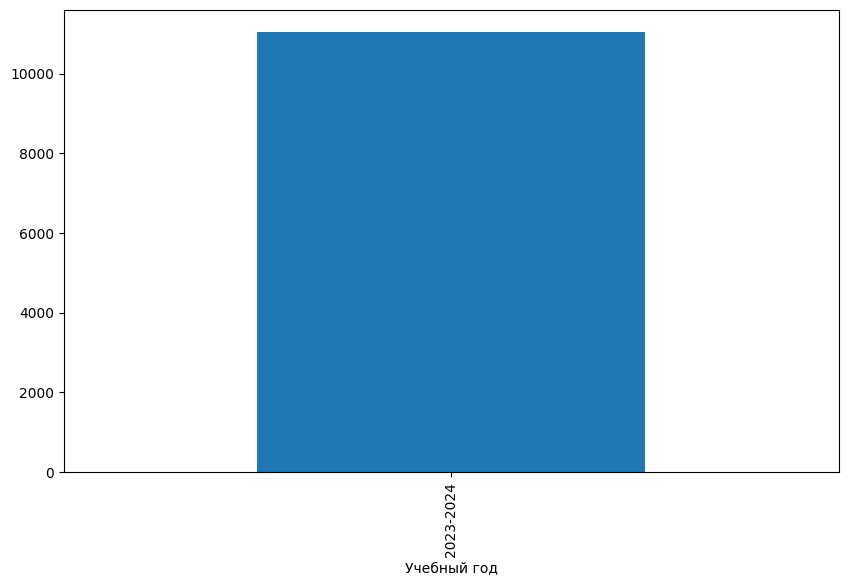

In [417]:
unique_id_counts = osen_st.groupby('Учебный год')['ID ЛК'].nunique()

# Построение гистограммы
plt.figure(figsize=(10, 6))
unique_id_counts.plot(kind='bar')


In [418]:
# osen_st = pd.read_csv('students.csv')
osen_st = osen_st[['ID ЛК', 'НомерЛД (Шахты)', 'Иностранец', 'Курс', 'Статус', 'Статус.1', 'Уровень образования', 'Форма образования', 'Группа']]

In [419]:
#### новы список учителей

In [420]:
osen_st

,ID ЛК,НомерЛД (Шахты),Иностранец,Курс,Статус,Статус.1,Уровень образования,Форма образования,Группа
631,2340,4090316,False,2,Бюджет,Учащийся,Аспирантура,Очная форма,2935
632,9870,2220317,False,1,Бюджет,Учащийся,Аспирантура,Очная форма,3935
633,2313,3440316,False,2,Бюджет,Учащийся,Аспирантура,Очная форма,2937
634,2314,1080316,False,2,Бюджет,Учащийся,Аспирантура,Очная форма,2937
635,674,3790316,False,2,Бюджет,Учащийся,Аспирантура,Очная форма,2933
...,...,...,...,...,...,...,...,...,...
11692,10364,3340317,False,4,Бюджет,Учащийся,Бакалавриат,Очная форма,372
11693,10521,2220117,False,4,Бюджет,Учащийся,Бакалавриат,Очная форма,102
11694,10529,2340117,False,4,Бюджет,Учащийся,Бакалавриат,Очная форма,102
11695,421383,8800848,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586


In [421]:
# rename columns
osen_st = osen_st.rename(columns={'Статус': 'finans', 'Статус.1': 'status'})
# отфильтровать и в 'Форма образования' оставить только ‘Очная форма’,
osen_st = osen_st[osen_st['Форма образования'] == 'Очная форма']

osen_teach - актуальные данные

In [422]:
osen_teach = pd.read_csv('нагрузка_осенний_сем.csv')

In [607]:
pp = pd.read_csv('нагрузка_осенний_сем.csv')
pp

,Дисциплина,Кафедра,КодПланыСтроки,Курс,Семестр,Группа,ВидЗанятий,Экзамен,Зачёт,ЗачётСОценкой,Часов,Фамилия,Имя,Отчество,Должность,Звание,Степень
0,Алгебра и геометрия,каф.ВМ,2128400.0,1,1.0,4587.0,Лек,True,NaN,NaN,34.0,Крашенинникова,Юлия,Викторовна,NaN,Нет,Кандидат наук
1,Алгебра и геометрия,каф.ВМ,2128400.0,1,1.0,4587.0,Пр,NaN,NaN,NaN,34.0,Пастухова,Елена,Владимировна,NaN,NaN,NaN
2,Алгебра и геометрия,каф.ВМ,2128400.0,1,2.0,4587.0,Лек,NaN,NaN,True,17.0,Крашенинникова,Юлия,Викторовна,NaN,Нет,Кандидат наук
3,Алгебра и геометрия,каф.ВМ,2128400.0,1,2.0,4587.0,Пр,NaN,NaN,NaN,17.0,Пастухова,Елена,Владимировна,NaN,NaN,NaN
4,Математический анализ,каф.ВМ,2128401.0,1,1.0,4587.0,Лек,True,NaN,NaN,34.0,Пастухова,Елена,Владимировна,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31058,Введение в специальность,каф.БТС,2128609.0,1,2.0,4502.0,Пр,NaN,NaN,NaN,34.0,Даминова,Эмилия,Айратовна,NaN,NaN,NaN
31059,Инженерная графика,каф.ПМИГ,2128610.0,1,2.0,4502.0,Лек,NaN,NaN,True,17.0,Максимова,Ольга,Вениаминовна,NaN,Нет,Нет
31060,Инженерная графика,каф.ПМИГ,2128610.0,1,2.0,4502.0,Пр,NaN,NaN,NaN,51.0,Максимова,Ольга,Вениаминовна,NaN,Нет,Нет
31061,Инженерная графика,каф.ПМИГ,2128610.0,1,2.0,4502.0,КР,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN


In [608]:
pp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31063 entries, 0 to 31062
Data columns (total 17 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Дисциплина      31063 non-null  object 
 1   Кафедра         31063 non-null  object 
 2   КодПланыСтроки  30263 non-null  float64
 3   Курс            31063 non-null  int64  
 4   Семестр         30263 non-null  float64
 5   Группа          30890 non-null  float64
 6   ВидЗанятий      31063 non-null  object 
 7   Экзамен         3501 non-null   object 
 8   Зачёт           1815 non-null   object 
 9   ЗачётСОценкой   10978 non-null  object 
 10  Часов           30060 non-null  float64
 11  Фамилия         17459 non-null  object 
 12  Имя             17459 non-null  object 
 13  Отчество        17459 non-null  object 
 14  Должность       0 non-null      float64
 15  Звание          12688 non-null  object 
 16  Степень         12924 non-null  object 
dtypes: float64(5), int64(1), object

In [624]:
pp.isna().sum()

Дисциплина            0
Кафедра               0
КодПланыСтроки      800
Курс                  0
Семестр             800
Группа              173
ВидЗанятий            0
Экзамен           27562
Зачёт             29248
ЗачётСОценкой     20085
Часов              1003
Фамилия           13604
Имя               13604
Отчество          13604
Должность         31063
Звание            18375
Степень           18139
dtype: int64

In [626]:
pp = pp[['Дисциплина', 'Кафедра', 'Группа', 'ВидЗанятий', 'Фамилия', 'Имя', 'Отчество']]
pp['фио'] = pp['Фамилия'] + ' ' + pp['Имя'] + ' ' + pp['Отчество']
pp = pp[['Дисциплина', 'Кафедра', 'Группа', 'ВидЗанятий', 'фио']]

# pp['Степень'].unique()

KeyError: "['Фамилия', 'Имя', 'Отчество'] not in index"

In [423]:
osen_teach = osen_teach[['Дисциплина', 'Кафедра', 'Группа', 'ВидЗанятий', 'Фамилия', 'Имя', 'Отчество']]

In [424]:
# для osen_teach Соединить 'Фамилия', 'Имя', 'Отчество' через пробел в колонку фио
osen_teach['фио'] = osen_teach['Фамилия'] + ' ' + osen_teach['Имя'] + ' ' + osen_teach['Отчество']
osen_teach = osen_teach[['Дисциплина', 'Кафедра', 'Группа', 'ВидЗанятий', 'фио']]

In [448]:
teach2324 = pd.read_csv('нагрузка_за_год_2023_2024.csv')
teach2324 = teach2324[['Дисциплина', 'Кафедра', 'Группа', 'ВидЗанятий', 'Фамилия', 'Имя', 'Отчество']]

# для osen_teach Соединить 'Фамилия', 'Имя', 'Отчество' через пробел в колонку фио
teach2324['фио'] = teach2324['Фамилия'] + ' ' + teach2324['Имя'] + ' ' + teach2324['Отчество']
teach2324 = teach2324[['Дисциплина', 'Кафедра', 'Группа', 'ВидЗанятий', 'фио']]

In [426]:
# Соединить иннером таблицы osen_st и osen_marks по НомерЛД (Шахты) = НомерЛД - оставить одну колонку НомерЛД
osen_st_marks = osen_st.merge(osen_marks, left_on='НомерЛД (Шахты)', right_on='НомерЛД', how='inner')
osen_st_marks.drop(columns=['НомерЛД (Шахты)'], inplace=True)

In [427]:
osen_st_marks['Дисциплина'].nunique()

981

In [428]:
osen_st_marks

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости
0,2340,False,2,Бюджет,Учащийся,Аспирантура,Очная форма,2935,4090316,Отл,5,"Научная деятельность, направленная на подготов...",каф.МОЭВМ,Практика
1,9870,False,1,Бюджет,Учащийся,Аспирантура,Очная форма,3935,2220317,Хор,3,"Научная деятельность, направленная на подготов...",каф.МОЭВМ,Практика
2,9870,False,1,Бюджет,Учащийся,Аспирантура,Очная форма,3935,2220317,Отл,3,Научно-организационная практика,каф.МОЭВМ,Практика
3,2313,False,2,Бюджет,Учащийся,Аспирантура,Очная форма,2937,3440316,Хор,5,"Научная деятельность, направленная на подготов...",каф.ВТ,Практика
4,2314,False,2,Бюджет,Учащийся,Аспирантура,Очная форма,2937,1080316,Хор,5,"Научная деятельность, направленная на подготов...",каф.МОЭВМ,Практика
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63256,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Н/я,3,Компьютерная графика,каф.ПМИГ,Дифференцированный зачет
63257,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Н/я,3,Введение в тестирование программного обеспечения,каф.ИС,Дифференцированный зачет
63258,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Н/я,3,Теория вероятностей и математическая статистика,каф.ВМ,Экзамен
63259,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Удв,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет


In [452]:
# Соединить иннером таблицы osen_st и osen_marks по НомерЛД (Шахты) = НомерЛД - оставить одну колонку НомерЛД
st2324 = osen_st.copy()
st_marks2324 = st2324.merge(marks2324, left_on='НомерЛД (Шахты)', right_on='НомерЛД', how='inner')
st_marks2324.drop(columns=['НомерЛД (Шахты)'], inplace=True)

In [429]:
# Соединить osen_st_marks и osen_teach по Дисциплина = 'Дисциплина', Кафедра = 'Кафедра', Курс = 'Курс', Семестр = 'Семестр', 'Группа' = Группа  
# оставить только одну колонку по которой соединяли
join_columns = ['Дисциплина', 'Кафедра', 'Группа']
osen_st_mark_teach = osen_st_marks.merge(osen_teach, on=join_columns, how='inner')

In [430]:
osen_st_mark_teach

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ВидЗанятий,фио
0,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,Пр,NaN
1,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,"Междисциплинарный проект ""Разработка сложной и...",каф.ИС,Дифференцированный зачет,Пр,NaN
2,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Лек,Падерно Павел Иосифович
3,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Пр,Падерно Павел Иосифович
4,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,Технология разработки программного обеспечения,каф.ИС,Экзамен,Лек,Синев Валерий Евгеньевич
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140248,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Н/я,3,Теория вероятностей и математическая статистика,каф.ВМ,Экзамен,Пр,Зив Александр Давидович
140249,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Удв,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,Пр,NaN
140250,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Удв,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,Пр,NaN
140251,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Н/я,3,Математический анализ,каф.ВМ,Экзамен,Лек,Фирсова Зинаида Викторовна


In [431]:
osen_teach['Дисциплина'].unique()

array(['Алгебра и геометрия', 'Математический анализ', 'Экология', ...,
       'Защита информации от утечек по техническим каналам, п/г 1',
       'Защита информации от утечек по техническим каналам, п/г 2',
       'Теория функций комплексного переменного'], dtype=object)

In [432]:
osen_st_mark_teach['Дисциплина'].nunique()

839

In [453]:
# Соединить osen_st_marks и osen_teach по Дисциплина = 'Дисциплина', Кафедра = 'Кафедра', Курс = 'Курс', Семестр = 'Семестр', 'Группа' = Группа  
# оставить только одну колонку по которой соединяли
join_columns = ['Дисциплина', 'Кафедра', 'Группа']
st_mark_teach2324 = st_marks2324.merge(teach2324, on=join_columns, how='inner')

In [433]:
# Теперь соединить osen_st_mark_teach с osen_visits по ID ЛК = ID ЛК, 'Дисциплина' = title, 
# удалить дубли
join_columns_st_mark_teach = ['ID ЛК', 'Дисциплина']
join_columns_visits = ['ID ЛК', 'title']

osen_merged_df = osen_st_mark_teach.merge(
    osen_visits,
    left_on=join_columns_st_mark_teach,
    right_on=join_columns_visits,
    how='inner'
)

osen_merged_df.drop(columns=['ID ЛК_y', 'title'], inplace=True)
osen_merged_df.rename(columns={'ID ЛК_x': 'ID ЛК'}, inplace=True)


KeyError: "['ID ЛК_y'] not found in axis"

In [454]:
# Теперь соединить osen_st_mark_teach с osen_visits по ID ЛК = ID ЛК, 'Дисциплина' = title, 
# удалить дубли
join_columns_st_mark_teach = ['ID ЛК', 'Дисциплина']
join_columns_visits = ['ID ЛК', 'title']

merged_df2324 = st_mark_teach2324.merge(
    visits2324,
    left_on=join_columns_st_mark_teach,
    right_on=join_columns_visits,
    how='inner'
)

merged_df2324.drop(columns=['ID ЛК_y', 'title'], inplace=True)
merged_df2324.rename(columns={'ID ЛК_x': 'ID ЛК'}, inplace=True)


KeyError: "['ID ЛК_y'] not found in axis"

In [434]:
merged_df = osen_merged_df.copy()
merged_df.drop_duplicates(inplace=True)

In [455]:
merged_df2324 = merged_df2324.copy()
merged_df2324.drop_duplicates(inplace=True)

In [463]:
merged_df['ПерваяПопытка'] = merged_df['ПерваяПопытка'].replace({
    'Хор': 4,
    'Н/я': 2,
    'Отл': 5,
    'Удв': 3,
    'Зач': 5,
    'Неуд': 2,
    'Н/з': 2
}).fillna(2)
merged_df['ПерваяПопытка'].unique()

array([5, 4, 3, 2])

In [464]:
merged_df2324['ПерваяПопытка'].unique()
merged_df2324['ПерваяПопытка'] = merged_df2324['ПерваяПопытка'].replace({
    'Хор': 4,
    'Н/я': 2,
    'Отл': 5,
    'Удв': 3,
    'Зач': 5,
    'Неуд': 2,
    'Н/з': 2
}).fillna(2)

In [467]:
## попробуем это сделать для 2-го курса

merged_df = merged_df[merged_df['Курс'] == 1] #на самом деле 1 семестр 2 курса
merged_df2324 = merged_df2324[merged_df2324['Курс'] == 2] # здесь курс соответсвтует правде

In [468]:
merged_df

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ВидЗанятий,фио,title,Сезон,Год,visits
0,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,Пр,NaN,Иностранный язык,autumn,2024,0.000000
1,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Лек,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,15.625000
2,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Лек,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,0.000000
3,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Пр,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,15.625000
4,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Пр,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294902,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,3,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,Пр,NaN,Иностранный язык,autumn,2024,7.692308
294904,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,2,3,Математический анализ,каф.ВМ,Экзамен,Лек,Фирсова Зинаида Викторовна,Математический анализ,autumn,2024,0.000000
294905,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,2,3,Математический анализ,каф.ВМ,Экзамен,Лек,Фирсова Зинаида Викторовна,Математический анализ,autumn,2024,11.764706
294906,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,2,3,Математический анализ,каф.ВМ,Экзамен,Пр,Зив Александр Давидович,Математический анализ,autumn,2024,0.000000


In [629]:
merged_df.isna().sum()

ID ЛК                      0
Иностранец                 0
Курс                       0
finans                     0
status                     0
Уровень образования        0
Форма образования          0
Группа                     0
НомерЛД                    0
ПерваяПопытка              0
Семестр                    0
Дисциплина                 0
Кафедра                    0
Тип_Ведомости              0
ВидЗанятий                 0
фио                    15495
title                      0
Сезон                      0
Год                        0
visits                     0
dtype: int64

In [630]:
itog_df = merged_df.fillna('unknown')

In [631]:
itog_df.columns

Index(['ID ЛК', 'Иностранец', 'Курс', 'finans', 'status',
       'Уровень образования', 'Форма образования', 'Группа', 'НомерЛД',
       'ПерваяПопытка', 'Семестр', 'Дисциплина', 'Кафедра', 'Тип_Ведомости',
       'ВидЗанятий', 'фио', 'title', 'Сезон', 'Год', 'visits'],
      dtype='object')

In [469]:
# df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])

# no_kurs_semestr = df_sorted.copy()

# df_filtered = no_kurs_semestr[(no_kurs_semestr['Семестр'] != 3) & 
#                         (no_kurs_semestr['Тип_Ведомости'] != 'К/проект')].dropna()

# df_filtered = df_filtered.drop(columns=['Курс', 'Семестр'])

df_filtered = merged_df2324.copy()

df_filtered = df_filtered.dropna()

# Переменная для хранения результатов
results = []

# Уникальные дисциплины
disciplines = df_filtered['Дисциплина'].unique()

for discipline in disciplines:
    print(f"Обработка дисциплины: {discipline}")
    
    # Фильтрация данных по дисциплине
    df_discipline = df_filtered[df_filtered['Дисциплина'] == discipline]
    df_merged_discipline = merged_df[merged_df['Дисциплина'] == discipline]
    
    # Проверка наличия данных для дисциплины
    if df_merged_discipline.empty:
        print(f"Нет данных в merged_df для дисциплины: {discipline}")
        continue
    
    # Обучающая выборка
    df1 = df_discipline
    
    # Исключение определённых записей
    df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']
    
    # Определение признаков для модели
    features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
               'finans', 'status', 'Уровень образования', 'Форма образования', 
               'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 
               'visits', 'Дисциплина']
    
    X_train = df1[features]
    y_train = df1['ПерваяПопытка']
    X_test = df_merged_discipline[features]
    
    # Преобразование категориальных переменных
    X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД']))
    X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД']))
    
    # Добавление числовых переменных
    X_tr['visits'] = X_train['visits']
    X_te['visits'] = X_test['visits']
    
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    
    # Приведение размерностей
    X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)
    
    # Преобразование меток
    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    
    # Обучение модели
    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    
    # Предсказание
    if len(X_te) > 0:  # Убедимся, что тестовые данные не пусты
        y_pred = tree.predict(X_te)
    
        if 'ПерваяПопытка' in df_merged_discipline.columns:
            y_test = df_merged_discipline['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

            # Вычисление F1 score
            if len(y_test) == len(y_pred):
                f1_macro = f1_score(y_test, y_pred, average='macro')
                results.append({'Дисциплина': discipline, 'F1_macro': f1_macro})
            else:
                print(f"Warning: Размерности y_test ({len(y_test)}) и y_pred ({len(y_pred)}) "
                      f"не совпадают для дисциплины {discipline}.")
    else:
        print(f"Нет тестовых данных для дисциплины {discipline} после предварительной обработки.")

results_df = pd.DataFrame(results)

median_f1 = results_df['F1_macro'].median()
mean_f1 = results_df['F1_macro'].mean()

print(f"Медианное значение F1_macro: {median_f1}")
print(f"Среднее значение F1_macro: {mean_f1}")

print("\nРезультаты по дисциплинам:")
print(results_df)

Обработка дисциплины: Электроприводная техника производственных систем и технологических процессов
Обработка дисциплины: Электроприводные системы подвижных объектов
Обработка дисциплины: Акустическое проектирование электроэнергетического оборудования
Обработка дисциплины: Машинное обучение и анализ данных
Обработка дисциплины: Нелинейное и адаптивное управление в технических системах
Обработка дисциплины: Основы конструирования электротехнических устройств
Обработка дисциплины: Компьютерная графика
Обработка дисциплины: Теоретические основы электротехники
Обработка дисциплины: Физика
Обработка дисциплины: Теоретическая механика
Обработка дисциплины: Прикладная механика
Обработка дисциплины: Математический анализ
Обработка дисциплины: Правоведение
Обработка дисциплины: Теория вероятностей и математическая статистика
Обработка дисциплины: Метрология и измерительная техника
Нет данных в merged_df для дисциплины: Метрология и измерительная техника
Обработка дисциплины: Элементная база элек

In [476]:
results_df[results_df['Дисциплина'] == 'Математический анализ']

,Дисциплина,F1_macro
11,Математический анализ,0.473983


In [486]:
merged_df.isna().sum()

ID ЛК                      0
Иностранец                 0
Курс                       0
finans                     0
status                     0
Уровень образования        0
Форма образования          0
Группа                     0
НомерЛД                    0
ПерваяПопытка              0
Семестр                    0
Дисциплина                 0
Кафедра                    0
Тип_Ведомости              0
ВидЗанятий                 0
фио                    15495
title                      0
Сезон                      0
Год                        0
visits                     0
dtype: int64

F1_macro: 0.6251832111925383


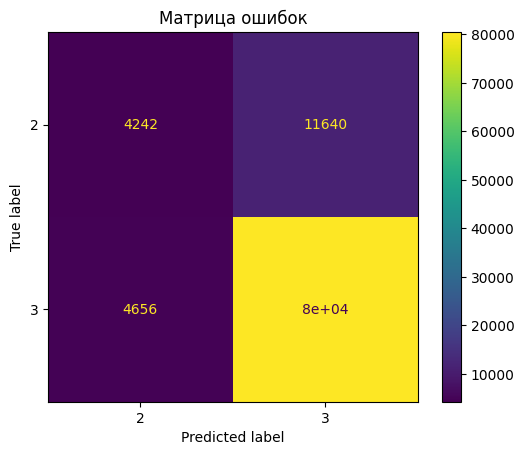

In [514]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score, confusion_matrix

# Подготовка тренировочного набора данных
train_df = merged_df2324.copy()
train_df = train_df.fillna('unknown')
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = merged_df.copy()
test_df = test_df.fillna('unknown')
# test_df = test_df.dropna()

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Уровень образования', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Обучение модели
# tree = DecisionTreeClassifier(max_depth=11, min_samples_split=7, random_state=43) #11/4, 11/5, 11/6
# tree.fit(X_tr, y_train)

rf = RandomForestClassifier(n_estimators=100, random_state=43)
rf.fit(X_tr, y_train)
y_pred = rf.predict(X_te)

# Предсказание и вычисление F1 score
# y_pred = tree.predict(X_te)
f1_macro = f1_score(y_test, y_pred, average='macro')

print(f"F1_macro: {f1_macro}")

# Вычисление и вывод матрицы ошибок
conf_matrix(y_test, y_pred, ['2', '3'])
# conf_matrix = confusion_matrix(y_test, y_pred)
# print("\nМатрица ошибок:")
# print(conf_matrix)

In [443]:
df_filtered 

,НомерЛД,ПерваяПопытка,Дисциплина,Кафедра,Тип_Ведомости,ID ЛК,Иностранец,finans,status,Уровень образования,Форма образования,Сезон,Год,Группа,ВидЗанятий,фио,ID Предмета,title,visits
6097,120123,3,Алгебра и геометрия,каф.ВМ,Экзамен,417061.0,False,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3101,Пр,Абжандадзе Зураб Леванович,1780.0,Алгебра и геометрия,75.00
12393,220123,5,Алгебра и геометрия,каф.ВМ,Экзамен,416841.0,False,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3101,Пр,Абжандадзе Зураб Леванович,1780.0,Алгебра и геометрия,81.25
12586,220320,5,Алгебра и геометрия,каф.ВМ,Экзамен,383979.0,False,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3101,Пр,Абжандадзе Зураб Леванович,1780.0,Алгебра и геометрия,31.25
42377,730123,3,Алгебра и геометрия,каф.ВМ,Экзамен,417019.0,False,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3101,Пр,Абжандадзе Зураб Леванович,1780.0,Алгебра и геометрия,75.00
47838,830123,3,Алгебра и геометрия,каф.ВМ,Экзамен,417532.0,False,Бюджет,Учащийся,Бакалавриат,Очная форма,autumn,2023,3101,Пр,Абжандадзе Зураб Леванович,1780.0,Алгебра и геометрия,43.75
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43786,750623,5,Эффективное лидерство,каф.МСК,Дифференцированный зачет,417706.0,False,Контракт,Учащийся,Бакалавриат,Очная форма,spring,2024,3691,Пр,Ерочкина Ольга Александровна,3356.0,Эффективное лидерство,87.50
17179,290623,5,Эффективное лидерство,каф.МСК,Дифференцированный зачет,418290.0,False,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,3692,Лек,Ерочкина Ольга Александровна,3357.0,Эффективное лидерство,37.50
17180,290623,5,Эффективное лидерство,каф.МСК,Дифференцированный зачет,418290.0,False,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,3692,Пр,Ерочкина Ольга Александровна,3356.0,Эффективное лидерство,75.00
39124,670623,5,Эффективное лидерство,каф.МСК,Дифференцированный зачет,416635.0,False,Бюджет,Учащийся,Бакалавриат,Очная форма,spring,2024,3692,Лек,Ерочкина Ольга Александровна,3357.0,Эффективное лидерство,50.00


In [444]:
merged_df

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ВидЗанятий,фио,title,Сезон,Год,visits
0,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,Пр,NaN,Иностранный язык,autumn,2024,0.000000
1,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Лек,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,15.625000
2,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Лек,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,0.000000
3,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Пр,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,15.625000
4,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,Отл,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Пр,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294902,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Удв,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,Пр,NaN,Иностранный язык,autumn,2024,7.692308
294904,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Н/я,3,Математический анализ,каф.ВМ,Экзамен,Лек,Фирсова Зинаида Викторовна,Математический анализ,autumn,2024,0.000000
294905,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Н/я,3,Математический анализ,каф.ВМ,Экзамен,Лек,Фирсова Зинаида Викторовна,Математический анализ,autumn,2024,11.764706
294906,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,Н/я,3,Математический анализ,каф.ВМ,Экзамен,Пр,Зив Александр Давидович,Математический анализ,autumn,2024,0.000000


In [517]:
grouped_df2324 = merged_df2324.groupby(
    ['ID ЛК', 'Иностранец', 'Курс', 'finans', 'status', 'Уровень образования', 
     'Форма образования', 'Группа', 'НомерЛД', 'ПерваяПопытка', 'Семестр', 
     'Дисциплина', 'Кафедра', 'Тип_Ведомости', 'ВидЗанятий', 'фио', 
     'title', 'Сезон', 'Год']
).agg({'visits': 'max'}).reset_index()

grouped_df = merged_df.groupby(
    ['ID ЛК', 'Иностранец', 'Курс', 'finans', 'status', 'Уровень образования', 
     'Форма образования', 'Группа', 'НомерЛД', 'ПерваяПопытка', 'Семестр', 
     'Дисциплина', 'Кафедра', 'Тип_Ведомости', 'ВидЗанятий', 'фио', 
     'title', 'Сезон', 'Год']
).agg({'visits': 'max'}).reset_index()


F1_macro: 0.6380967295580832


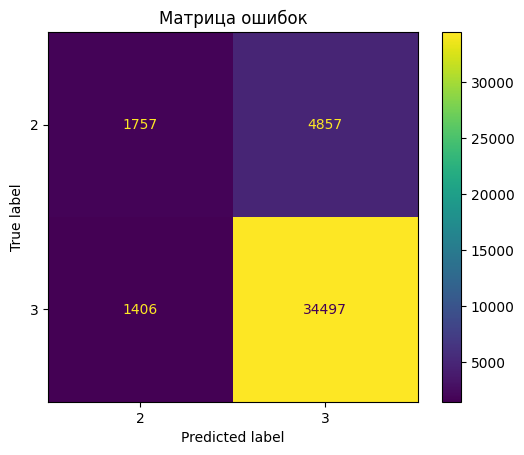

In [518]:
train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
# test_df = test_df.dropna()

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Уровень образования', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Обучение модели
# tree = DecisionTreeClassifier(max_depth=11, min_samples_split=7, random_state=43) #11/4, 11/5, 11/6
# tree.fit(X_tr, y_train)

rf = RandomForestClassifier(n_estimators=150, random_state=43)
rf.fit(X_tr, y_train)
y_pred = rf.predict(X_te)

# Предсказание и вычисление F1 score
# y_pred = tree.predict(X_te)
f1_macro = f1_score(y_test, y_pred, average='macro')

print(f"F1_macro: {f1_macro}")

# Вычисление и вывод матрицы ошибок
conf_matrix(y_test, y_pred, ['2', '3'])
# conf_matrix = confusion_matrix(y_test, y_pred)
# print("\nМатрица ошибок:")
# print(conf_matrix)

F1_macro: 0.6233991770908732


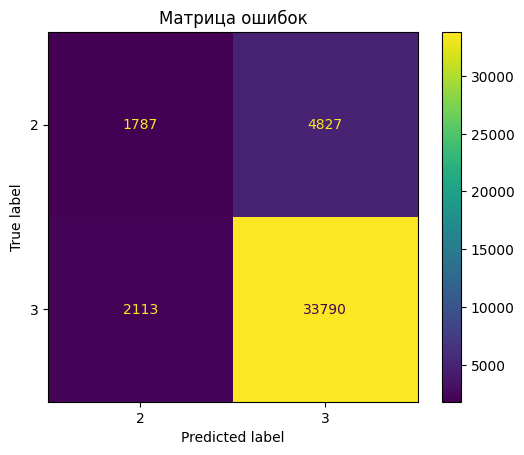

In [520]:
train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
# test_df = test_df.dropna()

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Уровень образования', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Обучение модели
tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43) #11/4, 11/5, 11/6
tree.fit(X_tr, y_train)

# rf = RandomForestClassifier(n_estimators=150, random_state=43)
# rf.fit(X_tr, y_train)
# y_pred = rf.predict(X_te)

# Предсказание и вычисление F1 score
y_pred = tree.predict(X_te)
f1_macro = f1_score(y_test, y_pred, average='macro')

print(f"F1_macro: {f1_macro}")

# Вычисление и вывод матрицы ошибок
conf_matrix(y_test, y_pred, ['2', '3'])
# conf_matrix = confusion_matrix(y_test, y_pred)
# print("\nМатрица ошибок:")
# print(conf_matrix)

In [516]:
merged_df

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ВидЗанятий,фио,title,Сезон,Год,visits
0,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,Пр,NaN,Иностранный язык,autumn,2024,0.000000
1,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Лек,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,15.625000
2,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Лек,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,0.000000
3,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Пр,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,15.625000
4,373038,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9374,5540319,5,3,Методы экспертного оценивания и групповая эксп...,каф.ИС,Дифференцированный зачет,Пр,Падерно Павел Иосифович,Методы экспертного оценивания и групповая эксп...,autumn,2024,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294902,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,3,3,Иностранный язык,каф.ИНЯЗ,Дифференцированный зачет,Пр,NaN,Иностранный язык,autumn,2024,7.692308
294904,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,2,3,Математический анализ,каф.ВМ,Экзамен,Лек,Фирсова Зинаида Викторовна,Математический анализ,autumn,2024,0.000000
294905,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,2,3,Математический анализ,каф.ВМ,Экзамен,Лек,Фирсова Зинаида Викторовна,Математический анализ,autumn,2024,11.764706
294906,421383,False,1,Бюджет,Учащийся,Бакалавриат,Очная форма,3586,8800848,2,3,Математический анализ,каф.ВМ,Экзамен,Пр,Зив Александр Давидович,Математический анализ,autumn,2024,0.000000


In [ ]:
# df_sorted = t_coef.sort_values(by=['Дисциплина', 'Группа', 'фио'])

# no_kurs_semestr = df_sorted.copy()

# df_filtered = no_kurs_semestr[(no_kurs_semestr['Семестр'] != 3) & 
#                         (no_kurs_semestr['Тип_Ведомости'] != 'К/проект')].dropna()

# df_filtered = df_filtered.drop(columns=['Курс', 'Семестр'])

df_filtered = merged_df2324.copy()

df_filtered = df_filtered.dropna()

# Переменная для хранения результатов
results = []

# Уникальные дисциплины
disciplines = df_filtered['Дисциплина'].unique()

for discipline in disciplines:
    print(f"Обработка дисциплины: {discipline}")
    
    # Фильтрация данных по дисциплине
    df_discipline = df_filtered[df_filtered['Дисциплина'] == discipline]
    df_merged_discipline = merged_df[merged_df['Дисциплина'] == discipline]
    
    # Проверка наличия данных для дисциплины
    if df_merged_discipline.empty:
        print(f"Нет данных в merged_df для дисциплины: {discipline}")
        continue
    
    # Обучающая выборка
    df1 = df_discipline
    
    # Исключение определённых записей
    df1 = df1[df1['фио'] != 'КоцюбаИгорьЮрьевич, ГороховВладимирЛеонидович']
    
    # Определение признаков для модели
    features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
               'finans', 'status', 'Уровень образования', 'Форма образования', 
               'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 
               'visits', 'Дисциплина']
    
    X_train = df1[features]
    y_train = df1['ПерваяПопытка']
    X_test = df_merged_discipline[features]
    
    # Преобразование категориальных переменных
    X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД']))
    X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД']))
    
    # Добавление числовых переменных
    X_tr['visits'] = X_train['visits']
    X_te['visits'] = X_test['visits']
    
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    
    # Приведение размерностей
    X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)
    
    # Преобразование меток
    y_tr = y_train.map({2: 2, 3: 3, 4: 3, 5: 3})
    
    # Обучение модели
    tree = DecisionTreeClassifier(random_state=43)
    tree.fit(X_tr, y_tr)
    
    # Предсказание
    if len(X_te) > 0:  # Убедимся, что тестовые данные не пусты
        y_pred = tree.predict(X_te)
    
        if 'ПерваяПопытка' in df_merged_discipline.columns:
            y_test = df_merged_discipline['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

            # Вычисление F1 score
            if len(y_test) == len(y_pred):
                f1_macro = f1_score(y_test, y_pred, average='macro')
                results.append({'Дисциплина': discipline, 'F1_macro': f1_macro})
            else:
                print(f"Warning: Размерности y_test ({len(y_test)}) и y_pred ({len(y_pred)}) "
                      f"не совпадают для дисциплины {discipline}.")
    else:
        print(f"Нет тестовых данных для дисциплины {discipline} после предварительной обработки.")

results_df = pd.DataFrame(results)

median_f1 = results_df['F1_macro'].median()
mean_f1 = results_df['F1_macro'].mean()

print(f"Медианное значение F1_macro: {median_f1}")
print(f"Среднее значение F1_macro: {mean_f1}")

print("\nРезультаты по дисциплинам:")
print(results_df)

In [539]:
grouped_df2324[grouped_df2324['Дисциплина'] =='SLAM- алгоритмы']

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ВидЗанятий,фио,title,Сезон,Год,visits
70043,402720,False,2,Бюджет,Академический,Магистратура,Очная форма,8346,8800373,2,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Лек,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2023,0.0
70044,402720,False,2,Бюджет,Академический,Магистратура,Очная форма,8346,8800373,2,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Пр,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2023,0.0


In [540]:
grouped_df[grouped_df['Дисциплина'] =='SLAM- алгоритмы']

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ВидЗанятий,фио,title,Сезон,Год,visits
77,317839,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9310,1860118,2,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Лек,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2024,0.0
78,317839,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9310,1860118,2,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Пр,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2024,0.0
694,372956,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9306,4680319,5,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Лек,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2024,0.0
695,372956,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9306,4680319,5,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Пр,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2024,0.0
720,372962,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9310,4740319,5,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Лек,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2024,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42472,420617,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9346,8800840,2,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Пр,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2024,0.0
42479,420618,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9346,8800841,3,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Лек,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2024,0.0
42480,420618,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9346,8800841,3,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Пр,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2024,0.0
42491,420619,False,1,Бюджет,Учащийся,Магистратура,Очная форма,9346,8800842,4,3,SLAM- алгоритмы,каф.МОЭВМ,Дифференцированный зачет,Лек,Филатов Антон Юрьевич,SLAM- алгоритмы,autumn,2024,0.0


In [524]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score, confusion_matrix

# Подготовка тренировочного и тестового наборов данных
train_df = grouped_df2324.copy().fillna('unknown')
test_df = grouped_df.copy().fillna('unknown')

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = [
    'ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
    'finans', 'status', 'Уровень образования', 'Форма образования', 
    'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits'
]

# Итерация по каждой дисциплине
disciplines = train_df['Дисциплина'].unique()
arr = []
for discipline in disciplines:
    print(f"\nДисциплина: {discipline}")
    
    # Выбор подмножеств для текущей дисциплины
    train_sub_df = train_df[train_df['Дисциплина'] == discipline]
    test_sub_df = test_df[test_df['Дисциплина'] == discipline]
    
    if len(train_sub_df) == 0 or len(test_sub_df) == 0:
        print("Нет данных для обучения или тестирования, пропускаем.")
        continue
    
    # Формирование матриц признаков и меток
    X_train = train_sub_df[features]
    y_train = train_sub_df['ПерваяПопытка']
    
    X_test = test_sub_df[features]
    y_test = test_sub_df['ПерваяПопытка']
    
    # Преобразование категориальных переменных в индикаторы
    X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
    X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
    
    # Добавление числовых переменных
    X_tr['visits'] = X_train['visits']
    X_te['visits'] = X_test['visits']
    
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    
    # Приведение размерностей
    X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)
    
    # Обучение модели
    tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43)
    tree.fit(X_tr, y_train)
    
    # Предсказание и вычисление F1 score
    y_pred = tree.predict(X_te)
    f1_macro = f1_score(y_test, y_pred, average='macro')

    arr.append(f1_macro)
    print(f"F1_macro: {f1_macro}")
    
    # Вычисление и вывод матрицы ошибок
    # conf_matrix = confusion_matrix(y_test, y_pred)
    # print("Матрица ошибок:")
    # print(conf_matrix)
import statistics

print(statistics.median(arr))


Дисциплина: Проектирование корабельных информационных систем
F1_macro: 0.2222222222222222

Дисциплина: Системы управления морскими подвижными объектами
F1_macro: 0.36363636363636365

Дисциплина: Иностранный язык
F1_macro: 0.7838827838827839

Дисциплина: Машинное обучение и анализ данных
F1_macro: 0.46530612244897956

Дисциплина: Нелинейное и адаптивное управление в технических системах
F1_macro: 0.4961832061068702

Дисциплина: Специальные разделы теории автоматического управления в робототехнике
F1_macro: 0.46153846153846156

Дисциплина: Управление едиными судовыми электроэнергетическими системами
F1_macro: 0.47058823529411764

Дисциплина: Методы анализа микро- и наносистем
F1_macro: 0.0

Дисциплина: Прикладные вопросы диагностики наноматериалов
Нет данных для обучения или тестирования, пропускаем.

Дисциплина: Микро- и наноэнергетика
F1_macro: 1.0

Дисциплина: Прикладные вопросы нанотехнологии
F1_macro: 1.0

Дисциплина: Технология пористых наноматериалов
Нет данных для обучения или т

In [541]:
train_df

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ВидЗанятий,фио,title,Сезон,Год,visits
0,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,Дифференцированный зачет,Лаб,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
1,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,Дифференцированный зачет,Лек,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
2,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,Дифференцированный зачет,Пр,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
3,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,К/проект,Лаб,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
4,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,К/проект,Лек,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71315,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,3,4,Элементная база электроники,каф.БТС,Дифференцированный зачет,Лаб,Анисимов Алексей Андреевич,Элементная база электроники,spring,2024,100.00
71316,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,3,4,Элементная база электроники,каф.БТС,Дифференцированный зачет,Лек,Анисимов Алексей Андреевич,Элементная база электроники,spring,2024,100.00
71317,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,3,4,Элементная база электроники,каф.БТС,Дифференцированный зачет,Пр,Анисимов Алексей Андреевич,Элементная база электроники,spring,2024,100.00
71318,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,3,4,Основы биологии,каф.БТС,Дифференцированный зачет,Лек,Пуговкин Андрей Петрович,Основы биологии,spring,2024,56.25


F1_macro: 0.6471557221421752


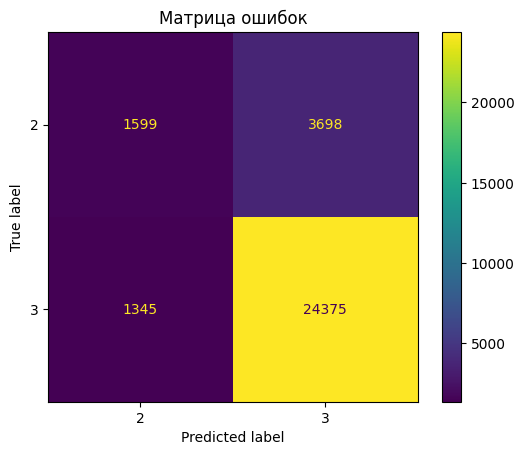

In [547]:
train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
train_df = train_df[train_df['Уровень образования'] == 'Бакалавриат']
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
test_df = test_df[test_df['Уровень образования'] == 'Бакалавриат']

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Обучение модели
# tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43) #11/4, 11/5, 11/6
# tree.fit(X_tr, y_train)
# y_pred = tree.predict(X_te)
# Лучшие параметры:  {'min_samples_split': 5, 'min_samples_leaf': 6, 'max_depth': 40, 'criterion': 'gini'}

rf = RandomForestClassifier(n_estimators=150, random_state=43) #100 : 0.64439
rf.fit(X_tr, y_train)
y_pred = rf.predict(X_te)


f1_macro = f1_score(y_test, y_pred, average='macro')

print(f"F1_macro: {f1_macro}")


conf_matrix(y_test, y_pred, ['2', '3'])

In [553]:
pip install imbalanced-learn


[notice] A new release of pip is available: 24.2 -> 25.0.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


F1_macro: 0.6646692591105373


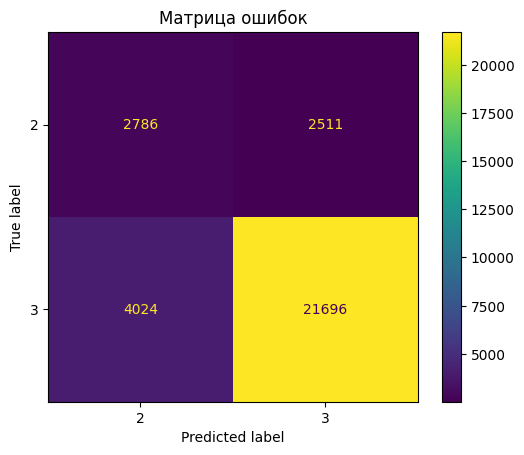

In [554]:
from imblearn.ensemble import BalancedRandomForestClassifier

train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
train_df = train_df[train_df['Уровень образования'] == 'Бакалавриат']
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
test_df = test_df[test_df['Уровень образования'] == 'Бакалавриат']

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Обучение модели
# tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43) #11/4, 11/5, 11/6
# tree.fit(X_tr, y_train)
# y_pred = tree.predict(X_te)
# Лучшие параметры:  {'min_samples_split': 5, 'min_samples_leaf': 6, 'max_depth': 40, 'criterion': 'gini'}

rf = BalancedRandomForestClassifier(n_estimators=150, random_state=43) #100 : 0.64439; imbalance 0.664669
rf.fit(X_tr, y_train)
y_pred = rf.predict(X_te)


f1_macro = f1_score(y_test, y_pred, average='macro')

print(f"F1_macro: {f1_macro}")


conf_matrix(y_test, y_pred, ['2', '3'])

F1_macro: 0.5271172312992238


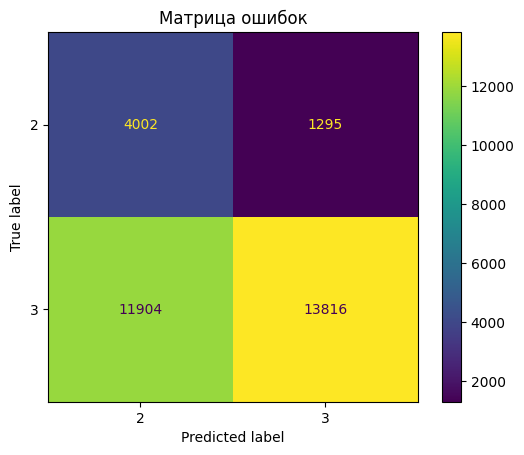

In [557]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.utils.class_weight import compute_class_weight

from imblearn.ensemble import BalancedRandomForestClassifier

train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
train_df = train_df[train_df['Уровень образования'] == 'Бакалавриат']
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
test_df = test_df[test_df['Уровень образования'] == 'Бакалавриат']

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Обучение модели
# tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43) #11/4, 11/5, 11/6
# tree.fit(X_tr, y_train)
# y_pred = tree.predict(X_te)
# Лучшие параметры:  {'min_samples_split': 5, 'min_samples_leaf': 6, 'max_depth': 40, 'criterion': 'gini'}

# rf = BalancedRandomForestClassifier(n_estimators=150, random_state=43) #100 : 0.64439; imbalance 0.664669
# rf.fit(X_tr, y_train)
# y_pred = rf.predict(X_te)


# f1_macro = f1_score(y_test, y_pred, average='macro')

# print(f"F1_macro: {f1_macro}")


# conf_matrix(y_test, y_pred, ['2', '3'])

# Определите веса классов
# class_weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
# class_weight_dict = {i : class_weights[i] for i in range(len(class_weights))}

# Инициализируйте классификатор с учетом весов
tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, class_weight='balanced', random_state=43)
tree.fit(X_tr, y_train)
y_pred = tree.predict(X_te)


f1_macro = f1_score(y_test, y_pred, average='macro')

print(f"F1_macro: {f1_macro}")
conf_matrix(y_test, y_pred, ['2', '3'])

F1_macro: 0.6795521708714264


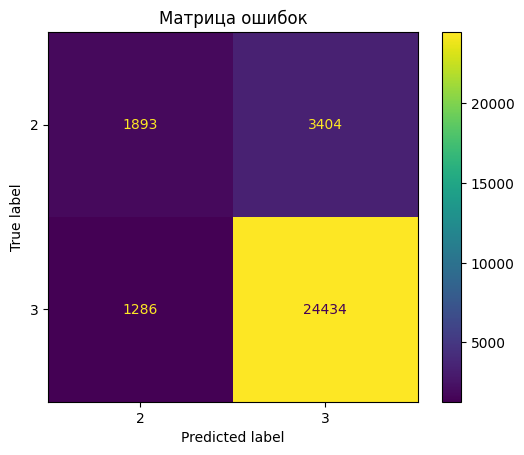

In [561]:
from sklearn.ensemble import GradientBoostingClassifier

gbc = GradientBoostingClassifier(random_state=43)
gbc.fit(X_tr, y_train)

# Предсказание
y_pred = gbc.predict(X_te)

# Оценка модели
f1_macro = f1_score(y_test, y_pred, average='macro')
print(f"F1_macro: {f1_macro}")

# Матрица путаницы
conf_matrix(y_test, y_pred, [2, 3])

F1_macro: 0.6681544810690161


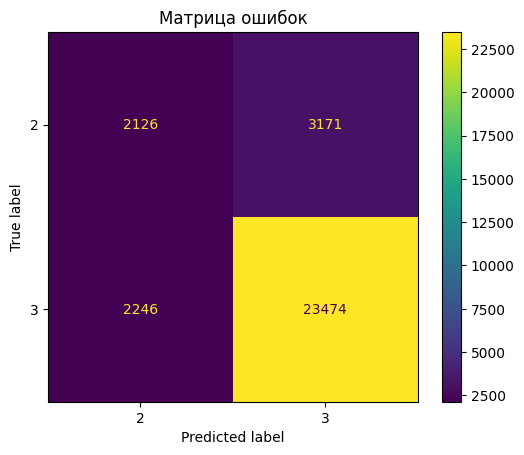

In [562]:
gbc = GradientBoostingClassifier(random_state=43)
gbc.fit(X_tr, y_train)
y_pred_gbc = gbc.predict(X_te)


tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43) #11/4, 11/5, 11/6
tree.fit(X_tr, y_train)
y_pred_tree = tree.predict(X_te)

rf = BalancedRandomForestClassifier(n_estimators=150, random_state=43) #100 : 0.64439; imbalance 0.664669
rf.fit(X_tr, y_train)
y_pred_rf = rf.predict(X_te)


y_pred_min = np.minimum(y_pred_gbc, y_pred_tree, y_pred_rf)

f1_macro = f1_score(y_test, y_pred_min, average='macro')

print(f"F1_macro: {f1_macro}")


conf_matrix(y_test, y_pred_min, ['2', '3'])

F1_macro: 0.6712162817492229


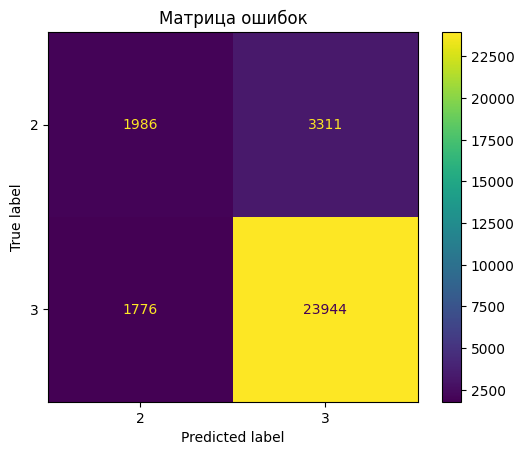

In [564]:
gbc = GradientBoostingClassifier(random_state=43)
gbc.fit(X_tr, y_train)
y_pred_gbc = gbc.predict(X_te)


tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43) #11/4, 11/5, 11/6
tree.fit(X_tr, y_train)
y_pred_tree = tree.predict(X_te)

rf = BalancedRandomForestClassifier(n_estimators=150, random_state=43) #100 : 0.64439; imbalance 0.664669
rf.fit(X_tr, y_train)
y_pred_rf = rf.predict(X_te)


def vote_mode(pred1, pred2, pred3):
    result = []
    for i in range(len(pred1)):
        votes = [pred1[i], pred2[i], pred3[i]]
        mode = max(set(votes), key=votes.count)
        result.append(mode)
    return np.array(result)

y_pred_majority = vote_mode(y_pred_gbc, y_pred_tree, y_pred_rf)


# y_pred_min = np.median(y_pred_gbc, y_pred_tree, y_pred_rf)

f1_macro = f1_score(y_test, y_pred_majority, average='macro')

print(f"F1_macro: {f1_macro}")


conf_matrix(y_test, y_pred_majority, ['2', '3'])

In [569]:
grouped_df2324

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ВидЗанятий,фио,title,Сезон,Год,visits
0,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,Дифференцированный зачет,Лаб,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
1,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,Дифференцированный зачет,Лек,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
2,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,Дифференцированный зачет,Пр,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
3,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,К/проект,Лаб,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
4,959,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8494,1280416,2,3,Проектирование корабельных информационных систем,каф.КСУ,К/проект,Лек,Бубнов Евгений Александрович,Проектирование корабельных информационных систем,autumn,2023,62.50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71315,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,3,4,Элементная база электроники,каф.БТС,Дифференцированный зачет,Лаб,Анисимов Алексей Андреевич,Элементная база электроники,spring,2024,100.00
71316,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,3,4,Элементная база электроники,каф.БТС,Дифференцированный зачет,Лек,Анисимов Алексей Андреевич,Элементная база электроники,spring,2024,100.00
71317,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,3,4,Элементная база электроники,каф.БТС,Дифференцированный зачет,Пр,Анисимов Алексей Андреевич,Элементная база электроники,spring,2024,100.00
71318,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,5,4,Основы биологии,каф.БТС,Дифференцированный зачет,Лек,Пуговкин Андрей Петрович,Основы биологии,spring,2024,56.25


F1_macro: 0.6723719864671167


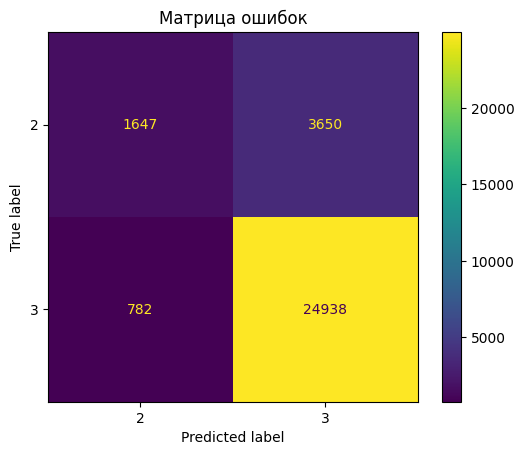

In [567]:
train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
train_df = train_df[train_df['Уровень образования'] == 'Бакалавриат']
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
test_df = test_df[test_df['Уровень образования'] == 'Бакалавриат']

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['НомерЛД'] = X_train['НомерЛД']
X_te['НомерЛД'] = X_test['НомерЛД']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

gbc = GradientBoostingClassifier(random_state=43)
gbc.fit(X_tr, y_train)
y_pred_gbc = gbc.predict(X_te)


tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43) #11/4, 11/5, 11/6
tree.fit(X_tr, y_train)
y_pred_tree = tree.predict(X_te)

rf = BalancedRandomForestClassifier(n_estimators=150, random_state=43) #100 : 0.64439; imbalance 0.664669
rf.fit(X_tr, y_train)
y_pred_rf = rf.predict(X_te)


def vote_mode(pred1, pred2, pred3):
    result = []
    for i in range(len(pred1)):
        votes = [pred1[i], pred2[i], pred3[i]]
        mode = max(set(votes), key=votes.count)
        result.append(mode)
    return np.array(result)

y_pred_majority = vote_mode(y_pred_gbc, y_pred_tree, y_pred_rf)


# y_pred_min = np.median(y_pred_gbc, y_pred_tree, y_pred_rf)

f1_macro = f1_score(y_test, y_pred_majority, average='macro')

print(f"F1_macro: {f1_macro}")


conf_matrix(y_test, y_pred_majority, ['2', '3'])

In [573]:
import numpy as np
import pandas as pd
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from imblearn.ensemble import BalancedRandomForestClassifier
from sklearn.metrics import f1_score, confusion_matrix

# Функция для голосования
def vote_mode(pred1, pred2, pred3):
    result = []
    for i in range(len(pred1)):
        votes = [pred1[i], pred2[i], pred3[i]]
        mode = max(set(votes), key=votes.count)
        result.append(mode)
    return np.array(result)

# Словари для хранения результатов
f1_scores = []
conf_matrices = []

# Цикл по уникальным значениям 'title'
for title in test_df['title'].unique():
    # Фильтрация наборов данных по 'title'
    train_subset = train_df[train_df['title'] == title]
    test_subset = test_df[test_df['title'] == title]

    if train_subset.empty or test_subset.empty:
        continue

    if len(train_subset['ПерваяПопытка'].unique()) < 2 or len(test_subset['ПерваяПопытка'].unique()) < 2:
        continue

    
    # Подготовка данных
    X_train = train_subset[features]
    y_train = train_subset['ПерваяПопытка']
    X_test = test_subset[features]
    y_test = test_subset['ПерваяПопытка']
    
    # Преобразование в индикаторы
    X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
    X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
    
    X_tr['visits'] = X_train['visits']
    X_te['visits'] = X_test['visits']
    
    X_tr['Группа'] = X_train['Группа']
    X_te['Группа'] = X_test['Группа']
    
    X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)
    
    # Модели
    gbc = GradientBoostingClassifier(random_state=43)
    gbc.fit(X_tr, y_train)
    y_pred_gbc = gbc.predict(X_te)
    
    tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43)
    tree.fit(X_tr, y_train)
    y_pred_tree = tree.predict(X_te)
    
    rf = BalancedRandomForestClassifier(n_estimators=150, random_state=43)
    rf.fit(X_tr, y_train)
    y_pred_rf = rf.predict(X_te)
    
    # Вычисление моды
    y_pred_majority = vote_mode(y_pred_gbc, y_pred_tree, y_pred_rf)
    
    # F1-макро и матрица путаницы
    f1 = f1_score(y_test, y_pred_majority, average='macro')
    f1_scores.append(f1)
    
    # matrix = confusion_matrix(y_test, y_pred_majority, labels=[2, 3])
    # conf_matrices.append(matrix)

# Вычисление медианного значения F1
median_f1 = np.median(f1_scores)

# Средняя матрица путаницы
# avg_conf_matrix = np.mean(conf_matrices, axis=0)

# print(f"Mediанный F1_macro: {median_f1}")
# print("Средняя матрица путаницы:")
# print(avg_conf_matrix)

In [574]:
median_f1

np.float64(0.5140822213190634)

F1_macro: 0.6639879578384016


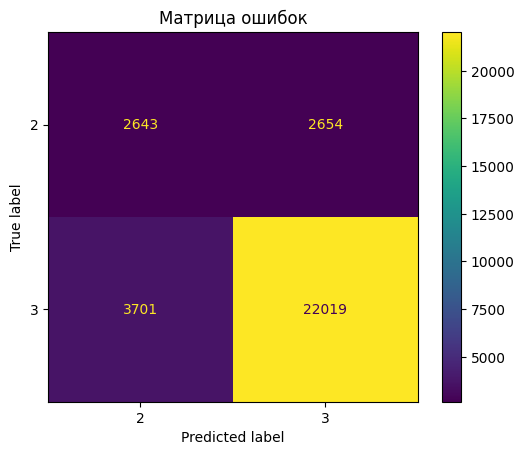

In [568]:
train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
train_df = train_df[train_df['Уровень образования'] == 'Бакалавриат']
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
test_df = test_df[test_df['Уровень образования'] == 'Бакалавриат']

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

gbc = GradientBoostingClassifier(random_state=43)
gbc.fit(X_tr, y_train)
y_pred_gbc = gbc.predict(X_te)


tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, class_weight='balanced', random_state=43)
tree.fit(X_tr, y_train)
y_pred_tree = tree.predict(X_te)

rf = BalancedRandomForestClassifier(n_estimators=150, random_state=43) #100 : 0.64439; imbalance 0.664669
rf.fit(X_tr, y_train)
y_pred_rf = rf.predict(X_te)


def vote_mode(pred1, pred2, pred3):
    result = []
    for i in range(len(pred1)):
        votes = [pred1[i], pred2[i], pred3[i]]
        mode = max(set(votes), key=votes.count)
        result.append(mode)
    return np.array(result)

y_pred_majority = vote_mode(y_pred_gbc, y_pred_tree, y_pred_rf)


# y_pred_min = np.median(y_pred_gbc, y_pred_tree, y_pred_rf)

f1_macro = f1_score(y_test, y_pred_majority, average='macro')

print(f"F1_macro: {f1_macro}")


conf_matrix(y_test, y_pred_majority, ['2', '3'])


F1_macro: 0.6202118224107255


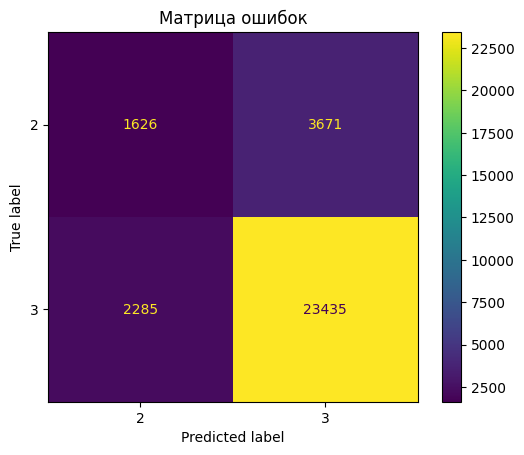

In [565]:

train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
train_df = train_df[train_df['Уровень образования'] == 'Бакалавриат']
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
test_df = test_df[test_df['Уровень образования'] == 'Бакалавриат']

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
# X_tr['visits'] = X_train['visits']
# X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

gbc = GradientBoostingClassifier(random_state=43)
gbc.fit(X_tr, y_train)
y_pred_gbc = gbc.predict(X_te)


tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43) #11/4, 11/5, 11/6
tree.fit(X_tr, y_train)
y_pred_tree = tree.predict(X_te)

rf = BalancedRandomForestClassifier(n_estimators=150, random_state=43) #100 : 0.64439; imbalance 0.664669
rf.fit(X_tr, y_train)
y_pred_rf = rf.predict(X_te)


def vote_mode(pred1, pred2, pred3):
    result = []
    for i in range(len(pred1)):
        votes = [pred1[i], pred2[i], pred3[i]]
        mode = max(set(votes), key=votes.count)
        result.append(mode)
    return np.array(result)

y_pred_majority = vote_mode(y_pred_gbc, y_pred_tree, y_pred_rf)


# y_pred_min = np.median(y_pred_gbc, y_pred_tree, y_pred_rf)

f1_macro = f1_score(y_test, y_pred_majority, average='macro')

print(f"F1_macro: {f1_macro}")


conf_matrix(y_test, y_pred_majority, ['2', '3'])

F1_macro: 0.6551370670722174


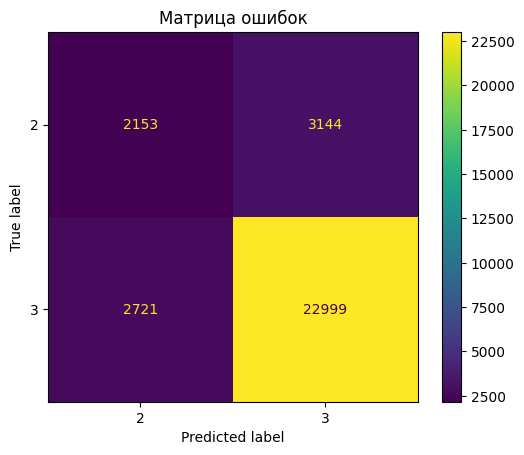

In [548]:
# 2 модели и берем минимум
train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
train_df = train_df[train_df['Уровень образования'] == 'Бакалавриат']
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
test_df = test_df[test_df['Уровень образования'] == 'Бакалавриат']

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Обучение модели
tree = DecisionTreeClassifier(max_depth=11, min_samples_split=6, random_state=43) #11/4, 11/5, 11/6
tree.fit(X_tr, y_train)
y_pred_t = tree.predict(X_te)
# Лучшие параметры:  {'min_samples_split': 5, 'min_samples_leaf': 6, 'max_depth': 40, 'criterion': 'gini'}

rf = RandomForestClassifier(n_estimators=150, random_state=43) #100 : 0.64439
rf.fit(X_tr, y_train)
y_pred_r = rf.predict(X_te)

y_pred_min = np.minimum(y_pred_t, y_pred_r)

f1_macro = f1_score(y_test, y_pred_min, average='macro')

print(f"F1_macro: {f1_macro}")


conf_matrix(y_test, y_pred_min, ['2', '3'])

In [ ]:
param_dist = {
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10, 15],
    'min_samples_leaf': [1, 2, 4, 6],
    'criterion': ['gini', 'entropy', 'log_loss']  # Можно также попробовать 'log_loss' для вероятностных деревьев (начиная с sklearn версии 1.1)
}

dt = DecisionTreeClassifier(random_state=43)

# Поиск оптимальных гиперпараметров
random_search = RandomizedSearchCV(estimator=dt, param_distributions=param_dist, n_iter=20, scoring='f1_macro', cv=5, random_state=42)
random_search.fit(X_tr, y_train)

# Вывод лучших найденных параметров
print("Лучшие параметры: ", random_search.best_params_)

# Использование найденных параметров для обучения
best_dt = random_search.best_estimator_
best_dt.fit(X_tr, y_train)
y_pred = best_dt.predict(X_te)

# Оценка на тестовом наборе
f1_macro = f1_score(y_test, y_pred, average='macro')
print(f"F1_macro (на тестовых данных): {f1_macro}")

# Вывод матрицы ошибок
conf_matrix = confusion_matrix(y_test, y_pred, labels=[2, 3])
print("Confusion Matrix:")
print(conf_matrix)

In [537]:
param_dist = {
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10, 15],
    'min_samples_leaf': [1, 2, 4, 6],
    'criterion': ['gini', 'entropy', 'log_loss']  # Можно также попробовать 'log_loss' для вероятностных деревьев (начиная с sklearn версии 1.1)
}

dt = DecisionTreeClassifier(random_state=43)

# Поиск оптимальных гиперпараметров
random_search = RandomizedSearchCV(estimator=dt, param_distributions=param_dist, n_iter=20, scoring='f1_macro', cv=5, random_state=42)
random_search.fit(X_tr, y_train)

# Вывод лучших найденных параметров
print("Лучшие параметры: ", random_search.best_params_)

# Использование найденных параметров для обучения
best_dt = random_search.best_estimator_
best_dt.fit(X_tr, y_train)
y_pred = best_dt.predict(X_te)

# Оценка на тестовом наборе
f1_macro = f1_score(y_test, y_pred, average='macro')
print(f"F1_macro (на тестовых данных): {f1_macro}")

# Вывод матрицы ошибок
conf_matrix = confusion_matrix(y_test, y_pred, labels=[2, 3])
print("Confusion Matrix:")
print(conf_matrix)



Лучшие параметры:  {'min_samples_split': 5, 'min_samples_leaf': 6, 'max_depth': 40, 'criterion': 'gini'}
F1_macro (на тестовых данных): 0.6420247527128741
Confusion Matrix:
[[ 2609  4005]
 [ 3980 31923]]


Лучшие параметры:  {'n_estimators': 100, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': None, 'bootstrap': True}
F1_macro (на тестовых данных): 0.6332662651868484


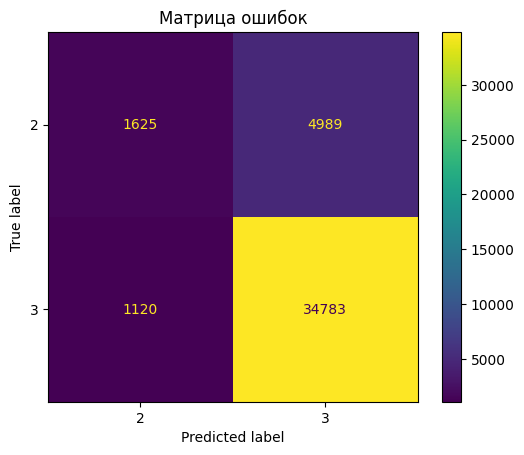

In [535]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import f1_score

# Задание диапазонов для гиперпараметров
param_dist = {
    'n_estimators': [50, 100, 150, 200],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

rf = RandomForestClassifier(random_state=43)

# Поиск оптимальных гиперпараметров
random_search = RandomizedSearchCV(estimator=rf, param_distributions=param_dist, n_iter=20, scoring='f1_macro', cv=5, random_state=42)
random_search.fit(X_tr, y_train)

# Вывод лучших найденных параметров
print("Лучшие параметры: ", random_search.best_params_)

# Использование найденных параметров для обучения
best_rf = random_search.best_estimator_
best_rf.fit(X_tr, y_train)
y_pred = best_rf.predict(X_te)

# Оценка на тестовом наборе
f1_macro = f1_score(y_test, y_pred, average='macro')
print(f"F1_macro (на тестовых данных): {f1_macro}")

conf_matrix(y_test, y_pred, ['2', '3'])

In [533]:
from sklearn.model_selection import cross_val_score

# Определение модели
rf = RandomForestClassifier(n_estimators=150, random_state=43)

# Выполнение кросс-валидации
cv_scores = cross_val_score(rf, X_tr, y_train, cv=5)

print("Кросс-валидационные оценки:", cv_scores)
print("Средняя кросс-валидационная оценка:", cv_scores.mean())

# Теперь, если нужно, вы можете обучить модель на всех тренировочных данных и сделать предсказания
rf.fit(X_tr, y_train)
y_pred = rf.predict(X_te)

Кросс-валидационные оценки: [0.82676669 0.84527482 0.85431856 0.85726304 0.84001683]
Средняя кросс-валидационная оценка: 0.84472798653954


KeyboardInterrupt: 

In [ ]:
f1_macro = f1_score(y_test, y_pred, average='macro')

print(f"F1_macro: {f1_macro}")

In [ ]:
train_df = grouped_df2324.copy()
train_df = train_df.fillna('unknown')
# train_df = train_df.dropna()

# Замена текстовых значений на числовые
train_df['ПерваяПопытка'] = train_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Подготовка тестового набора данных
test_df = grouped_df.copy()
test_df = test_df.fillna('unknown')
# test_df = test_df.dropna()

# Замена текстовых значений на числовые в тестовом наборе
test_df['ПерваяПопытка'] = test_df['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)

# Определение признаков для модели
features = ['ID ЛК', 'НомерЛД', 'Тип_Ведомости', 'Иностранец', 
            'finans', 'status', 'Уровень образования', 'Форма образования', 
            'Сезон', 'Группа', 'ВидЗанятий', 'фио', 'title', 'visits']

X_train = train_df[features]
y_train = train_df['ПерваяПопытка']

X_test = test_df[features]
y_test = test_df['ПерваяПопытка']

# Преобразование категориальных переменных в индикаторы
X_tr = pd.get_dummies(X_train.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))
X_te = pd.get_dummies(X_test.drop(columns=['visits', 'Группа', 'НомерЛД', 'ID ЛК']))

# Добавление числовых переменных
X_tr['visits'] = X_train['visits']
X_te['visits'] = X_test['visits']

X_tr['Группа'] = X_train['Группа']
X_te['Группа'] = X_test['Группа']

# Приведение размерностей
X_te = X_te.reindex(columns=X_tr.columns, fill_value=0)

# Обучение модели
tree = DecisionTreeClassifier(max_depth=11, min_samples_split=5, random_state=43) #11/4, 11/5, 11/6
tree.fit(X_tr, y_train)

# rf = RandomForestClassifier(n_estimators=150, random_state=43)
# rf.fit(X_tr, y_train)
# y_pred = rf.predict(X_te)

# Предсказание и вычисление F1 score
y_pred = tree.predict(X_te)
f1_macro = f1_score(y_test, y_pred, average='macro')

print(f"F1_macro: {f1_macro}")

# Вычисление и вывод матрицы ошибок
conf_matrix(y_test, y_pred, ['2', '3'])
# conf_matrix = confusion_matrix(y_test, y_pred)
# print("\nМатрица ошибок:")
# print(conf_matrix)

In [ ]:
# ---
# исследование датасета

In [636]:
merged_df2324.isna().sum()

ID ЛК                      0
Иностранец                 0
Курс                       0
finans                     0
status                     0
Уровень образования        0
Форма образования          0
Группа                     0
НомерЛД                    0
ПерваяПопытка              0
Семестр                    0
Дисциплина                 0
Кафедра                    0
Тип_Ведомости              0
ВидЗанятий                 0
фио                    31977
title                      0
Сезон                      0
Год                        0
visits                     0
dtype: int64

In [637]:
itog_df2324 = merged_df2324.fillna('unknown')

In [638]:
corrmat = itog_df.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=.8, square=True, annot=True, fmt='.2f')
plt.title('data');

ValueError: could not convert string to float: 'Бюджет'

In [634]:
itog_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 100949 entries, 0 to 294907
Data columns (total 20 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID ЛК                100949 non-null  int64  
 1   Иностранец           100949 non-null  bool   
 2   Курс                 100949 non-null  int64  
 3   finans               100949 non-null  object 
 4   status               100949 non-null  object 
 5   Уровень образования  100949 non-null  object 
 6   Форма образования    100949 non-null  object 
 7   Группа               100949 non-null  int64  
 8   НомерЛД              100949 non-null  int64  
 9   ПерваяПопытка        100949 non-null  int64  
 10  Семестр              100949 non-null  int64  
 11  Дисциплина           100949 non-null  object 
 12  Кафедра              100949 non-null  object 
 13  Тип_Ведомости        100949 non-null  object 
 14  ВидЗанятий           100949 non-null  object 
 15  фио                  1

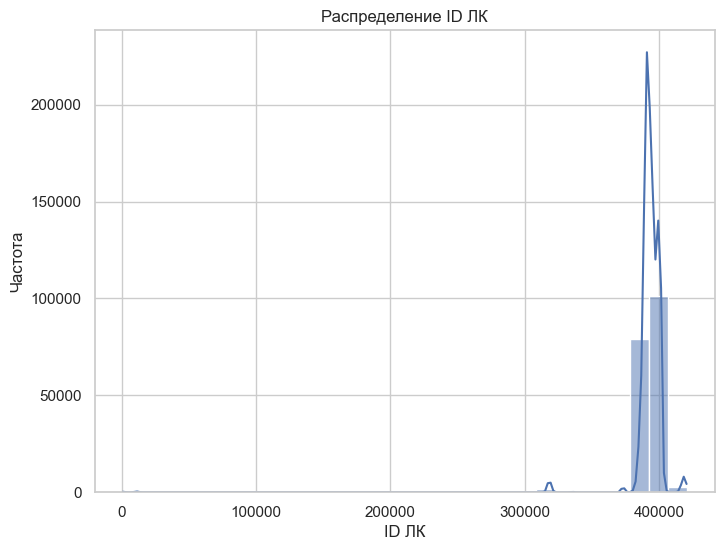

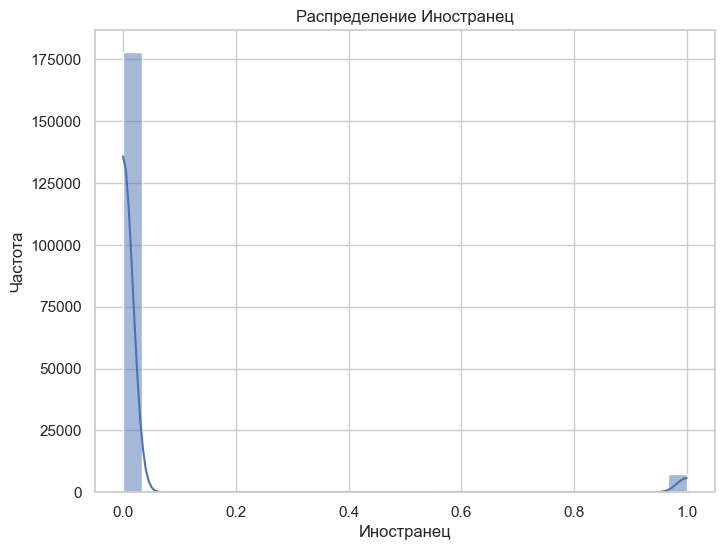

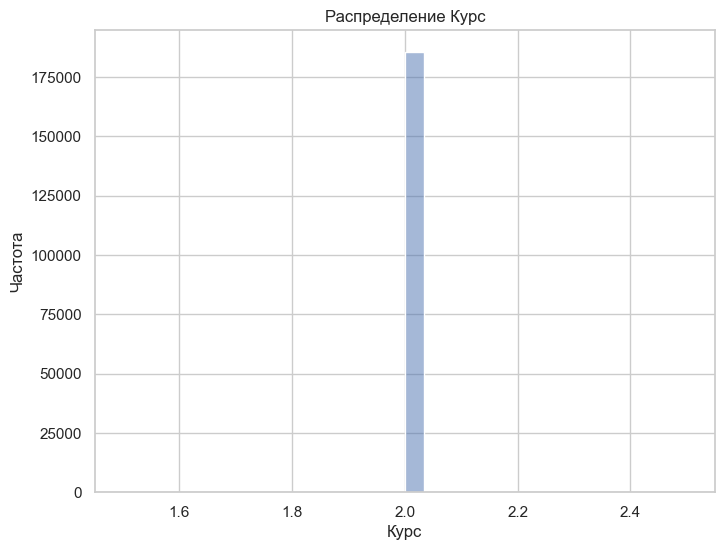

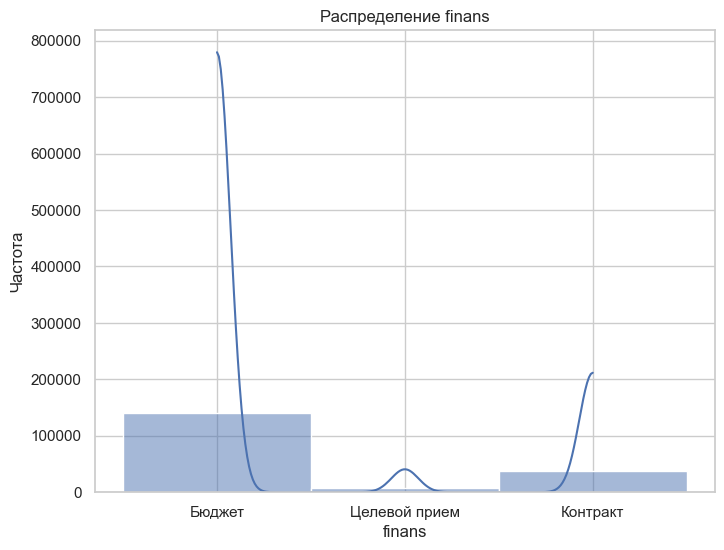

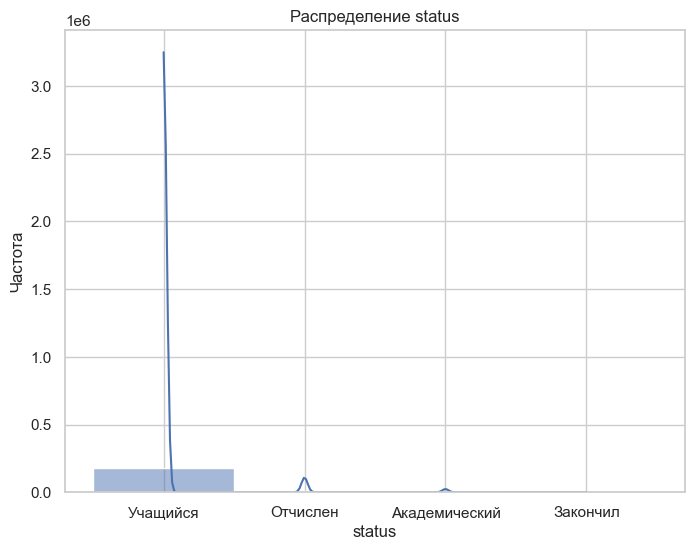

...

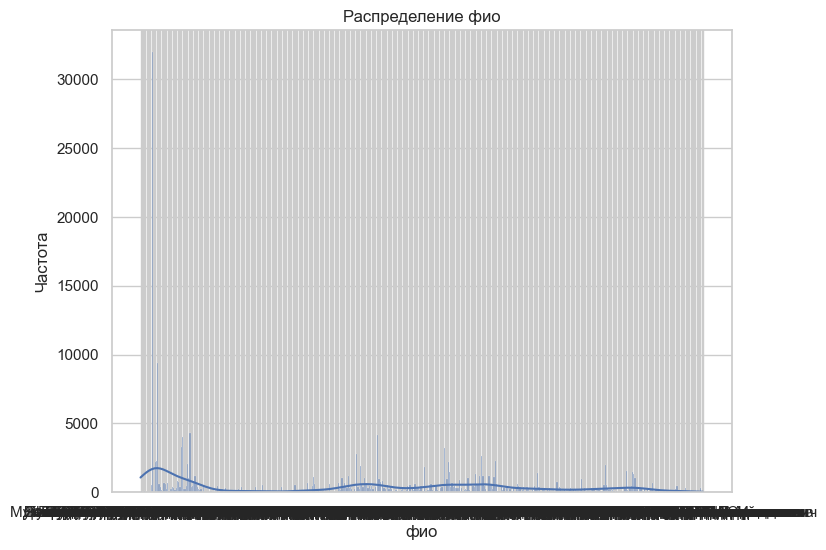

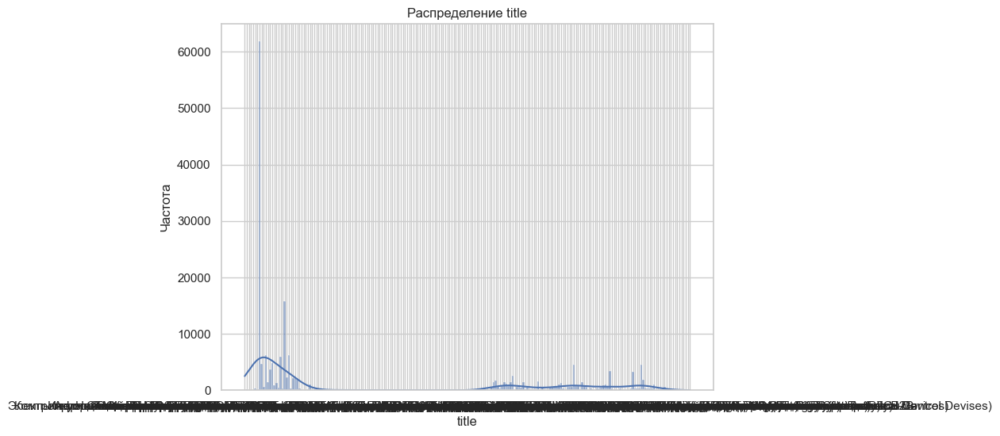

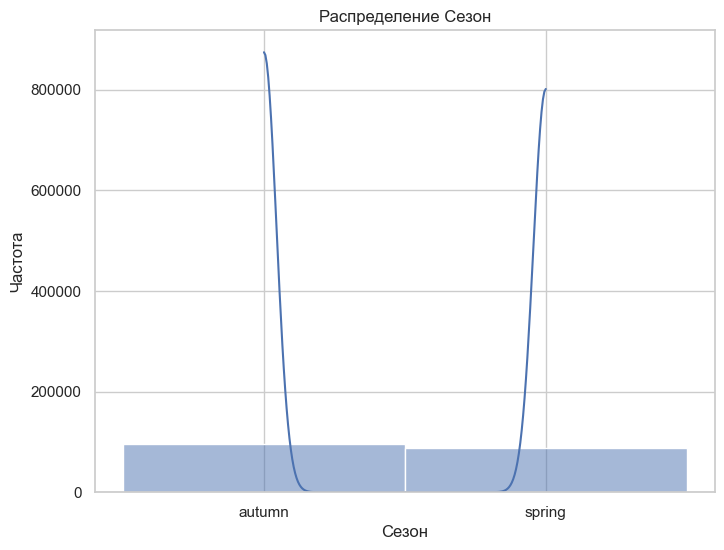

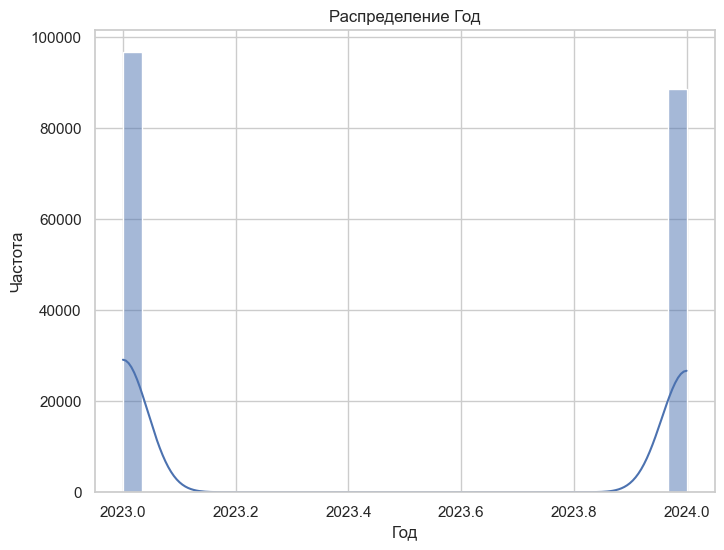

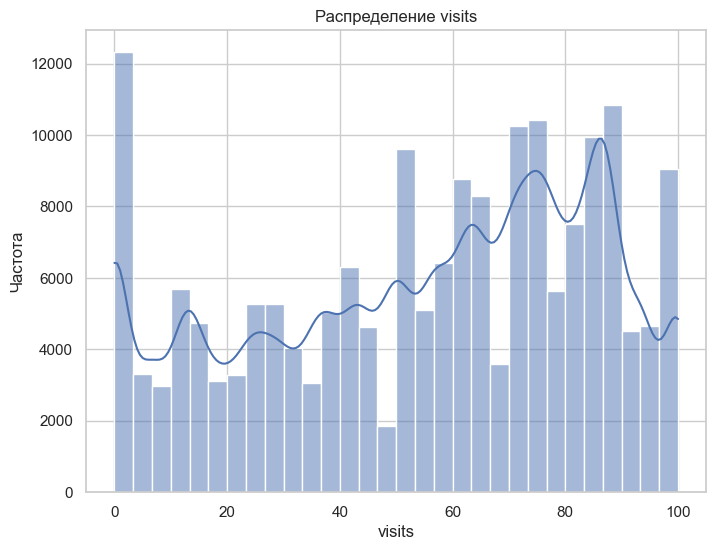

In [641]:
for column in itog_df2324.columns:
    plt.figure(figsize=(8, 6))
    sns.histplot(itog_df2324[column], bins=30, kde=True)
    plt.title(f'Распределение {column}')
    plt.xlabel(column)
    plt.ylabel('Частота')
    plt.show()


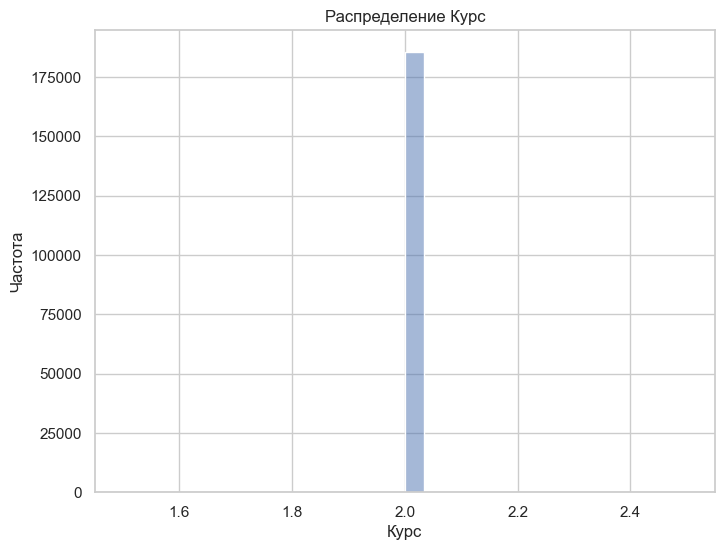

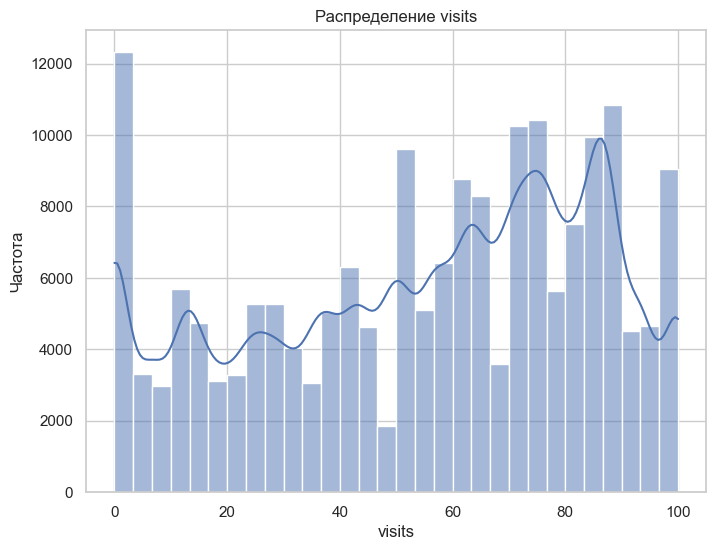

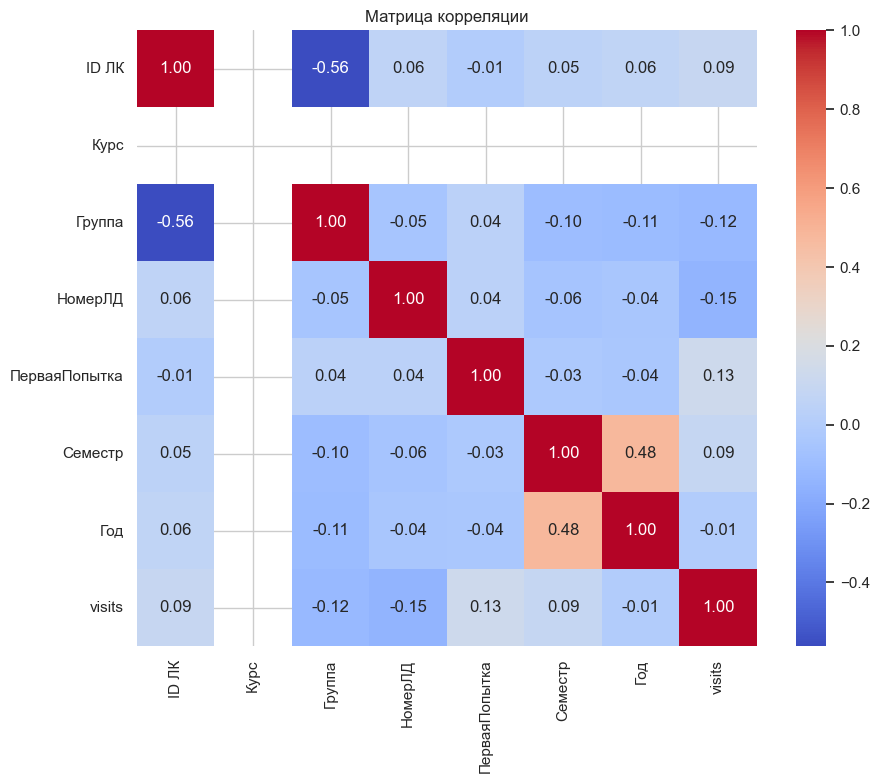

In [639]:
sns.set(style='whitegrid')

# Визуализация распределения числовых переменных
numerical_columns = ['Курс', 'visits']  # Выберете нужные числовые столбцы

for column in numerical_columns:
    plt.figure(figsize=(8, 6))
    sns.histplot(itog_df2324[column], bins=30, kde=True)
    plt.title(f'Распределение {column}')
    plt.xlabel(column)
    plt.ylabel('Частота')
    plt.show()

# Построение матрицы корреляции
# Выберите числовые столбцы для корреляции
correlation_columns = itog_df2324.select_dtypes(include='number')  # Включаем все числовые столбцы

# Вычисление матрицы корреляции
correlation_matrix = correlation_columns.corr()

# Визуализация тепловой карты корреляции
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Матрица корреляции')
plt.show()

Размер датасета: (185431, 20)
Обзор датасета:
<class 'pandas.core.frame.DataFrame'>
Index: 185431 entries, 1522 to 954565
Data columns (total 20 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID ЛК                185431 non-null  int64  
 1   Иностранец           185431 non-null  bool   
 2   Курс                 185431 non-null  int64  
 3   finans               185431 non-null  object 
 4   status               185431 non-null  object 
 5   Уровень образования  185431 non-null  object 
 6   Форма образования    185431 non-null  object 
 7   Группа               185431 non-null  int64  
 8   НомерЛД              185431 non-null  int64  
 9   ПерваяПопытка        185431 non-null  int64  
 10  Семестр              185431 non-null  int64  
 11  Дисциплина           185431 non-null  object 
 12  Кафедра              185431 non-null  object 
 13  Тип_Ведомости        185431 non-null  object 
 14  ВидЗанятий           185

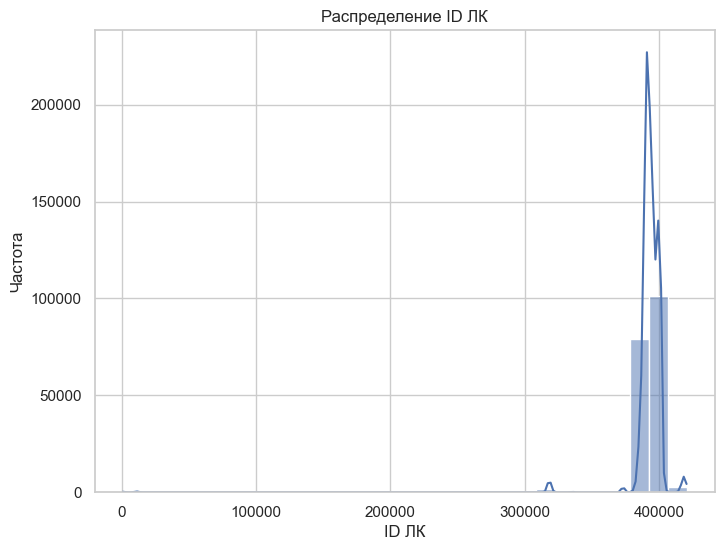

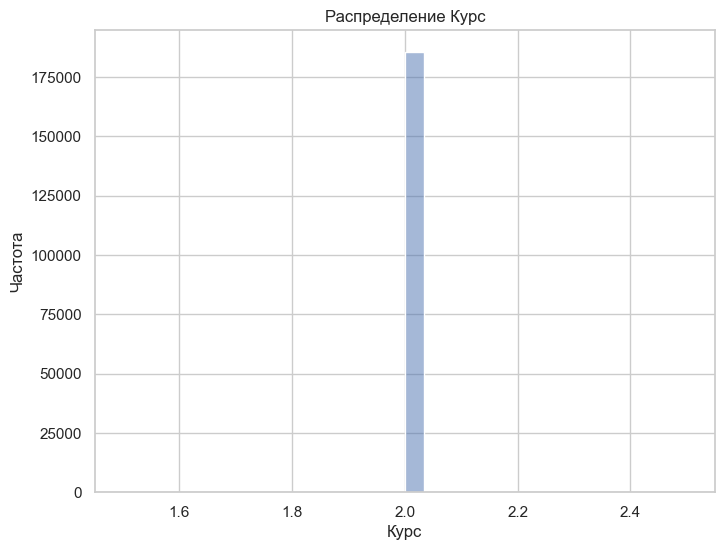

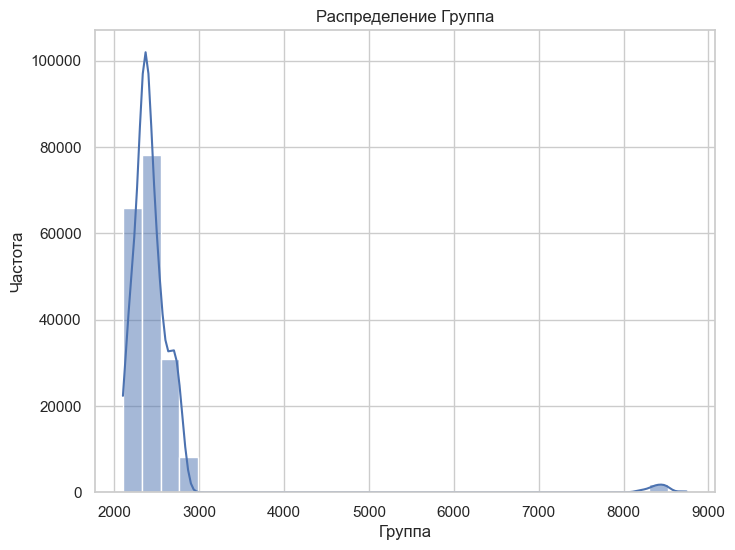

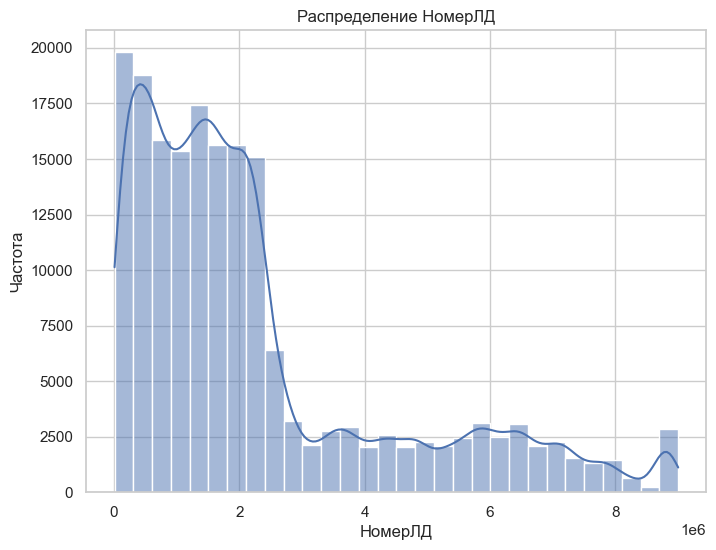

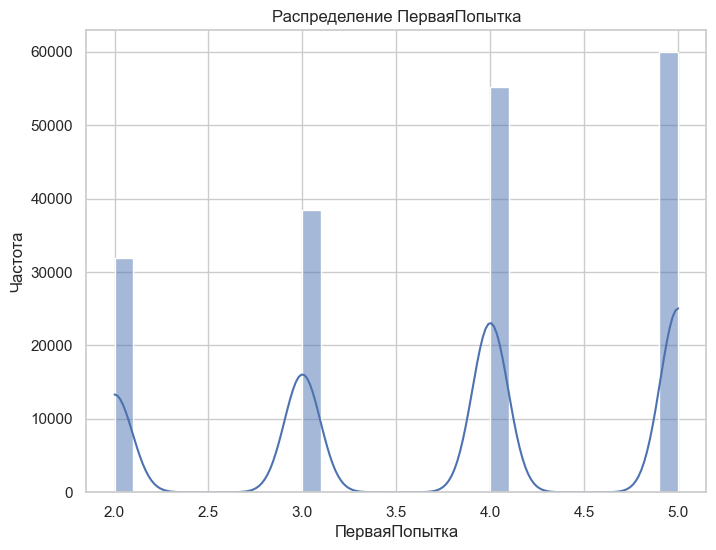

...

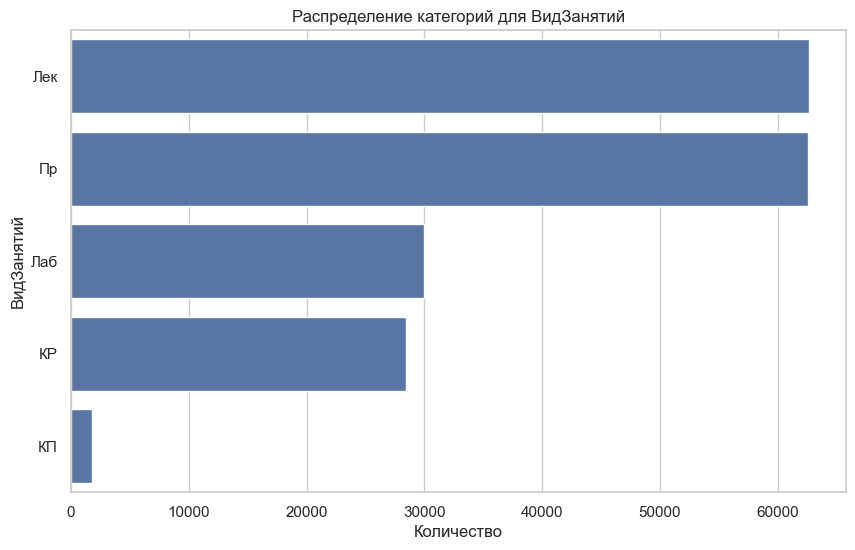

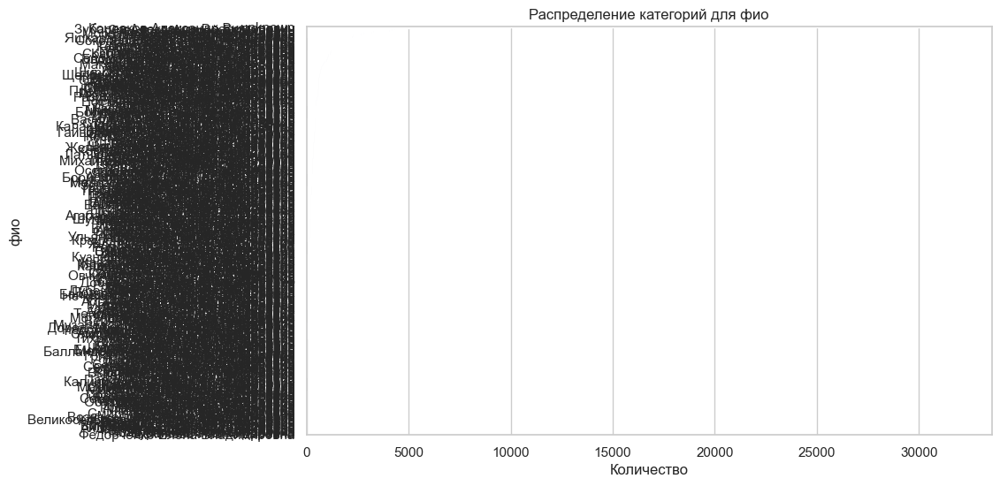

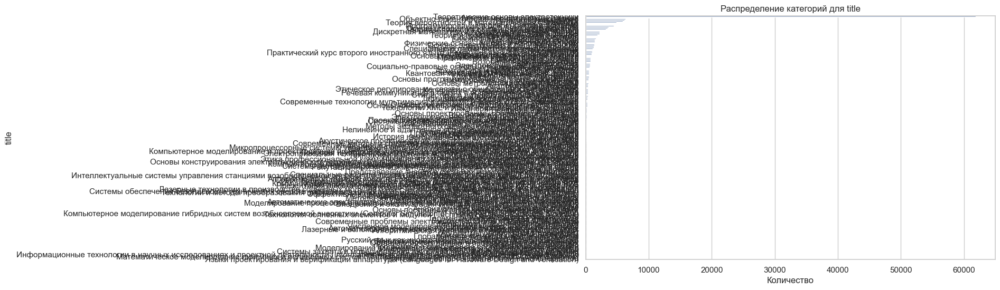

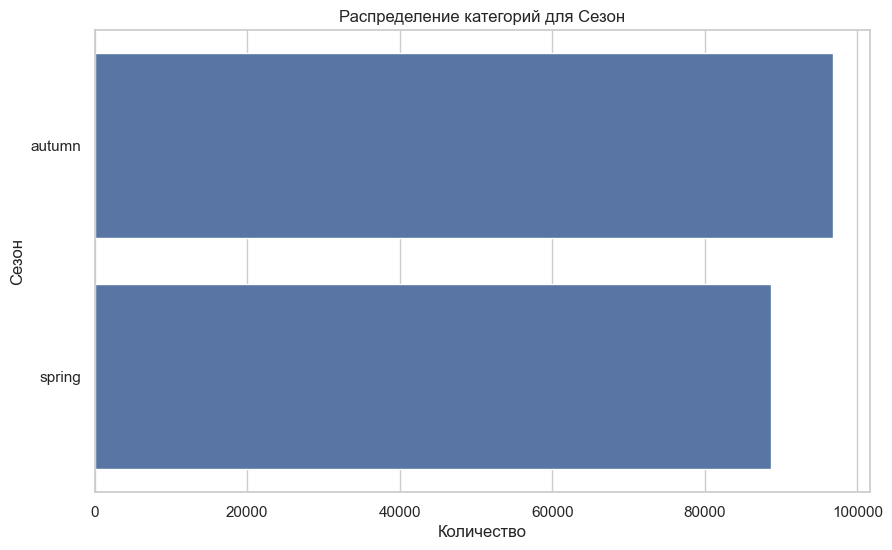

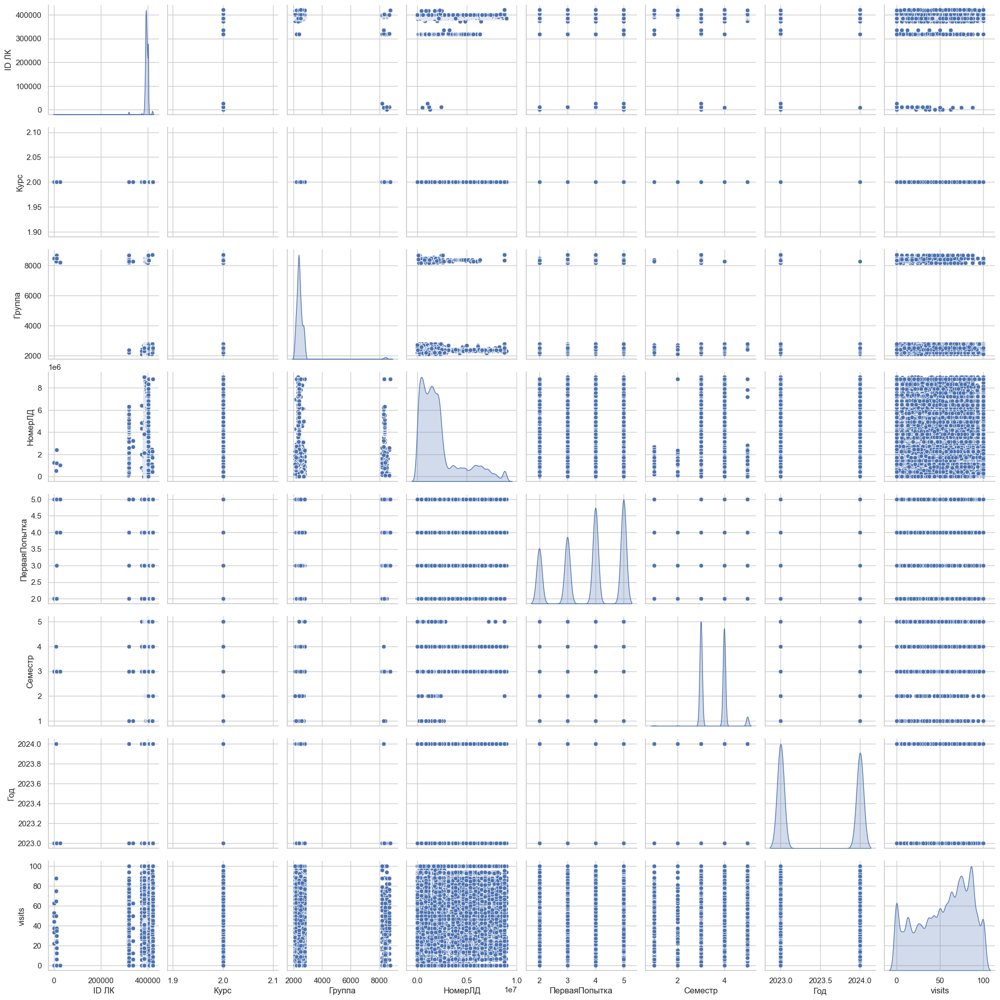

In [643]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

data = itog_df2324
# 1. Общая информация о датасете
print("Размер датасета:", data.shape)
print("Обзор датасета:")
print(data.info())

# 2. Статистическое описание числовых данных
print("\nСтатистическое описание числовых данных:")
print(data.describe())

# 3. Проверка на пропущенные значения
print("\nПропущенные значения в каждом столбце:")
print(data.isnull().sum())

# 4. Уникальные значения для категориальных переменных
categorical_columns = data.select_dtypes(include='object').columns
for column in categorical_columns:
    print(f"\nУникальные значения в столбце '{column}':")
    print(data[column].unique())

# 5. Визуализация распределения числовых переменных
numerical_columns = data.select_dtypes(include='number').columns

for column in numerical_columns:
    plt.figure(figsize=(8, 6))
    sns.histplot(data[column], bins=30, kde=True)
    plt.title(f'Распределение {column}')
    plt.xlabel(column)
    plt.ylabel('Частота')
    plt.show()

# 6. Взаимосвязи между переменными
plt.figure(figsize=(10, 8))
sns.heatmap(data[numerical_columns].corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Матрица корреляции')
plt.show()

# 7. Распределение категорий
for column in categorical_columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(y=data[column], order=data[column].value_counts().index)
    plt.title(f'Распределение категорий для {column}')
    plt.xlabel('Количество')
    plt.ylabel(column)
    plt.show()

# 8. Взаимосвязи переменных на парных графиках
sns.pairplot(data[numerical_columns], diag_kind='kde')
plt.show()

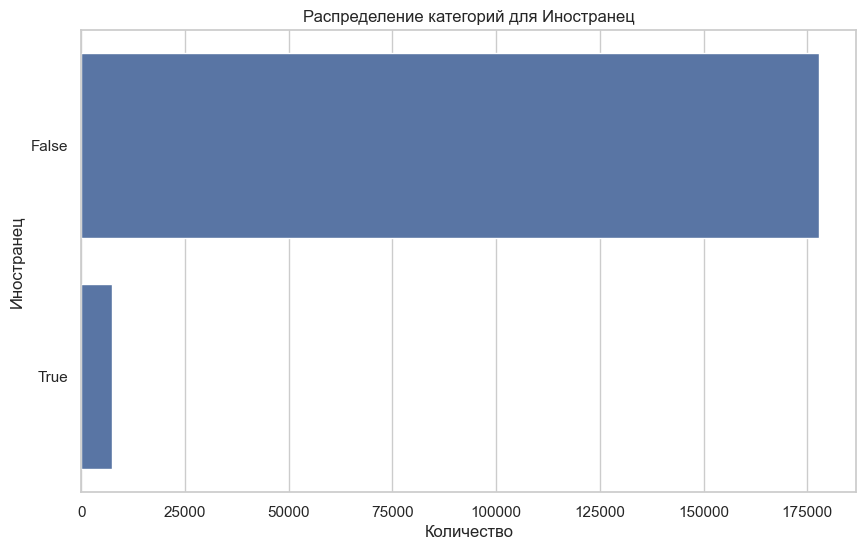

In [646]:
    plt.figure(figsize=(10, 6))
    sns.countplot(y=data['Иностранец'], order=data['Иностранец'].value_counts().index)
    plt.title(f'Распределение категорий для {'Иностранец'}')
    plt.xlabel('Количество')
    plt.ylabel('Иностранец')
    plt.show()

In [647]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 185431 entries, 1522 to 954565
Data columns (total 20 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID ЛК                185431 non-null  int64  
 1   Иностранец           185431 non-null  bool   
 2   Курс                 185431 non-null  int64  
 3   finans               185431 non-null  object 
 4   status               185431 non-null  object 
 5   Уровень образования  185431 non-null  object 
 6   Форма образования    185431 non-null  object 
 7   Группа               185431 non-null  int64  
 8   НомерЛД              185431 non-null  int64  
 9   ПерваяПопытка        185431 non-null  int64  
 10  Семестр              185431 non-null  int64  
 11  Дисциплина           185431 non-null  object 
 12  Кафедра              185431 non-null  object 
 13  Тип_Ведомости        185431 non-null  object 
 14  ВидЗанятий           185431 non-null  object 
 15  фио                

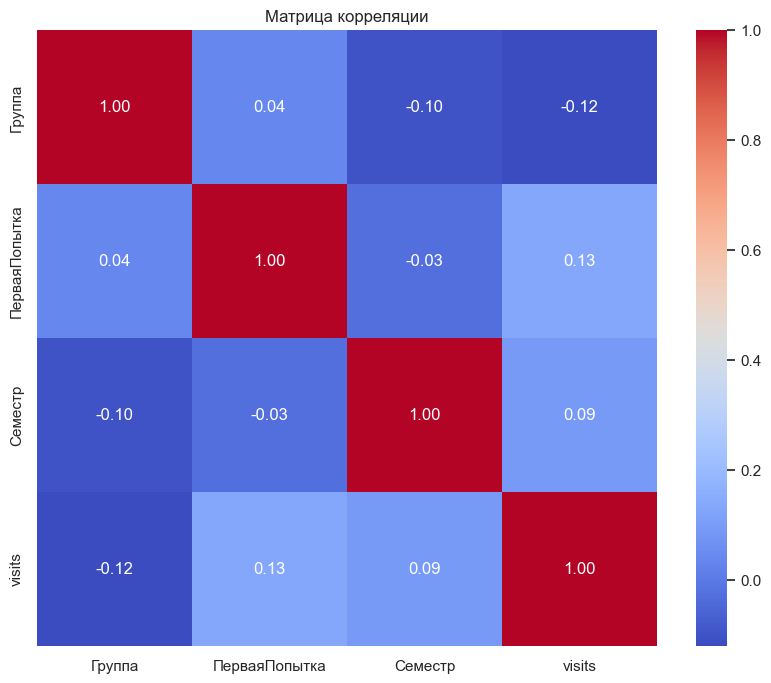

In [648]:
correlation_columns = itog_df2324[['Группа', 'ПерваяПопытка', 'Семестр', 'visits']]

# Вычисление матрицы корреляции
correlation_matrix = correlation_columns.corr()

# Визуализация тепловой карты корреляции
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Матрица корреляции')
plt.show()

In [651]:
ffg = itog_df2324.copy()
ffg['ПерваяПопытка'] = itog_df2324['ПерваяПопытка'].map({2: 2, 3: 3, 4: 3, 5: 3}).fillna(2).astype(int)
ffg

,ID ЛК,Иностранец,Курс,finans,status,Уровень образования,Форма образования,Группа,НомерЛД,ПерваяПопытка,Семестр,Дисциплина,Кафедра,Тип_Ведомости,ВидЗанятий,фио,title,Сезон,Год,visits
1522,318265,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8496,1910418,3,3,Электроприводная техника производственных сист...,каф.САУ,Экзамен,Лек,Кузнецов Владимир Евгеньевич,Электроприводная техника производственных сист...,autumn,2023,0.000000
1523,318265,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8496,1910418,3,3,Электроприводная техника производственных сист...,каф.САУ,Экзамен,Лек,Кузнецов Владимир Евгеньевич,Электроприводная техника производственных сист...,autumn,2023,23.529412
1524,318265,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8496,1910418,3,3,Электроприводная техника производственных сист...,каф.САУ,Экзамен,Лаб,Кузнецов Владимир Евгеньевич,Электроприводная техника производственных сист...,autumn,2023,0.000000
1525,318265,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8496,1910418,3,3,Электроприводная техника производственных сист...,каф.САУ,Экзамен,Лаб,Кузнецов Владимир Евгеньевич,Электроприводная техника производственных сист...,autumn,2023,23.529412
1526,318265,False,2,Бюджет,Учащийся,Магистратура,Очная форма,8496,1910418,2,3,Электроприводные системы подвижных объектов,каф.САУ,Экзамен,Лек,Гаврилов Сергей Викторович,Электроприводные системы подвижных объектов,autumn,2023,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
954561,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,2,4,Теоретические основы электротехники,каф.ТОЭ,Экзамен,Пр,Нечаев Илья Сергеевич,Теоретические основы электротехники,spring,2024,77.777778
954562,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,2,4,Теоретические основы электротехники,каф.ТОЭ,Экзамен,Пр,Нечаев Илья Сергеевич,Теоретические основы электротехники,spring,2024,72.727273
954563,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,2,4,Теоретические основы электротехники,каф.ТОЭ,Экзамен,Лаб,Кондаков Александр Викторович,Теоретические основы электротехники,spring,2024,100.000000
954564,420654,False,2,Бюджет,Учащийся,Бакалавриат,Очная форма,2501,8800844,2,4,Теоретические основы электротехники,каф.ТОЭ,Экзамен,Лаб,Кондаков Александр Викторович,Теоретические основы электротехники,spring,2024,77.777778


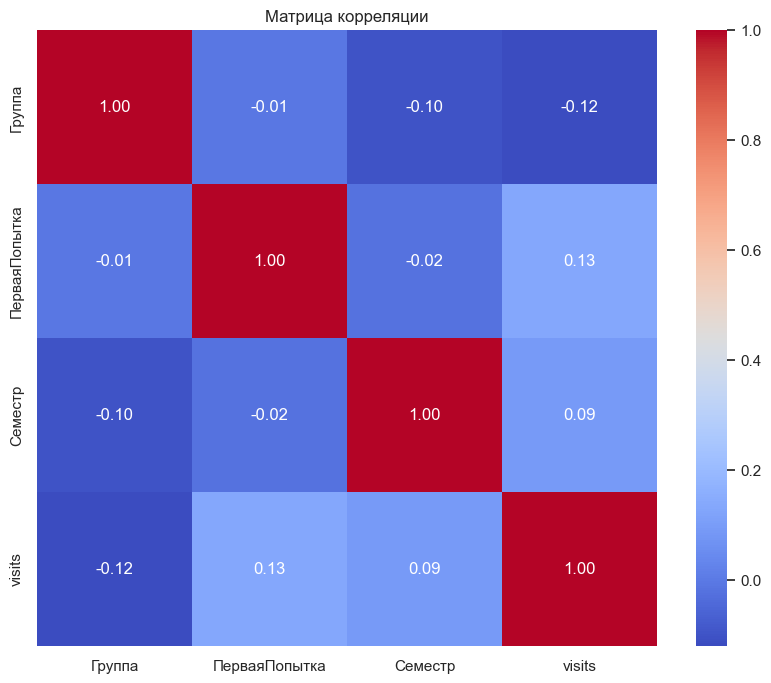

In [652]:
correlation_columns = ffg[['Группа', 'ПерваяПопытка', 'Семестр', 'visits']]

# Вычисление матрицы корреляции
correlation_matrix = correlation_columns.corr()

# Визуализация тепловой карты корреляции
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Матрица корреляции')
plt.show()

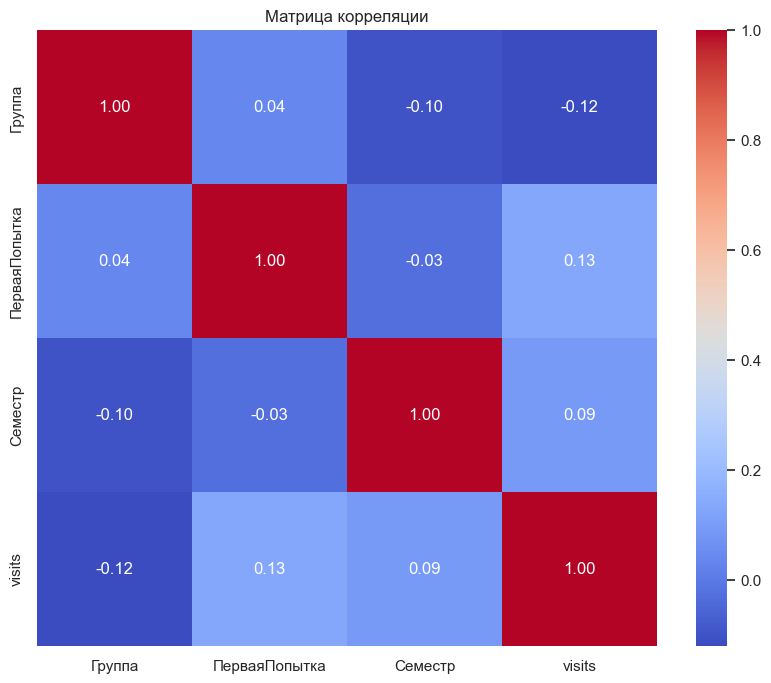

In [649]:
# рассмотрим корреляцию только для физики
ph = itog_df2324[itog_df2324['Дисциплина'] == 'Физика']
correlation_columns = itog_df2324[['Группа', 'ПерваяПопытка', 'Семестр', 'visits']]

# Вычисление матрицы корреляции
correlation_matrix = correlation_columns.corr()

# Визуализация тепловой карты корреляции
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Матрица корреляции')
plt.show()